---
# **BIOMEDICAL TEXT CLASSIFICATION USING LSTM, GRU AND BAHDANAU ATTENTION**
---

## **About Dataset**


The dataset originates from a competition hosted on [Kaggle](https://www.kaggle.com/competitions/msk-redefining-cancer-treatment) by the **Memorial Sloan Kettering Cancer Center (MSK)**.
The goal of the challenge was to develop models capable of **classifying genetic mutations based on clinical textual evidence**.

This dataset addresses a **real-world problem in precision oncology**, where clinicians must link a patient’s genetic mutations to a **treatment class or clinical outcome**, based on medical reports, scientific literature, or other clinical descriptions.

### **Dataset description**

training_variants - a comma separated file containing the description of the genetic mutations used for training. Fields are ID (the id of the row used to link the mutation to the clinical evidence), Gene (the gene where this genetic mutation is located), Variation (the aminoacid change for this mutations), Class (1-9 the class this genetic mutation has been classified on)
training_text - a double pipe (||) delimited file that contains the clinical evidence (text) used to classify genetic mutations. Fields are ID (the id of the row used to link the clinical evidence to the genetic mutation), Text (the clinical evidence used to classify the genetic mutation).

#### **Turning our dataset into a binary classification problem where:**

- Class 7 → Positive class (1)

- All other classes → Negative class (0)

In [1]:
import random
import pickle
import time
import re
import wandb
from google.colab import drive

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data.dataset import ConcatDataset
from torch.utils.data import DataLoader, TensorDataset, Dataset
import torch.nn.functional as F
from torch.nn.utils.rnn import pad_sequence
from transformers import AutoTokenizer, AutoModel
from sklearn.utils.class_weight import compute_class_weight
from torch.utils.data import Dataset, DataLoader, TensorDataset, ConcatDataset
from torch.optim.lr_scheduler import ReduceLROnPlateau, StepLR
from sklearn.manifold import TSNE
import copy
from sklearn.metrics import (
    accuracy_score,
    f1_score,
    precision_score,
    recall_score,
    balanced_accuracy_score,
    classification_report,
    confusion_matrix,
    ConfusionMatrixDisplay
)

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from imblearn.over_sampling import SMOTE, BorderlineSMOTE

from tqdm import tqdm
import imageio
import numpy as np
import pandas as pd
import os
from collections import defaultdict
from collections import Counter

import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from scipy.sparse import csr_matrix
from wordcloud import WordCloud
from sklearn.metrics import f1_score, confusion_matrix, balanced_accuracy_score, precision_score, recall_score
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import nltk

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

In [2]:
# To ensure reproducibility of the results
SEED = 200
random.seed(SEED)

np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:
drive.mount('/content/drive')

Mounted at /content/drive


## **A. Data preparation**

In [4]:
data = pd.read_csv('/content/drive/MyDrive/data2.csv')
data = data.dropna()
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3316 entries, 0 to 3320
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   ID                  3316 non-null   int64 
 1   Gene                3316 non-null   object
 2   Variation           3316 non-null   object
 3   Class               3316 non-null   int64 
 4   Text                3316 non-null   object
 5   nb_sentences        3316 non-null   int64 
 6   nb_words            3316 non-null   int64 
 7   Mutation_Name       3316 non-null   object
 8   abstract            3316 non-null   object
 9   Top_Relevant_Words  3316 non-null   object
 10  label               3316 non-null   int64 
dtypes: int64(5), object(6)
memory usage: 310.9+ KB


In [ ]:
data.head()

,ID,Gene,Variation,Class,Text,nb_sentences,nb_words,Mutation_Name,abstract,Top_Relevant_Words,label
0,0,FAM58A,Truncating Mutations,1,Cyclin-dependent kinases (CDKs) regulate a var...,398,6089,Mutation1,cyclin-dependent kinase (cdks) regulate variet...,"['cyclin', 'fig', 'silencing', 'mcf7', 'cell',...",0
1,1,CBL,W802*,2,Abstract Background Non-small cell lung canc...,316,5756,Mutation2,abstract background non-small cell lung cancer...,"['cbl', 'mutation', 'egfr', 'lung', 'loh', 'me...",1
2,2,CBL,Q249E,2,Abstract Background Non-small cell lung canc...,316,5756,Mutation2,abstract background non-small cell lung cancer...,"['cbl', 'mutation', 'egfr', 'lung', 'loh', 'me...",1
3,3,CBL,N454D,3,Recent evidence has demonstrated that acquired...,224,5572,Mutation3,recent evidence demonstrated acquired uniparen...,"['cbl', 'mutation', 'flt3', 'case', '32d', 'v6...",2
4,4,CBL,L399V,4,Oncogenic mutations in the monomeric Casitas B...,312,6202,Mutation4,oncogenic mutation monomeric casitas b-lineage...,"['cbl', 'e2', 'mutation', 'stability', 'cancer...",3


#### **Turn your dataset into a binary classification problem where:**

- Class 7 → Positive class (1)

- All other classes → Negative class (0)

In [5]:
data['Binary_Class'] = (data['Class'] == 7).astype(int)
print(data['Binary_Class'].value_counts())

data = data[["Text", "Gene", "Variation", "Binary_Class"]]
data["abstract"] = data["Gene"] + " " + data["Variation"] + " " + data["Text"]

X = data["abstract"].values
y = data["Binary_Class"].values

X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=1)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

print()
print(f"Training set: {len(X_train)} samples")
print(f"Validation set: {len(X_val)} samples")
print(f"Test set: {len(X_test)} samples")

Binary_Class
0    2364
1     952
Name: count, dtype: int64

Training set: 2321 samples
Validation set: 497 samples
Test set: 498 samples


In [6]:
nltk.download('stopwords')
STOPWORDS = set(stopwords.words('english'))

def tokenize(text):
    """
    Tokenizes English text by:
    - converting to lowercase
    - removing punctuation
    - removing numbers
    - removing English stopwords

    Args:
        text (str): Input English text.

    Returns:
        List[str]: List of cleaned tokens without stopwords and numbers.
    """
    text = re.sub(r'[^\w\s]', ' ', text)
    tokens = re.findall(r'\b[a-z]+\b', text.lower())
    tokens = [word for word in tokens if word not in STOPWORDS]

    return tokens

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [7]:
def text_to_sequence(text):
    """
    Converts the tokenized text into a sequence of indices based on a word-to-index mapping.

    Args:
        text: A string containing the text to be converted.

    Returns:
        A list of integers representing the sequence of token indices.
    """
    return [word_to_index.get(token, word_to_index["<UNK>"]) for token in tokenize(text)]

def pad_to_tensor(sequences, max_len=None):
    """
    Pads sequences to the specified maximum length, or truncates them if they exceed it.

    Args:
        sequences: A list of sequences (each sequence is a list of integers).
        max_len: The maximum length to which sequences should be padded. If None, no padding is applied.

    Returns:
        A tensor containing the padded (or truncated) sequences.
    """
    padded_sequences = [torch.tensor(seq, dtype=torch.long) for seq in sequences]
    if max_len:
        padded_sequences = [seq[:max_len] for seq in padded_sequences]
        padded_sequences = [
            torch.cat([seq, torch.zeros(max_len - len(seq), dtype=torch.long)], 0) if len(seq) < max_len else seq
            for seq in padded_sequences
        ]

    return torch.stack(padded_sequences)

class TextDataset(Dataset):
    """
    Custom Dataset for handling text data and labels.

    Args:
        X_data: Input features (e.g., tokenized text).
        y_data: Labels corresponding to the text data.
        raw_text_data: (Optional) The raw text data for reference (default is None).
    """
    def __init__(self, X_data, y_data, raw_text_data=None):
        self.X = torch.tensor(X_data, dtype=torch.long)
        self.y = torch.tensor(y_data, dtype=torch.long)
        self.raw_text_data = raw_text_data

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        input_tensor = self.X[idx]
        target_tensor = self.y[idx]
        raw_text = self.raw_text_data[idx] if self.raw_text_data is not None else None
        return input_tensor, target_tensor, raw_text

In [8]:
all_tokens = [token for text in X_train for token in tokenize(text)]
vocab = Counter(all_tokens)
filtered_vocab = {word: freq for word, freq in vocab.items() if freq >= 3}
print(len(filtered_vocab))
VOCAB_SIZE =  len(filtered_vocab)

sorted_filtered_vocab = dict(sorted(filtered_vocab.items(), key=lambda item: item[1], reverse=True)[:VOCAB_SIZE])

word_to_index = {word: idx for idx, (word, _) in enumerate(sorted_filtered_vocab.items(), 1)}
word_to_index["<PAD>"] = 0
word_to_index["<UNK>"] = len(word_to_index)

index_to_word = {idx: word for word, idx in word_to_index.items()}
print(word_to_index["malaria"])
print(index_to_word[10])

print(index_to_word[301])
print(word_to_index["host"])

40865
11312
figure
involved
3916


In [9]:
X_train_seq = [text_to_sequence(text) for text in X_train]
X_val_seq = [text_to_sequence(text) for text in X_val]
X_test_seq = [text_to_sequence(text) for text in X_test]

print(X_train_seq[0])

[2543, 323, 1, 24, 934, 8, 2568, 9185, 9251, 390, 4120, 1355, 1037, 1323, 19, 2181, 1785, 3, 332, 2521, 3, 3435, 526, 4120, 99, 1, 2346, 1499, 14, 1157, 2080, 437, 1620, 729, 59, 885, 562, 99, 1, 47, 4120, 794, 31, 1034, 9, 148, 177, 267, 110, 549, 9, 148, 1, 1751, 978, 19, 14, 2347, 147, 50, 895, 63, 2978, 19466, 1, 32712, 215, 36, 4432, 208, 12, 19, 5002, 766, 314, 58, 412, 9, 148, 1, 4361, 183, 2182, 2426, 3435, 2784, 827, 2, 4840, 4878, 209, 343, 455, 26, 2041, 1593, 4347, 621, 51, 82, 3, 3435, 270, 39, 22165, 1789, 518, 123, 9, 148, 110, 343, 345, 17, 361, 14, 160, 2861, 342, 5002, 58, 3, 7227, 7508, 4, 3, 3435, 32713, 5002, 24, 2169, 1162, 1142, 569, 9185, 9251, 390, 4120, 2654, 714, 2009, 10493, 230, 10990, 3550, 1589, 2263, 11178, 9802, 10782, 4120, 11, 6049, 223, 416, 1668, 992, 892, 109, 3421, 18, 6662, 7888, 2792, 323, 1, 24, 18, 1638, 348, 456, 47, 526, 4120, 11, 194, 1, 11384, 447, 794, 31, 1137, 705, 214, 634, 124, 209, 3361, 123, 4120, 722, 108, 752, 2112, 248, 964, 1117

In [10]:
max_length = 400

X_train_tensor = pad_to_tensor(X_train_seq, max_len=max_length)
X_val_tensor = pad_to_tensor(X_val_seq, max_len=max_length)
X_test_tensor = pad_to_tensor(X_test_seq, max_len=max_length)

print(f"Train Tensor Shape: {X_train_tensor.shape}, Type: {X_train_tensor.dtype}")
print(f"Validation Tensor Shape: {X_val_tensor.shape}, Type: {X_val_tensor.dtype}")
print(f"Test Tensor Shape: {X_test_tensor.shape}, Type: {X_test_tensor.dtype}")

y_train_tensor = torch.tensor(y_train)
y_val_tensor = torch.tensor(y_val)
y_test_tensor = torch.tensor(y_test)

Train Tensor Shape: torch.Size([2321, 400]), Type: torch.int64
Validation Tensor Shape: torch.Size([497, 400]), Type: torch.int64
Test Tensor Shape: torch.Size([498, 400]), Type: torch.int64


In [11]:
# --- BioMedNLP Setup ---
BiomedNLP_model_name = "microsoft/BiomedNLP-PubMedBERT-base-uncased-abstract-fulltext"
tokenizer = AutoTokenizer.from_pretrained(BiomedNLP_model_name)

BiomedNLP = AutoModel.from_pretrained(BiomedNLP_model_name).to(device)

for param in BiomedNLP.parameters():
    param.requires_grad = True

BATCH_SIZE = 16

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/385 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/440M [00:00<?, ?B/s]

In [12]:
class BahdanauAttention(nn.Module):
    """
    Bahdanau Attention Mechanism.
    """
    def __init__(self, hidden_dim):
        super(BahdanauAttention, self).__init__()
        self.W = nn.Linear(hidden_dim * 2, hidden_dim)
        self.v = nn.Linear(hidden_dim, 1, bias=False)

    def forward(self, rnn_outputs):
        # rnn_outputs: [batch_size, seq_len, hidden_dim*2]
        score = torch.tanh(self.W(rnn_outputs))
        attn_weights = torch.softmax(self.v(score), dim=1)  # [batch_size, seq_len, 1]
        context = torch.sum(attn_weights * rnn_outputs, dim=1)  # [batch_size, hidden_dim*2]
        return context

class GRU_BahdanauAttention(nn.Module):
    def __init__(self, embedding_matrix, hidden_dim, num_layers=1, dropout_prob=0.6):
        super(GRU_BahdanauAttention, self).__init__()
        vocab_size, embedding_dim = embedding_matrix.shape
        self.embedding = nn.Embedding.from_pretrained(embedding_matrix, freeze=False)

        self.gru = nn.GRU(
            input_size=embedding_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            bidirectional=True
        )

        self.attention = BahdanauAttention(hidden_dim)
        self.dropout = nn.Dropout(dropout_prob)
        self.fc = nn.Linear(hidden_dim * 2, 1)  # binary output

    def forward(self, x):
        embedded = self.embedding(x)
        gru_out, _ = self.gru(embedded)
        context = self.attention(gru_out)
        x = self.dropout(context)
        output = self.fc(x)  # raw logits (no sigmoid)
        return output

class LSTM_BahdanauAttention(nn.Module):
    """
    Bidirectional LSTM with Bahdanau Attention Mechanism for binary classification.
    """
    def __init__(self, embedding_matrix, hidden_dim, num_layers=1, dropout_prob=0.6):
        super(LSTM_BahdanauAttention, self).__init__()
        vocab_size, embedding_dim = embedding_matrix.shape
        self.embedding = nn.Embedding.from_pretrained(embedding_matrix, freeze=False)

        self.lstm = nn.LSTM(
            input_size=embedding_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            dropout=dropout_prob if num_layers > 1 else 0,
            bidirectional=True
        )

        self.attention = BahdanauAttention(hidden_dim)
        self.dropout = nn.Dropout(dropout_prob)
        self.fc = nn.Linear(hidden_dim * 2, 1)  # binary output

    def forward(self, x):
        embedded = self.embedding(x)
        lstm_out, _ = self.lstm(embedded)
        context = self.attention(lstm_out)
        x = self.dropout(context)
        output = self.fc(x)  # raw logits (no sigmoid)
        return output

class BiomedNLP_GRU_Attention(nn.Module):
    """
    Binary classification model combining BiomedNLP embeddings, GRU layers, and Bahdanau Attention.
    """
    def __init__(self, bert_dim, hidden_dim, num_layers=1, dropout_prob=0.6):
        super(BiomedNLP_GRU_Attention, self).__init__()

        self.gru = nn.GRU(
            input_size=bert_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            bidirectional=True
        )

        self.attention = BahdanauAttention(hidden_dim)
        self.fc = nn.Linear(hidden_dim * 2, 1)  # Binary output
        self.dropout = nn.Dropout(dropout_prob)

    def forward(self, input_ids, attention_mask):
        # Extract frozen BiomedNLP embeddings
        with torch.no_grad():
            bert_outputs = BiomedNLP(input_ids=input_ids, attention_mask=attention_mask)
        bert_embeds = bert_outputs.last_hidden_state  # [batch_size, seq_len, bert_dim]

        # GRU
        gru_out, _ = self.gru(bert_embeds)

        # Attention
        context = self.attention(gru_out)

        # Dropout + output
        x = self.dropout(context)
        output = self.fc(x)  # Raw logits
        return output

class BiomedNLP_LSTM_Attention(nn.Module):
    """
    Binary classification model combining BiomedNLP embeddings, LSTM layers, and Bahdanau Attention.
    """
    def __init__(self, bert_dim, hidden_dim, num_layers=1, dropout_prob=0.6):
        super(BiomedNLP_LSTM_Attention, self).__init__()

        self.lstm = nn.LSTM(
            input_size=bert_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            bidirectional=True
        )

        self.attention = BahdanauAttention(hidden_dim)
        self.fc = nn.Linear(hidden_dim * 2, 1)  # Binary output
        self.dropout = nn.Dropout(dropout_prob)

    def forward(self, input_ids, attention_mask):
        # Extract frozen BiomedNLP embeddings
        with torch.no_grad():
            bert_outputs = BiomedNLP(input_ids=input_ids, attention_mask=attention_mask)
        bert_embeds = bert_outputs.last_hidden_state  # [batch_size, seq_len, bert_dim]

        # LSTM
        lstm_out, _ = self.lstm(bert_embeds)

        # Attention
        context = self.attention(lstm_out)

        # Dropout + output
        x = self.dropout(context)
        output = self.fc(x)  # Raw logits
        return output

# ============ Define Bidirectional GRU Model ============
class GRU_Model(nn.Module):
    def __init__(self, vocab_size, embedding_dim, hidden_dim, output_dim=1,
                 num_layers=1, dropout_prob=0.5, embedding_weights=None, freeze_embeddings=False):
        super(GRU_Model, self).__init__()

        if embedding_weights is not None:
            self.embedding = nn.Embedding.from_pretrained(embedding_weights, freeze=freeze_embeddings)
        else:
            self.embedding = nn.Embedding(vocab_size, embedding_dim)

        self.gru = nn.GRU(
            input_size=embedding_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            dropout=dropout_prob if num_layers > 1 else 0,
            bidirectional=True
        )

        self.dropout = nn.Dropout(dropout_prob)
        self.fc = nn.Linear(hidden_dim * 2, output_dim)

    def forward(self, x):
        embedded = self.embedding(x)
        gru_out, _ = self.gru(embedded)
        gru_out = self.dropout(gru_out[:, -1, :])
        out = self.fc(gru_out)
        return out

# ============ Define Bidirectional LSTM Model ============
class LSTM_Model(nn.Module):
    def __init__(self, vocab_size, embedding_dim, hidden_dim, output_dim=1,
                 embedding_weights=None, num_layers=1, dropout_prob=0.3, freeze_embeddings=True):
        super(LSTM_Model, self).__init__()

        if embedding_weights is not None:
            self.embedding = nn.Embedding.from_pretrained(embedding_weights, freeze=freeze_embeddings)
        else:
            self.embedding = nn.Embedding(vocab_size, embedding_dim)

        self.lstm = nn.LSTM(
            input_size=embedding_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            dropout=dropout_prob if num_layers > 1 else 0,
            bidirectional=True
        )

        self.dropout = nn.Dropout(dropout_prob)
        self.fc = nn.Linear(hidden_dim * 2, output_dim)

    def forward(self, x):
        embedded = self.embedding(x)
        lstm_out, _ = self.lstm(embedded)
        lstm_out = self.dropout(lstm_out[:, -1, :])
        out = self.fc(lstm_out)
        return out

In [13]:
class BiomedNLPDataset(Dataset):
    """
    Dataset class for multi-class classification using PubMedBERT embeddings.

    Args:
        texts (list of str): A list of raw text sequences.
        labels (list of int): A list of integer labels (0-4) corresponding to each text.
        tokenizer (transformers tokenizer): A tokenizer to preprocess the text data.
        max_length (int): Maximum length for padding/truncation. Default is 500.

    Attributes:
        texts (list of str): The raw text data.
        encodings (dict): Tokenized text data with input IDs and attention masks.
        labels (Tensor): Tensor of integer labels for the classification task.
    """

    def __init__(self, texts, labels, tokenizer, max_length=500):
        self.texts = texts
        self.encodings = tokenizer(texts, padding='max_length', truncation=True, max_length=max_length, return_tensors='pt')
        self.labels = torch.tensor(labels, dtype=torch.long)

    def __getitem__(self, idx):
        """
        Retrieve a single sample from the dataset.

        Args:
            idx (int): Index of the sample to retrieve.

        Returns:
            dict: Contains input IDs, attention masks, and the corresponding label and raw text.
        """
        item = {key: val[idx] for key, val in self.encodings.items()}
        item['labels'] = self.labels[idx]
        item['text'] = self.texts[idx]
        return item

    def __len__(self):
        """
        Returns the total number of samples in the dataset.

        Returns:
            int: Number of samples in the dataset.
        """
        return len(self.labels)

In [14]:
clip = 5.0  # gradient clipping

def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

def train_model(model, dataloader, optimizer, criterion, device):
    """
    Train the model for one epoch, calculating loss and accuracy.
    Args:
        model: The model to train.
        dataloader: DataLoader for the training dataset.
        optimizer: Optimizer for model parameters.
        criterion: Loss function.
        device: CPU/GPU device.
    Returns:
        Average loss and accuracy for the epoch.
    """
    model.train()
    total_loss = 0
    total_correct = 0
    total_samples = 0

    for batch in dataloader:
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['labels'].float().to(device).unsqueeze(1)

        optimizer.zero_grad()
        logits = model(input_ids, attention_mask)
        loss = criterion(logits, labels)
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

        preds = torch.sigmoid(logits).detach().cpu().numpy()
        preds = (preds > 0.5).astype(int)
        total_correct += np.sum(preds == labels.cpu().numpy())
        total_samples += labels.size(0)

    avg_loss = total_loss / len(dataloader)
    avg_accuracy = total_correct / total_samples
    return avg_loss, avg_accuracy

def evaluate_model(model, dataloader, criterion, device):
    """
    Validate the model for one epoch, including precision, F1, balanced accuracy, and recall.
    Args:
        model: Model instance.
        dataloader: DataLoader for validation data.
        criterion: Loss function (BCEWithLogitsLoss).
        device: CPU/GPU.
    Returns:
        Average validation loss, accuracy, F1-score.
    """
    model.eval()
    all_preds = []
    all_labels = []
    val_loss = 0.0

    with torch.no_grad():
        for batch in dataloader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['labels'].float().to(device).unsqueeze(1)

            logits = model(input_ids, attention_mask)
            loss = criterion(logits, labels)
            val_loss += loss.item()

            preds = torch.sigmoid(logits).cpu().numpy()
            preds = (preds > 0.5).astype(int)
            labels_cpu = labels.cpu().numpy()

            all_preds.extend(preds)
            all_labels.extend(labels_cpu)

    val_loss /= len(dataloader)
    all_preds = np.array(all_preds)
    all_labels = np.array(all_labels)

    acc = accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds)

    return acc, f1, val_loss

def test_model(model, test_loader, criterion, device):
    """
    Evaluate the model on the test dataset, calculating loss, accuracy, F1-score, precision, recall, and balanced accuracy.
    Args:
        model: The model to evaluate.
        test_loader: DataLoader for the test dataset.
        criterion: Loss function (BCEWithLogitsLoss).
        device: CPU/GPU device.
    Returns:
        Average test loss, accuracy, F1-score, balanced accuracy, recall, and precision.
    """
    model.eval()
    total_loss = 0
    total_accuracy = 0
    all_labels = []
    all_preds = []

    with torch.no_grad():
        for batch in test_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            target_tensor = batch['labels'].float().to(device).unsqueeze(1)

            output = model(input_ids, attention_mask)
            loss = criterion(output, target_tensor)
            total_loss += loss.item()

            preds = torch.sigmoid(output).cpu().numpy()
            preds_bin = (preds > 0.5).astype(int)
            total_accuracy += accuracy_score(target_tensor.cpu(), preds_bin) * len(target_tensor)

            all_preds.extend(preds_bin)
            all_labels.extend(target_tensor.cpu().numpy())

    avg_loss = total_loss / len(test_loader)
    avg_accuracy = total_accuracy / len(test_loader.dataset)
    all_preds = np.array(all_preds)
    all_labels = np.array(all_labels)

    f1 = f1_score(all_labels, all_preds, zero_division=0)
    balanced_acc = balanced_accuracy_score(all_labels, all_preds)
    precision = precision_score(all_labels, all_preds, zero_division=0)
    recall = recall_score(all_labels, all_preds, zero_division=0)

    return avg_loss, avg_accuracy, f1, balanced_acc, recall, precision

def train_epoch(model, train_loader, optimizer, criterion, device):
    model.train()
    total_loss = 0.0
    all_preds, all_labels = [], []

    for batch in train_loader:
        if len(batch) == 3:
            inputs, targets, _ = batch
        else:
            inputs, targets = batch

        inputs = inputs.to(device)
        targets = targets.float().to(device)  # BCE expects float targets

        optimizer.zero_grad()
        outputs = model(inputs).squeeze(1)  # (batch_size,) shape
        loss = criterion(outputs, targets)
        loss.backward()

        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=clip)
        optimizer.step()

        total_loss += loss.item()

        preds = torch.round(torch.sigmoid(outputs)).detach().cpu().numpy()
        labels = targets.cpu().numpy()

        all_preds.extend(preds)
        all_labels.extend(labels)

    avg_loss = total_loss / len(train_loader)
    balanced_acc = balanced_accuracy_score(all_labels, all_preds)

    return avg_loss, balanced_acc

def evaluate_epoch(model, val_loader, criterion, device):
    model.eval()
    total_loss = 0.0
    all_preds, all_labels = [], []

    with torch.no_grad():
        for batch in val_loader:
            if len(batch) == 3:
                inputs, targets, _ = batch
            else:
                inputs, targets = batch

            inputs = inputs.to(device)
            targets = targets.float().to(device)

            outputs = model(inputs).squeeze(1)
            loss = criterion(outputs, targets)
            total_loss += loss.item()

            preds = torch.round(torch.sigmoid(outputs)).detach().cpu().numpy()
            labels = targets.cpu().numpy()

            all_preds.extend(preds)
            all_labels.extend(labels)

    avg_loss = total_loss / len(val_loader)
    balanced_acc = balanced_accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds, average="binary", zero_division=0)

    return avg_loss, balanced_acc, f1

def test_epoch(model, test_loader, criterion, device):
    model.eval()
    total_loss, total_accuracy = 0, 0
    all_labels, all_preds = [], []

    with torch.no_grad():
        for batch in test_loader:
            input_tensor, target_tensor, _ = batch
            input_tensor = input_tensor.to(device)
            target_tensor = target_tensor.float().to(device)

            output = model(input_tensor).squeeze(1)
            loss = criterion(output, target_tensor)

            preds = torch.round(torch.sigmoid(output)).detach().cpu().numpy()
            labels = target_tensor.cpu().numpy()

            batch_accuracy = accuracy_score(labels, preds)
            total_loss += loss.item()
            total_accuracy += batch_accuracy * len(labels)

            all_preds.extend(preds)
            all_labels.extend(labels)

    f1 = f1_score(all_labels, all_preds, average="binary", zero_division=0)
    balanced_acc = balanced_accuracy_score(all_labels, all_preds)
    precision = precision_score(all_labels, all_preds, average="binary", zero_division=0)
    recall = recall_score(all_labels, all_preds, average="binary", zero_division=0)

    avg_loss = total_loss / len(test_loader)
    avg_accuracy = total_accuracy / len(test_loader.dataset)

    return avg_loss, avg_accuracy, f1, balanced_acc, recall, precision

def count_parameters(model):
    """
    Computes the total number of trainable parameters in a model.

    Args:
        model: A PyTorch model instance.

    Returns:
        The total number of trainable parameters in the model.
    """
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

def custom_collate_fn(batch):
    """
    Custom collate function to combine input tensors, target tensors, and raw texts into a batch.
    Stacks inputs and targets into tensors, returns raw texts as a list.

    Args:
        batch (list): List of tuples containing input tensor, target tensor, and raw text.

    Returns:
        tuple: Stacked inputs tensor, stacked targets tensor, and list of raw texts.
    """
    inputs, targets, raw_texts = zip(*batch)
    inputs = torch.stack(inputs)
    targets = torch.stack(targets)
    return inputs, targets, list(raw_texts)

In [15]:
BATCH_SIZE = 16

# --- Load Data ---
train_dataset = BiomedNLPDataset(X_train.tolist(), y_train, tokenizer)
val_dataset = BiomedNLPDataset(X_val.tolist(), y_val, tokenizer)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=BATCH_SIZE, shuffle=True)

test_dataset = BiomedNLPDataset(X_test.tolist(), y_test, tokenizer)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [16]:
BERT_DIM = 768
HIDDEN_DIM = 286
DROPOUT = 0.75

## **1. Bidirectional LSTM + BioMedNLP + Bahdanau Attention + Weight Class**

### **1.1 Optimization Phase**

#### **1.1.1 Optimizer selection**

In [ ]:
num_epochs = 16
learning_rate = 5e-5

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

results = []

optimizers = {
    'Adam': optim.Adam,
    'RMSprop': optim.RMSprop,
    'AdamW': optim.AdamW
}

all_train_losses = {}
all_val_losses = {}
all_train_accs = {}
all_val_accs = {}

for optimizer_name, optimizer_class in optimizers.items():
    print(f"\n🔹 Training with optimizer: {optimizer_name}")

    model = BiomedNLP_LSTM_Attention(BERT_DIM, HIDDEN_DIM, dropout_prob=DROPOUT).to(device)
    print(model)

    optimizer = optimizer_class(model.parameters(), lr=learning_rate)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', factor=0.5, patience=3)

    num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total trainable parameters: {num_params}")

    train_losses, val_losses = [], []
    train_accs, val_accs = [], []
    val_f1s = []
    best_val_loss = float('inf')

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, train_loader, optimizer, criterion, device)
        train_losses.append(train_loss)
        train_accs.append(train_acc)

        val_acc, f1, val_loss = evaluate_model(model, val_loader, criterion, device)
        val_accs.append(val_acc)
        val_losses.append(val_loss)
        val_f1s.append(f1)

        scheduler.step(f1)

        end_time = time.time()
        duration = end_time - start_time

        print(
            f"Opt: {optimizer_name} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {duration/60:.2f} min"
        )

    all_train_losses[optimizer_name] = train_losses
    all_val_losses[optimizer_name] = val_losses
    all_train_accs[optimizer_name] = train_accs
    all_val_accs[optimizer_name] = val_accs

    label = f"Batch={BATCH_SIZE} | Optimizer={optimizer_name} | HD={HIDDEN_DIM} | DP={DROPOUT}"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with optimizer: Adam
BiomedNLP_LSTM_Attention(
  (lstm): LSTM(768, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_features=286, bias=True)
    (v): Linear(in_features=286, out_features=1, bias=False)
  )
  (fc): Linear(in_features=572, out_features=1, bias=True)
  (dropout): Dropout(p=0.75, inplace=False)
)
Total trainable parameters: 2580865
Opt: Adam | Epoch 1/16 - TL: 0.9897, VL: 0.9883, TA: 53.30%, VA: 74.45%, F1: 60.92%, Time: 1.52 min
Opt: Adam | Epoch 2/16 - TL: 0.9281, VL: 0.8426, TA: 61.96%, VA: 76.46%, F1: 66.86%, Time: 1.52 min
Opt: Adam | Epoch 3/16 - TL: 0.7624, VL: 0.6890, TA: 71.56%, VA: 73.44%, F1: 66.50%, Time: 1.52 min
Opt: Adam | Epoch 4/16 - TL: 0.7080, VL: 0.6747, TA: 71.87%, VA: 77.06%, F1: 69.84%, Time: 1.53 min
Opt: Adam | Epoch 5/16 - TL: 0.6642, VL: 0.6717, TA: 74.45%, VA: 77.06%, F1: 68.51%, Time: 1.52 min
Opt: Adam | Epoch 6/16 - TL: 0.6702, 

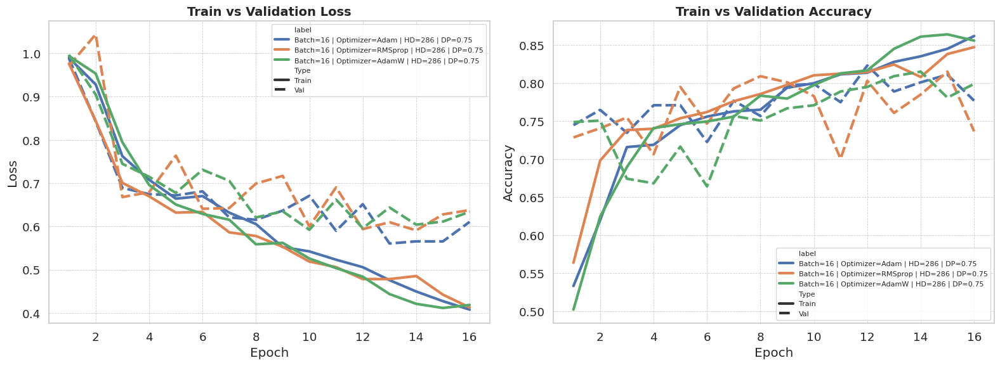

In [ ]:
df_results = pd.DataFrame(results)

df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

df_loss = pd.melt(df_results, id_vars=['epoch', 'label'],
                  value_vars=['train_loss', 'val_loss'],
                  var_name='Type', value_name='Loss')
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

df_acc = pd.melt(df_results, id_vars=['epoch', 'label'],
                 value_vars=['train_acc', 'val_acc'],
                 var_name='Type', value_name='Accuracy')
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Loss
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title='Run')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Plot Accuracy
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title='Run')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **1.1.2 Learning rate value selection**

In [ ]:
learning_rates = [1e-5, 5e-5, 1e-6]
optimizer_name = 'Adam'
optimizer_class = optim.Adam
results = []
num_epochs = 16

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for lr in learning_rates:
    print(f"\n🔹 Training with Adam optimizer, learning rate = {lr}")

    model = BiomedNLP_LSTM_Attention(BERT_DIM, HIDDEN_DIM, dropout_prob=DROPOUT).to(device)
    print(model)

    optimizer = optimizer_class(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', factor=0.5, patience=3)

    train_losses, val_losses = [], []
    train_accs, val_accs = [], []
    val_f1s = []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, train_loader, optimizer, criterion, device)
        val_acc, f1, val_loss = evaluate_model(model, val_loader, criterion, device)

        scheduler.step(f1)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"LR: {lr:.1e} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    label = f"LR={lr:.1e} | Optimizer={optimizer_name} | HD={HIDDEN_DIM} | DP={DROPOUT}"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with Adam optimizer, learning rate = 1e-05
BiomedNLP_LSTM_Attention(
  (lstm): LSTM(768, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_features=286, bias=True)
    (v): Linear(in_features=286, out_features=1, bias=False)
  )
  (fc): Linear(in_features=572, out_features=1, bias=True)
  (dropout): Dropout(p=0.75, inplace=False)
)
LR: 1.0e-05 | Epoch 1/16 - TL: 0.9964, VL: 1.0101, TA: 51.06%, VA: 63.18%, F1: 51.46%, Time: 1.52 min
LR: 1.0e-05 | Epoch 2/16 - TL: 0.9959, VL: 1.0049, TA: 51.66%, VA: 69.01%, F1: 56.25%, Time: 1.52 min
LR: 1.0e-05 | Epoch 3/16 - TL: 0.9842, VL: 0.9987, TA: 53.99%, VA: 69.01%, F1: 59.69%, Time: 1.51 min
LR: 1.0e-05 | Epoch 4/16 - TL: 0.9768, VL: 0.9922, TA: 55.75%, VA: 73.04%, F1: 61.93%, Time: 1.52 min
LR: 1.0e-05 | Epoch 5/16 - TL: 0.9726, VL: 0.9817, TA: 59.37%, VA: 71.03%, F1: 61.50%, Time: 1.52 min
LR: 1.0e-05 | Epoch 6/16 - TL: 0.9555, VL

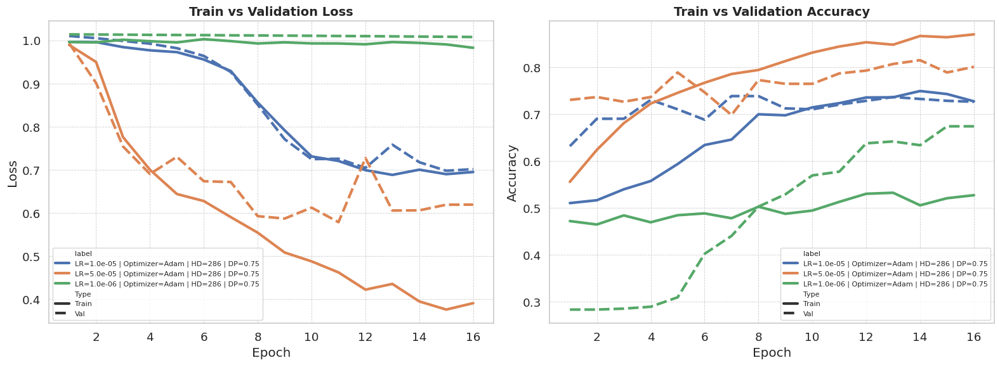

In [ ]:
df_results = pd.DataFrame(results)

df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

df_loss = pd.melt(df_results, id_vars=['epoch', 'label'],
                  value_vars=['train_loss', 'val_loss'],
                  var_name='Type', value_name='Loss')
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

df_acc = pd.melt(df_results, id_vars=['epoch', 'label'],
                 value_vars=['train_acc', 'val_acc'],
                 var_name='Type', value_name='Accuracy')
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Loss
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title='Run')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Plot Accuracy
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title='Run')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **1.1.3 Batch size value selection**

In [ ]:
batch_sizes = [8, 16, 64]
learning_rate = 2e-5
num_epochs = 16

results = []

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for batch_size in batch_sizes:
    print(f"\n🔹 Training with batch size: {batch_size}")

    # Create DataLoader with new batch size
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    model = BiomedNLP_LSTM_Attention(BERT_DIM, HIDDEN_DIM, dropout_prob=DROPOUT).to(device)
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    train_losses, val_losses = [], []
    train_accs, val_accs = [], []
    val_f1s = []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, train_loader, optimizer, criterion, device)
        val_acc, f1, val_loss = evaluate_model(model, val_loader, criterion, device)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"BS: {batch_size} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    label = f"LR={learning_rate:.1e} | Batch={batch_size} | HD={HIDDEN_DIM} | DP={DROPOUT}"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with batch size: 8
BS: 8 | Epoch 1/16 - TL: 0.9911, VL: 0.9894, TA: 56.01%, VA: 69.22%, F1: 60.05%, Time: 1.64 min
BS: 8 | Epoch 2/16 - TL: 0.9833, VL: 0.9703, TA: 54.29%, VA: 75.45%, F1: 56.43%, Time: 1.64 min
BS: 8 | Epoch 3/16 - TL: 0.9473, VL: 0.9064, TA: 61.65%, VA: 74.65%, F1: 58.28%, Time: 1.64 min
BS: 8 | Epoch 4/16 - TL: 0.8172, VL: 0.7694, TA: 70.70%, VA: 69.42%, F1: 62.19%, Time: 1.64 min
BS: 8 | Epoch 5/16 - TL: 0.7163, VL: 0.7150, TA: 73.85%, VA: 69.42%, F1: 62.93%, Time: 1.64 min
BS: 8 | Epoch 6/16 - TL: 0.6786, VL: 0.6944, TA: 75.05%, VA: 76.06%, F1: 66.48%, Time: 1.64 min
BS: 8 | Epoch 7/16 - TL: 0.6715, VL: 0.6684, TA: 74.92%, VA: 75.86%, F1: 67.03%, Time: 1.64 min
BS: 8 | Epoch 8/16 - TL: 0.6342, VL: 0.6758, TA: 76.17%, VA: 72.43%, F1: 66.17%, Time: 1.64 min
BS: 8 | Epoch 9/16 - TL: 0.6152, VL: 0.6635, TA: 77.08%, VA: 75.45%, F1: 66.48%, Time: 1.64 min
BS: 8 | Epoch 10/16 - TL: 0.6150, VL: 0.6382, TA: 77.29%, VA: 76.0

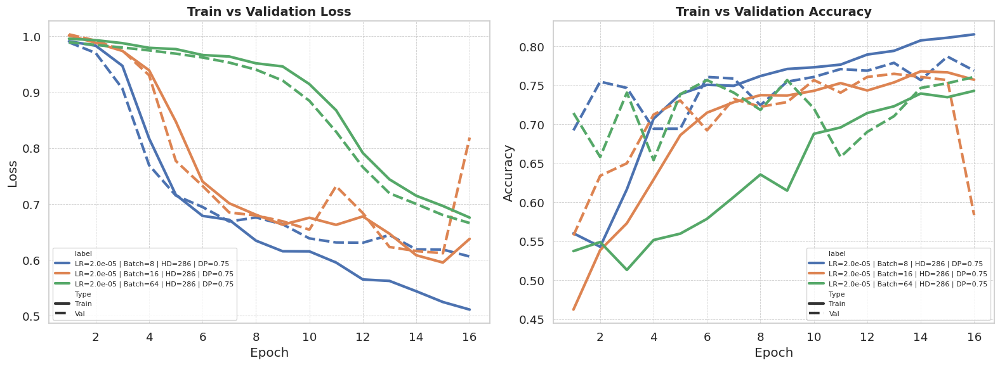

In [ ]:
df_results = pd.DataFrame(results)

df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

df_loss = pd.melt(df_results, id_vars=['epoch', 'label'],
                  value_vars=['train_loss', 'val_loss'],
                  var_name='Type', value_name='Loss')
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

df_acc = pd.melt(df_results, id_vars=['epoch', 'label'],
                 value_vars=['train_acc', 'val_acc'],
                 var_name='Type', value_name='Accuracy')
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Loss
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title='Run')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Plot Accuracy
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title='Run')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **1.1.4 Dropout value selection**

In [ ]:
hidden_dims = [286]
dropouts = [0.1, 0.4, 0.8]
learning_rate = 1e-5
batch_size = 16
num_epochs = 16
results = []

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for hidden_dim in hidden_dims:
    num_layers = 1  # fixed depth value
    for dropout in dropouts:
        print(f"\n🔹 Training with hidden_dim={hidden_dim}, num_layers={num_layers}, dropout={dropout}")

        train_loader_smote = DataLoader(train_loader, batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(val_dataset, batch_size=batch_size)

        model = BiomedNLP_LSTM_Attention(BERT_DIM, hidden_dim, num_layers=num_layers, dropout_prob=dropout).to(device)
        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        train_losses, val_losses = [], []
        train_accs, val_accs = [], []
        val_f1s = []

        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_model(model, train_loader, optimizer, criterion, device)
            val_acc, f1, val_loss = evaluate_model(model, val_loader, criterion, device)

            train_losses.append(train_loss)
            val_losses.append(val_loss)
            train_accs.append(train_acc)
            val_accs.append(val_acc)
            val_f1s.append(f1)

            print(
                f"HD: {hidden_dim} | NL: {num_layers} | DP: {dropout} | Epoch {epoch+1}/{num_epochs} - "
                f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
                f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
                f"Time: {(time.time() - start_time)/60:.2f} min"
            )

        label = f"LR={learning_rate:.1e} | BS={batch_size} | HD={hidden_dim} | NL={num_layers} | DP={dropout}"
        for epoch in range(num_epochs):
            results.append({
                "epoch": epoch + 1,
                "label": label,
                "train_loss": train_losses[epoch],
                "val_loss": val_losses[epoch],
                "train_acc": train_accs[epoch],
                "val_acc": val_accs[epoch],
                "val_f1": val_f1s[epoch]
            })

Class weights: [0.69741587 1.76636225]

🔹 Training with hidden_dim=286, num_layers=1, dropout=0.1
HD: 286 | NL: 1 | DP: 0.1 | Epoch 1/16 - TL: 0.9902, VL: 1.0075, TA: 35.93%, VA: 57.14%, F1: 55.72%, Time: 1.59 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 2/16 - TL: 0.9800, VL: 0.9979, TA: 65.40%, VA: 68.21%, F1: 60.50%, Time: 1.58 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 3/16 - TL: 0.9754, VL: 0.9850, TA: 70.27%, VA: 71.23%, F1: 63.24%, Time: 1.58 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 4/16 - TL: 0.9596, VL: 0.9649, TA: 68.20%, VA: 72.43%, F1: 63.66%, Time: 1.58 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 5/16 - TL: 0.9239, VL: 0.9148, TA: 70.40%, VA: 74.45%, F1: 65.01%, Time: 1.58 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 6/16 - TL: 0.8253, VL: 0.7941, TA: 71.56%, VA: 62.98%, F1: 59.65%, Time: 1.58 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 7/16 - TL: 0.7279, VL: 0.7152, TA: 71.69%, VA: 74.04%, F1: 63.46%, Time: 1.58 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 8/16 - TL: 0.6855, VL: 0.6845, TA: 72.68%, VA: 73.84%, F

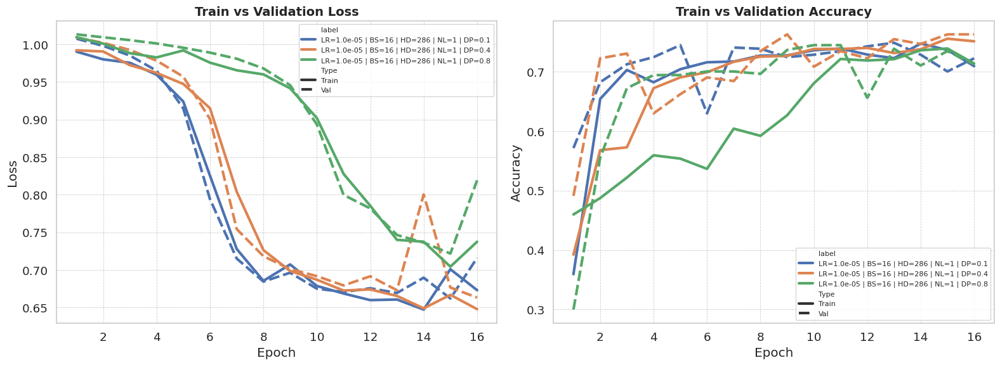

In [ ]:
df_results = pd.DataFrame(results)

df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

df_loss = pd.melt(df_results, id_vars=['epoch', 'label'],
                  value_vars=['train_loss', 'val_loss'],
                  var_name='Type', value_name='Loss')
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

df_acc = pd.melt(df_results, id_vars=['epoch', 'label'],
                 value_vars=['train_acc', 'val_acc'],
                 var_name='Type', value_name='Accuracy')
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Loss
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title='Run')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Plot Accuracy
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title='Run')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

### **1.2 Test Phase**

In [ ]:
BATCH_SIZE = 16

# --- Load Data ---
train_dataset = BiomedNLPDataset(X_train.tolist(), y_train, tokenizer)
val_dataset = BiomedNLPDataset(X_val.tolist(), y_val, tokenizer)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=BATCH_SIZE, shuffle=True)

test_dataset = BiomedNLPDataset(X_test.tolist(), y_test, tokenizer)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

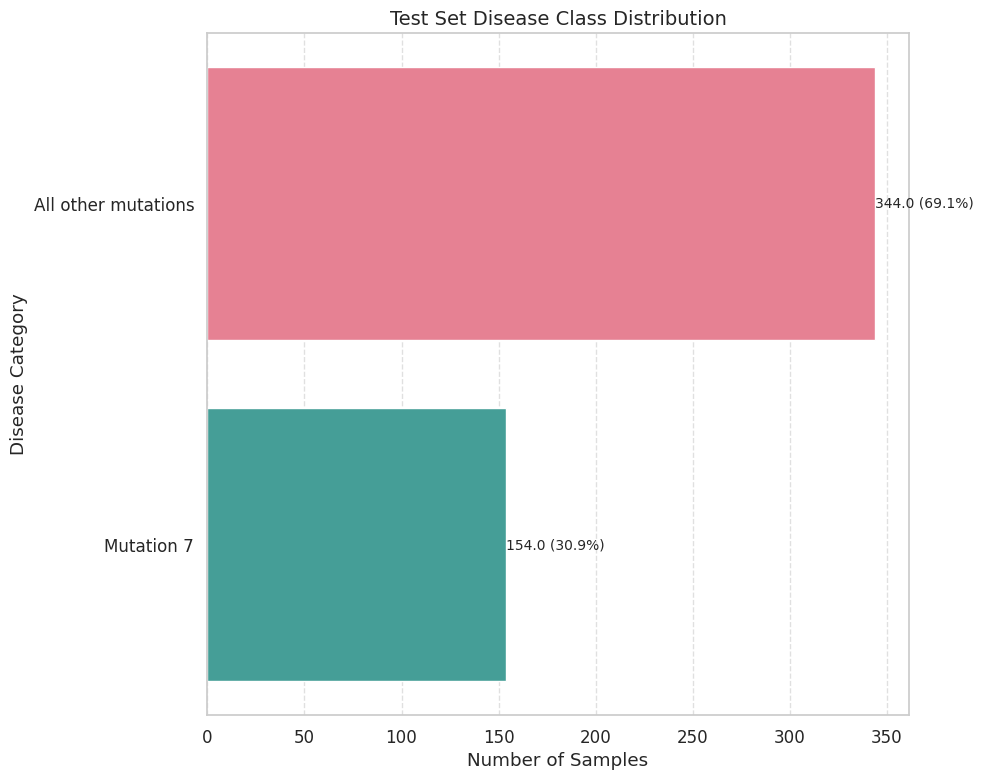

In [ ]:
disease_map  = {
    1: 'Mutation 7',
    0: 'All other mutations'
}

label_names = [disease_map[int(label)] for label in y_test]
df_test_labels = pd.DataFrame({'disease': label_names})

sns.set(style="whitegrid", palette="muted", font_scale=1.1)

fig, axes = plt.subplots(1, 1, figsize=(10, 8))
ax = sns.countplot(data=df_test_labels, y='disease', palette="husl", order=df_test_labels['disease'].value_counts().index)

total = len(y_test)
for i, p in enumerate(ax.patches):
    count = p.get_width()
    percentage = 100 * count / total
    ax.text(count, p.get_y() + p.get_height() / 2,
            f'{count} ({percentage:.1f}%)',
            va='center', ha='left', fontsize=10)

ax.set_title("Test Set Disease Class Distribution", fontsize=14)
ax.set_xlabel("Number of Samples")
ax.set_ylabel("Disease Category")

ax.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

In [17]:
# --- Model Instantiation ---
BERT_DIM = 768
HIDDEN_DIM = 286
DROPOUT = 0.8
model = BiomedNLP_LSTM_Attention(BERT_DIM, HIDDEN_DIM,num_layers=1, dropout_prob=DROPOUT).to(device)

learning_rate = 2e-5
num_epochs = 30
patience = 4
best_model_path = "best_model_weight_class.pth"

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# --- Compute Class Weights ---
class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Tracking Variables ---
train_losses, test_losses = [], []
train_accuracies, test_accuracies = [], []
test_f1s, test_balanced_accs, test_recalls, test_precisions = [], [], [], []

best_test_bal_acc = 0
patience_counter = 0
best_model_state = None

# --- Training with Early Stopping ---
with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as epoch_pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, combined_loader, optimizer, loss_function, device)
        test_loss, test_acc, test_f1, test_balanced_acc, test_recall, test_precision = test_model(
                    model, test_loader, loss_function, device)

        # Logging
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        test_losses.append(test_loss)
        test_balanced_accs.append(test_balanced_acc)
        test_f1s.append(test_f1)

        epoch_duration = time.time() - start_time

        # --- Early Stopping Logic ---
        if test_balanced_acc > best_test_bal_acc:
            best_test_bal_acc = test_balanced_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
            torch.save(best_model_state, best_model_path)
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"\nEarly stopping at epoch {epoch + 1}.")
                break

        # --- Progress Bar Update ---
        epoch_pbar.set_postfix({
            "Training Loss": f"{train_loss:.4f}",
            "Test Loss": f"{test_loss:.4f}",
            "Training Balanced Acc": f"{train_acc:.2%}",
            "Test Balanced Acc": f"{test_balanced_acc:.2%}",
            "Test F1": f"{test_f1:.2%}",
            "Test Precision": f"{test_precision:.2%}",
            "Test Recall": f"{test_recall:.2%}",
            "Time(min)": f"{epoch_duration / 60:.2f}"
        })
        epoch_pbar.update(1)

# --- Load Best Model ---
model.load_state_dict(torch.load(best_model_path))

Class weights: [0.69741587 1.76636225]


Training Progress:  97%|█████████▋| 29/30 [51:03<01:45, 105.62s/epoch, Training Loss=0.4562, Test Loss=0.6594, Training Balanced Acc=85.13%, Test Balanced Acc=81.47%, Test F1=73.49%, Test Precision=68.54%, Test Recall=79.22%, Time(min)=1.70]


Early stopping at epoch 30.


<All keys matched successfully>

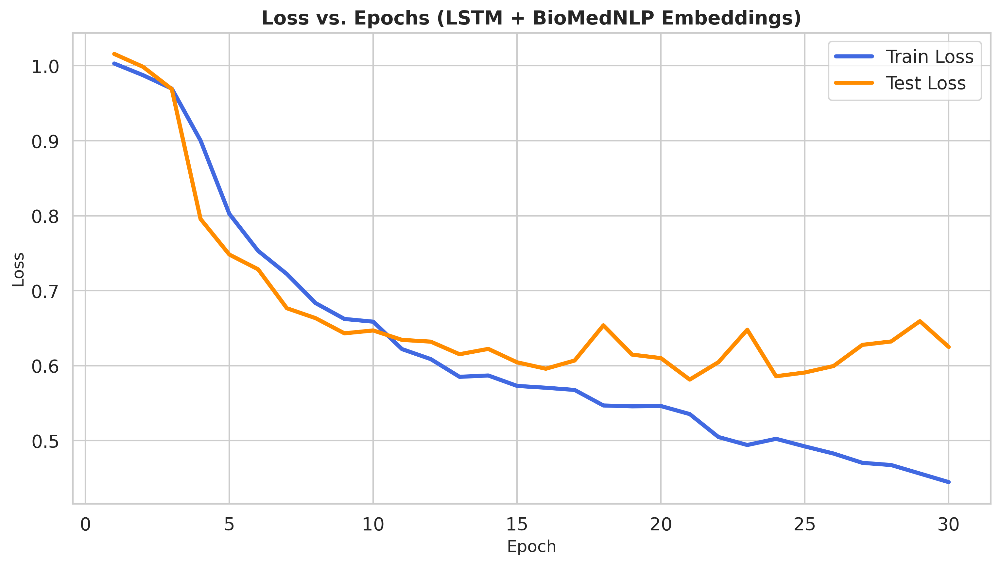

In [18]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=epochs, y=test_losses, label='Test Loss', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (LSTM + BioMedNLP Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='upper right', frameon=True)
plt.tight_layout()

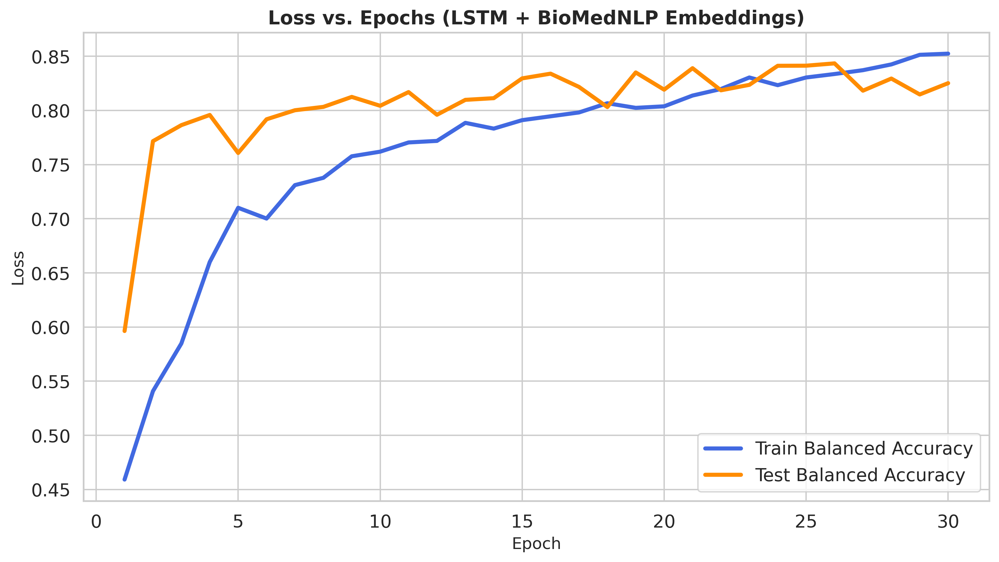

In [19]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 2. Balanced Accurcy Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_accuracies, label='Train Balanced Accuracy', color='royalblue')
sns.lineplot(x=epochs, y=test_balanced_accs, label='Test Balanced Accuracy', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (LSTM + BioMedNLP Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='lower right', frameon=True)
plt.tight_layout()

In [20]:
model = BiomedNLP_LSTM_Attention(BERT_DIM, HIDDEN_DIM, num_layers=1, dropout_prob=DROPOUT).to(device)

model.load_state_dict(torch.load("/content/best_model_weight_class.pth"))
model.eval()

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Recalculate metrics on test set ---
final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_model(
    model, test_loader, loss_function, device
)

# --- Print results ---
print("\n Final Evaluation Metrics of Best Model:")
print(f"Test Loss           : {final_test_loss:.4f}")
print(f"Test Accuracy       : {final_test_acc:.2%}")
print(f"Test F1 Score       : {final_test_f1:.2%}")
print(f"Balanced Accuracy   : {final_test_bal_acc:.2%}")
print(f"Test Precision      : {final_test_precision:.2%}")
print(f"Test Recall         : {final_test_recall:.2%}")

Class weights: [0.69741587 1.76636225]

 Final Evaluation Metrics of Best Model:
Test Loss           : 0.5996
Test Accuracy       : 82.33%
Test F1 Score       : 75.82%
Balanced Accuracy   : 84.34%
Test Precision      : 65.71%
Test Recall         : 89.61%


In [21]:
from sklearn.metrics import confusion_matrix
from collections import defaultdict

def plot_confusion_matrix(ax, y_true, y_pred, num_classes=2):
    """Plots a confusion matrix as a heatmap.
    Args:
        ax (matplotlib.axes.Axes): The axes on which to plot the confusion matrix.
        y_true (list or array): The true class labels for the test set.
        y_pred (list or array): The predicted class labels for the test set.
        num_classes (int): The number of unique classes in the dataset.
    """
    cm = confusion_matrix(y_true, y_pred, labels=range(num_classes))
    sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', xticklabels=range(num_classes), yticklabels=range(num_classes), ax=ax)
    ax.set_xlabel('Predicted')
    ax.set_ylabel('True')
    ax.set_title('Confusion Matrix')

def evaluate_and_analyze_BioMedNLP(model, test_loader, device):
    """
    Evaluates a BERT-based model (e.g., PubMedBERT) on the test dataset and performs detailed analysis.

    Args:
        model (nn.Module): Trained BERT-based model.
        test_loader (DataLoader): DataLoader that yields dictionary-style batches with input_ids, attention_mask, etc.
        device (torch.device): Device to perform evaluation on (CPU or GPU).

    Returns:
        df_results (pd.DataFrame): DataFrame with per-class success and failure rates.
        df_wrong (pd.DataFrame): Samples that were predicted incorrectly with full metadata.
        df_correct (pd.DataFrame): Samples that were predicted correctly with full metadata.
        all_labels (list): Ground truth labels for all test samples.
        all_probs (list): Predicted class probabilities for all test samples.
    """
    model.eval()
    all_labels = []
    all_preds = []
    all_probs = []
    all_texts = []

    top_correct = []
    top_wrong = []

    with torch.no_grad():
        for batch in test_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['labels'].to(device)
            texts = batch['text']

            outputs = model(input_ids, attention_mask)

            if outputs.shape[1] == 1:  # Binary classification
                probs = torch.sigmoid(outputs).squeeze(1)
                preds = (probs >= 0.5).long()
            else:
                probs = torch.softmax(outputs, dim=1)
                preds = torch.argmax(probs, dim=1)
                probs = probs[:, 1]  # Prob of class 1

            all_labels.extend(labels.cpu().numpy())
            all_preds.extend(preds.cpu().numpy())
            all_probs.extend(probs.cpu().numpy())
            all_texts.extend(texts)

            correct_indices = (preds == labels).nonzero(as_tuple=True)[0]
            wrong_indices = (preds != labels).nonzero(as_tuple=True)[0]

            for idx in correct_indices:
                top_correct.append({
                    "index": idx.item(),
                    "true_label": labels[idx].item(),
                    "predicted_label": preds[idx].item(),
                    "probability": probs[idx].item(),
                    "text": texts[idx]
                })

            for idx in wrong_indices:
                top_wrong.append({
                    "index": idx.item(),
                    "true_label": labels[idx].item(),
                    "predicted_label": preds[idx].item(),
                    "probability": probs[idx].item(),
                    "text": texts[idx]
                })

    df_correct = pd.DataFrame(top_correct)
    df_wrong = pd.DataFrame(top_wrong)
    df_results = pd.DataFrame(classification_report(all_labels, all_preds, output_dict=True)).transpose()

    return df_results, df_correct, df_wrong, all_labels, all_preds, all_probs

def plot_wrong_distributions(wrong_indices, all_labels):
    """
    Plots the distribution of wrong predictions for binary classification.
    """
    class_counts_wrong = defaultdict(int)
    for idx in wrong_indices:
        true_label = all_labels[idx]
        class_counts_wrong[true_label] += 1

    class_labels = sorted(class_counts_wrong.keys())
    counts = [class_counts_wrong[label] for label in class_labels]
    colors = sns.color_palette("husl", len(class_labels))
    class_names = ['Negative' if label == 0 else 'Positive' for label in class_labels]

    sns.set(style="whitegrid")
    plt.figure(figsize=(8, 5))
    plt.barh(class_names, counts, color=colors)
    plt.xlabel('Number of Wrong Predictions')
    plt.ylabel('Class')
    plt.title('Distribution of Wrong Predictions')

    for i, (count, name) in enumerate(zip(counts, class_names)):
        plt.text(count, i, str(count), ha='left', va='center')

    plt.show()

In [22]:
model = BiomedNLP_LSTM_Attention(BERT_DIM, HIDDEN_DIM,num_layers=1, dropout_prob=DROPOUT).to(device)
model.load_state_dict(torch.load("best_model_weight_class.pth"))

<All keys matched successfully>

In [23]:
df_results_BioMedNLP, df_correct_BioMedNLP, df_wrong_BioMedNLP, all_labels_BioMedNLP, all_pred_BioMedNLP, all_probs_BioMedNLP = evaluate_and_analyze_BioMedNLP(model, test_loader, device)

In [24]:
df_wrong_BioMedNLP.head()

,index,true_label,predicted_label,probability,text
0,3,0,1,0.808995,HRAS G12A The three-dimensional structure of t...
1,8,1,0,0.254620,MAPK1 E322K Cervical cancer is responsible for...
2,13,0,1,0.686784,CHEK2 K373E We identified CHK2 K373E as a recu...
3,15,1,0,0.018071,CDK4 R24C Many human tumors harbor mutations t...
4,2,1,0,0.275727,IL7R T244_I245insCPT Signaling mediated by IL-...


In [25]:
df_correct_BioMedNLP.tail()

,index,true_label,predicted_label,probability,text
405,12,0,0,0.092752,EPAS1 533_534del Hypoxia inducible factors (HI...
406,13,0,0,0.006842,TP53 H115N Both sequence-specific DNA binding ...
407,14,1,1,0.922067,EGFR L747_T751delinsP Non–small-cell lung canc...
408,15,1,1,0.800169,PDGFRA N659S The FIP1L1-PDGFRA fusion is seen ...
409,1,1,1,0.870360,MTOR S2215F Genes encoding components of the P...


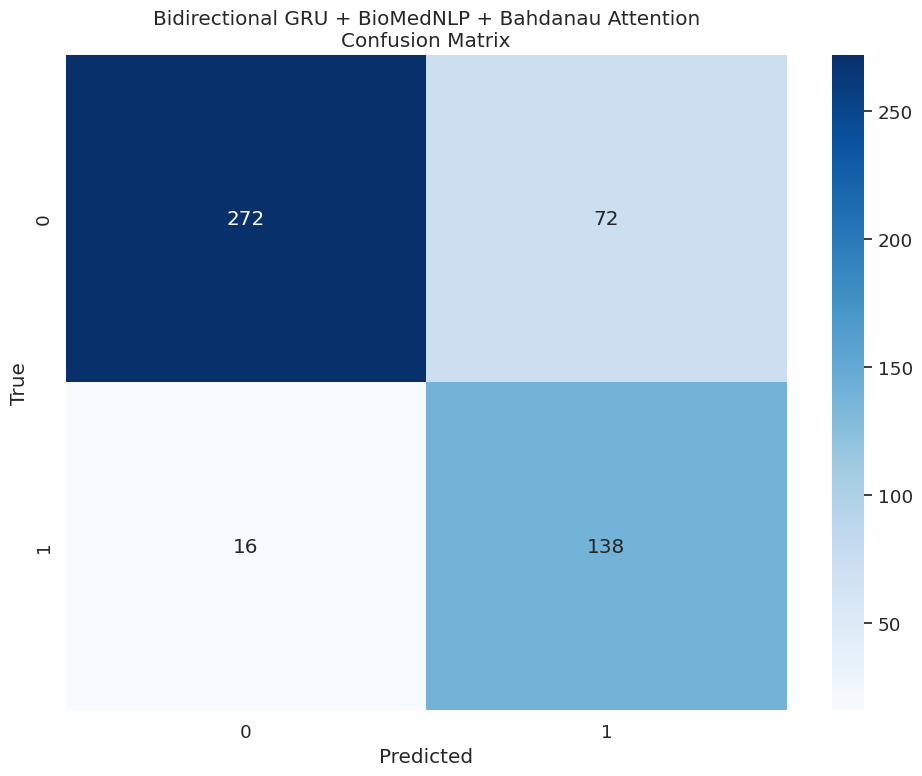

In [26]:
NUM_CLASSES = 2

fig, axes = plt.subplots(1, 1, figsize=(10, 8))

plot_confusion_matrix(axes, all_labels_BioMedNLP, all_pred_BioMedNLP)
axes.set_title("Bidirectional GRU + BioMedNLP + Bahdanau Attention\nConfusion Matrix")

plt.tight_layout()
plt.show()

In [27]:
from sklearn.metrics import roc_curve, auc

y_true_BioMedNLP = np.array(all_labels_BioMedNLP)
y_scores_BioMedNLP  = np.array(all_probs_BioMedNLP)

fpr_BioMedNLP , tpr_BioMedNLP , _ = roc_curve(y_true_BioMedNLP , y_scores_BioMedNLP )
roc_auc_BioMedNLP  = auc(fpr_BioMedNLP , tpr_BioMedNLP )

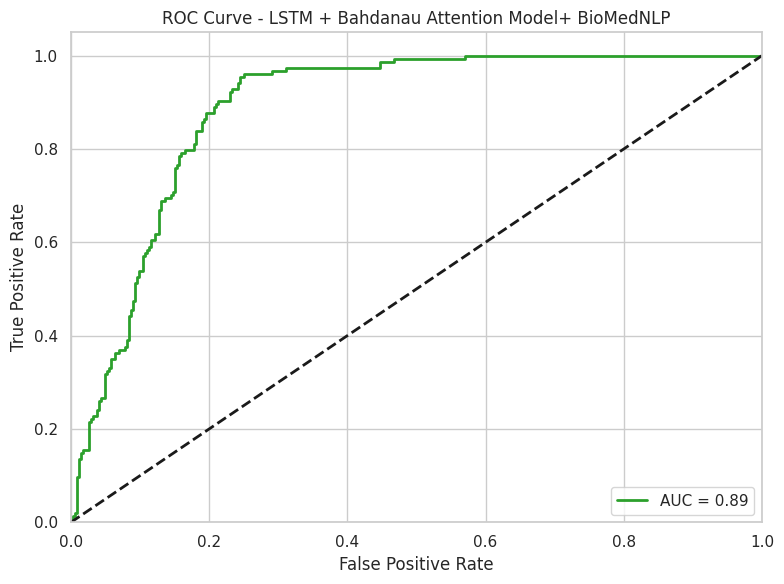

In [28]:
sns.set(style="whitegrid")

# One plot only
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

ax.plot(fpr_BioMedNLP, tpr_BioMedNLP, lw=2,
        label=f'AUC = {roc_auc_BioMedNLP:.2f}', color='tab:green')
ax.plot([0, 1], [0, 1], 'k--', lw=2)
ax.set_xlim([0.0, 1.0])
ax.set_ylim([0.0, 1.05])
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_title('ROC Curve - LSTM + Bahdanau Attention Model+ BioMedNLP')
ax.legend(loc='lower right')
ax.grid(True)

plt.tight_layout()
plt.show()

### **1.3 Few Shot Learning**

In [ ]:
# Helper: select exactly k examples per class from the original training set
def get_k_shot_data_from_original(dataset, k, num_classes):
    X_k, y_k = [], []
    for cls in range(num_classes):
        cls_indices = [i for i, d in enumerate(dataset) if d['labels'].item() == cls]
        chosen = np.random.choice(cls_indices, size=min(k, len(cls_indices)), replace=False)
        for idx in chosen:
            X_k.append(dataset[idx]['text'])
            y_k.append(dataset[idx]['labels'].item())
    return X_k, np.array(y_k)

In [ ]:
BATCH_SIZE = 64

# --- Load Data ---
train_dataset = BiomedNLPDataset(X_train.tolist(), y_train, tokenizer)
val_dataset = BiomedNLPDataset(X_val.tolist(), y_val, tokenizer)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=BATCH_SIZE, shuffle=True)

test_dataset = BiomedNLPDataset(X_test.tolist(), y_test, tokenizer)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [ ]:
k_values = range(1, 11)  # Few-shot from k=1 to 10
NUM_CLASSES = 2
BERT_DIM = 768
HIDDEN_DIM = 286
DROPOUT = 0.1

model_metrics = {
    "K-shot": [],
    "Model": [],
    "Test Accuracy": [],
    "F1": [],
    "Balanced Accuracy": [],
    "Recall": [],
    "Precision": []
}

patience = 4
num_epochs = 20
for k in k_values:
    print(f"\n--- K-Shot = {k} ---")

    X_kshot, y_kshot = get_k_shot_data_from_original(combined_dataset, k, NUM_CLASSES)
    kshot_dataset = BiomedNLPDataset(X_kshot, y_kshot, tokenizer)
    kshot_loader = DataLoader(kshot_dataset, batch_size=BATCH_SIZE, shuffle=True)

    model = BiomedNLP_LSTM_Attention(BERT_DIM, HIDDEN_DIM, num_layers=1, dropout_prob=DROPOUT).to(device)
    print(f"{count_parameters(model)} model parameters")
    print()
    print(model)

    learning_rate = 1e-4
    optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)

    class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
    print(f"Class weights: {class_weights}")

    pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
    loss_function = torch.nn.BCEWithLogitsLoss()

    # Train with early stopping
    best_val_acc = 0
    patience_counter = 0
    for epoch in range(num_epochs):
        train_loss, train_acc = train_model(model, kshot_loader, optimizer, loss_function, device)
        val_acc, val_f1, val_loss = evaluate_model(model, test_loader, loss_function, device)

        print(f"K={k} | Epoch {epoch+1}/{num_epochs} "
              f"- Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, "
              f"Test Loss: {val_loss:.4f}, Test Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                break

    # Load best model
    model.load_state_dict(best_model_state)

    # Evaluate on test set
    avg_loss, avg_accuracy, f1, balanced_acc, recall, precision = test_model(model, test_loader, loss_function, device)

    # Log metrics
    print(f"Test Accuracy: {avg_accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"Balanced Accuracy: {balanced_acc:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"Precision: {precision:.4f}")

    model_metrics["K-shot"].append(k)
    model_metrics["Model"].append("LSTM-BioMedNLP")
    model_metrics["Test Accuracy"].append(avg_accuracy)
    model_metrics["F1"].append(f1)
    model_metrics["Balanced Accuracy"].append(balanced_acc)
    model_metrics["Recall"].append(recall)
    model_metrics["Precision"].append(precision)

# Convert results to DataFrame
df = pd.DataFrame(model_metrics)


--- K-Shot = 1 ---
2580865 model parameters

BiomedNLP_LSTM_Attention(
  (lstm): LSTM(768, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_features=286, bias=True)
    (v): Linear(in_features=286, out_features=1, bias=False)
  )
  (fc): Linear(in_features=572, out_features=1, bias=True)
  (dropout): Dropout(p=0.1, inplace=False)
)
Class weights: [0.69741587 1.76636225]
K=1 | Epoch 1/20 - Train Loss: 0.6883, Train Acc: 0.5000, Test Loss: 0.7046, Test Acc: 0.3173, Val F1: 0.4737
K=1 | Epoch 2/20 - Train Loss: 0.6089, Train Acc: 1.0000, Test Loss: 0.6621, Test Acc: 0.6807, Val F1: 0.0245
K=1 | Epoch 3/20 - Train Loss: 0.5720, Train Acc: 1.0000, Test Loss: 0.7136, Test Acc: 0.3133, Val F1: 0.4639
K=1 | Epoch 4/20 - Train Loss: 0.5669, Train Acc: 1.0000, Test Loss: 0.6644, Test Acc: 0.6988, Val F1: 0.4485
K=1 | Epoch 5/20 - Train Loss: 0.4245, Train Acc: 1.0000, Test Loss: 0.7617, Test Acc: 0.3153, Val F1: 0.4713
K=1 | Epoch

In [ ]:
# --- Plotting ---
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
palette = sns.color_palette("Set2")

def plot_model_performance(df, model_name, color, title_prefix="Model Performance"):
    model_df = df[df["Model"] == model_name]
    metrics_to_plot = ["F1", "Balanced Accuracy", "Recall", "Precision"]

    fig, axes = plt.subplots(2, 2, figsize=(14, 10), sharex=True)
    axes = axes.flatten()

    for i, metric in enumerate(metrics_to_plot):
        sns.lineplot(
            data=model_df,
            x="K-shot",
            y=metric,
            ax=axes[i],
            color=color,
            marker="o",
            linewidth=2.2,
            markersize=6,
        )
        axes[i].set_title(metric, fontsize=14)
        axes[i].set_xlabel("K-shot")
        axes[i].set_ylabel(metric)
        axes[i].grid(True)

    plt.suptitle(f"{title_prefix} for {model_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

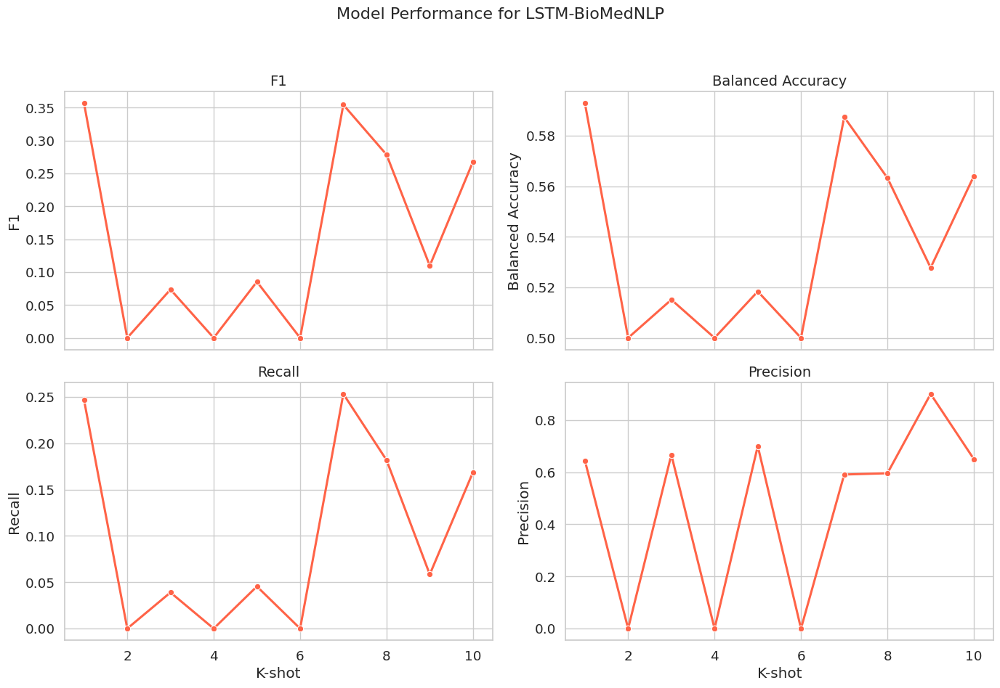

In [ ]:
# Plot results
plot_model_performance(df, "LSTM-BioMedNLP", "tomato")

Maximum values per metric:
Balanced Accuracy: 0.5929 (at K-shot = 1)
F1: 0.3568 (at K-shot = 1)
Recall: 0.2532 (at K-shot = 7)
Precision: 0.9000 (at K-shot = 9)


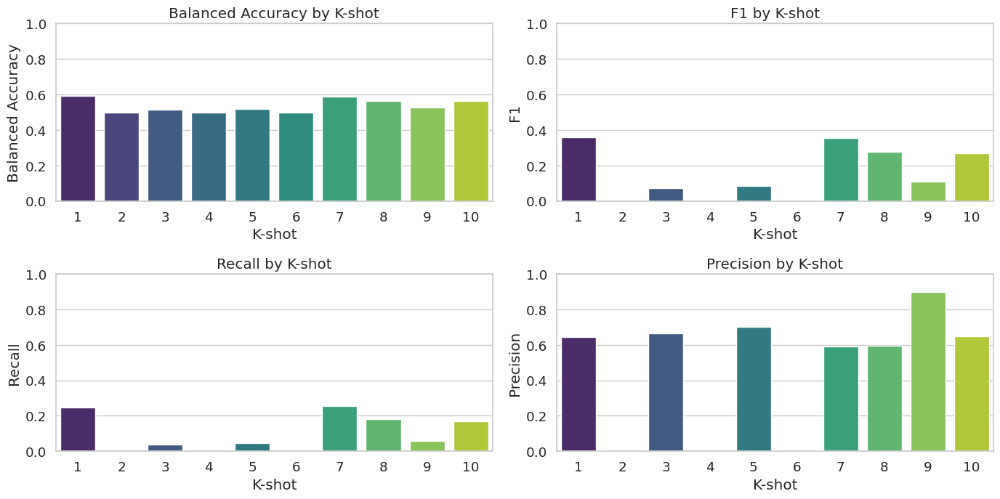

In [ ]:
metrics = ["Balanced Accuracy", "F1", "Recall", "Precision"]

# Print max values for each metric
print("Maximum values per metric:")
for metric in metrics:
    max_val = df[metric].max()
    max_k = df.loc[df[metric].idxmax(), "K-shot"]
    print(f"{metric}: {max_val:.4f} (at K-shot = {max_k})")

# Then plot the histograms
plt.figure(figsize=(14, 10))

for i, metric in enumerate(metrics, 1):
    plt.subplot(3, 2, i)
    sns.barplot(x="K-shot", y=metric, data=df, palette="viridis")
    plt.title(f"{metric} by K-shot")
    plt.ylim(0, 1)
    plt.xlabel("K-shot")
    plt.ylabel(metric)

plt.tight_layout()
plt.show()

## **2. Bidirectional GRU + BioMedNLP + Bahdanau Attention + Weight Class**

### **2.1 Optimization Phase**

#### **2.1.1 Optimizer selection**

In [ ]:
num_epochs = 16
learning_rate = 5e-5

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

results = []

optimizers = {
    'Adam': optim.Adam,
    'RMSprop': optim.RMSprop,
    'AdamW': optim.AdamW
}

all_train_losses = {}
all_val_losses = {}
all_train_accs = {}
all_val_accs = {}

for optimizer_name, optimizer_class in optimizers.items():
    print(f"\n🔹 Training with optimizer: {optimizer_name}")

    model = BiomedNLP_GRU_Attention(BERT_DIM, HIDDEN_DIM, dropout_prob=DROPOUT).to(device)
    print(model)

    optimizer = optimizer_class(model.parameters(), lr=learning_rate)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', factor=0.5, patience=3)

    num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total trainable parameters: {num_params}")

    train_losses, val_losses = [], []
    train_accs, val_accs = [], []
    val_f1s = []
    best_val_loss = float('inf')

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, train_loader, optimizer, criterion, device)
        train_losses.append(train_loss)
        train_accs.append(train_acc)

        val_acc, f1, val_loss = evaluate_model(model, val_loader, criterion, device)
        val_accs.append(val_acc)
        val_losses.append(val_loss)
        val_f1s.append(f1)

        scheduler.step(f1)

        end_time = time.time()
        duration = end_time - start_time

        print(
            f"Opt: {optimizer_name} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {duration/60:.2f} min"
        )

    all_train_losses[optimizer_name] = train_losses
    all_val_losses[optimizer_name] = val_losses
    all_train_accs[optimizer_name] = train_accs
    all_val_accs[optimizer_name] = val_accs

    label = f"Batch={BATCH_SIZE} | Optimizer={optimizer_name} | HD={HIDDEN_DIM} | DP={DROPOUT}"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with optimizer: Adam
BiomedNLP_GRU_Attention(
  (gru): GRU(768, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_features=286, bias=True)
    (v): Linear(in_features=286, out_features=1, bias=False)
  )
  (fc): Linear(in_features=572, out_features=1, bias=True)
  (dropout): Dropout(p=0.8, inplace=False)
)
Total trainable parameters: 1976833
Opt: Adam | Epoch 1/16 - TL: 1.0469, VL: 0.9807, TA: 48.17%, VA: 71.23%, F1: 57.57%, Time: 1.36 min
Opt: Adam | Epoch 2/16 - TL: 1.0034, VL: 0.9663, TA: 52.69%, VA: 76.46%, F1: 51.45%, Time: 1.36 min
Opt: Adam | Epoch 3/16 - TL: 0.9906, VL: 0.9479, TA: 54.76%, VA: 61.77%, F1: 57.40%, Time: 1.35 min
Opt: Adam | Epoch 4/16 - TL: 0.9640, VL: 0.9200, TA: 58.68%, VA: 72.43%, F1: 63.27%, Time: 1.35 min
Opt: Adam | Epoch 5/16 - TL: 0.9285, VL: 0.8685, TA: 61.44%, VA: 73.04%, F1: 64.36%, Time: 1.35 min
Opt: Adam | Epoch 6/16 - TL: 0.8618, VL: 

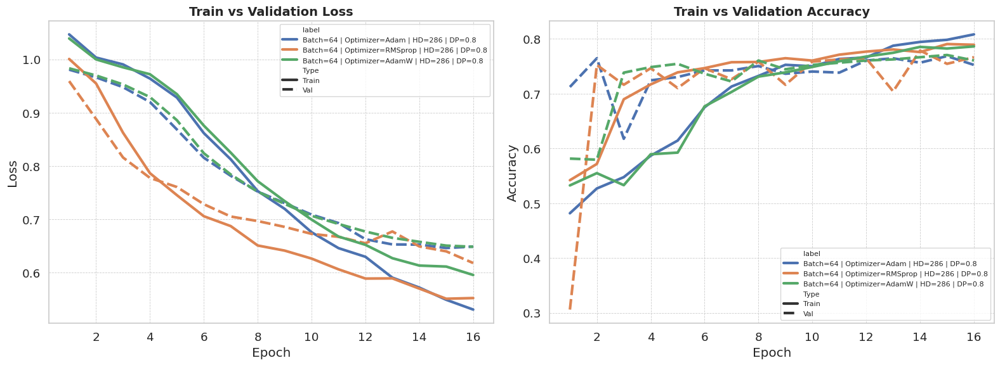

In [ ]:
df_results = pd.DataFrame(results)

df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

df_loss = pd.melt(df_results, id_vars=['epoch', 'label'],
                  value_vars=['train_loss', 'val_loss'],
                  var_name='Type', value_name='Loss')
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

df_acc = pd.melt(df_results, id_vars=['epoch', 'label'],
                 value_vars=['train_acc', 'val_acc'],
                 var_name='Type', value_name='Accuracy')
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Loss
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title='Run')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Plot Accuracy
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title='Run')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **2.1.2 Learning rate value selection**

In [ ]:
learning_rates = [1e-5, 5e-5, 1e-6]
optimizer_name = 'Adam'
optimizer_class = optim.Adam
results = []
num_epochs = 16

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for lr in learning_rates:
    print(f"\n🔹 Training with Adam optimizer, learning rate = {lr}")

    model = BiomedNLP_GRU_Attention(BERT_DIM, HIDDEN_DIM, dropout_prob=DROPOUT).to(device)
    print(model)

    optimizer = optimizer_class(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', factor=0.5, patience=3)

    train_losses, val_losses = [], []
    train_accs, val_accs = [], []
    val_f1s = []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, train_loader, optimizer, criterion, device)
        val_acc, f1, val_loss = evaluate_model(model, val_loader, criterion, device)

        scheduler.step(f1)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"LR: {lr:.1e} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    label = f"LR={lr:.1e} | Optimizer={optimizer_name} | HD={HIDDEN_DIM} | DP={DROPOUT}"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with Adam optimizer, learning rate = 1e-05
BiomedNLP_GRU_Attention(
  (gru): GRU(768, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_features=286, bias=True)
    (v): Linear(in_features=286, out_features=1, bias=False)
  )
  (fc): Linear(in_features=572, out_features=1, bias=True)
  (dropout): Dropout(p=0.8, inplace=False)
)
LR: 1.0e-05 | Epoch 1/16 - TL: 1.0371, VL: 0.9903, TA: 48.34%, VA: 50.50%, F1: 48.32%, Time: 1.36 min
LR: 1.0e-05 | Epoch 2/16 - TL: 1.0128, VL: 0.9876, TA: 52.65%, VA: 69.01%, F1: 33.62%, Time: 1.36 min
LR: 1.0e-05 | Epoch 3/16 - TL: 1.0146, VL: 0.9850, TA: 52.18%, VA: 72.03%, F1: 36.53%, Time: 1.36 min
LR: 1.0e-05 | Epoch 4/16 - TL: 1.0275, VL: 0.9820, TA: 50.45%, VA: 69.01%, F1: 53.89%, Time: 1.36 min
LR: 1.0e-05 | Epoch 5/16 - TL: 1.0150, VL: 0.9791, TA: 51.79%, VA: 71.03%, F1: 61.70%, Time: 1.35 min
LR: 1.0e-05 | Epoch 6/16 - TL: 1.0043, VL: 0.

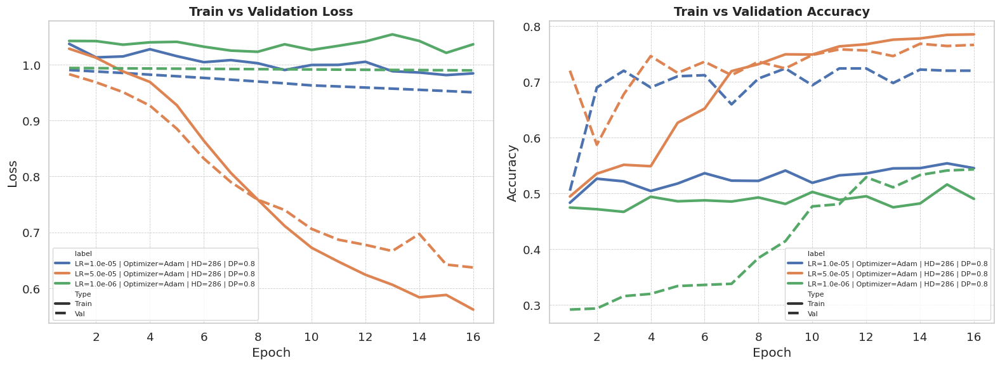

In [ ]:
df_results = pd.DataFrame(results)

df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

df_loss = pd.melt(df_results, id_vars=['epoch', 'label'],
                  value_vars=['train_loss', 'val_loss'],
                  var_name='Type', value_name='Loss')
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

df_acc = pd.melt(df_results, id_vars=['epoch', 'label'],
                 value_vars=['train_acc', 'val_acc'],
                 var_name='Type', value_name='Accuracy')
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Loss
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title='Run')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Plot Accuracy
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title='Run')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **2.1.3 Batch size value selection**

In [ ]:
batch_sizes = [8, 16, 64]
learning_rate = 2e-5
num_epochs = 16

results = []

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for batch_size in batch_sizes:
    print(f"\n🔹 Training with batch size: {batch_size}")

    # Create DataLoader with new batch size
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    model = BiomedNLP_GRU_Attention(BERT_DIM, HIDDEN_DIM, dropout_prob=DROPOUT).to(device)
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    train_losses, val_losses = [], []
    train_accs, val_accs = [], []
    val_f1s = []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, train_loader, optimizer, criterion, device)
        val_acc, f1, val_loss = evaluate_model(model, val_loader, criterion, device)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"BS: {batch_size} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    label = f"LR={learning_rate:.1e} | Batch={batch_size} | HD={HIDDEN_DIM} | DP={DROPOUT}"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with batch size: 8
BS: 8 | Epoch 1/16 - TL: 1.0155, VL: 0.9858, TA: 54.24%, VA: 75.05%, F1: 56.34%, Time: 1.56 min
BS: 8 | Epoch 2/16 - TL: 0.9954, VL: 0.9628, TA: 55.15%, VA: 75.05%, F1: 64.57%, Time: 1.56 min
BS: 8 | Epoch 3/16 - TL: 0.9690, VL: 0.9199, TA: 57.65%, VA: 75.86%, F1: 66.48%, Time: 1.55 min
BS: 8 | Epoch 4/16 - TL: 0.8817, VL: 0.8413, TA: 65.62%, VA: 71.83%, F1: 62.37%, Time: 1.55 min
BS: 8 | Epoch 5/16 - TL: 0.8192, VL: 0.7928, TA: 70.44%, VA: 74.04%, F1: 64.27%, Time: 1.55 min
BS: 8 | Epoch 6/16 - TL: 0.7645, VL: 0.7575, TA: 72.90%, VA: 77.06%, F1: 67.43%, Time: 1.55 min
BS: 8 | Epoch 7/16 - TL: 0.7137, VL: 0.7305, TA: 74.67%, VA: 76.26%, F1: 66.85%, Time: 1.56 min
BS: 8 | Epoch 8/16 - TL: 0.6778, VL: 0.7163, TA: 76.39%, VA: 76.06%, F1: 65.90%, Time: 1.55 min
BS: 8 | Epoch 9/16 - TL: 0.6633, VL: 0.6970, TA: 75.53%, VA: 74.85%, F1: 66.31%, Time: 1.55 min
BS: 8 | Epoch 10/16 - TL: 0.6341, VL: 0.6828, TA: 76.56%, VA: 77.0

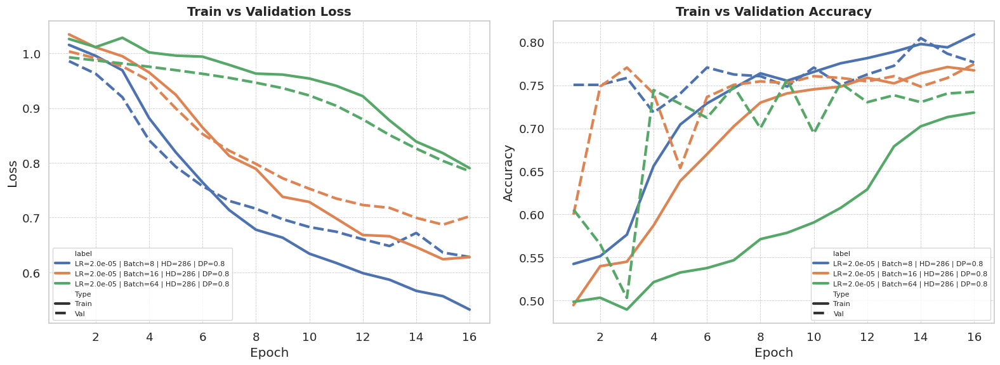

In [ ]:
df_results = pd.DataFrame(results)

df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

df_loss = pd.melt(df_results, id_vars=['epoch', 'label'],
                  value_vars=['train_loss', 'val_loss'],
                  var_name='Type', value_name='Loss')
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

df_acc = pd.melt(df_results, id_vars=['epoch', 'label'],
                 value_vars=['train_acc', 'val_acc'],
                 var_name='Type', value_name='Accuracy')
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Loss
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title='Run')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Plot Accuracy
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title='Run')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **2.1.4 Dropout value selection**

In [ ]:
hidden_dims = [286]
dropouts = [0.1, 0.4, 0.8]
learning_rate = 1e-5
batch_size = 16
num_epochs = 16
results = []

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for hidden_dim in hidden_dims:
    num_layers = 1  # fixed depth value
    for dropout in dropouts:
        print(f"\n🔹 Training with hidden_dim={hidden_dim}, num_layers={num_layers}, dropout={dropout}")

        train_loader_smote = DataLoader(train_loader, batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(val_dataset, batch_size=batch_size)

        model = BiomedNLP_LSTM_Attention(BERT_DIM, hidden_dim, num_layers=num_layers, dropout_prob=dropout).to(device)
        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        train_losses, val_losses = [], []
        train_accs, val_accs = [], []
        val_f1s = []

        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_model(model, train_loader, optimizer, criterion, device)
            val_acc, f1, val_loss = evaluate_model(model, val_loader, criterion, device)

            train_losses.append(train_loss)
            val_losses.append(val_loss)
            train_accs.append(train_acc)
            val_accs.append(val_acc)
            val_f1s.append(f1)

            print(
                f"HD: {hidden_dim} | NL: {num_layers} | DP: {dropout} | Epoch {epoch+1}/{num_epochs} - "
                f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
                f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
                f"Time: {(time.time() - start_time)/60:.2f} min"
            )

        label = f"LR={learning_rate:.1e} | BS={batch_size} | HD={hidden_dim} | NL={num_layers} | DP={dropout}"
        for epoch in range(num_epochs):
            results.append({
                "epoch": epoch + 1,
                "label": label,
                "train_loss": train_losses[epoch],
                "val_loss": val_losses[epoch],
                "train_acc": train_accs[epoch],
                "val_acc": val_accs[epoch],
                "val_f1": val_f1s[epoch]
            })

Class weights: [0.69741587 1.76636225]

🔹 Training with hidden_dim=286, num_layers=1, dropout=0.1
HD: 286 | NL: 1 | DP: 0.1 | Epoch 1/16 - TL: 0.9938, VL: 1.0129, TA: 49.29%, VA: 39.24%, F1: 47.39%, Time: 1.39 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 2/16 - TL: 0.9889, VL: 1.0093, TA: 49.25%, VA: 55.73%, F1: 55.10%, Time: 1.39 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 3/16 - TL: 0.9855, VL: 1.0062, TA: 55.36%, VA: 69.82%, F1: 60.32%, Time: 1.39 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 4/16 - TL: 0.9793, VL: 1.0024, TA: 67.38%, VA: 71.43%, F1: 62.03%, Time: 1.39 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 5/16 - TL: 0.9800, VL: 0.9974, TA: 60.71%, VA: 64.99%, F1: 60.27%, Time: 1.39 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 6/16 - TL: 0.9739, VL: 0.9938, TA: 66.91%, VA: 72.84%, F1: 62.60%, Time: 1.39 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 7/16 - TL: 0.9664, VL: 0.9886, TA: 70.83%, VA: 72.23%, F1: 62.50%, Time: 1.39 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 8/16 - TL: 0.9645, VL: 0.9825, TA: 69.84%, VA: 72.23%, F

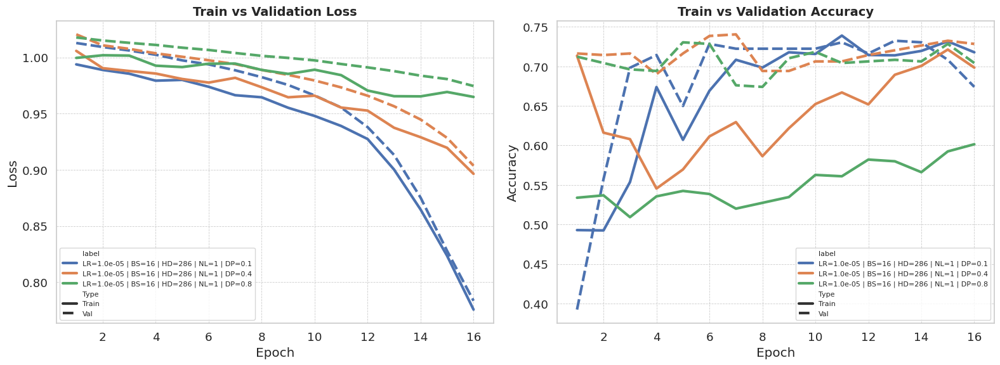

In [ ]:
df_results = pd.DataFrame(results)

df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

df_loss = pd.melt(df_results, id_vars=['epoch', 'label'],
                  value_vars=['train_loss', 'val_loss'],
                  var_name='Type', value_name='Loss')
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

df_acc = pd.melt(df_results, id_vars=['epoch', 'label'],
                 value_vars=['train_acc', 'val_acc'],
                 var_name='Type', value_name='Accuracy')
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Loss
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title='Run')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Plot Accuracy
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title='Run')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

### **2.2 Test Phase**

In [ ]:
BATCH_SIZE = 16

# --- Load Data ---
train_dataset = BiomedNLPDataset(X_train.tolist(), y_train, tokenizer)
val_dataset = BiomedNLPDataset(X_val.tolist(), y_val, tokenizer)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=BATCH_SIZE, shuffle=True)

test_dataset = BiomedNLPDataset(X_test.tolist(), y_test, tokenizer)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [29]:
BERT_DIM = 768
HIDDEN_DIM = 286
DROPOUT = 0.5

# --- Model Instantiation ---
model = BiomedNLP_GRU_Attention(BERT_DIM, HIDDEN_DIM,num_layers=1, dropout_prob=DROPOUT).to(device)

learning_rate = 1e-5
num_epochs = 30
patience = 4
best_model_path = "best_model2.pth"

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# --- Compute Class Weights ---
class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Tracking Variables ---
train_losses, test_losses = [], []
train_accuracies, test_accuracies = [], []
test_f1s, test_balanced_accs, test_recalls, test_precisions = [], [], [], []

best_test_bal_acc = 0
patience_counter = 0
best_model_state = None

# --- Training with Early Stopping ---
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-6
)

# --- Training with Early Stopping ---
with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as epoch_pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, combined_loader, optimizer, loss_function, device)
        test_loss, test_acc, test_f1, test_balanced_acc, test_recall, test_precision = test_model(
                    model, test_loader, loss_function, device)

        # Logging
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        test_losses.append(test_loss)
        test_balanced_accs.append(test_balanced_acc)
        test_f1s.append(test_f1)

        # === Step scheduler based on test performance ===
        scheduler.step(test_balanced_acc)

        epoch_duration = time.time() - start_time

        # Early Stopping Logic
        if test_balanced_acc > best_test_bal_acc:
            best_test_bal_acc = test_balanced_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
            torch.save(best_model_state, best_model_path)
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"\nEarly stopping at epoch {epoch + 1}.")
                break

        epoch_pbar.set_postfix({
            "Training Loss": f"{train_loss:.4f}",
            "Test Loss": f"{test_loss:.4f}",
            "Train Balanced Acc": f"{train_acc:.2%}",
            "Test Balanced Acc": f"{test_balanced_acc:.2%}",
            "Test F1": f"{test_f1:.2%}",
            "Test Precision": f"{test_precision:.2%}",
            "Test Recall": f"{test_recall:.2%}",
            "Time(min)": f"{epoch_duration / 60:.2f}"
        })
        epoch_pbar.update(1)

# --- Load Best Model ---
model.load_state_dict(torch.load(best_model_path))

Class weights: [0.69741587 1.76636225]


Training Progress:  30%|███       | 9/30 [16:43<39:01, 111.52s/epoch, Training Loss=0.7636, Test Loss=0.7667, Train Balanced Acc=73.95%, Test Balanced Acc=76.68%, Test F1=67.05%, Test Precision=59.60%, Test Recall=76.62%, Time(min)=1.67]


Early stopping at epoch 10.


<All keys matched successfully>

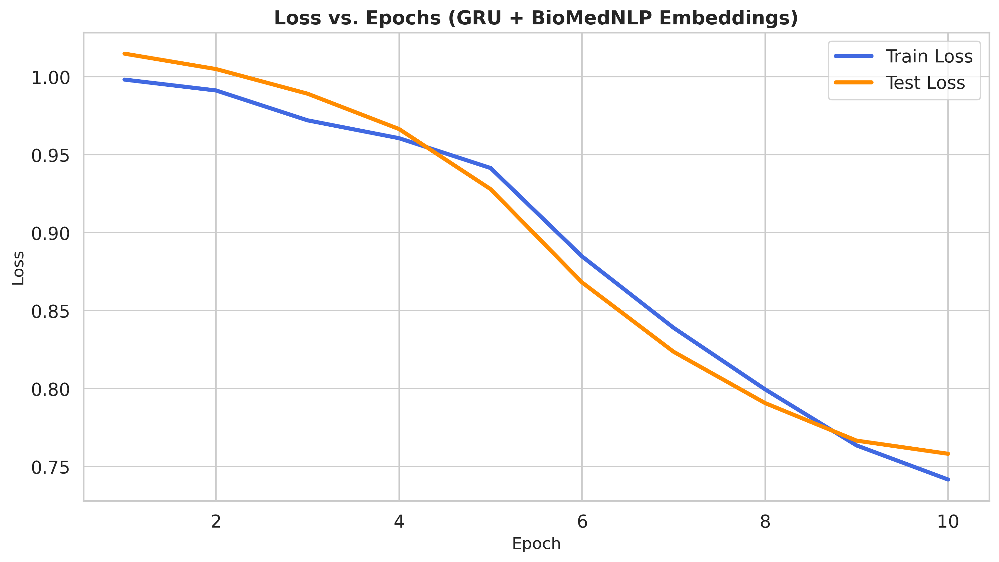

In [30]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=epochs, y=test_losses, label='Test Loss', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (GRU + BioMedNLP Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='upper right', frameon=True)
plt.tight_layout()

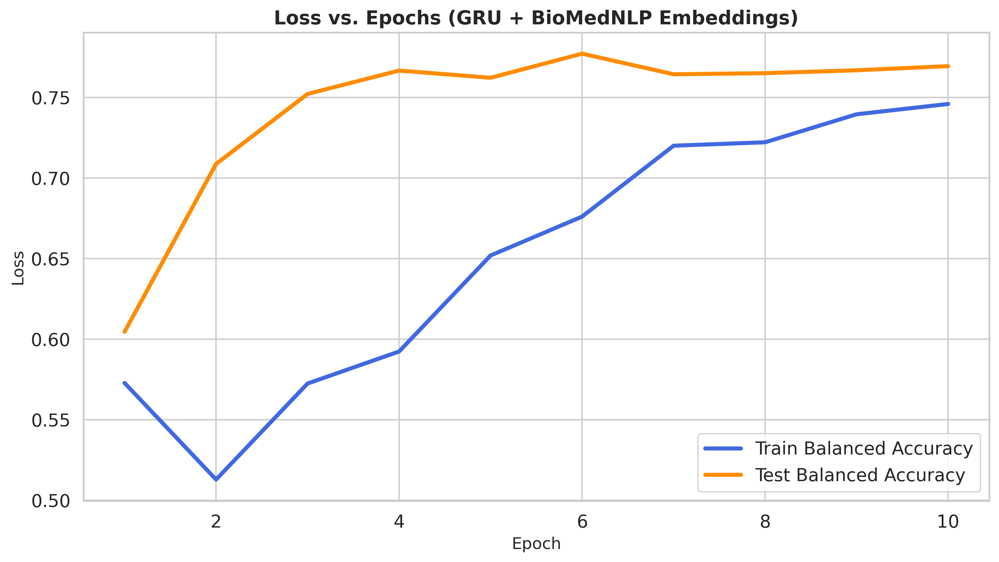

In [31]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 2. Balanced Accurcy Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_accuracies, label='Train Balanced Accuracy', color='royalblue')
sns.lineplot(x=epochs, y=test_balanced_accs, label='Test Balanced Accuracy', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (GRU + BioMedNLP Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='lower right', frameon=True)
plt.tight_layout()

In [32]:
model = BiomedNLP_GRU_Attention(BERT_DIM, HIDDEN_DIM, num_layers=1, dropout_prob=DROPOUT).to(device)

model.load_state_dict(torch.load("/content/best_model2.pth"))
model.eval()

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Recalculate metrics on test set ---
final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_model(
    model, test_loader, loss_function, device
)

# --- Print results ---
print("\n Final Evaluation Metrics of Best Model:")
print(f"Test Loss           : {final_test_loss:.4f}")
print(f"Test Accuracy       : {final_test_acc:.2%}")
print(f"Test F1 Score       : {final_test_f1:.2%}")
print(f"Balanced Accuracy   : {final_test_bal_acc:.2%}")
print(f"Test Precision      : {final_test_precision:.2%}")
print(f"Test Recall         : {final_test_recall:.2%}")

Class weights: [0.69741587 1.76636225]

 Final Evaluation Metrics of Best Model:
Test Loss           : 0.8681
Test Accuracy       : 75.90%
Test F1 Score       : 67.91%
Balanced Accuracy   : 77.72%
Test Precision      : 57.73%
Test Recall         : 82.47%


In [33]:
model = BiomedNLP_GRU_Attention(BERT_DIM, HIDDEN_DIM,num_layers=1, dropout_prob=DROPOUT).to(device)
model.load_state_dict(torch.load("/content/best_model2.pth"))

<All keys matched successfully>

In [34]:
df_results_BioMedNLP, df_correct_BioMedNLP, df_wrong_BioMedNLP, all_labels_BioMedNLP, all_pred_BioMedNLP, all_probs_BioMedNLP = evaluate_and_analyze_BioMedNLP(model, test_loader, device)

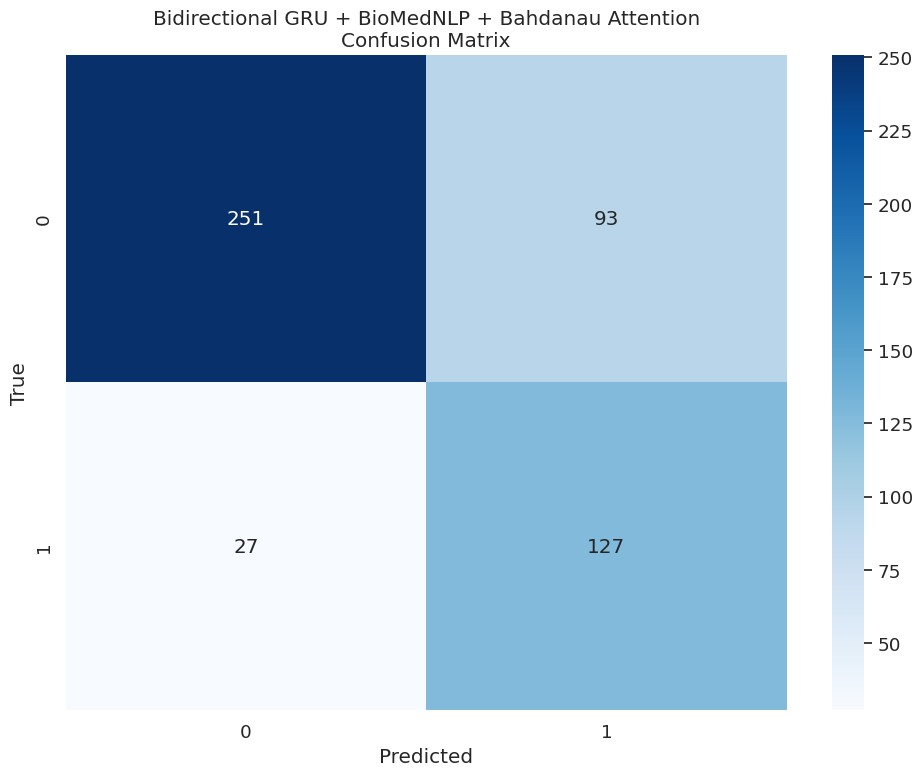

In [35]:
NUM_CLASSES = 2

fig, axes = plt.subplots(1, 1, figsize=(10, 8))

plot_confusion_matrix(axes, all_labels_BioMedNLP, all_pred_BioMedNLP)
axes.set_title("Bidirectional GRU + BioMedNLP + Bahdanau Attention\nConfusion Matrix")

plt.tight_layout()
plt.show()

In [36]:
from sklearn.metrics import roc_curve, auc

y_true_BioMedNLP = np.array(all_labels_BioMedNLP)
y_scores_BioMedNLP  = np.array(all_probs_BioMedNLP)

fpr_BioMedNLP , tpr_BioMedNLP , _ = roc_curve(y_true_BioMedNLP , y_scores_BioMedNLP )
roc_auc_BioMedNLP  = auc(fpr_BioMedNLP , tpr_BioMedNLP )

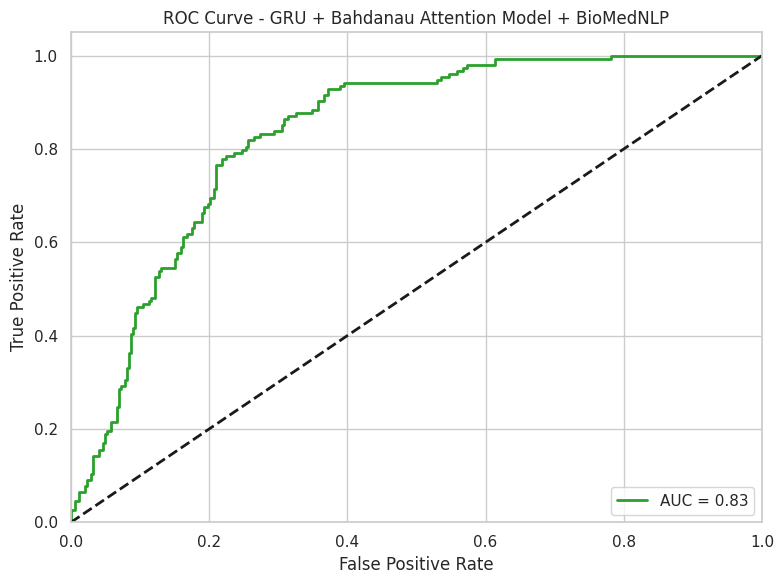

In [37]:
sns.set(style="whitegrid")

# One plot only
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

ax.plot(fpr_BioMedNLP, tpr_BioMedNLP, lw=2,
        label=f'AUC = {roc_auc_BioMedNLP:.2f}', color='tab:green')
ax.plot([0, 1], [0, 1], 'k--', lw=2)
ax.set_xlim([0.0, 1.0])
ax.set_ylim([0.0, 1.05])
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_title('ROC Curve - GRU + Bahdanau Attention Model + BioMedNLP')
ax.legend(loc='lower right')
ax.grid(True)

plt.tight_layout()
plt.show()

### **2.3 Few Shot Learning**

In [ ]:
k_values = range(1, 11)  # Few-shot from k=1 to 10
NUM_CLASSES = 2
BERT_DIM = 768
HIDDEN_DIM = 286
DROPOUT = 0.1

model_metrics = {
    "K-shot": [],
    "Model": [],
    "Test Accuracy": [],
    "F1": [],
    "Balanced Accuracy": [],
    "Recall": [],
    "Precision": []
}

patience = 4
num_epochs = 20
for k in k_values:
    print(f"\n--- K-Shot = {k} ---")

    X_kshot, y_kshot = get_k_shot_data_from_original(combined_dataset, k, NUM_CLASSES)
    kshot_dataset = BiomedNLPDataset(X_kshot, y_kshot, tokenizer)
    kshot_loader = DataLoader(kshot_dataset, batch_size=BATCH_SIZE, shuffle=True)

    model = BiomedNLP_GRU_Attention(BERT_DIM, HIDDEN_DIM, num_layers=1, dropout_prob=DROPOUT).to(device)
    print(f"{count_parameters(model)} model parameters")
    print()
    print(model)

    learning_rate = 2e-5
    optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)

    class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
    print(f"Class weights: {class_weights}")

    pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
    loss_function = torch.nn.BCEWithLogitsLoss()

    # Train with early stopping
    best_val_acc = 0
    patience_counter = 0
    for epoch in range(num_epochs):
        train_loss, train_acc = train_model(model, kshot_loader, optimizer, loss_function, device)
        val_acc, val_f1, val_loss = evaluate_model(model, test_loader, loss_function, device)

        print(f"K={k} | Epoch {epoch+1}/{num_epochs} "
              f"- Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, "
              f"Test Loss: {val_loss:.4f}, Test Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                break

    # Load best model
    model.load_state_dict(best_model_state)

    # Evaluate on test set
    avg_loss, avg_accuracy, f1, balanced_acc, recall, precision = test_model(model, test_loader, loss_function, device)

    # Log metrics
    print(f"Test Accuracy: {avg_accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"Balanced Accuracy: {balanced_acc:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"Precision: {precision:.4f}")

    model_metrics["K-shot"].append(k)
    model_metrics["Model"].append("GRU-BioMedNLP")
    model_metrics["Test Accuracy"].append(avg_accuracy)
    model_metrics["F1"].append(f1)
    model_metrics["Balanced Accuracy"].append(balanced_acc)
    model_metrics["Recall"].append(recall)
    model_metrics["Precision"].append(precision)

# Convert results to DataFrame
df = pd.DataFrame(model_metrics)


--- K-Shot = 1 ---
1976833 model parameters

BiomedNLP_GRU_Attention(
  (gru): GRU(768, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_features=286, bias=True)
    (v): Linear(in_features=286, out_features=1, bias=False)
  )
  (fc): Linear(in_features=572, out_features=1, bias=True)
  (dropout): Dropout(p=0.1, inplace=False)
)
Class weights: [0.69741587 1.76636225]
K=1 | Epoch 1/20 - Train Loss: 0.7066, Train Acc: 0.5000, Test Loss: 0.7861, Test Acc: 0.3092, Val F1: 0.4724
K=1 | Epoch 2/20 - Train Loss: 0.6706, Train Acc: 0.5000, Test Loss: 0.7542, Test Acc: 0.3092, Val F1: 0.4724
K=1 | Epoch 3/20 - Train Loss: 0.6474, Train Acc: 0.5000, Test Loss: 0.7375, Test Acc: 0.3092, Val F1: 0.4724
K=1 | Epoch 4/20 - Train Loss: 0.6408, Train Acc: 1.0000, Test Loss: 0.7369, Test Acc: 0.3092, Val F1: 0.4724
K=1 | Epoch 5/20 - Train Loss: 0.6324, Train Acc: 0.5000, Test Loss: 0.7245, Test Acc: 0.3092, Val F1: 0.4724
Test Accuracy:

In [ ]:
# --- Plotting ---
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
palette = sns.color_palette("Set2")

def plot_model_performance(df, model_name, color, title_prefix="Model Performance"):
    model_df = df[df["Model"] == model_name]
    metrics_to_plot = ["F1", "Balanced Accuracy", "Recall", "Precision"]

    fig, axes = plt.subplots(2, 2, figsize=(14, 10), sharex=True)
    axes = axes.flatten()

    for i, metric in enumerate(metrics_to_plot):
        sns.lineplot(
            data=model_df,
            x="K-shot",
            y=metric,
            ax=axes[i],
            color=color,
            marker="o",
            linewidth=2.2,
            markersize=6,
        )
        axes[i].set_title(metric, fontsize=14)
        axes[i].set_xlabel("K-shot")
        axes[i].set_ylabel(metric)
        axes[i].grid(True)

    plt.suptitle(f"{title_prefix} for {model_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

In [ ]:
# --- Plotting ---
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
palette = sns.color_palette("Set2")

def plot_model_performance(df, model_name, color, title_prefix="Model Performance"):
    model_df = df[df["Model"] == model_name]
    metrics_to_plot = ["F1", "Balanced Accuracy", "Recall", "Precision"]

    fig, axes = plt.subplots(2, 2, figsize=(14, 10), sharex=True)
    axes = axes.flatten()

    for i, metric in enumerate(metrics_to_plot):
        sns.lineplot(
            data=model_df,
            x="K-shot",
            y=metric,
            ax=axes[i],
            color=color,
            marker="o",
            linewidth=2.2,
            markersize=6,
        )
        axes[i].set_title(metric, fontsize=14)
        axes[i].set_xlabel("K-shot")
        axes[i].set_ylabel(metric)
        axes[i].grid(True)

    plt.suptitle(f"{title_prefix} for {model_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

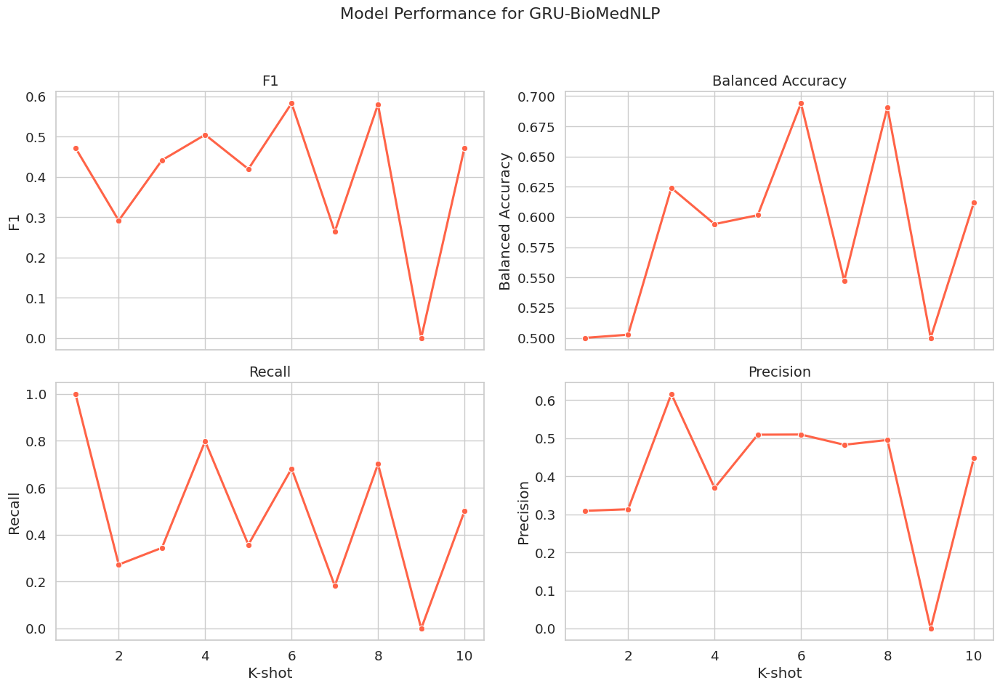

In [ ]:
# Plot results
plot_model_performance(df, "GRU-BioMedNLP", "tomato")

Maximum values per metric:
Balanced Accuracy: 0.6941 (at K-shot = 6)
F1: 0.5833 (at K-shot = 6)
Recall: 1.0000 (at K-shot = 1)
Precision: 0.6163 (at K-shot = 3)


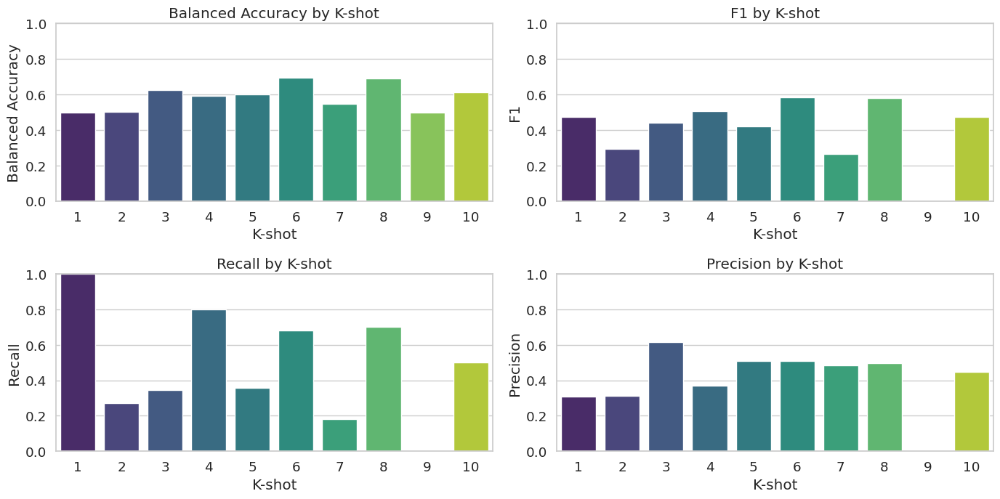

In [ ]:
metrics = ["Balanced Accuracy", "F1", "Recall", "Precision"]

# Print max values for each metric
print("Maximum values per metric:")
for metric in metrics:
    max_val = df[metric].max()
    max_k = df.loc[df[metric].idxmax(), "K-shot"]
    print(f"{metric}: {max_val:.4f} (at K-shot = {max_k})")

# Then plot the histograms
plt.figure(figsize=(14, 10))

for i, metric in enumerate(metrics, 1):
    plt.subplot(3, 2, i)
    sns.barplot(x="K-shot", y=metric, data=df, palette="viridis")
    plt.title(f"{metric} by K-shot")
    plt.ylim(0, 1)
    plt.xlabel("K-shot")
    plt.ylabel(metric)

plt.tight_layout()
plt.show()

## **3. Bidirectional GRU + Fasttext + Bahdanau Attention + Weight Class**

In [38]:
def load_fasttext_embeddings(vec_path, word_to_index, embedding_dim=300):
    """
    Loads FastText embeddings from a .txt or .vec file and returns an embedding matrix.

    Note:
        The .txt or .vec format contains a header (num_tokens, dimension),
        followed by one word vector per line in the format: word val1 val2 ... valN.

    Args:
        vec_path (str): Path to the FastText .txt or .vec file (e.g., cc.en.300.txt or cc.en.300.vec).
        word_to_index (dict): Mapping from words to their index in the vocabulary.
        embedding_dim (int): Dimensionality of the embeddings (e.g., 300).

    Returns:
        torch.Tensor: Embedding matrix of shape (vocab_size, embedding_dim).
    """
    embedding_matrix = np.zeros((len(word_to_index), embedding_dim), dtype='float32')

    with open(vec_path, 'r', encoding='utf-8', newline='\n', errors='ignore') as f:
        header = f.readline()  # header contains: num_words dim
        for line in f:
            values = line.rstrip().split(' ')
            if len(values) < embedding_dim + 1:
                continue  # skip malformed lines
            word = values[0]
            if word in word_to_index:
                vector = np.asarray(values[1:], dtype='float32')
                embedding_matrix[word_to_index[word]] = vector

    return torch.tensor(embedding_matrix, dtype=torch.float)

In [39]:
EMBEDDING_DIM = 300
embedding_matrix_fasttext = load_fasttext_embeddings('/content/drive/MyDrive/cc.en.300.vec/cc.en.300.vec', word_to_index, EMBEDDING_DIM)

### **3.1 Optimization Phase**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


#### **3.1.1 Optimizer selection**

In [ ]:
# ======== Setup ========
num_epochs = 16
learning_rate = 1e-4  # Was 1e-5 — now increased
clip = 1.0  # gradient clipping max norm

# Compute class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

# Positive weight for BCEWithLogitsLoss
pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)  # FIXED

results = []

optimizers = {
    'Adam': optim.Adam,
    'RMSprop': optim.RMSprop,
    'AdamW': optim.AdamW
}

all_train_losses, all_val_losses = {}, {}
all_train_accs, all_val_accs = {}, {}

# ======== Loop through optimizers ========
for optimizer_name, optimizer_class in optimizers.items():
    print(f"\n🔹 Training with optimizer: {optimizer_name}")

    # Instantiate model
    model = GRU_BahdanauAttention(
        embedding_matrix=embedding_matrix_fasttext,
        hidden_dim=200,
        num_layers=1,
        dropout_prob=0.8
    ).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=learning_rate)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total trainable parameters: {num_params}")

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    # ======== Training loop ========
    for epoch in range(num_epochs):
        start_time = time.time()

        # Correct unpacking order
        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # FIXED

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        scheduler.step(f1)

        end_time = time.time()
        duration = end_time - start_time

        print(
            f"Opt: {optimizer_name} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "  # VL now correct
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {duration/60:.2f} min"
        )

    # Store metrics
    all_train_losses[optimizer_name] = train_losses
    all_val_losses[optimizer_name] = val_losses
    all_train_accs[optimizer_name] = train_accs
    all_val_accs[optimizer_name] = val_accs

    label = f"Batch={BATCH_SIZE} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with optimizer: Adam
GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 200, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=400, out_features=200, bias=True)
    (v): Linear(in_features=200, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.8, inplace=False)
  (fc): Linear(in_features=400, out_features=1, bias=True)
)
Total trainable parameters: 12943301
Opt: Adam | Epoch 1/16 - TL: 0.9896, VL: 1.0119, TA: 52.51%, VA: 53.51%, F1: 22.11%, Time: 0.11 min
Opt: Adam | Epoch 2/16 - TL: 0.9742, VL: 0.9756, TA: 61.83%, VA: 73.97%, F1: 60.77%, Time: 0.08 min
Opt: Adam | Epoch 3/16 - TL: 0.7869, VL: 0.6745, TA: 73.79%, VA: 79.52%, F1: 67.02%, Time: 0.08 min
Opt: Adam | Epoch 4/16 - TL: 0.5976, VL: 0.6410, TA: 81.97%, VA: 82.31%, F1: 71.55%, Time: 0.08 min
Opt: Adam | Epoch 5/16 - TL: 0.5135, VL: 0.6253, TA: 85.85%, VA: 81.44%, F1: 68.70%, Time: 0.08 min
Opt: 

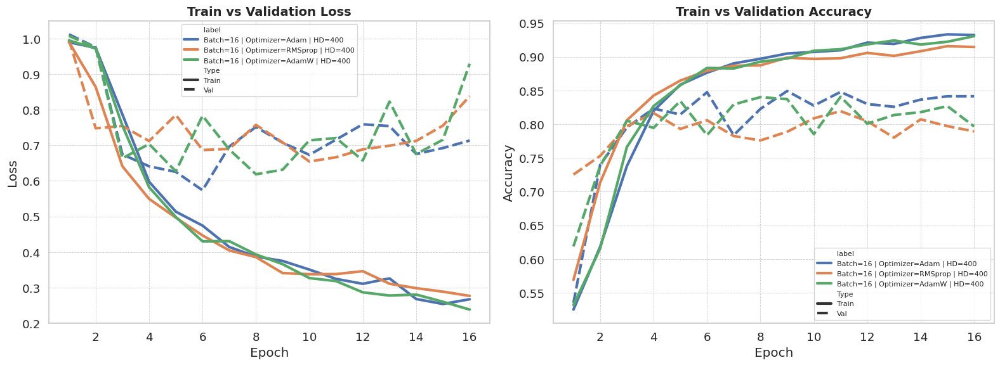

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **3.1.2 Learning rate value selection**

In [ ]:
# Learning rate sweep configuration
learning_rates = [1e-4, 5e-5, 1e-5]
optimizer_name = 'Adam'
optimizer_class = optim.Adam
results = []
num_epochs = 16

# Class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)  # FIXED pos_weight

# Loop through learning rates
for lr in learning_rates:
    print(f"\n🔹 Training with {optimizer_name} optimizer, learning rate = {lr}")

    model = GRU_BahdanauAttention(
        embedding_matrix=embedding_matrix_fasttext,
        hidden_dim=400,
        num_layers=1,
        dropout_prob=0.5
    ).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # FIXED ORDER

        scheduler.step(f1)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"LR: {lr:.1e} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results
    label = f"LR={lr:.1e} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with Adam optimizer, learning rate = 0.0001
GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
LR: 1.0e-04 | Epoch 1/16 - TL: 0.9850, VL: 0.9923, TA: 56.15%, VA: 66.68%, F1: 53.72%, Time: 0.15 min
LR: 1.0e-04 | Epoch 2/16 - TL: 0.7909, VL: 0.6939, TA: 76.18%, VA: 77.62%, F1: 64.80%, Time: 0.16 min
LR: 1.0e-04 | Epoch 3/16 - TL: 0.6408, VL: 0.6072, TA: 80.27%, VA: 81.12%, F1: 69.44%, Time: 0.16 min
LR: 1.0e-04 | Epoch 4/16 - TL: 0.5016, VL: 0.6616, TA: 85.53%, VA: 81.34%, F1: 69.61%, Time: 0.16 min
LR: 1.0e-04 | Epoch 5/16 - TL: 0.4571, VL: 0.6492, TA: 86.86%, VA: 80.24%, F1: 69.75%, Time: 0.16 min
LR: 1.0e-

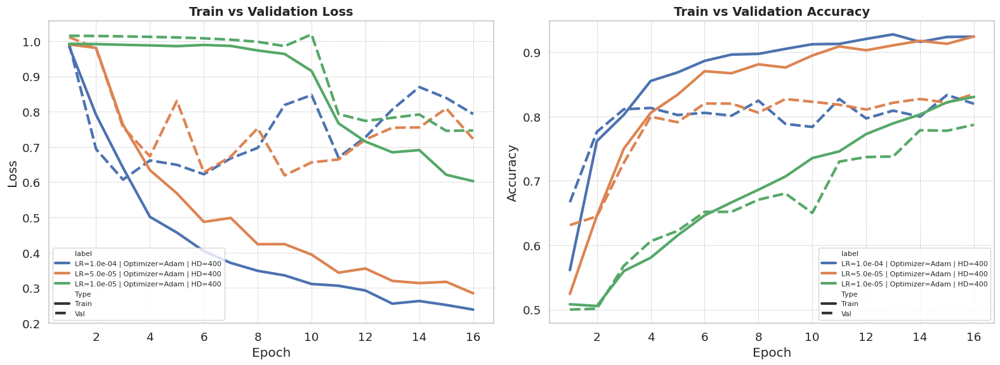

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **3.1.3 Batch size value selection**

In [ ]:
# Batch size sweep configuration
batch_sizes = [8, 16, 64]
learning_rate = 2e-5
num_epochs = 16
results = []

# Compute class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop over different batch sizes
for batch_size in batch_sizes:
    print(f"\n🔹 Training with batch size: {batch_size}")

    # Create DataLoaders with the current batch size
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    # Instantiate GRU + Bahdanau Attention model
    model = GRU_BahdanauAttention(
        embedding_matrix=embedding_matrix_fasttext,
        hidden_dim=400,
        num_layers=1,
        dropout_prob=0.5
    ).to(device)

    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # <--- FIXED

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"BS: {batch_size} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results for later plotting
    label = f"LR={learning_rate:.1e} | Batch={batch_size} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with batch size: 8
BS: 8 | Epoch 1/16 - TL: 0.9919, VL: 1.0025, TA: 51.36%, VA: 51.01%, F1: 9.88%, Time: 0.26 min
BS: 8 | Epoch 2/16 - TL: 0.9864, VL: 0.9962, TA: 62.14%, VA: 68.89%, F1: 55.71%, Time: 0.28 min
BS: 8 | Epoch 3/16 - TL: 0.9760, VL: 0.9728, TA: 66.98%, VA: 70.30%, F1: 57.30%, Time: 0.28 min
BS: 8 | Epoch 4/16 - TL: 0.8239, VL: 0.8230, TA: 72.64%, VA: 73.40%, F1: 60.92%, Time: 0.35 min
BS: 8 | Epoch 5/16 - TL: 0.7094, VL: 0.8266, TA: 76.88%, VA: 75.70%, F1: 62.99%, Time: 0.32 min
BS: 8 | Epoch 6/16 - TL: 0.6741, VL: 1.0146, TA: 80.04%, VA: 73.21%, F1: 61.43%, Time: 0.28 min
BS: 8 | Epoch 7/16 - TL: 0.6382, VL: 0.8572, TA: 82.22%, VA: 75.27%, F1: 64.03%, Time: 0.28 min
BS: 8 | Epoch 8/16 - TL: 0.5868, VL: 0.8182, TA: 84.06%, VA: 79.67%, F1: 69.16%, Time: 0.28 min
BS: 8 | Epoch 9/16 - TL: 0.5916, VL: 0.7103, TA: 84.29%, VA: 80.19%, F1: 68.77%, Time: 0.24 min
BS: 8 | Epoch 10/16 - TL: 0.5435, VL: 0.7371, TA: 86.07%, VA: 80.87

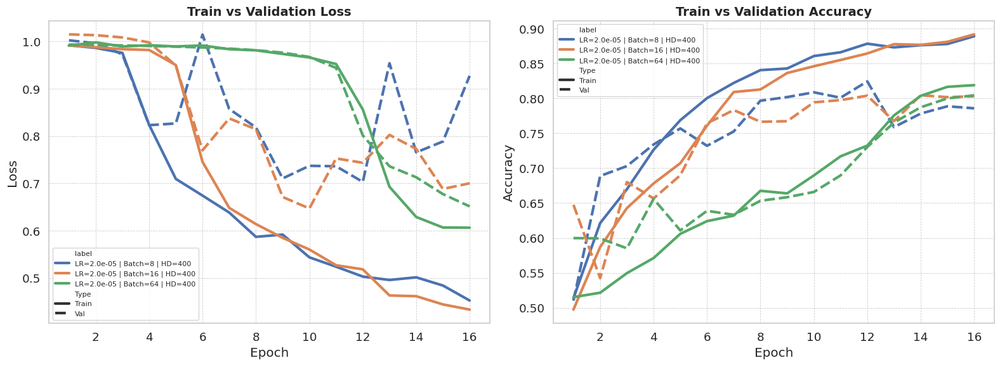

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **3.1.4 Dropout value selection**

In [ ]:
# Hyperparameter sweep configuration
hidden_dims = [286]
dropouts = [0.1, 0.4, 0.8]
learning_rate = 1e-4
batch_size = 16
num_epochs = 16
results = []

# Compute class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for hidden_dim in hidden_dims:
    num_layers = 1  # fixed value for this sweep
    for dropout in dropouts:
        print(f"\n🔹 Training with hidden_dim={hidden_dim}, num_layers={num_layers}, dropout={dropout}")

        # Data loaders
        train_loader_hp = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        val_loader_hp = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

        # Instantiate GRU + Bahdanau Attention model with current parameters
        model = GRU_BahdanauAttention(
            embedding_matrix=embedding_matrix_fasttext,
            hidden_dim=hidden_dim,
            num_layers=num_layers,
            dropout_prob=dropout
        ).to(device)

        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        train_losses, val_losses = [], []
        train_accs, val_accs, val_f1s = [], [], []

        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
            val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # <--- FIXED

            train_losses.append(train_loss)
            val_losses.append(val_loss)
            train_accs.append(train_acc)
            val_accs.append(val_acc)
            val_f1s.append(f1)

            print(
                f"HD: {hidden_dim} | NL: {num_layers} | DP: {dropout} | Epoch {epoch+1}/{num_epochs} - "
                f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
                f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
                f"Time: {(time.time() - start_time)/60:.2f} min"
            )

        # Store results
        label = f"LR={learning_rate:.1e} | BS={batch_size} | HD={hidden_dim} | NL={num_layers} | DP={dropout}"
        for epoch in range(num_epochs):
            results.append({
                "epoch": epoch + 1,
                "label": label,
                "train_loss": train_losses[epoch],
                "val_loss": val_losses[epoch],
                "train_acc": train_accs[epoch],
                "val_acc": val_accs[epoch],
                "val_f1": val_f1s[epoch]
            })

Class weights: [0.69741587 1.76636225]

🔹 Training with hidden_dim=286, num_layers=1, dropout=0.1
HD: 286 | NL: 1 | DP: 0.1 | Epoch 1/16 - TL: 0.9947, VL: 0.9886, TA: 51.73%, VA: 64.67%, F1: 51.41%, Time: 0.07 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 2/16 - TL: 0.9817, VL: 0.9747, TA: 59.46%, VA: 65.64%, F1: 52.87%, Time: 0.07 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 3/16 - TL: 0.9267, VL: 0.8168, TA: 72.30%, VA: 77.74%, F1: 65.41%, Time: 0.07 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 4/16 - TL: 0.7088, VL: 0.6681, TA: 78.46%, VA: 77.04%, F1: 64.40%, Time: 0.07 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 5/16 - TL: 0.5717, VL: 0.6932, TA: 81.84%, VA: 78.89%, F1: 68.11%, Time: 0.07 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 6/16 - TL: 0.5306, VL: 0.6694, TA: 84.41%, VA: 81.65%, F1: 71.65%, Time: 0.07 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 7/16 - TL: 0.4693, VL: 0.5825, TA: 86.38%, VA: 83.52%, F1: 72.57%, Time: 0.07 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 8/16 - TL: 0.4175, VL: 0.6069, TA: 88.54%, VA: 83.78%, F

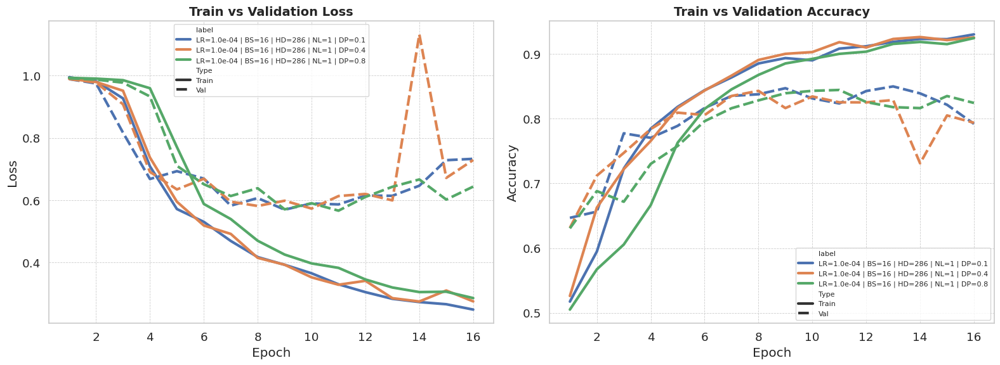

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

### **3.2 Test Phase**

In [40]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [41]:
# --- Hyperparameters ---
HIDDEN_DIM = 286
DROPOUT = 0.8
NUM_LAYERS = 1
learning_rate = 1e-5
num_epochs = 50
patience = 4
best_model_path = "best_model2.pth"

# --- Model Instantiation ---
model = GRU_BahdanauAttention(
    embedding_matrix=embedding_matrix_fasttext,
    hidden_dim=HIDDEN_DIM,
    num_layers=NUM_LAYERS,
    dropout_prob=DROPOUT
).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# --- Compute Class Weights ---
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Tracking Variables ---
train_losses, test_losses = [], []
train_accuracies, test_accuracies = [], []
test_f1s, test_balanced_accs, test_recalls, test_precisions = [], [], [], []

best_test_bal_acc = 0
patience_counter = 0
best_model_state = None

# --- Scheduler ---
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-6
)

# --- Training with Early Stopping ---
with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as epoch_pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        # Training step
        train_loss, train_acc = train_epoch(model, combined_loader, optimizer, loss_function, device)

        # Evaluation step
        test_loss, test_acc, test_f1, test_balanced_acc, test_recall, test_precision = test_epoch(
            model, test_loader, loss_function, device
        )

        # Logging
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        test_losses.append(test_loss)
        test_balanced_accs.append(test_balanced_acc)
        test_f1s.append(test_f1)

        # Scheduler step
        scheduler.step(test_balanced_acc)

        epoch_duration = time.time() - start_time

        # --- Early Stopping Logic ---
        if test_balanced_acc > best_test_bal_acc:
            best_test_bal_acc = test_balanced_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
            torch.save(best_model_state, best_model_path)
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"\nEarly stopping at epoch {epoch + 1}.")
                break

        epoch_pbar.set_postfix({
            "Training Loss": f"{train_loss:.4f}",
            "Test Loss": f"{test_loss:.4f}",
            "Train Balanced Acc": f"{train_acc:.2%}",
            "Test Balanced Acc": f"{test_balanced_acc:.2%}",
            "Test F1": f"{test_f1:.2%}",
            "Test Precision": f"{test_precision:.2%}",
            "Test Recall": f"{test_recall:.2%}",
            "Time(min)": f"{epoch_duration / 60:.2f}"
        })
        epoch_pbar.update(1)

# --- Load Best Model ---
model.load_state_dict(torch.load(best_model_path))

Class weights: [0.69741587 1.76636225]


Training Progress:  44%|████▍     | 22/50 [03:54<04:59, 10.68s/epoch, Training Loss=0.5843, Test Loss=0.6914, Train Balanced Acc=84.29%, Test Balanced Acc=81.12%, Test F1=71.89%, Test Precision=61.57%, Test Recall=86.36%, Time(min)=0.11]


Early stopping at epoch 23.


<All keys matched successfully>

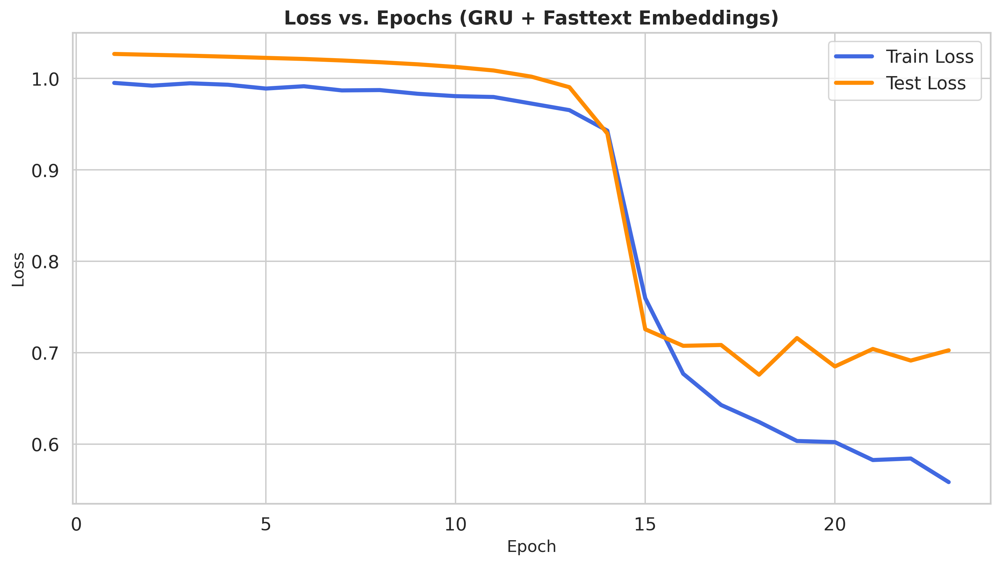

In [42]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=epochs, y=test_losses, label='Test Loss', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (GRU + Fasttext Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='upper right', frameon=True)
plt.tight_layout()

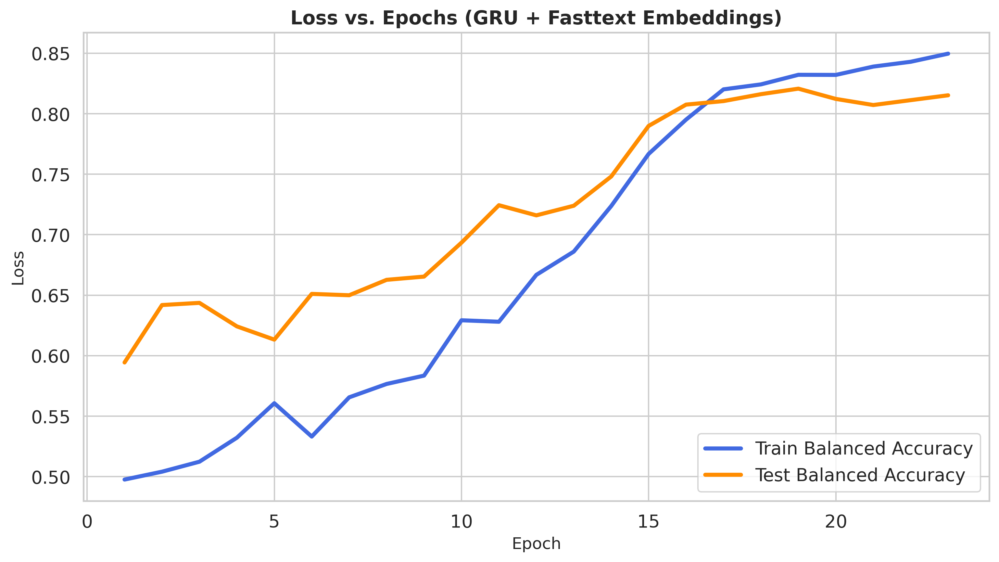

In [43]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 2. Balanced Accurcy Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_accuracies, label='Train Balanced Accuracy', color='royalblue')
sns.lineplot(x=epochs, y=test_balanced_accs, label='Test Balanced Accuracy', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (GRU + Fasttext Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='lower right', frameon=True)
plt.tight_layout()

In [44]:
model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_fasttext,
                                  hidden_dim=HIDDEN_DIM,
                                  num_layers=NUM_LAYERS,
                                  dropout_prob=DROPOUT
                                ).to(device)

model.load_state_dict(torch.load("/content/best_model2.pth"))
model.eval()

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Recalculate metrics on test set ---
final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_epoch(
    model, test_loader, loss_function, device
)

# --- Print results ---
print("\n Final Evaluation Metrics of Best Model:")
print(f"Test Loss           : {final_test_loss:.4f}")
print(f"Test Accuracy       : {final_test_acc:.2%}")
print(f"Test F1 Score       : {final_test_f1:.2%}")
print(f"Balanced Accuracy   : {final_test_bal_acc:.2%}")
print(f"Test Precision      : {final_test_precision:.2%}")
print(f"Test Recall         : {final_test_recall:.2%}")

Class weights: [0.69741587 1.76636225]

 Final Evaluation Metrics of Best Model:
Test Loss           : 0.7160
Test Accuracy       : 80.92%
Test F1 Score       : 73.39%
Balanced Accuracy   : 82.07%
Test Precision      : 64.53%
Test Recall         : 85.06%


In [45]:
def evaluate_and_analyze(model, test_loader, device, num_classes=2):
    """
    Evaluates a GloVe-based model on the test dataset and analyzes prediction performance.

    Args:
        model (nn.Module): Trained PyTorch model using GloVe embeddings.
        test_loader (DataLoader): DataLoader for the test dataset.
        device (torch.device): Device to perform evaluation on (CPU or GPU).

    Returns:
        df_results (pd.DataFrame): Classification report with precision, recall, F1-score, and support.
        df_correct (pd.DataFrame): Samples that were predicted correctly with their info.
        df_wrong (pd.DataFrame): Samples that were predicted incorrectly with their info.
        all_labels (list): Ground truth labels for all test samples.
        all_probs (list): Predicted class probabilities for all test samples.
    """
    model.eval()

    all_labels = []
    all_preds = []
    all_probs = []
    all_indices = []

    top_correct = []
    top_wrong = []

    with torch.no_grad():
        for idx, (inputs, labels, raw_text) in enumerate(test_loader):
            inputs, labels = inputs.to(device), labels.to(device)

            outputs = model(inputs)

            if outputs.shape[1] == 1:
                probs = torch.sigmoid(outputs).squeeze(1)
                preds = (probs >= 0.5).long()
            else:
                probs = torch.softmax(outputs, dim=1)[:, 1]
                preds = torch.argmax(outputs, dim=1)

            all_labels.extend(labels.cpu().numpy())
            all_preds.extend(preds.cpu().numpy())
            all_probs.extend(probs.cpu().numpy())
            all_indices.extend(range(len(labels)))

            correct_indices = (preds == labels).nonzero(as_tuple=True)[0]
            wrong_indices = (preds != labels).nonzero(as_tuple=True)[0]

            for correct_idx in correct_indices:
                top_correct.append({
                    'index': correct_idx.item(),
                    'true_label': labels[correct_idx].item(),
                    'predicted_label': preds[correct_idx].item(),
                    'probability': probs[correct_idx].cpu().item(),
                    'text': raw_text[correct_idx.item()] if raw_text is not None else None
                })

            for wrong_idx in wrong_indices:
                top_wrong.append({
                    'index': wrong_idx.item(),
                    'true_label': labels[wrong_idx].item(),
                    'predicted_label': preds[wrong_idx].item(),
                    'probability': probs[wrong_idx].cpu().item(),
                    'text': raw_text[wrong_idx.item()] if raw_text is not None else None
                })

    df_correct = pd.DataFrame(top_correct)
    df_wrong = pd.DataFrame(top_wrong)

    class_report = classification_report(all_labels, all_preds, output_dict=True)
    df_results = pd.DataFrame(class_report).transpose()

    return df_results, df_correct, df_wrong, all_labels, all_preds, all_probs

In [46]:
df_results, df_correct, df_wrong, all_labels, all_pred, all_probs = evaluate_and_analyze(model, test_loader, device)

In [ ]:
df_correct.head()

,index,true_label,predicted_label,probability,text
0,0,1,1,0.785102,PDGFRA H845_N848delinsP Gastrointestinal strom...
1,1,0,0,0.049416,BRCA2 G2748D Mutation screening of the breast ...
2,2,0,0,0.069765,PTEN F347L The tumor suppressor gene PTEN is f...
3,4,0,0,0.080983,PIK3R2 Amplification Structural rearrangements...
4,5,0,0,0.058916,TP53 R175H Tumor suppressor p53-dependent apop...


In [ ]:
df_wrong.tail()

,index,true_label,predicted_label,probability,text
100,13,0,1,0.730679,RASA1 Deletion Phospholipase C gamma 1 (PLC ga...
101,5,0,1,0.537824,"PTPN11 Deletion PTPN11, which encodes tyrosine..."
102,8,0,1,0.723112,FGFR3 Fusions Fusion genes are chromosomal abe...
103,9,0,1,0.622454,BRAF E501G Cardio-facio-cutaneous (CFC) syndr...
104,0,0,1,0.786690,EGFR H870R Abstract Epidermal growth factor ...


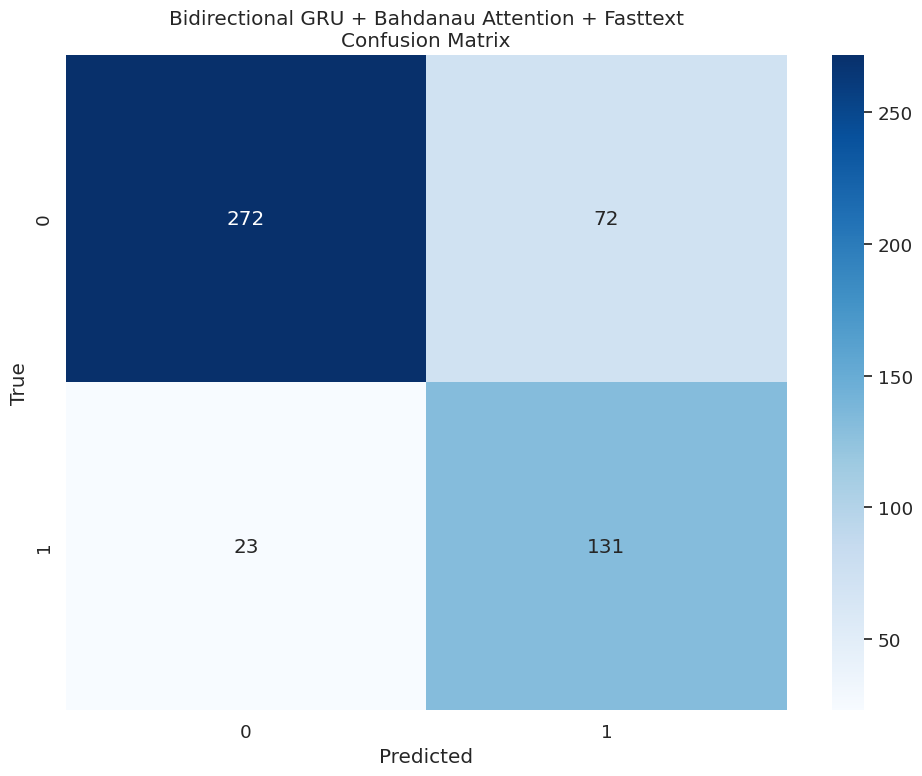

In [47]:
NUM_CLASSES = 2

fig, axes = plt.subplots(1, 1, figsize=(10, 8))

plot_confusion_matrix(axes, all_labels, all_pred)
axes.set_title("Bidirectional GRU + Bahdanau Attention + Fasttext\nConfusion Matrix")

plt.tight_layout()
plt.show()

In [48]:
from sklearn.metrics import roc_curve, auc

y_true = np.array(all_labels)
y_scores = np.array(all_probs)

fpr, tpr, _ = roc_curve(y_true , y_scores)
roc_auc = auc(fpr, tpr)

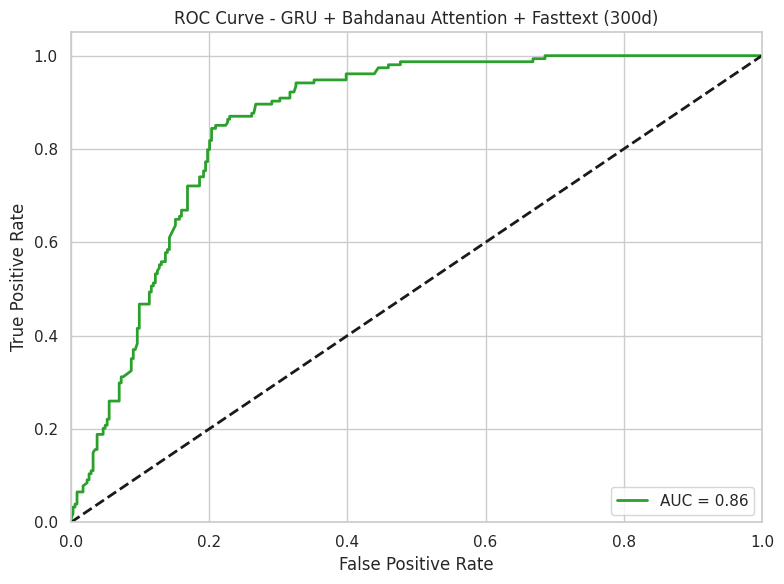

In [49]:
sns.set(style="whitegrid")

# One plot only
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

ax.plot(fpr, tpr, lw=2,
        label=f'AUC = {roc_auc:.2f}', color='tab:green')
ax.plot([0, 1], [0, 1], 'k--', lw=2)
ax.set_xlim([0.0, 1.0])
ax.set_ylim([0.0, 1.05])
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_title('ROC Curve - GRU + Bahdanau Attention + Fasttext (300d)')
ax.legend(loc='lower right')
ax.grid(True)

plt.tight_layout()
plt.show()

### **3.3 Few Shot Learning**

In [75]:
def get_few_shot_subset(X_tensor, y_tensor, k_shot):
    X_few = []
    y_few = []
    unique_classes = torch.unique(y_tensor)
    for cls in unique_classes:
        indices = (y_tensor == cls).nonzero(as_tuple=True)[0]
        selected = indices[torch.randperm(len(indices))[:k_shot]]
        X_few.append(X_tensor[selected])
        y_few.append(y_tensor[selected])
    X_few = torch.cat(X_few)
    y_few = torch.cat(y_few)
    return X_few, y_few

In [ ]:
k_values = range(1, 11)  # Few-shot from k=1 to 10
NUM_CLASSES = 2
HIDDEN_DIM = 286
DROPOUT = 0.7

X_combined = np.concatenate((X_train, X_val), axis=0)
y_combined = np.concatenate((y_train, y_val), axis=0)
X_combined_tensor = torch.cat((X_train_tensor, X_val_tensor), dim=0)
y_combined_tensor = torch.cat((y_train_tensor, y_val_tensor), dim=0)

model_metrics = {
    "K-shot": [],
    "Model": [],
    "Test Accuracy": [],
    "F1": [],
    "Balanced Accuracy": [],
    "Recall": [],
    "Precision": []
}

patience = 5
num_epochs = 50
for k in k_values:
    print(f"\n--- K-Shot = {k} ---")

    X_few, y_few = get_few_shot_subset(X_combined_tensor, y_combined_tensor, k_shot=k)
    few_shot_dataset = TextDataset(X_few, y_few, raw_text_data=X_combined)
    few_shot_loader = DataLoader(few_shot_dataset, batch_size=batch_size, shuffle=True, collate_fn=custom_collate_fn)

    model = GRU_BahdanauAttention(
                embedding_matrix=embedding_matrix_fasttext,
                hidden_dim=HIDDEN_DIM,
                num_layers=NUM_LAYERS,
                dropout_prob=DROPOUT
            ).to(device)
    print(f"{count_parameters(model)} model parameters")
    print()
    print(model)

    learning_rate = 2e-5
    optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)

    class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
    print(f"Class weights: {class_weights}")

    pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
    loss_function = torch.nn.BCEWithLogitsLoss(pos_weight)

    # Train with early stopping
    best_val_acc = 0
    patience_counter = 0
    for epoch in range(num_epochs):
        train_loss, train_acc = train_epoch(model, few_shot_loader, optimizer, loss_function, device)
        val_acc, val_f1, val_loss = evaluate_epoch(model, test_loader, loss_function, device)

        print(f"K={k} | Epoch {epoch+1}/{num_epochs} "
              f"- Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, "
              f"Test Loss: {val_loss:.4f}, Test Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                break

    # Load best model
    model.load_state_dict(best_model_state)

    # Evaluate on test set
    avg_loss, avg_accuracy, f1, balanced_acc, recall, precision = test_epoch(model, test_loader, loss_function, device)

    # Log metrics
    print(f"Test Accuracy: {avg_accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"Balanced Accuracy: {balanced_acc:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"Precision: {precision:.4f}")

    model_metrics["K-shot"].append(k)
    model_metrics["Model"].append("GRU-Fasttext")
    model_metrics["Test Accuracy"].append(avg_accuracy)
    model_metrics["F1"].append(f1)
    model_metrics["Balanced Accuracy"].append(balanced_acc)
    model_metrics["Recall"].append(recall)
    model_metrics["Precision"].append(precision)

# Convert results to DataFrame
df = pd.DataFrame(model_metrics)


--- K-Shot = 1 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_features=286, bias=True)
    (v): Linear(in_features=286, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.7, inplace=False)
  (fc): Linear(in_features=572, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=1 | Epoch 1/50 - Train Loss: 1.7706, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7368, Val F1: 0.5000
K=1 | Epoch 2/50 - Train Loss: 1.7914, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7371, Val F1: 0.5000
K=1 | Epoch 3/50 - Train Loss: 1.7220, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7365, Val F1: 0.5000
K=1 | Epoch 4/50 - Train Loss: 1.7259, Train Acc: 1.0000, Test Loss: 0.0000, Test Acc: 1.7369, Val F1: 0.5000
K=1 | Epoch 5/50 - Train Loss: 1.7300, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7374, Val F1: 0.5000
K=1 | Epoch 6/50 - Train Loss: 1.7237, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7376, Val F1: 0.5000
K=1 | Epoch 7/50 - Train Loss: 1.7147, Train Acc: 1.0000, Test Loss: 0.0000, Test Acc: 1.7379, Val F1: 0.5000
K=1 | Epoch 8/50 - Train Loss: 1.7382, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7378, Val F1: 0.5000
K=1 | Epoch 9/50 - Train Loss: 1.7545, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7379, Val F1: 0.5000
K=1 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=2 | Epoch 1/50 - Train Loss: 1.7537, Train Acc: 0.2500, Test Loss: 0.0000, Test Acc: 1.7409, Val F1: 0.5000
K=2 | Epoch 2/50 - Train Loss: 1.7750, Train Acc: 0.2500, Test Loss: 0.0000, Test Acc: 1.7416, Val F1: 0.5000
K=2 | Epoch 3/50 - Train Loss: 1.7481, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7418, Val F1: 0.5000
K=2 | Epoch 4/50 - Train Loss: 1.7551, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7420, Val F1: 0.5000
K=2 | Epoch 5/50 - Train Loss: 1.7532, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7416, Val F1: 0.5000
K=2 | Epoch 6/50 - Train Loss: 1.7471, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7425, Val F1: 0.5000
K=2 | Epoch 7/50 - Train Loss: 1.7829, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7425, Val F1: 0.5000
K=2 | Epoch 8/50 - Train Loss: 1.7225, Train Acc: 0.7500, Test Loss: 0.0000, Test Acc: 1.7423, Val F1: 0.5000
K=2 | Epoch 9/50 - Train Loss: 1.7296, Train Acc: 0.7500, Test Loss: 0.0000, Test Acc: 1.7428, Val F1: 0.5000
K=2 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=3 | Epoch 1/50 - Train Loss: 1.7650, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7420, Val F1: 0.5000
K=3 | Epoch 2/50 - Train Loss: 1.7463, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7419, Val F1: 0.5000
K=3 | Epoch 3/50 - Train Loss: 1.7493, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7420, Val F1: 0.5000
K=3 | Epoch 4/50 - Train Loss: 1.7782, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7420, Val F1: 0.5000
K=3 | Epoch 5/50 - Train Loss: 1.7497, Train Acc: 0.6667, Test Loss: 0.0000, Test Acc: 1.7421, Val F1: 0.5000
K=3 | Epoch 6/50 - Train Loss: 1.7474, Train Acc: 0.6667, Test Loss: 0.0000, Test Acc: 1.7417, Val F1: 0.5000
K=3 | Epoch 7/50 - Train Loss: 1.7614, Train Acc: 0.3333, Test Loss: 0.0000, Test Acc: 1.7414, Val F1: 0.5000
K=3 | Epoch 8/50 - Train Loss: 1.7647, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7414, Val F1: 0.5000
K=3 | Epoch 9/50 - Train Loss: 1.7830, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7414, Val F1: 0.5000
K=3 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=4 | Epoch 1/50 - Train Loss: 1.7614, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7673, Val F1: 0.5000
K=4 | Epoch 2/50 - Train Loss: 1.7499, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7670, Val F1: 0.5000
K=4 | Epoch 3/50 - Train Loss: 1.7260, Train Acc: 0.7500, Test Loss: 0.4724, Test Acc: 1.7668, Val F1: 0.5000
K=4 | Epoch 4/50 - Train Loss: 1.7632, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7661, Val F1: 0.5000
K=4 | Epoch 5/50 - Train Loss: 1.7403, Train Acc: 0.6250, Test Loss: 0.4731, Test Acc: 1.7663, Val F1: 0.5015
K=4 | Epoch 6/50 - Train Loss: 1.7600, Train Acc: 0.5000, Test Loss: 0.4731, Test Acc: 1.7667, Val F1: 0.5015
Test Accuracy: 0.3092
F1 Score: 0.4724
Balanced Accuracy: 0.5000
Recall: 1.0000
Precision: 0.3092

--- K-Shot = 5 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_fea

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=5 | Epoch 1/50 - Train Loss: 1.7540, Train Acc: 0.4000, Test Loss: 0.4645, Test Acc: 1.7584, Val F1: 0.4995
K=5 | Epoch 2/50 - Train Loss: 1.7683, Train Acc: 0.3000, Test Loss: 0.4696, Test Acc: 1.7585, Val F1: 0.5108
K=5 | Epoch 3/50 - Train Loss: 1.7323, Train Acc: 0.8000, Test Loss: 0.4573, Test Acc: 1.7581, Val F1: 0.5019
K=5 | Epoch 4/50 - Train Loss: 1.7815, Train Acc: 0.4000, Test Loss: 0.4483, Test Acc: 1.7581, Val F1: 0.4955
K=5 | Epoch 5/50 - Train Loss: 1.7399, Train Acc: 0.5000, Test Loss: 0.4480, Test Acc: 1.7577, Val F1: 0.5003
K=5 | Epoch 6/50 - Train Loss: 1.7455, Train Acc: 0.5000, Test Loss: 0.4460, Test Acc: 1.7576, Val F1: 0.4985
K=5 | Epoch 7/50 - Train Loss: 1.7274, Train Acc: 0.7000, Test Loss: 0.4499, Test Acc: 1.7581, Val F1: 0.4984
Test Accuracy: 0.3514
F1 Score: 0.4696
Balanced Accuracy: 0.5108
Recall: 0.9286
Precision: 0.3143

--- K-Shot = 6 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, ba

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=6 | Epoch 1/50 - Train Loss: 1.7492, Train Acc: 0.5833, Test Loss: 0.4724, Test Acc: 1.7775, Val F1: 0.5000
K=6 | Epoch 2/50 - Train Loss: 1.7491, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7774, Val F1: 0.5000
K=6 | Epoch 3/50 - Train Loss: 1.7949, Train Acc: 0.2500, Test Loss: 0.4724, Test Acc: 1.7769, Val F1: 0.5000
K=6 | Epoch 4/50 - Train Loss: 1.7699, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7767, Val F1: 0.5000
K=6 | Epoch 5/50 - Train Loss: 1.7421, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7762, Val F1: 0.5000
K=6 | Epoch 6/50 - Train Loss: 1.7648, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7758, Val F1: 0.5000
Test Accuracy: 0.3092
F1 Score: 0.4724
Balanced Accuracy: 0.5000
Recall: 1.0000
Precision: 0.3092

--- K-Shot = 7 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_fea

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=7 | Epoch 1/50 - Train Loss: 1.7721, Train Acc: 0.4286, Test Loss: 0.0000, Test Acc: 1.7303, Val F1: 0.5000
K=7 | Epoch 2/50 - Train Loss: 1.7529, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7312, Val F1: 0.5000
K=7 | Epoch 3/50 - Train Loss: 1.7476, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7316, Val F1: 0.5000
K=7 | Epoch 4/50 - Train Loss: 1.7507, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7317, Val F1: 0.5000
K=7 | Epoch 5/50 - Train Loss: 1.7517, Train Acc: 0.5714, Test Loss: 0.0000, Test Acc: 1.7324, Val F1: 0.5000
K=7 | Epoch 6/50 - Train Loss: 1.7530, Train Acc: 0.5714, Test Loss: 0.0000, Test Acc: 1.7323, Val F1: 0.5000
K=7 | Epoch 7/50 - Train Loss: 1.7563, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7326, Val F1: 0.5000
K=7 | Epoch 8/50 - Train Loss: 1.7364, Train Acc: 0.6429, Test Loss: 0.0000, Test Acc: 1.7327, Val F1: 0.5000
K=7 | Epoch 9/50 - Train Loss: 1.7342, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7328, Val F1: 0.5000
K=7 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=8 | Epoch 1/50 - Train Loss: 1.7543, Train Acc: 0.4375, Test Loss: 0.4721, Test Acc: 1.7580, Val F1: 0.5081
K=8 | Epoch 2/50 - Train Loss: 1.7575, Train Acc: 0.4375, Test Loss: 0.4704, Test Acc: 1.7580, Val F1: 0.5063
K=8 | Epoch 3/50 - Train Loss: 1.7740, Train Acc: 0.5000, Test Loss: 0.4743, Test Acc: 1.7588, Val F1: 0.5066
K=8 | Epoch 4/50 - Train Loss: 1.7449, Train Acc: 0.5000, Test Loss: 0.4750, Test Acc: 1.7588, Val F1: 0.5080
K=8 | Epoch 5/50 - Train Loss: 1.7348, Train Acc: 0.5000, Test Loss: 0.4772, Test Acc: 1.7588, Val F1: 0.5124
K=8 | Epoch 6/50 - Train Loss: 1.7645, Train Acc: 0.3750, Test Loss: 0.4772, Test Acc: 1.7587, Val F1: 0.5124
K=8 | Epoch 7/50 - Train Loss: 1.7573, Train Acc: 0.5625, Test Loss: 0.4794, Test Acc: 1.7587, Val F1: 0.5179
K=8 | Epoch 8/50 - Train Loss: 1.7738, Train Acc: 0.3750, Test Loss: 0.4787, Test Acc: 1.7589, Val F1: 0.5153
K=8 | Epoch 9/50 - Train Loss: 1.7448, Train Acc: 0.6250, Test Loss: 0.4808, Test Acc: 1.7586, Val F1: 0.5219
K=8 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=9 | Epoch 1/50 - Train Loss: 1.7472, Train Acc: 0.6667, Test Loss: 0.4724, Test Acc: 1.7633, Val F1: 0.5000
K=9 | Epoch 2/50 - Train Loss: 1.7684, Train Acc: 0.4444, Test Loss: 0.4708, Test Acc: 1.7599, Val F1: 0.4982
K=9 | Epoch 3/50 - Train Loss: 1.7624, Train Acc: 0.4444, Test Loss: 0.4724, Test Acc: 1.7611, Val F1: 0.5000
K=9 | Epoch 4/50 - Train Loss: 1.7294, Train Acc: 0.5556, Test Loss: 0.4724, Test Acc: 1.7615, Val F1: 0.5000
K=9 | Epoch 5/50 - Train Loss: 1.7126, Train Acc: 0.7778, Test Loss: 0.4708, Test Acc: 1.7599, Val F1: 0.4982
K=9 | Epoch 6/50 - Train Loss: 1.7771, Train Acc: 0.3889, Test Loss: 0.4724, Test Acc: 1.7618, Val F1: 0.5000
Test Accuracy: 0.3092
F1 Score: 0.4724
Balanced Accuracy: 0.5000
Recall: 1.0000
Precision: 0.3092

--- K-Shot = 10 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_fe

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=10 | Epoch 1/50 - Train Loss: 1.7400, Train Acc: 0.7500, Test Loss: 0.4666, Test Acc: 1.7649, Val F1: 0.5050
K=10 | Epoch 2/50 - Train Loss: 1.7261, Train Acc: 0.7000, Test Loss: 0.4648, Test Acc: 1.7668, Val F1: 0.5032
K=10 | Epoch 3/50 - Train Loss: 1.7523, Train Acc: 0.4000, Test Loss: 0.4547, Test Acc: 1.7644, Val F1: 0.4987
K=10 | Epoch 4/50 - Train Loss: 1.7930, Train Acc: 0.3500, Test Loss: 0.4491, Test Acc: 1.7623, Val F1: 0.4970
K=10 | Epoch 5/50 - Train Loss: 1.7320, Train Acc: 0.6000, Test Loss: 0.4507, Test Acc: 1.7619, Val F1: 0.4999
K=10 | Epoch 6/50 - Train Loss: 1.7313, Train Acc: 0.7000, Test Loss: 0.4491, Test Acc: 1.7628, Val F1: 0.4970
K=10 | Epoch 7/50 - Train Loss: 1.7297, Train Acc: 0.6500, Test Loss: 0.4507, Test Acc: 1.7634, Val F1: 0.4999
Test Accuracy: 0.3434
F1 Score: 0.4648
Balanced Accuracy: 0.5032
Recall: 0.9221
Precision: 0.3107


In [ ]:
# --- Plotting ---
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
palette = sns.color_palette("Set2")

def plot_model_performance(df, model_name, color, title_prefix="Model Performance"):
    model_df = df[df["Model"] == model_name]
    metrics_to_plot = ["F1", "Balanced Accuracy", "Recall", "Precision"]

    fig, axes = plt.subplots(2, 2, figsize=(14, 10), sharex=True)
    axes = axes.flatten()

    for i, metric in enumerate(metrics_to_plot):
        sns.lineplot(
            data=model_df,
            x="K-shot",
            y=metric,
            ax=axes[i],
            color=color,
            marker="o",
            linewidth=2.2,
            markersize=6,
        )
        axes[i].set_title(metric, fontsize=14)
        axes[i].set_xlabel("K-shot")
        axes[i].set_ylabel(metric)
        axes[i].grid(True)

    plt.suptitle(f"{title_prefix} for {model_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

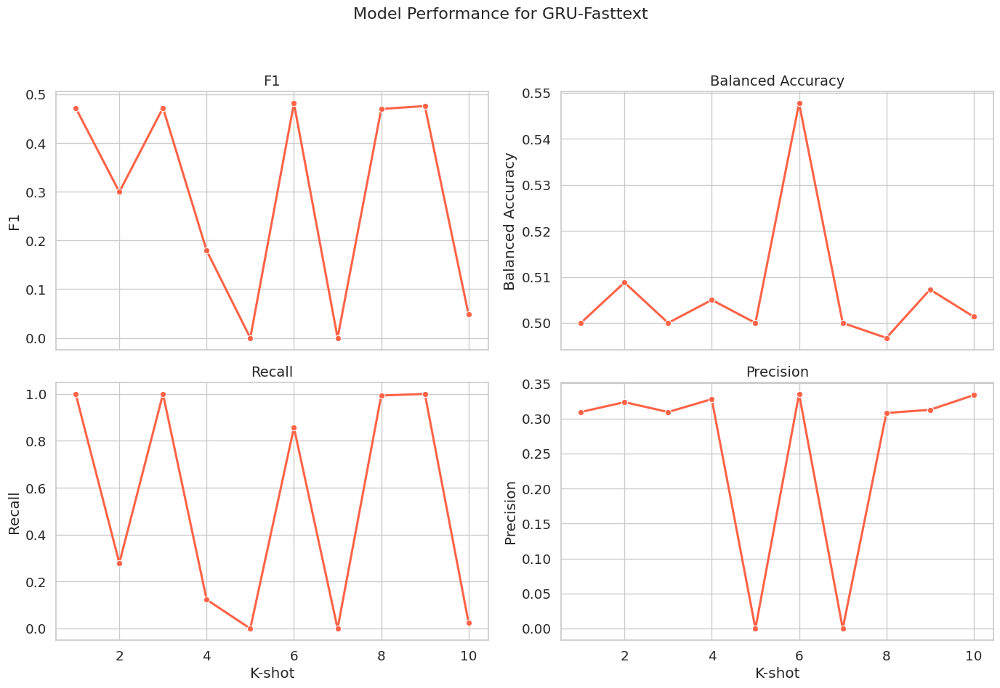

In [ ]:
# Plot results
plot_model_performance(df, "GRU-Fasttext", "tomato")

Maximum values per metric:
Balanced Accuracy: 0.5478 (at K-shot = 6)
F1: 0.4818 (at K-shot = 6)
Recall: 1.0000 (at K-shot = 1)
Precision: 0.3350 (at K-shot = 6)


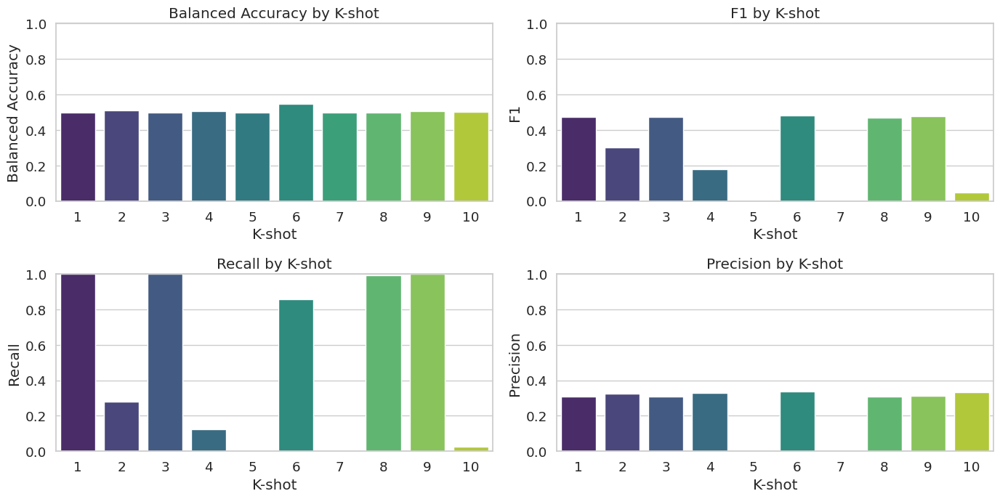

In [ ]:
metrics = ["Balanced Accuracy", "F1", "Recall", "Precision"]

# Print max values for each metric
print("Maximum values per metric:")
for metric in metrics:
    max_val = df[metric].max()
    max_k = df.loc[df[metric].idxmax(), "K-shot"]
    print(f"{metric}: {max_val:.4f} (at K-shot = {max_k})")

# Then plot the histograms
plt.figure(figsize=(14, 10))

for i, metric in enumerate(metrics, 1):
    plt.subplot(3, 2, i)
    sns.barplot(x="K-shot", y=metric, data=df, palette="viridis")
    plt.title(f"{metric} by K-shot")
    plt.ylim(0, 1)
    plt.xlabel("K-shot")
    plt.ylabel(metric)

plt.tight_layout()
plt.show()

## **4. Bidirectional LSTM + Fasttext + Bahdanau Attention + Weight Class**

### **4.1 Optimization Phase**

#### **4.1.1 Optimizer selection**

In [ ]:
num_epochs = 16
learning_rate = 5e-5

class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)
results = []

optimizers = {
    'Adam': optim.Adam,
    'RMSprop': optim.RMSprop,
    'AdamW': optim.AdamW
}

all_train_losses, all_val_losses = {}, {}
all_train_accs, all_val_accs = {}, {}

# Loop through optimizers
for optimizer_name, optimizer_class in optimizers.items():
    print(f"\n🔹 Training with optimizer: {optimizer_name}")

    model = LSTM_BahdanauAttention(
        embedding_matrix=embedding_matrix_fasttext,
        hidden_dim=400,
        num_layers=1,
        dropout_prob=0.5
    ).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=learning_rate)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total trainable parameters: {num_params}")

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []
    best_val_loss = float('inf')

    # Training loop
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # <-- fixed unpacking order

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        scheduler.step(f1)

        duration = time.time() - start_time

        print(
            f"Opt: {optimizer_name} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {duration/60:.2f} min"
        )

    # Store metrics
    all_train_losses[optimizer_name] = train_losses
    all_val_losses[optimizer_name] = val_losses
    all_train_accs[optimizer_name] = train_accs
    all_val_accs[optimizer_name] = val_accs

    label = f"Batch={BATCH_SIZE} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with optimizer: Adam
LSTM_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 14828101
Opt: Adam | Epoch 1/16 - TL: 0.9915, VL: 0.9929, TA: 49.90%, VA: 50.00%, F1: 44.20%, Time: 0.11 min
Opt: Adam | Epoch 2/16 - TL: 0.9921, VL: 0.9913, TA: 54.35%, VA: 58.90%, F1: 48.83%, Time: 0.11 min
Opt: Adam | Epoch 3/16 - TL: 0.9895, VL: 0.9882, TA: 61.91%, VA: 66.88%, F1: 53.77%, Time: 0.11 min
Opt: Adam | Epoch 4/16 - TL: 0.9833, VL: 0.9787, TA: 69.26%, VA: 69.32%, F1: 56.22%, Time: 0.11 min
Opt: Adam | Epoch 5/16 - TL: 0.9483, VL: 0.7799, TA: 68.68%, VA: 72.90%, F1: 59.80%, Time: 0.11 min
Op

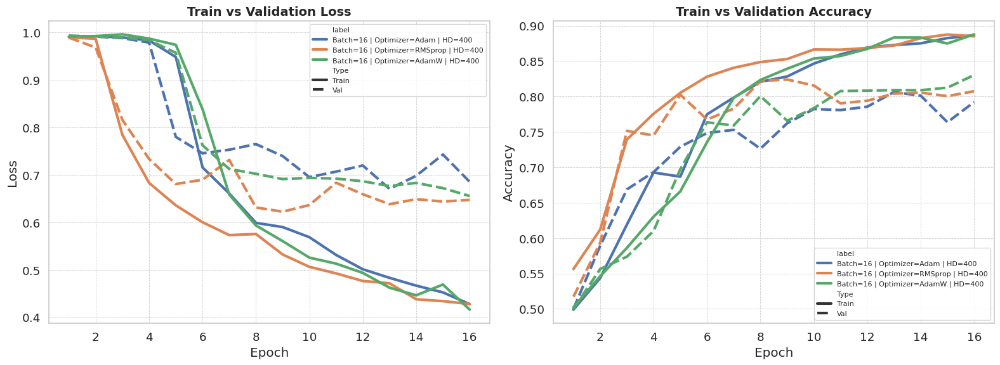

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **4.1.2 Learning rate value selection**

In [ ]:
# Learning rate sweep configuration
learning_rates = [1e-5, 5e-5, 1e-6]
optimizer_name = 'Adam'
optimizer_class = optim.Adam
results = []
num_epochs = 16

# Class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop through learning rates
for lr in learning_rates:
    print(f"\n🔹 Training with {optimizer_name} optimizer, learning rate = {lr}")

    # Instantiate GRU + Bahdanau Attention model
    model = LSTM_BahdanauAttention(
        embedding_matrix=embedding_matrix_fasttext,
        hidden_dim=400,
        num_layers=1,
        dropout_prob=0.5
    ).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        scheduler.step(f1)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"LR: {lr:.1e} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results
    label = f"LR={lr:.1e} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with Adam optimizer, learning rate = 1e-05
LSTM_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
LR: 1.0e-05 | Epoch 1/16 - TL: 0.9917, VL: 0.9937, TA: 49.45%, VA: 50.00%, F1: 44.20%, Time: 0.11 min
LR: 1.0e-05 | Epoch 2/16 - TL: 0.9939, VL: 0.9935, TA: 50.61%, VA: 50.21%, F1: 44.23%, Time: 0.11 min
LR: 1.0e-05 | Epoch 3/16 - TL: 0.9948, VL: 0.9933, TA: 52.58%, VA: 52.17%, F1: 45.10%, Time: 0.11 min
LR: 1.0e-05 | Epoch 4/16 - TL: 0.9934, VL: 0.9930, TA: 52.92%, VA: 53.01%, F1: 45.54%, Time: 0.11 min
LR: 1.0e-05 | Epoch 5/16 - TL: 0.9900, VL: 0.9928, TA: 54.98%, VA: 53.35%, F1: 45.53%, Time: 0.11 min
LR: 1.0

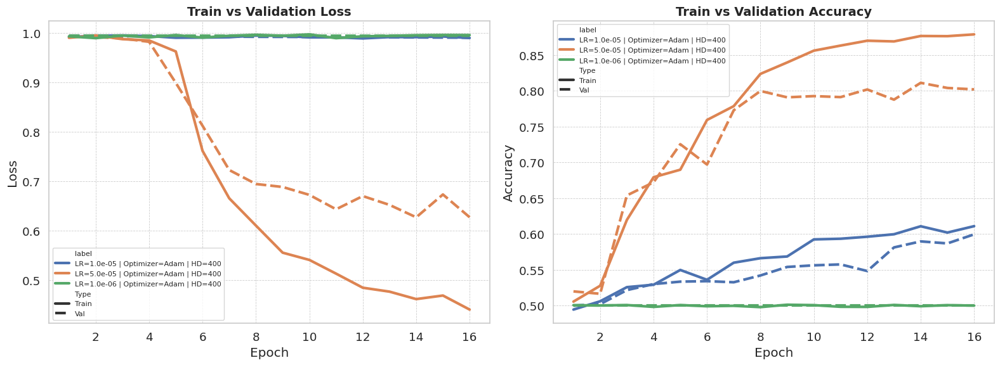

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **4.1.3 Batch size value selection**

In [ ]:
# Batch size sweep configuration
batch_sizes = [8, 16, 64]
learning_rate = 2e-5
num_epochs = 16
results = []

# Compute class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop over different batch sizes
for batch_size in batch_sizes:
    print(f"\n🔹 Training with batch size: {batch_size}")

    # Create DataLoaders with the current batch size
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    # Instantiate GRU + Bahdanau Attention model
    model = LSTM_BahdanauAttention(
        embedding_matrix=embedding_matrix_fasttext,
        hidden_dim=400,
        num_layers=1,
        dropout_prob=0.5
    ).to(device)

    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"BS: {batch_size} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results for later plotting
    label = f"LR={learning_rate:.1e} | Batch={batch_size} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with batch size: 8
BS: 8 | Epoch 1/16 - TL: 0.9919, VL: 1.0032, TA: 51.15%, VA: 54.94%, F1: 45.96%, Time: 0.29 min
BS: 8 | Epoch 2/16 - TL: 0.9898, VL: 1.0003, TA: 58.14%, VA: 67.15%, F1: 53.98%, Time: 0.29 min
BS: 8 | Epoch 3/16 - TL: 0.9857, VL: 0.9881, TA: 64.80%, VA: 67.79%, F1: 54.68%, Time: 0.29 min
BS: 8 | Epoch 4/16 - TL: 0.8699, VL: 0.8261, TA: 73.27%, VA: 75.46%, F1: 63.13%, Time: 0.28 min
BS: 8 | Epoch 5/16 - TL: 0.7658, VL: 0.7666, TA: 77.02%, VA: 74.80%, F1: 61.81%, Time: 0.28 min
BS: 8 | Epoch 6/16 - TL: 0.6970, VL: 0.8645, TA: 80.47%, VA: 70.38%, F1: 57.53%, Time: 0.28 min
BS: 8 | Epoch 7/16 - TL: 0.6191, VL: 0.7256, TA: 80.07%, VA: 77.29%, F1: 65.51%, Time: 0.28 min
BS: 8 | Epoch 8/16 - TL: 0.5894, VL: 0.7805, TA: 82.83%, VA: 77.20%, F1: 65.85%, Time: 0.28 min
BS: 8 | Epoch 9/16 - TL: 0.5787, VL: 0.8057, TA: 84.56%, VA: 77.76%, F1: 66.67%, Time: 0.29 min
BS: 8 | Epoch 10/16 - TL: 0.5780, VL: 0.7559, TA: 83.86%, VA: 78.7

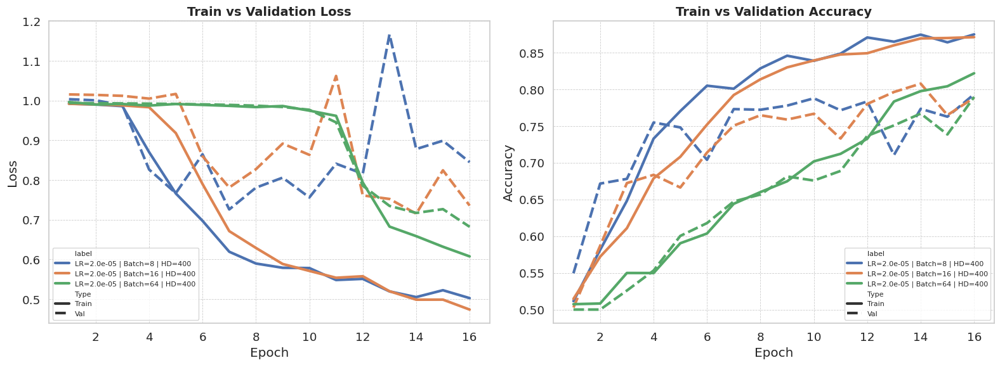

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **4.1.4 Dropout value selection**

In [ ]:
# Hyperparameter sweep configuration
hidden_dims = [286]
dropouts = [0.1, 0.4, 0.8]
learning_rate = 1e-5
batch_size = 16
num_epochs = 16
results = []

# Compute class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for hidden_dim in hidden_dims:
    num_layers = 1  # fixed value for this sweep
    for dropout in dropouts:
        print(f"\n🔹 Training with hidden_dim={hidden_dim}, num_layers={num_layers}, dropout={dropout}")

        # Data loaders
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

        # Instantiate GRU + Bahdanau Attention model with current parameters
        model = LSTM_BahdanauAttention(
            embedding_matrix=embedding_matrix_fasttext,
            hidden_dim=hidden_dim,
            num_layers=num_layers,
            dropout_prob=dropout
        ).to(device)

        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        train_losses, val_losses = [], []
        train_accs, val_accs, val_f1s = [], [], []

        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
            val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

            train_losses.append(train_loss)
            val_losses.append(val_loss)
            train_accs.append(train_acc)
            val_accs.append(val_acc)
            val_f1s.append(f1)

            print(
                f"HD: {hidden_dim} | NL: {num_layers} | DP: {dropout} | Epoch {epoch+1}/{num_epochs} - "
                f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
                f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
                f"Time: {(time.time() - start_time)/60:.2f} min"
            )

        # Store results
        label = f"LR={learning_rate:.1e} | BS={batch_size} | HD={hidden_dim} | NL={num_layers} | DP={dropout}"
        for epoch in range(num_epochs):
            results.append({
                "epoch": epoch + 1,
                "label": label,
                "train_loss": train_losses[epoch],
                "val_loss": val_losses[epoch],
                "train_acc": train_accs[epoch],
                "val_acc": val_accs[epoch],
                "val_f1": val_f1s[epoch]
            })

Class weights: [0.69741587 1.76636225]

🔹 Training with hidden_dim=286, num_layers=1, dropout=0.1
HD: 286 | NL: 1 | DP: 0.1 | Epoch 1/16 - TL: 0.9986, VL: 1.0163, TA: 51.45%, VA: 65.61%, F1: 51.65%, Time: 0.10 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 2/16 - TL: 0.9979, VL: 1.0156, TA: 57.15%, VA: 65.11%, F1: 52.68%, Time: 0.10 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 3/16 - TL: 0.9900, VL: 1.0149, TA: 58.63%, VA: 65.65%, F1: 53.01%, Time: 0.10 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 4/16 - TL: 0.9890, VL: 1.0139, TA: 63.10%, VA: 66.70%, F1: 53.88%, Time: 0.10 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 5/16 - TL: 0.9877, VL: 1.0127, TA: 69.15%, VA: 68.49%, F1: 55.38%, Time: 0.10 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 6/16 - TL: 0.9931, VL: 1.0108, TA: 69.95%, VA: 68.57%, F1: 55.47%, Time: 0.10 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 7/16 - TL: 0.9834, VL: 1.0077, TA: 70.25%, VA: 68.67%, F1: 55.66%, Time: 0.10 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 8/16 - TL: 0.9786, VL: 1.0022, TA: 71.63%, VA: 70.55%, F

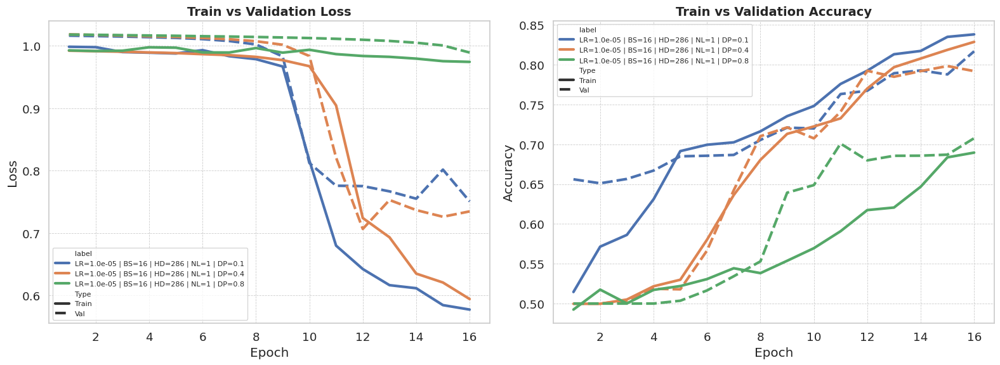

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

### **4.2 Test Phase**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [50]:
# --- Hyperparameters ---
HIDDEN_DIM = 286
DROPOUT = 0.8
NUM_LAYERS = 1
learning_rate = 5e-5
num_epochs = 50
patience = 6
best_model_path = "best_model2.pth"

# --- Model Instantiation ---
model = LSTM_BahdanauAttention(
    embedding_matrix=embedding_matrix_fasttext,
    hidden_dim=HIDDEN_DIM,
    num_layers=NUM_LAYERS,
    dropout_prob=DROPOUT
).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# --- Compute Class Weights ---
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Tracking Variables ---
train_losses, test_losses = [], []
train_accuracies, test_accuracies = [], []
test_f1s, test_balanced_accs, test_recalls, test_precisions = [], [], [], []

best_test_bal_acc = 0
patience_counter = 0
best_model_state = None

# --- Scheduler ---
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-6
)

# --- Training with Early Stopping ---
with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as epoch_pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        # Training step
        train_loss, train_acc = train_epoch(model, combined_loader, optimizer, loss_function, device)

        # Evaluation step
        test_loss, test_acc, test_f1, test_balanced_acc, test_recall, test_precision = test_epoch(
            model, test_loader, loss_function, device
        )

        # Logging
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        test_losses.append(test_loss)
        test_balanced_accs.append(test_balanced_acc)
        test_f1s.append(test_f1)

        # Scheduler step
        scheduler.step(test_balanced_acc)

        epoch_duration = time.time() - start_time

        # --- Early Stopping Logic ---
        if test_balanced_acc > best_test_bal_acc:
            best_test_bal_acc = test_balanced_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
            torch.save(best_model_state, best_model_path)
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"\nEarly stopping at epoch {epoch + 1}.")
                break

        epoch_pbar.set_postfix({
            "Training Loss": f"{train_loss:.4f}",
            "Test Loss": f"{test_loss:.4f}",
            "Train Balanced Acc": f"{train_acc:.2%}",
            "Test Balanced Acc": f"{test_balanced_acc:.2%}",
            "Test F1": f"{test_f1:.2%}",
            "Test Precision": f"{test_precision:.2%}",
            "Test Recall": f"{test_recall:.2%}",
            "Time(min)": f"{epoch_duration / 60:.2f}"
        })
        epoch_pbar.update(1)

# --- Load Best Model ---
model.load_state_dict(torch.load(best_model_path))

Class weights: [0.69741587 1.76636225]


Training Progress:  46%|████▌     | 23/50 [04:18<05:03, 11.24s/epoch, Training Loss=0.2787, Test Loss=0.7593, Train Balanced Acc=92.33%, Test Balanced Acc=80.25%, Test F1=72.27%, Test Precision=69.46%, Test Recall=75.32%, Time(min)=0.13]


Early stopping at epoch 24.


<All keys matched successfully>

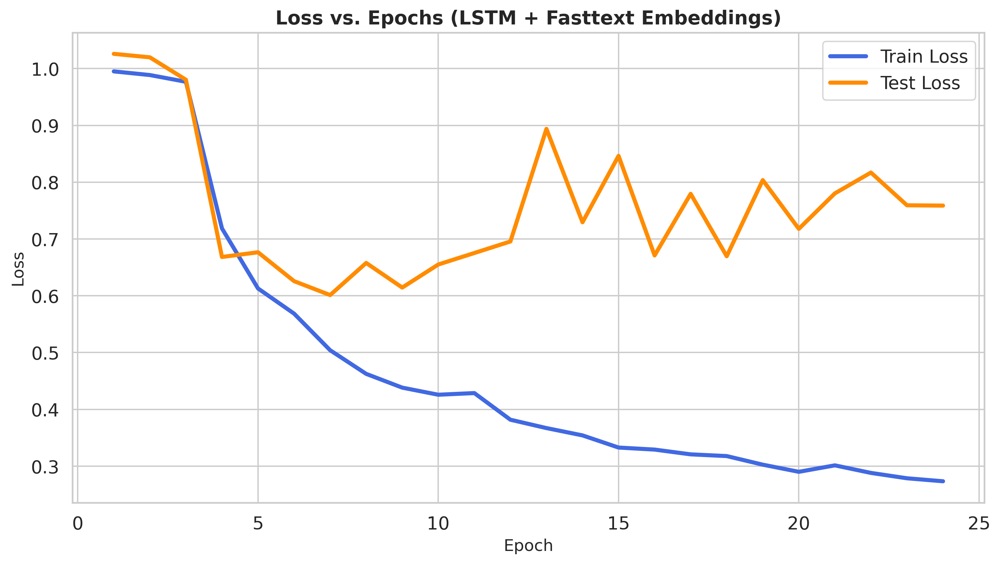

In [51]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=epochs, y=test_losses, label='Test Loss', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (LSTM + Fasttext Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='upper right', frameon=True)
plt.tight_layout()

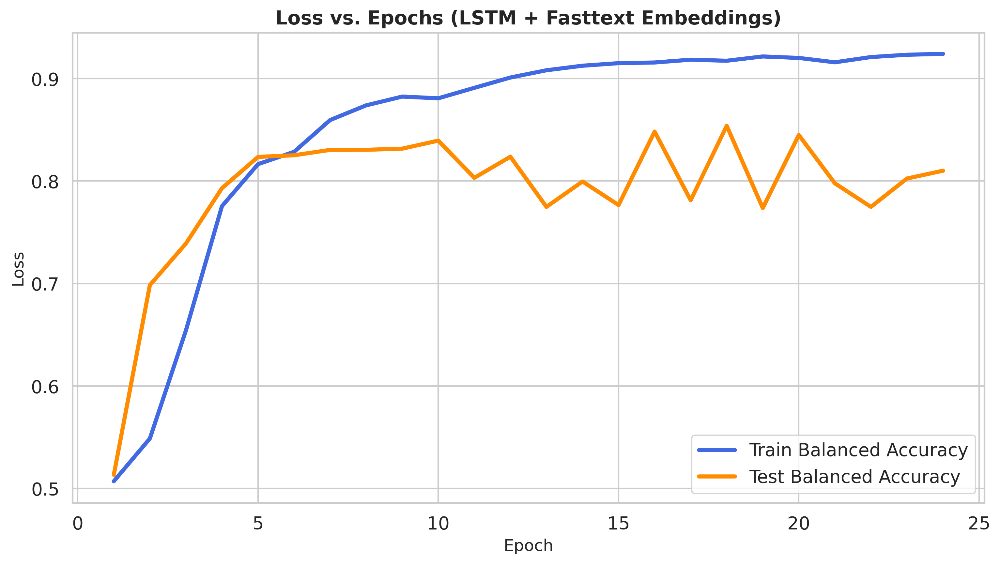

In [52]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 2. Balanced Accurcy Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_accuracies, label='Train Balanced Accuracy', color='royalblue')
sns.lineplot(x=epochs, y=test_balanced_accs, label='Test Balanced Accuracy', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (LSTM + Fasttext Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='lower right', frameon=True)
plt.tight_layout()

In [53]:
model = LSTM_BahdanauAttention(embedding_matrix=embedding_matrix_fasttext,
                                  hidden_dim=HIDDEN_DIM,
                                  num_layers=NUM_LAYERS,
                                  dropout_prob=DROPOUT
                                ).to(device)

model.load_state_dict(torch.load("/content/best_model2.pth"))
model.eval()

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Recalculate metrics on test set ---
final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_epoch(
    model, test_loader, loss_function, device
)

# --- Print results ---
print("\n Final Evaluation Metrics of Best Model:")
print(f"Test Loss           : {final_test_loss:.4f}")
print(f"Test Accuracy       : {final_test_acc:.2%}")
print(f"Test F1 Score       : {final_test_f1:.2%}")
print(f"Balanced Accuracy   : {final_test_bal_acc:.2%}")
print(f"Test Precision      : {final_test_precision:.2%}")
print(f"Test Recall         : {final_test_recall:.2%}")

Class weights: [0.69741587 1.76636225]

 Final Evaluation Metrics of Best Model:
Test Loss           : 0.6696
Test Accuracy       : 83.53%
Test F1 Score       : 77.22%
Balanced Accuracy   : 85.39%
Test Precision      : 67.48%
Test Recall         : 90.26%


In [54]:
df_results, df_correct, df_wrong, all_labels, all_pred, all_probs = evaluate_and_analyze(model, test_loader, device)

In [ ]:
df_correct.head()

,index,true_label,predicted_label,probability,text
0,0,1,1,0.852437,PDGFRA H845_N848delinsP Gastrointestinal strom...
1,1,0,0,0.013275,BRCA2 G2748D Mutation screening of the breast ...
2,2,0,0,0.014826,PTEN F347L The tumor suppressor gene PTEN is f...
3,4,0,0,0.020568,PIK3R2 Amplification Structural rearrangements...
4,5,0,0,0.015368,TP53 R175H Tumor suppressor p53-dependent apop...


In [ ]:
df_wrong.head()

,index,true_label,predicted_label,probability,text
0,3,0,1,0.823782,HRAS G12A The three-dimensional structure of t...
1,13,0,1,0.554441,CHEK2 K373E We identified CHK2 K373E as a recu...
2,1,0,1,0.794204,"BRAF T241P Noonan, LEOPARD and cardiofaciocuta..."
3,7,0,1,0.692387,RUNX1 D171N Introduction Myelodysplastic synd...
4,10,0,1,0.868622,KIT E839K c-KIT is a member of the type 3 subc...


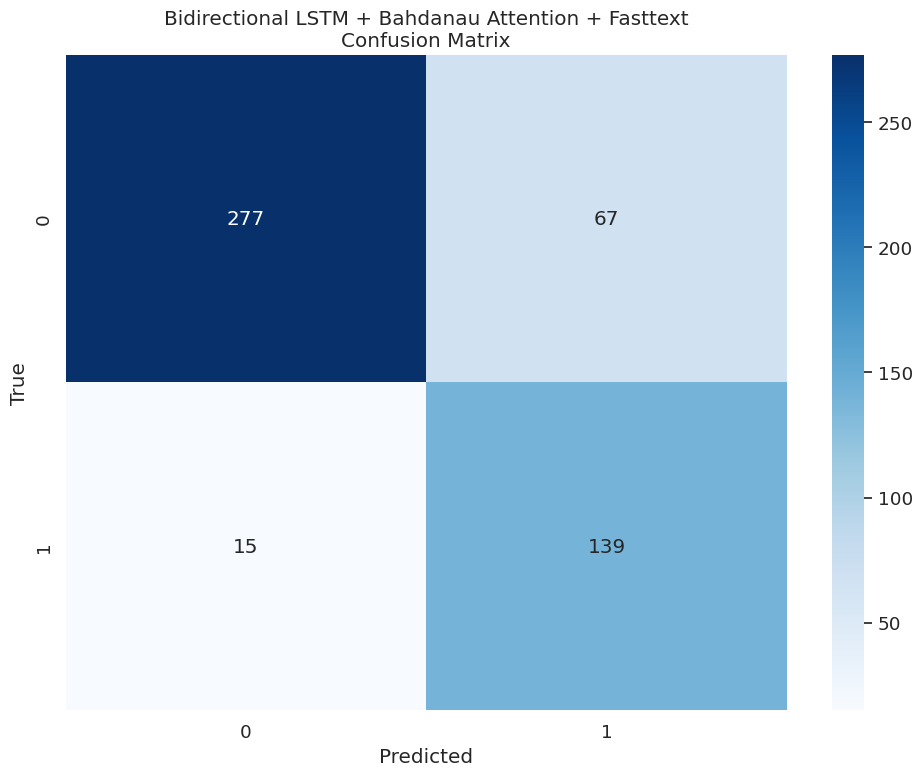

In [55]:
NUM_CLASSES = 2

fig, axes = plt.subplots(1, 1, figsize=(10, 8))

plot_confusion_matrix(axes, all_labels, all_pred)
axes.set_title("Bidirectional LSTM + Bahdanau Attention + Fasttext\nConfusion Matrix")

plt.tight_layout()
plt.show()

In [56]:
from sklearn.metrics import roc_curve, auc

y_true = np.array(all_labels)
y_scores = np.array(all_probs)

fpr, tpr, _ = roc_curve(y_true , y_scores)
roc_auc = auc(fpr, tpr)

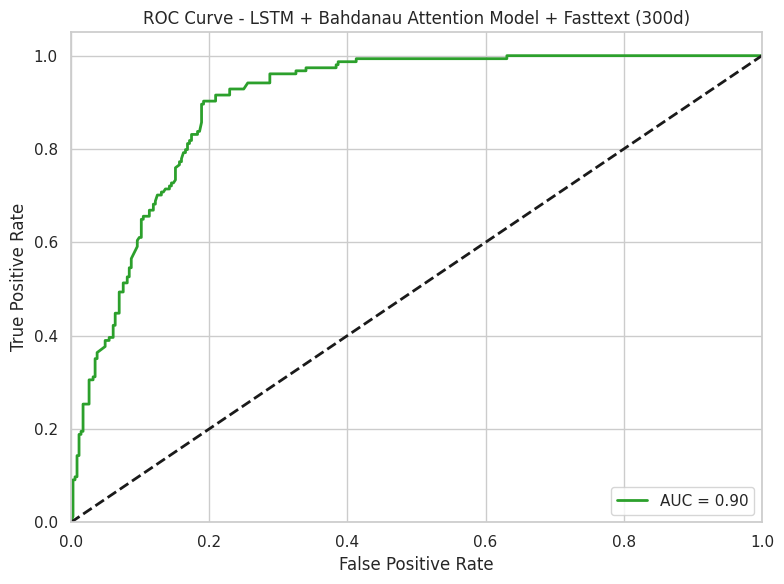

In [57]:
sns.set(style="whitegrid")

# One plot only
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

ax.plot(fpr, tpr, lw=2,
        label=f'AUC = {roc_auc:.2f}', color='tab:green')
ax.plot([0, 1], [0, 1], 'k--', lw=2)
ax.set_xlim([0.0, 1.0])
ax.set_ylim([0.0, 1.05])
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_title('ROC Curve - LSTM + Bahdanau Attention Model + Fasttext (300d)')
ax.legend(loc='lower right')
ax.grid(True)

plt.tight_layout()
plt.show()

### **4.3 Few Shot Learning**

In [ ]:
k_values = range(1, 11)  # Few-shot from k=1 to 10
NUM_CLASSES = 2
HIDDEN_DIM = 286
DROPOUT = 0.7

X_combined = np.concatenate((X_train, X_val), axis=0)
y_combined = np.concatenate((y_train, y_val), axis=0)
X_combined_tensor = torch.cat((X_train_tensor, X_val_tensor), dim=0)
y_combined_tensor = torch.cat((y_train_tensor, y_val_tensor), dim=0)

model_metrics = {
    "K-shot": [],
    "Model": [],
    "Test Accuracy": [],
    "F1": [],
    "Balanced Accuracy": [],
    "Recall": [],
    "Precision": []
}

patience = 7
num_epochs = 50
for k in k_values:
    print(f"\n--- K-Shot = {k} ---")

    X_few, y_few = get_few_shot_subset(X_combined_tensor, y_combined_tensor, k_shot=k)
    few_shot_dataset = TextDataset(X_few, y_few, raw_text_data=X_combined)
    few_shot_loader = DataLoader(few_shot_dataset, batch_size=batch_size, shuffle=True, collate_fn=custom_collate_fn)

    model = LSTM_BahdanauAttention(
                embedding_matrix=embedding_matrix_fasttext,
                hidden_dim=HIDDEN_DIM,
                num_layers=NUM_LAYERS,
                dropout_prob=DROPOUT
            ).to(device)
    print(f"{count_parameters(model)} model parameters")
    print()
    print(model)

    learning_rate = 2e-5
    optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)

    class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
    print(f"Class weights: {class_weights}")

    pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
    loss_function = torch.nn.BCEWithLogitsLoss()

    # Train with early stopping
    best_val_acc = 0
    patience_counter = 0
    for epoch in range(num_epochs):
        train_loss, train_acc = train_epoch(model, few_shot_loader, optimizer, loss_function, device)
        val_acc, val_f1, val_loss = evaluate_epoch(model, test_loader, loss_function, device)

        print(f"K={k} | Epoch {epoch+1}/{num_epochs} "
              f"- Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, "
              f"Test Loss: {val_loss:.4f}, Test Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                break

    # Load best model
    model.load_state_dict(best_model_state)

    # Evaluate on test set
    avg_loss, avg_accuracy, f1, balanced_acc, recall, precision = test_epoch(model, test_loader, loss_function, device)

    # Log metrics
    print(f"Test Accuracy: {avg_accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"Balanced Accuracy: {balanced_acc:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"Precision: {precision:.4f}")

    model_metrics["K-shot"].append(k)
    model_metrics["Model"].append("LSTM-Fasttext")
    model_metrics["Test Accuracy"].append(avg_accuracy)
    model_metrics["F1"].append(f1)
    model_metrics["Balanced Accuracy"].append(balanced_acc)
    model_metrics["Recall"].append(recall)
    model_metrics["Precision"].append(precision)

# Convert results to DataFrame
df = pd.DataFrame(model_metrics)


--- K-Shot = 1 ---
13770181 model parameters

LSTM_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_features=286, bias=True)
    (v): Linear(in_features=286, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.7, inplace=False)
  (fc): Linear(in_features=572, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=1 | Epoch 1/50 - Train Loss: 0.6998, Train Acc: 0.0000, Test Loss: 0.4762, Test Acc: 0.6940, Val F1: 0.5202
K=1 | Epoch 2/50 - Train Loss: 0.6941, Train Acc: 0.5000, Test Loss: 0.4778, Test Acc: 0.6940, Val F1: 0.5231
K=1 | Epoch 3/50 - Train Loss: 0.6942, Train Acc: 0.5000, Test Loss: 0.4744, Test Acc: 0.6938, Val F1: 0.5254
K=1 | Epoch 4/50 - Train Loss: 0.6790, Train Acc: 1.0000, Test Loss: 0.4440, Test Acc: 0.6936, Val F1: 0.4967
K=1 | Epoch 5/50 - Train Loss: 0.6932, Train Acc: 0.5000, Test Loss: 0.4440, Test Acc: 0.6936, Val F1: 0.4967
K=1 | Epoch 6/50 - Train Loss: 0.6866, Train Acc: 1.0000, Test Loss: 0.4432, Test Acc: 0.6936, Val F1: 0.4953
K=1 | Epoch 7/50 - Train Loss: 0.6669, Train Acc: 1.0000, Test Loss: 0.4375, Test Acc: 0.6936, Val F1: 0.4925
K=1 | Epoch 8/50 - Train Loss: 0.6862, Train Acc: 0.5000, Test Loss: 0.4267, Test Acc: 0.6935, Val F1: 0.4809
Test Accuracy: 0.3594
F1 Score: 0.4762
Balanced Accuracy: 0.5202
Recall: 0.9416
Precision: 0.3187

--- K-Shot = 2 ---
13

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=2 | Epoch 1/50 - Train Loss: 0.6967, Train Acc: 0.2500, Test Loss: 0.0000, Test Acc: 0.6890, Val F1: 0.5000
K=2 | Epoch 2/50 - Train Loss: 0.7006, Train Acc: 0.2500, Test Loss: 0.0000, Test Acc: 0.6892, Val F1: 0.5000
K=2 | Epoch 3/50 - Train Loss: 0.6978, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6893, Val F1: 0.5000
K=2 | Epoch 4/50 - Train Loss: 0.6955, Train Acc: 0.2500, Test Loss: 0.0000, Test Acc: 0.6894, Val F1: 0.5000
K=2 | Epoch 5/50 - Train Loss: 0.6850, Train Acc: 0.7500, Test Loss: 0.0000, Test Acc: 0.6895, Val F1: 0.5000
K=2 | Epoch 6/50 - Train Loss: 0.6977, Train Acc: 0.2500, Test Loss: 0.0000, Test Acc: 0.6896, Val F1: 0.5000
K=2 | Epoch 7/50 - Train Loss: 0.6915, Train Acc: 0.7500, Test Loss: 0.0000, Test Acc: 0.6897, Val F1: 0.5000
K=2 | Epoch 8/50 - Train Loss: 0.6865, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6897, Val F1: 0.5000
K=2 | Epoch 9/50 - Train Loss: 0.6893, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6897, Val F1: 0.5000
K=2 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=3 | Epoch 1/50 - Train Loss: 0.6946, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6865, Val F1: 0.5000
K=3 | Epoch 2/50 - Train Loss: 0.6886, Train Acc: 0.6667, Test Loss: 0.0000, Test Acc: 0.6869, Val F1: 0.5000
K=3 | Epoch 3/50 - Train Loss: 0.6882, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6871, Val F1: 0.5000
K=3 | Epoch 4/50 - Train Loss: 0.6887, Train Acc: 0.6667, Test Loss: 0.0000, Test Acc: 0.6873, Val F1: 0.5000
K=3 | Epoch 5/50 - Train Loss: 0.6960, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6876, Val F1: 0.5000
K=3 | Epoch 6/50 - Train Loss: 0.6964, Train Acc: 0.3333, Test Loss: 0.0000, Test Acc: 0.6878, Val F1: 0.5000
K=3 | Epoch 7/50 - Train Loss: 0.6983, Train Acc: 0.3333, Test Loss: 0.0000, Test Acc: 0.6880, Val F1: 0.5000
K=3 | Epoch 8/50 - Train Loss: 0.6926, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6881, Val F1: 0.5000
K=3 | Epoch 9/50 - Train Loss: 0.6872, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6881, Val F1: 0.5000
K=3 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=4 | Epoch 1/50 - Train Loss: 0.6890, Train Acc: 0.3750, Test Loss: 0.0000, Test Acc: 0.6902, Val F1: 0.5000
K=4 | Epoch 2/50 - Train Loss: 0.6869, Train Acc: 0.7500, Test Loss: 0.0000, Test Acc: 0.6902, Val F1: 0.5000
K=4 | Epoch 3/50 - Train Loss: 0.7004, Train Acc: 0.3750, Test Loss: 0.0000, Test Acc: 0.6902, Val F1: 0.5000
K=4 | Epoch 4/50 - Train Loss: 0.6933, Train Acc: 0.3750, Test Loss: 0.0000, Test Acc: 0.6903, Val F1: 0.5000
K=4 | Epoch 5/50 - Train Loss: 0.6953, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6905, Val F1: 0.5000
K=4 | Epoch 6/50 - Train Loss: 0.6899, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6906, Val F1: 0.5000
K=4 | Epoch 7/50 - Train Loss: 0.6899, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6906, Val F1: 0.5000
K=4 | Epoch 8/50 - Train Loss: 0.6891, Train Acc: 0.7500, Test Loss: 0.0000, Test Acc: 0.6906, Val F1: 0.5000
K=4 | Epoch 9/50 - Train Loss: 0.6838, Train Acc: 0.7500, Test Loss: 0.0000, Test Acc: 0.6906, Val F1: 0.5000
K=4 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=5 | Epoch 1/50 - Train Loss: 0.6943, Train Acc: 0.4000, Test Loss: 0.4232, Test Acc: 0.6931, Val F1: 0.5416
K=5 | Epoch 2/50 - Train Loss: 0.6944, Train Acc: 0.5000, Test Loss: 0.4178, Test Acc: 0.6930, Val F1: 0.5432
K=5 | Epoch 3/50 - Train Loss: 0.6924, Train Acc: 0.5000, Test Loss: 0.4060, Test Acc: 0.6928, Val F1: 0.5565
K=5 | Epoch 4/50 - Train Loss: 0.6870, Train Acc: 0.6000, Test Loss: 0.3659, Test Acc: 0.6927, Val F1: 0.5357
K=5 | Epoch 5/50 - Train Loss: 0.6887, Train Acc: 0.7000, Test Loss: 0.3624, Test Acc: 0.6927, Val F1: 0.5511
K=5 | Epoch 6/50 - Train Loss: 0.6888, Train Acc: 0.7000, Test Loss: 0.3636, Test Acc: 0.6926, Val F1: 0.5460
K=5 | Epoch 7/50 - Train Loss: 0.6844, Train Acc: 0.9000, Test Loss: 0.3692, Test Acc: 0.6926, Val F1: 0.5335
K=5 | Epoch 8/50 - Train Loss: 0.6844, Train Acc: 0.9000, Test Loss: 0.3729, Test Acc: 0.6925, Val F1: 0.5536
Test Accuracy: 0.5402
F1 Score: 0.4232
Balanced Accuracy: 0.5416
Recall: 0.5455
Precision: 0.3457

--- K-Shot = 6 ---
13

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=6 | Epoch 1/50 - Train Loss: 0.6917, Train Acc: 0.6667, Test Loss: 0.0000, Test Acc: 0.6912, Val F1: 0.5000
K=6 | Epoch 2/50 - Train Loss: 0.6939, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6912, Val F1: 0.5000
K=6 | Epoch 3/50 - Train Loss: 0.6922, Train Acc: 0.5833, Test Loss: 0.0000, Test Acc: 0.6912, Val F1: 0.5000
K=6 | Epoch 4/50 - Train Loss: 0.6940, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6913, Val F1: 0.4985
K=6 | Epoch 5/50 - Train Loss: 0.6880, Train Acc: 0.6667, Test Loss: 0.0000, Test Acc: 0.6914, Val F1: 0.4971
K=6 | Epoch 6/50 - Train Loss: 0.6858, Train Acc: 0.7500, Test Loss: 0.0250, Test Acc: 0.6914, Val F1: 0.5007
K=6 | Epoch 7/50 - Train Loss: 0.6919, Train Acc: 0.5000, Test Loss: 0.0368, Test Acc: 0.6914, Val F1: 0.5010
K=6 | Epoch 8/50 - Train Loss: 0.6901, Train Acc: 0.4167, Test Loss: 0.0476, Test Acc: 0.6914, Val F1: 0.4985
K=6 | Epoch 9/50 - Train Loss: 0.6945, Train Acc: 0.2500, Test Loss: 0.0909, Test Acc: 0.6915, Val F1: 0.5056
K=6 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=7 | Epoch 1/50 - Train Loss: 0.6907, Train Acc: 0.5000, Test Loss: 0.4576, Test Acc: 0.6941, Val F1: 0.4875
K=7 | Epoch 2/50 - Train Loss: 0.6905, Train Acc: 0.6429, Test Loss: 0.4657, Test Acc: 0.6941, Val F1: 0.4987
K=7 | Epoch 3/50 - Train Loss: 0.6972, Train Acc: 0.3571, Test Loss: 0.4459, Test Acc: 0.6941, Val F1: 0.4838
K=7 | Epoch 4/50 - Train Loss: 0.6947, Train Acc: 0.4286, Test Loss: 0.4189, Test Acc: 0.6939, Val F1: 0.4752
K=7 | Epoch 5/50 - Train Loss: 0.6941, Train Acc: 0.3571, Test Loss: 0.4160, Test Acc: 0.6938, Val F1: 0.4859
K=7 | Epoch 6/50 - Train Loss: 0.6909, Train Acc: 0.6429, Test Loss: 0.4167, Test Acc: 0.6938, Val F1: 0.4848
K=7 | Epoch 7/50 - Train Loss: 0.6908, Train Acc: 0.4286, Test Loss: 0.4160, Test Acc: 0.6938, Val F1: 0.4859
K=7 | Epoch 8/50 - Train Loss: 0.6917, Train Acc: 0.6429, Test Loss: 0.4122, Test Acc: 0.6938, Val F1: 0.4864
K=7 | Epoch 9/50 - Train Loss: 0.6895, Train Acc: 0.7143, Test Loss: 0.4225, Test Acc: 0.6937, Val F1: 0.5189
Test Accur

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=8 | Epoch 1/50 - Train Loss: 0.6929, Train Acc: 0.5000, Test Loss: 0.4668, Test Acc: 0.6942, Val F1: 0.5039
K=8 | Epoch 2/50 - Train Loss: 0.6864, Train Acc: 0.6875, Test Loss: 0.4433, Test Acc: 0.6940, Val F1: 0.4842
K=8 | Epoch 3/50 - Train Loss: 0.6933, Train Acc: 0.5625, Test Loss: 0.4476, Test Acc: 0.6938, Val F1: 0.4941
K=8 | Epoch 4/50 - Train Loss: 0.6974, Train Acc: 0.3750, Test Loss: 0.4476, Test Acc: 0.6939, Val F1: 0.4941
K=8 | Epoch 5/50 - Train Loss: 0.6893, Train Acc: 0.5625, Test Loss: 0.4476, Test Acc: 0.6938, Val F1: 0.4941
K=8 | Epoch 6/50 - Train Loss: 0.6895, Train Acc: 0.5000, Test Loss: 0.4476, Test Acc: 0.6939, Val F1: 0.4941
K=8 | Epoch 7/50 - Train Loss: 0.6899, Train Acc: 0.4375, Test Loss: 0.4476, Test Acc: 0.6939, Val F1: 0.4941
K=8 | Epoch 8/50 - Train Loss: 0.6892, Train Acc: 0.6875, Test Loss: 0.4499, Test Acc: 0.6938, Val F1: 0.4984
Test Accuracy: 0.3394
F1 Score: 0.4668
Balanced Accuracy: 0.5039
Recall: 0.9351
Precision: 0.3110

--- K-Shot = 9 ---
13

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=9 | Epoch 1/50 - Train Loss: 0.6804, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 0.7032, Val F1: 0.5000
K=9 | Epoch 2/50 - Train Loss: 0.6927, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 0.7030, Val F1: 0.5000
K=9 | Epoch 3/50 - Train Loss: 0.6993, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 0.7027, Val F1: 0.5000
K=9 | Epoch 4/50 - Train Loss: 0.6986, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 0.7026, Val F1: 0.5000
K=9 | Epoch 5/50 - Train Loss: 0.6890, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 0.7035, Val F1: 0.5000
K=9 | Epoch 6/50 - Train Loss: 0.6821, Train Acc: 0.4444, Test Loss: 0.4724, Test Acc: 0.7043, Val F1: 0.5000
K=9 | Epoch 7/50 - Train Loss: 0.6971, Train Acc: 0.4444, Test Loss: 0.4724, Test Acc: 0.7042, Val F1: 0.5000
K=9 | Epoch 8/50 - Train Loss: 0.6884, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 0.7041, Val F1: 0.5000
K=9 | Epoch 9/50 - Train Loss: 0.6934, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 0.7041, Val F1: 0.5000
K=9 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=10 | Epoch 1/50 - Train Loss: 0.6855, Train Acc: 0.6500, Test Loss: 0.4731, Test Acc: 0.6967, Val F1: 0.5015
K=10 | Epoch 2/50 - Train Loss: 0.6960, Train Acc: 0.5000, Test Loss: 0.4748, Test Acc: 0.6964, Val F1: 0.5092
K=10 | Epoch 3/50 - Train Loss: 0.6857, Train Acc: 0.6500, Test Loss: 0.4739, Test Acc: 0.6970, Val F1: 0.5088
K=10 | Epoch 4/50 - Train Loss: 0.6984, Train Acc: 0.5000, Test Loss: 0.4760, Test Acc: 0.6969, Val F1: 0.5143
K=10 | Epoch 5/50 - Train Loss: 0.6942, Train Acc: 0.5000, Test Loss: 0.4643, Test Acc: 0.6967, Val F1: 0.5006
K=10 | Epoch 6/50 - Train Loss: 0.6907, Train Acc: 0.6500, Test Loss: 0.4643, Test Acc: 0.6972, Val F1: 0.5006
K=10 | Epoch 7/50 - Train Loss: 0.6876, Train Acc: 0.6500, Test Loss: 0.4643, Test Acc: 0.6976, Val F1: 0.5006
K=10 | Epoch 8/50 - Train Loss: 0.6976, Train Acc: 0.5000, Test Loss: 0.4641, Test Acc: 0.6969, Val F1: 0.5065
K=10 | Epoch 9/50 - Train Loss: 0.6971, Train Acc: 0.4000, Test Loss: 0.4497, Test Acc: 0.6967, Val F1: 0.4911
K

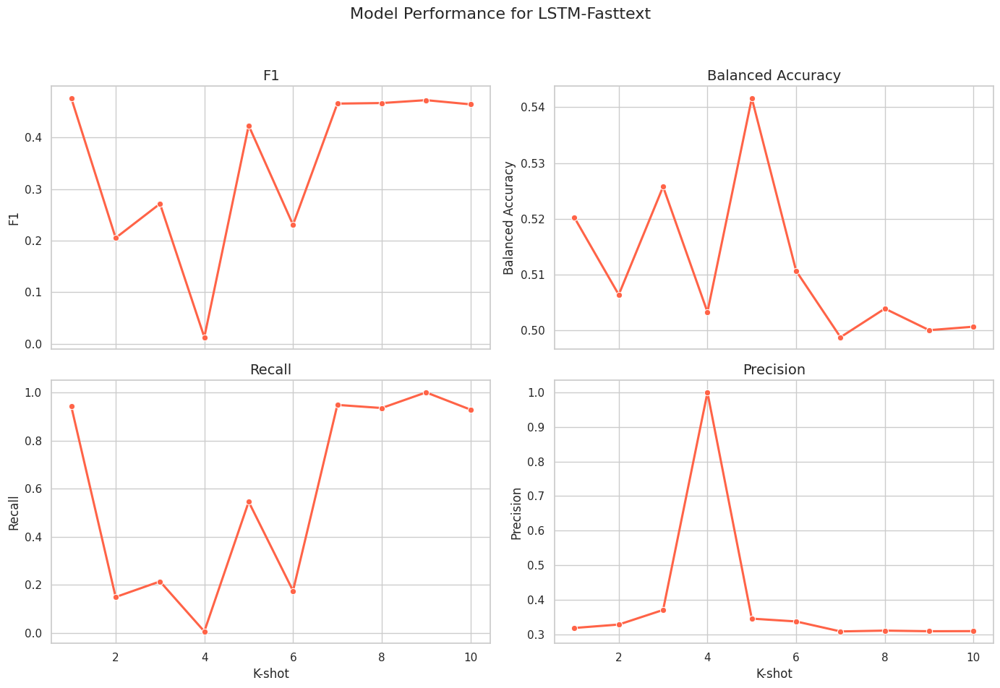

In [ ]:
# Plot results
plot_model_performance(df, "LSTM-Fasttext", "tomato")

Maximum values per metric:
Balanced Accuracy: 0.5416 (at K-shot = 5)
F1: 0.4762 (at K-shot = 1)
Recall: 1.0000 (at K-shot = 9)
Precision: 1.0000 (at K-shot = 4)


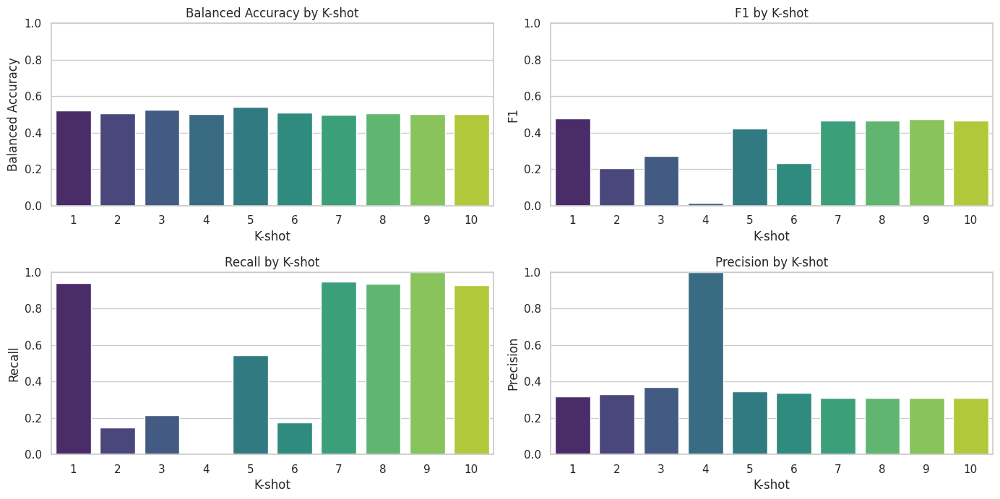

In [ ]:
metrics = ["Balanced Accuracy", "F1", "Recall", "Precision"]

# Print max values for each metric
print("Maximum values per metric:")
for metric in metrics:
    max_val = df[metric].max()
    max_k = df.loc[df[metric].idxmax(), "K-shot"]
    print(f"{metric}: {max_val:.4f} (at K-shot = {max_k})")

# Then plot the histograms
plt.figure(figsize=(14, 10))

for i, metric in enumerate(metrics, 1):
    plt.subplot(3, 2, i)
    sns.barplot(x="K-shot", y=metric, data=df, palette="viridis")
    plt.title(f"{metric} by K-shot")
    plt.ylim(0, 1)
    plt.xlabel("K-shot")
    plt.ylabel(metric)

plt.tight_layout()
plt.show()

## **5. Bidirectional LSTM + Weight Class (embeddings learned from scratch)**

### **5.1 Optimization Phase**

#### **5.1.1 Optimizer selection**

In [ ]:
num_epochs = 16
learning_rate = 5e-5

class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)
results = []

optimizers = {
    'Adam': optim.Adam,
    'RMSprop': optim.RMSprop,
    'AdamW': optim.AdamW
}

all_train_losses, all_val_losses = {}, {}
all_train_accs, all_val_accs = {}, {}

# Loop through optimizers
for optimizer_name, optimizer_class in optimizers.items():
    print(f"\n🔹 Training with optimizer: {optimizer_name}")

    model = LSTM_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=learning_rate)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total trainable parameters: {num_params}")

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []
    best_val_loss = float('inf')

    # Training loop
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # <-- fixed unpacking order

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        scheduler.step(f1)

        duration = time.time() - start_time

        print(
            f"Opt: {optimizer_name} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {duration/60:.2f} min"
        )

    # Store metrics
    all_train_losses[optimizer_name] = train_losses
    all_val_losses[optimizer_name] = val_losses
    all_train_accs[optimizer_name] = train_accs
    all_val_accs[optimizer_name] = val_accs

    label = f"Batch={BATCH_SIZE} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with optimizer: Adam
LSTM_Model(
  (embedding): Embedding(40867, 450)
  (lstm): LSTM(450, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 22199151
Opt: Adam | Epoch 1/16 - TL: 0.9756, VL: 0.9567, TA: 60.46%, VA: 65.15%, F1: 50.50%, Time: 0.15 min
Opt: Adam | Epoch 2/16 - TL: 0.9308, VL: 0.9193, TA: 70.83%, VA: 70.19%, F1: 57.23%, Time: 0.15 min
Opt: Adam | Epoch 3/16 - TL: 0.8899, VL: 0.8843, TA: 75.81%, VA: 75.95%, F1: 63.95%, Time: 0.15 min
Opt: Adam | Epoch 4/16 - TL: 0.8458, VL: 0.8496, TA: 79.44%, VA: 76.37%, F1: 64.37%, Time: 0.16 min
Opt: Adam | Epoch 5/16 - TL: 0.8012, VL: 0.8110, TA: 80.75%, VA: 76.80%, F1: 64.77%, Time: 0.16 min
Opt: Adam | Epoch 6/16 - TL: 0.7428, VL: 0.7605, TA: 82.46%, VA: 78.74%, F1: 66.31%, Time: 0.16 min
Opt: Adam | Epoch 7/16 - TL: 0.6681, VL: 0.7049, TA: 81.08%, VA: 77.38%, F

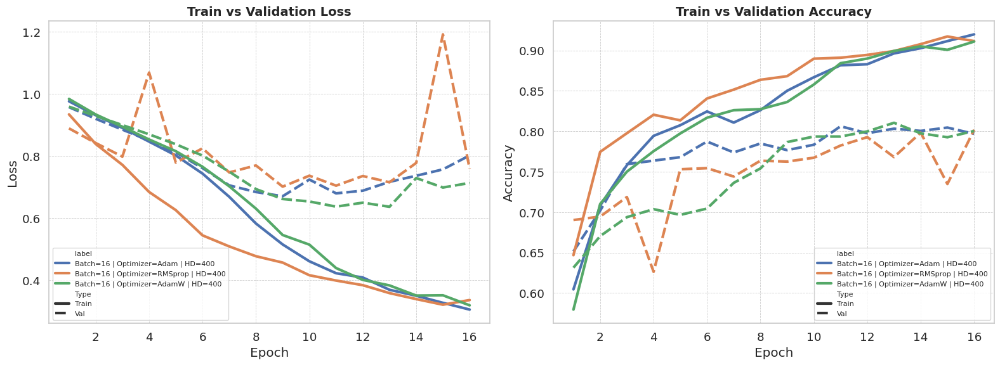

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **5.1.2 Learning rate value selection**

In [ ]:
# Learning rate sweep configuration
learning_rates = [1e-5, 5e-5, 1e-6]
optimizer_name = 'Adam'
optimizer_class = optim.Adam
results = []
num_epochs = 16

# Class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop through learning rates
for lr in learning_rates:
    print(f"\n🔹 Training with {optimizer_name} optimizer, learning rate = {lr}")

    # Instantiate GRU + Bahdanau Attention model
    model = LSTM_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        scheduler.step(f1)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"LR: {lr:.1e} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results
    label = f"LR={lr:.1e} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with Adam optimizer, learning rate = 1e-05
LSTM_Model(
  (embedding): Embedding(40867, 450)
  (lstm): LSTM(450, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
LR: 1.0e-05 | Epoch 1/16 - TL: 0.9895, VL: 0.9856, TA: 55.21%, VA: 57.23%, F1: 43.20%, Time: 0.16 min
LR: 1.0e-05 | Epoch 2/16 - TL: 0.9783, VL: 0.9768, TA: 60.48%, VA: 60.42%, F1: 46.68%, Time: 0.16 min
LR: 1.0e-05 | Epoch 3/16 - TL: 0.9709, VL: 0.9686, TA: 64.75%, VA: 64.74%, F1: 51.43%, Time: 0.16 min
LR: 1.0e-05 | Epoch 4/16 - TL: 0.9561, VL: 0.9605, TA: 67.86%, VA: 65.02%, F1: 51.70%, Time: 0.16 min
LR: 1.0e-05 | Epoch 5/16 - TL: 0.9557, VL: 0.9529, TA: 68.14%, VA: 66.94%, F1: 53.75%, Time: 0.16 min
LR: 1.0e-05 | Epoch 6/16 - TL: 0.9415, VL: 0.9456, TA: 70.74%, VA: 69.27%, F1: 56.19%, Time: 0.16 min
LR: 1.0e-05 | Epoch 7/16 - TL: 0.9293, VL: 0.9380, TA: 71.98%, VA: 71.46%, F1

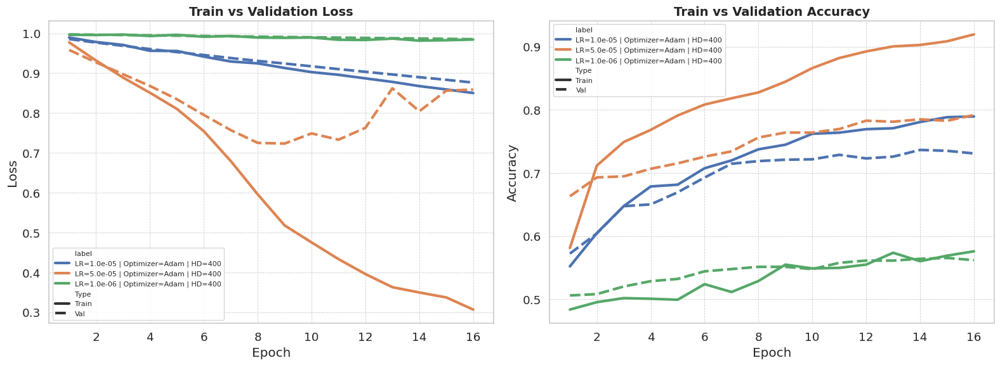

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **5.1.3 Batch size value selection**

In [ ]:
# Batch size sweep configuration
batch_sizes = [8, 16, 64]
learning_rate = 2e-5
num_epochs = 16
results = []

# Compute class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop over different batch sizes
for batch_size in batch_sizes:
    print(f"\n🔹 Training with batch size: {batch_size}")

    # Create DataLoaders with the current batch size
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    # Instantiate GRU + Bahdanau Attention model
    model = LSTM_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"BS: {batch_size} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results for later plotting
    label = f"LR={learning_rate:.1e} | Batch={batch_size} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with batch size: 8
BS: 8 | Epoch 1/16 - TL: 0.9716, VL: 0.9547, TA: 57.25%, VA: 68.16%, F1: 54.76%, Time: 0.40 min
BS: 8 | Epoch 2/16 - TL: 0.9217, VL: 0.9143, TA: 69.80%, VA: 70.20%, F1: 57.23%, Time: 0.40 min
BS: 8 | Epoch 3/16 - TL: 0.8751, VL: 0.8732, TA: 74.11%, VA: 74.10%, F1: 61.90%, Time: 0.40 min
BS: 8 | Epoch 4/16 - TL: 0.8217, VL: 0.8309, TA: 77.06%, VA: 73.74%, F1: 61.59%, Time: 0.40 min
BS: 8 | Epoch 5/16 - TL: 0.7559, VL: 0.7740, TA: 79.02%, VA: 74.21%, F1: 62.54%, Time: 0.41 min
BS: 8 | Epoch 6/16 - TL: 0.6843, VL: 0.7702, TA: 79.02%, VA: 73.73%, F1: 61.68%, Time: 0.41 min
BS: 8 | Epoch 7/16 - TL: 0.6228, VL: 0.8674, TA: 80.82%, VA: 72.65%, F1: 60.53%, Time: 0.41 min
BS: 8 | Epoch 8/16 - TL: 0.5905, VL: 0.7506, TA: 81.57%, VA: 76.92%, F1: 65.45%, Time: 0.41 min
BS: 8 | Epoch 9/16 - TL: 0.5363, VL: 0.7174, TA: 83.74%, VA: 76.87%, F1: 64.94%, Time: 0.41 min
BS: 8 | Epoch 10/16 - TL: 0.5192, VL: 0.7845, TA: 84.57%, VA: 78.0

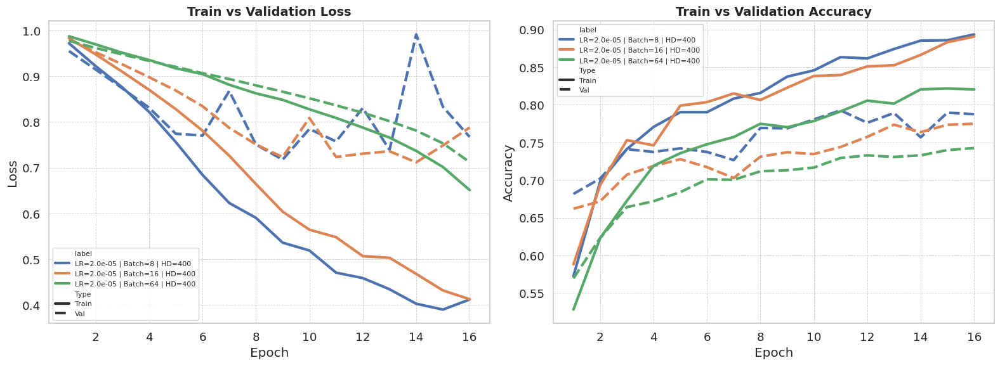

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **5.1.4 Dropout value selection**

In [ ]:
# Hyperparameter sweep configuration
hidden_dims = [286]
dropouts = [0.1, 0.4, 0.8]
learning_rate = 1e-5
batch_size = 16
num_epochs = 16
results = []

# Compute class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for hidden_dim in hidden_dims:
    num_layers = 1  # fixed value for this sweep
    for dropout in dropouts:
        print(f"\n🔹 Training with hidden_dim={hidden_dim}, num_layers={num_layers}, dropout={dropout}")

        # Data loaders
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

        # Instantiate GRU + Bahdanau Attention model with current parameters
        model = LSTM_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        train_losses, val_losses = [], []
        train_accs, val_accs, val_f1s = [], [], []

        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
            val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

            train_losses.append(train_loss)
            val_losses.append(val_loss)
            train_accs.append(train_acc)
            val_accs.append(val_acc)
            val_f1s.append(f1)

            print(
                f"HD: {hidden_dim} | NL: {num_layers} | DP: {dropout} | Epoch {epoch+1}/{num_epochs} - "
                f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
                f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
                f"Time: {(time.time() - start_time)/60:.2f} min"
            )

        # Store results
        label = f"LR={learning_rate:.1e} | BS={batch_size} | HD={hidden_dim} | NL={num_layers} | DP={dropout}"
        for epoch in range(num_epochs):
            results.append({
                "epoch": epoch + 1,
                "label": label,
                "train_loss": train_losses[epoch],
                "val_loss": val_losses[epoch],
                "train_acc": train_accs[epoch],
                "val_acc": val_accs[epoch],
                "val_f1": val_f1s[epoch]
            })

Class weights: [0.69741587 1.76636225]

🔹 Training with hidden_dim=286, num_layers=1, dropout=0.1
HD: 286 | NL: 1 | DP: 0.1 | Epoch 1/16 - TL: 0.9921, VL: 1.0016, TA: 53.83%, VA: 59.11%, F1: 44.19%, Time: 0.25 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 2/16 - TL: 0.9641, VL: 0.9859, TA: 62.48%, VA: 62.72%, F1: 48.40%, Time: 0.25 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 3/16 - TL: 0.9510, VL: 0.9708, TA: 67.99%, VA: 65.13%, F1: 51.30%, Time: 0.25 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 4/16 - TL: 0.9257, VL: 0.9568, TA: 70.56%, VA: 68.32%, F1: 55.06%, Time: 0.25 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 5/16 - TL: 0.9062, VL: 0.9430, TA: 73.99%, VA: 70.23%, F1: 57.22%, Time: 0.25 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 6/16 - TL: 0.8908, VL: 0.9297, TA: 74.81%, VA: 70.72%, F1: 57.79%, Time: 0.25 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 7/16 - TL: 0.8735, VL: 0.9166, TA: 76.08%, VA: 72.06%, F1: 59.37%, Time: 0.25 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 8/16 - TL: 0.8530, VL: 0.9034, TA: 78.45%, VA: 72.98%, F

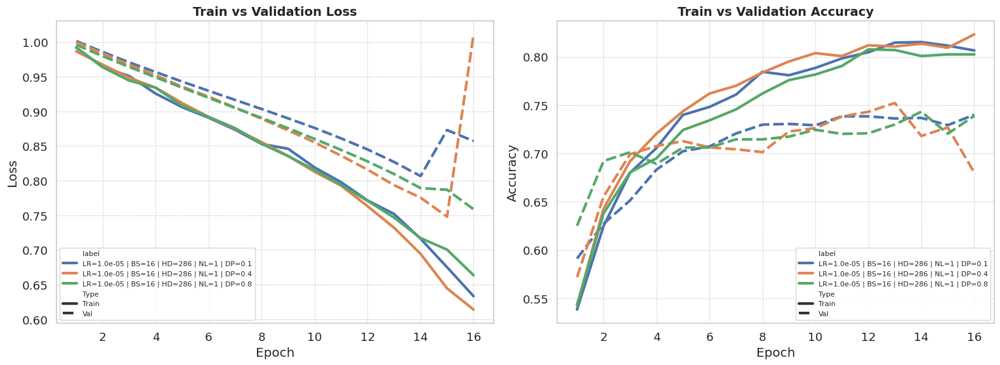

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

### **5.2 Test Phase**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

In [ ]:
# --- Hyperparameters ---
HIDDEN_DIM = 286
DROPOUT = 0.8
NUM_LAYERS = 1
learning_rate = 5e-5
num_epochs = 50
patience = 6
best_model_path = "best_model2.pth"

# --- Model Instantiation ---
model = LSTM_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# --- Compute Class Weights ---
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Tracking Variables ---
train_losses, test_losses = [], []
train_accuracies, test_accuracies = [], []
test_f1s, test_balanced_accs, test_recalls, test_precisions = [], [], [], []

best_test_bal_acc = 0
patience_counter = 0
best_model_state = None

# --- Scheduler ---
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-6
)

# --- Training with Early Stopping ---
with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as epoch_pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        # Training step
        train_loss, train_acc = train_epoch(model, combined_loader, optimizer, loss_function, device)

        # Evaluation step
        test_loss, test_acc, test_f1, test_balanced_acc, test_recall, test_precision = test_epoch(
            model, test_loader, loss_function, device
        )

        # Logging
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        test_losses.append(test_loss)
        test_balanced_accs.append(test_balanced_acc)
        test_f1s.append(test_f1)

        # Scheduler step
        scheduler.step(test_balanced_acc)

        epoch_duration = time.time() - start_time

        # --- Early Stopping Logic ---
        if test_balanced_acc > best_test_bal_acc:
            best_test_bal_acc = test_balanced_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
            torch.save(best_model_state, best_model_path)
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"\nEarly stopping at epoch {epoch + 1}.")
                break

        epoch_pbar.set_postfix({
            "Training Loss": f"{train_loss:.4f}",
            "Test Loss": f"{test_loss:.4f}",
            "Train Balanced Acc": f"{train_acc:.2%}",
            "Test Balanced Acc": f"{test_balanced_acc:.2%}",
            "Test F1": f"{test_f1:.2%}",
            "Test Precision": f"{test_precision:.2%}",
            "Test Recall": f"{test_recall:.2%}",
            "Time(min)": f"{epoch_duration / 60:.2f}"
        })
        epoch_pbar.update(1)

# --- Load Best Model ---
model.load_state_dict(torch.load(best_model_path))

Class weights: [0.69741587 1.76636225]


Training Progress:  32%|███▏      | 16/50 [05:11<11:01, 19.45s/epoch, Training Loss=0.2768, Test Loss=0.9950, Train Balanced Acc=92.61%, Test Balanced Acc=76.34%, Test F1=67.08%, Test Precision=64.29%, Test Recall=70.13%, Time(min)=0.30]


Early stopping at epoch 17.


<All keys matched successfully>

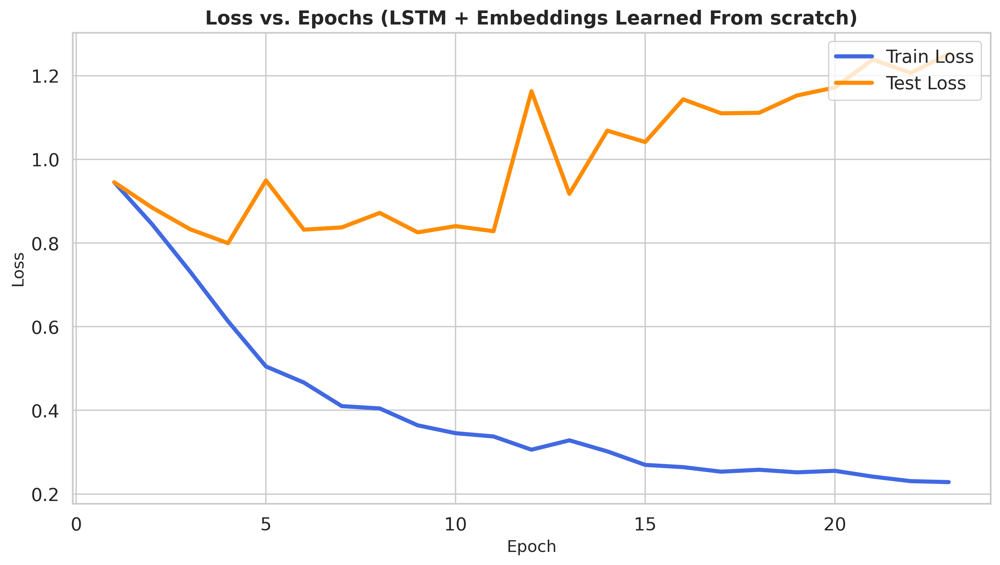

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=epochs, y=test_losses, label='Test Loss', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (LSTM + Embeddings Learned From scratch)', fontsize=14, weight='bold')
plt.legend(loc='upper right', frameon=True)
plt.tight_layout()
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

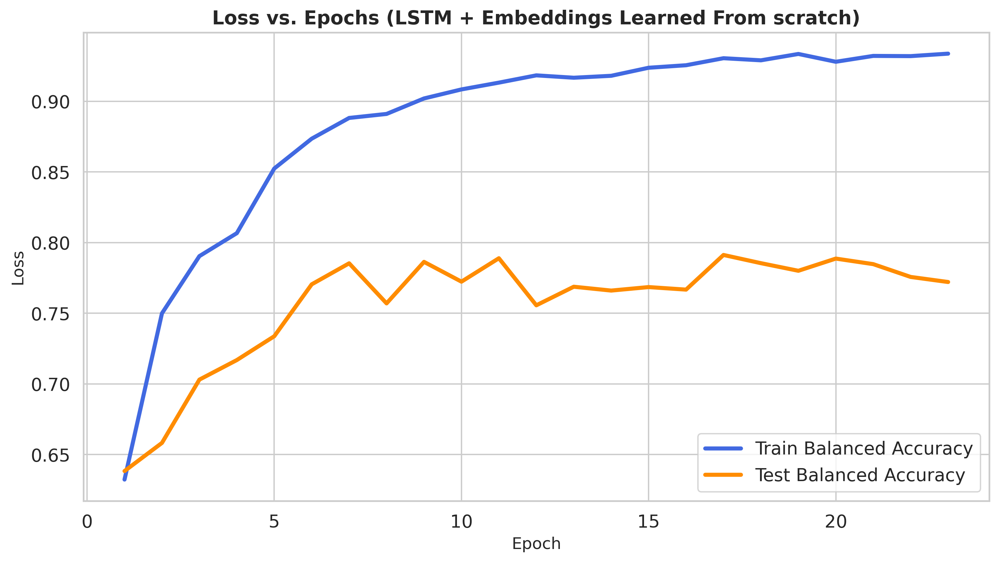

In [ ]:
plt.figure(figsize=(20, 6), dpi=300)

# === 2. Balanced Accurcy Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_accuracies, label='Train Balanced Accuracy', color='royalblue')
sns.lineplot(x=epochs, y=test_balanced_accs, label='Test Balanced Accuracy', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (LSTM + Embeddings Learned From scratch)', fontsize=14, weight='bold')
plt.legend(loc='lower right', frameon=True)
plt.tight_layout()

In [ ]:
model = LSTM_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

model.load_state_dict(torch.load("/content/best_model2.pth"))
model.eval()

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Recalculate metrics on test set ---
final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_epoch(
    model, test_loader, loss_function, device
)

# --- Print results ---
print("\n Final Evaluation Metrics of Best Model:")
print(f"Test Loss           : {final_test_loss:.4f}")
print(f"Test Accuracy       : {final_test_acc:.2%}")
print(f"Test F1 Score       : {final_test_f1:.2%}")
print(f"Balanced Accuracy   : {final_test_bal_acc:.2%}")
print(f"Test Precision      : {final_test_precision:.2%}")
print(f"Test Recall         : {final_test_recall:.2%}")

Class weights: [0.69741587 1.76636225]

 Final Evaluation Metrics of Best Model:
Test Loss           : 0.8923
Test Accuracy       : 80.32%
Test F1 Score       : 70.48%
Balanced Accuracy   : 79.12%
Test Precision      : 65.73%
Test Recall         : 75.97%


In [ ]:
df_results, df_correct, df_wrong, all_labels, all_pred, all_probs = evaluate_and_analyze(model, test_loader, device)

In [ ]:
df_correct.head()

,index,true_label,predicted_label,probability,text
0,0,1,1,0.982885,PDGFRA H845_N848delinsP Gastrointestinal strom...
1,1,0,0,0.001228,BRCA2 G2748D Mutation screening of the breast ...
2,2,0,0,0.002757,PTEN F347L The tumor suppressor gene PTEN is f...
3,4,0,0,0.279083,PIK3R2 Amplification Structural rearrangements...
4,5,0,0,0.005764,TP53 R175H Tumor suppressor p53-dependent apop...


In [ ]:
df_wrong.head()

,index,true_label,predicted_label,probability,text
0,3,0,1,0.918799,HRAS G12A The three-dimensional structure of t...
1,2,1,0,0.277712,IL7R T244_I245insCPT Signaling mediated by IL-...
2,10,0,1,0.990575,KIT E839K c-KIT is a member of the type 3 subc...
3,2,0,1,0.970503,ROS1 Fusions Oncogenic gene fusions involving ...
4,3,1,0,0.050854,MTOR P2273S Introduction Mammalian target of ...


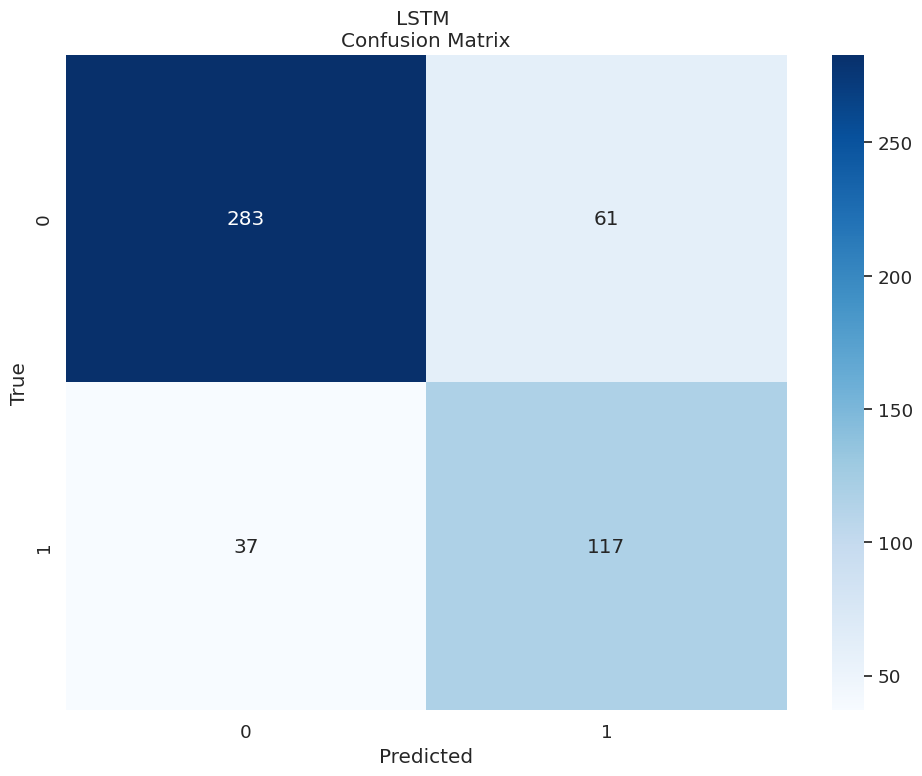

In [ ]:
NUM_CLASSES = 2

fig, axes = plt.subplots(1, 1, figsize=(10, 8))

plot_confusion_matrix(axes, all_labels, all_pred)
axes.set_title("LSTM \nConfusion Matrix")

plt.tight_layout()
plt.show()

In [ ]:
from sklearn.metrics import roc_curve, auc

y_true = np.array(all_labels)
y_scores = np.array(all_probs)

fpr, tpr, _ = roc_curve(y_true , y_scores)
roc_auc = auc(fpr, tpr)

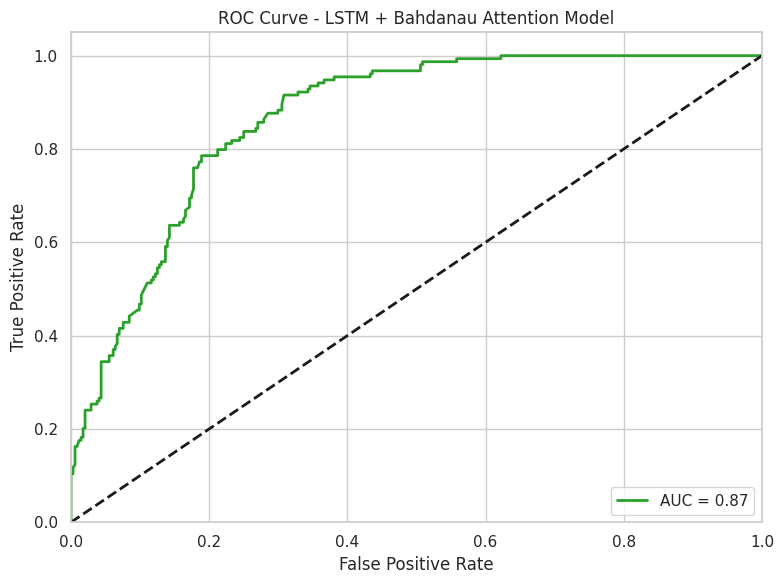

In [ ]:
sns.set(style="whitegrid")

# One plot only
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

ax.plot(fpr, tpr, lw=2,
        label=f'AUC = {roc_auc:.2f}', color='tab:green')
ax.plot([0, 1], [0, 1], 'k--', lw=2)
ax.set_xlim([0.0, 1.0])
ax.set_ylim([0.0, 1.05])
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_title('ROC Curve - LSTM + Embeddings Learned From Scratch')
ax.legend(loc='lower right')
ax.grid(True)

plt.tight_layout()
plt.show()

### **5.3 Few Shot Learning**

In [ ]:
k_values = range(1, 11)  # Few-shot from k=1 to 10
NUM_CLASSES = 2
HIDDEN_DIM = 286
DROPOUT = 0.7

X_combined = np.concatenate((X_train, X_val), axis=0)
y_combined = np.concatenate((y_train, y_val), axis=0)
X_combined_tensor = torch.cat((X_train_tensor, X_val_tensor), dim=0)
y_combined_tensor = torch.cat((y_train_tensor, y_val_tensor), dim=0)

model_metrics = {
    "K-shot": [],
    "Model": [],
    "Test Accuracy": [],
    "F1": [],
    "Balanced Accuracy": [],
    "Recall": [],
    "Precision": []
}

patience = 7
num_epochs = 50
for k in k_values:
    print(f"\n--- K-Shot = {k} ---")

    X_few, y_few = get_few_shot_subset(X_combined_tensor, y_combined_tensor, k_shot=k)
    few_shot_dataset = TextDataset(X_few, y_few, raw_text_data=X_combined)
    few_shot_loader = DataLoader(few_shot_dataset, batch_size=batch_size, shuffle=True, collate_fn=custom_collate_fn)

    model = LSTM_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

    print(f"{count_parameters(model)} model parameters")
    print()
    print(model)

    learning_rate = 2e-5
    optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)

    class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
    print(f"Class weights: {class_weights}")

    pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
    loss_function = torch.nn.BCEWithLogitsLoss()

    # Train with early stopping
    best_val_acc = 0
    patience_counter = 0
    for epoch in range(num_epochs):
        train_loss, train_acc = train_epoch(model, few_shot_loader, optimizer, loss_function, device)
        val_acc, val_f1, val_loss = evaluate_epoch(model, test_loader, loss_function, device)

        print(f"K={k} | Epoch {epoch+1}/{num_epochs} "
              f"- Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, "
              f"Test Loss: {val_loss:.4f}, Test Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                break

    # Load best model
    model.load_state_dict(best_model_state)

    # Evaluate on test set
    avg_loss, avg_accuracy, f1, balanced_acc, recall, precision = test_epoch(model, test_loader, loss_function, device)

    # Log metrics
    print(f"Test Accuracy: {avg_accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"Balanced Accuracy: {balanced_acc:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"Precision: {precision:.4f}")

    model_metrics["K-shot"].append(k)
    model_metrics["Model"].append("LSTM")
    model_metrics["Test Accuracy"].append(avg_accuracy)
    model_metrics["F1"].append(f1)
    model_metrics["Balanced Accuracy"].append(balanced_acc)
    model_metrics["Recall"].append(recall)
    model_metrics["Precision"].append(precision)

# Convert results to DataFrame
df = pd.DataFrame(model_metrics)


--- K-Shot = 1 ---
22199151 model parameters

LSTM_Model(
  (embedding): Embedding(40867, 450)
  (lstm): LSTM(450, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=1 | Epoch 1/50 - Train Loss: 0.7077, Train Acc: 0.5000, Test Loss: 0.3127, Test Acc: 0.6930, Val F1: 0.4802
K=1 | Epoch 2/50 - Train Loss: 0.5596, Train Acc: 1.0000, Test Loss: 0.3090, Test Acc: 0.6941, Val F1: 0.4744
K=1 | Epoch 3/50 - Train Loss: 0.4834, Train Acc: 1.0000, Test Loss: 0.3304, Test Acc: 0.6951, Val F1: 0.4903
K=1 | Epoch 4/50 - Train Loss: 0.4150, Train Acc: 1.0000, Test Loss: 0.3295, Test Acc: 0.6961, Val F1: 0.4888
K=1 | Epoch 5/50 - Train Loss: 0.3933, Train Acc: 1.0000, Test Loss: 0.3257, Test Acc: 0.6970, Val F1: 0.4830
K=1 | Epoch 6/50 - Train Loss: 0.3374, Train Acc: 1.0000, Test Loss: 0.3529, Test Acc: 0.6979, Val F1: 0.5011
K=1 | Epoch 7/50 - Train Loss: 0.3145, Train Acc: 1.0000, Test Loss: 0.3569, Test Acc: 0.6987, Val F1: 0.5069
K=1 | Epoch 8/50 - Train Loss: 0.3037, Train Acc: 1.0000, Test Loss: 0.3513, Test Acc: 0.6995, Val F1: 0.5022
K=1 | Epoch 9/50 - Train Loss: 0.2687, Train Acc: 1.0000, Test Loss: 0.3523, Test Acc: 0.7004, Val F1: 0.5036
K=1 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=2 | Epoch 1/50 - Train Loss: 0.6868, Train Acc: 0.5000, Test Loss: 0.3324, Test Acc: 0.6903, Val F1: 0.4852
K=2 | Epoch 2/50 - Train Loss: 0.5963, Train Acc: 1.0000, Test Loss: 0.3324, Test Acc: 0.6897, Val F1: 0.4811
K=2 | Epoch 3/50 - Train Loss: 0.5307, Train Acc: 1.0000, Test Loss: 0.3388, Test Acc: 0.6893, Val F1: 0.4833
K=2 | Epoch 4/50 - Train Loss: 0.4900, Train Acc: 1.0000, Test Loss: 0.3388, Test Acc: 0.6890, Val F1: 0.4833
K=2 | Epoch 5/50 - Train Loss: 0.4556, Train Acc: 1.0000, Test Loss: 0.3450, Test Acc: 0.6887, Val F1: 0.4854
K=2 | Epoch 6/50 - Train Loss: 0.4231, Train Acc: 1.0000, Test Loss: 0.3422, Test Acc: 0.6885, Val F1: 0.4810
K=2 | Epoch 7/50 - Train Loss: 0.3971, Train Acc: 1.0000, Test Loss: 0.3342, Test Acc: 0.6883, Val F1: 0.4760
K=2 | Epoch 8/50 - Train Loss: 0.3874, Train Acc: 1.0000, Test Loss: 0.3324, Test Acc: 0.6881, Val F1: 0.4731
Test Accuracy: 0.5241
F1 Score: 0.3324
Balanced Accuracy: 0.4852
Recall: 0.3831
Precision: 0.2935

--- K-Shot = 3 ---
22

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=3 | Epoch 1/50 - Train Loss: 0.7060, Train Acc: 0.1667, Test Loss: 0.2541, Test Acc: 0.6887, Val F1: 0.4609
K=3 | Epoch 2/50 - Train Loss: 0.6294, Train Acc: 1.0000, Test Loss: 0.2662, Test Acc: 0.6882, Val F1: 0.4689
K=3 | Epoch 3/50 - Train Loss: 0.5924, Train Acc: 1.0000, Test Loss: 0.2645, Test Acc: 0.6879, Val F1: 0.4660
K=3 | Epoch 4/50 - Train Loss: 0.5480, Train Acc: 1.0000, Test Loss: 0.2418, Test Acc: 0.6876, Val F1: 0.4530
K=3 | Epoch 5/50 - Train Loss: 0.5172, Train Acc: 1.0000, Test Loss: 0.2426, Test Acc: 0.6873, Val F1: 0.4544
K=3 | Epoch 6/50 - Train Loss: 0.5024, Train Acc: 1.0000, Test Loss: 0.2392, Test Acc: 0.6871, Val F1: 0.4555
K=3 | Epoch 7/50 - Train Loss: 0.4688, Train Acc: 1.0000, Test Loss: 0.2671, Test Acc: 0.6869, Val F1: 0.4703
K=3 | Epoch 8/50 - Train Loss: 0.4484, Train Acc: 1.0000, Test Loss: 0.2671, Test Acc: 0.6867, Val F1: 0.4703
Test Accuracy: 0.5402
F1 Score: 0.2541
Balanced Accuracy: 0.4609
Recall: 0.2532
Precision: 0.2549

--- K-Shot = 4 ---
22

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=4 | Epoch 1/50 - Train Loss: 0.6896, Train Acc: 0.5000, Test Loss: 0.4000, Test Acc: 0.6869, Val F1: 0.5467
K=4 | Epoch 2/50 - Train Loss: 0.6328, Train Acc: 1.0000, Test Loss: 0.4070, Test Acc: 0.6867, Val F1: 0.5529
K=4 | Epoch 3/50 - Train Loss: 0.5757, Train Acc: 1.0000, Test Loss: 0.4070, Test Acc: 0.6866, Val F1: 0.5529
K=4 | Epoch 4/50 - Train Loss: 0.5476, Train Acc: 1.0000, Test Loss: 0.4116, Test Acc: 0.6865, Val F1: 0.5561
K=4 | Epoch 5/50 - Train Loss: 0.5303, Train Acc: 1.0000, Test Loss: 0.4104, Test Acc: 0.6864, Val F1: 0.5546
K=4 | Epoch 6/50 - Train Loss: 0.4982, Train Acc: 1.0000, Test Loss: 0.4069, Test Acc: 0.6864, Val F1: 0.5503
K=4 | Epoch 7/50 - Train Loss: 0.4779, Train Acc: 1.0000, Test Loss: 0.4080, Test Acc: 0.6864, Val F1: 0.5517
K=4 | Epoch 8/50 - Train Loss: 0.4657, Train Acc: 1.0000, Test Loss: 0.4057, Test Acc: 0.6863, Val F1: 0.5488
Test Accuracy: 0.5843
F1 Score: 0.4000
Balanced Accuracy: 0.5467
Recall: 0.4481
Precision: 0.3613

--- K-Shot = 5 ---
22

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=5 | Epoch 1/50 - Train Loss: 0.6772, Train Acc: 0.6000, Test Loss: 0.4184, Test Acc: 0.6971, Val F1: 0.4991
K=5 | Epoch 2/50 - Train Loss: 0.6158, Train Acc: 1.0000, Test Loss: 0.4158, Test Acc: 0.6963, Val F1: 0.4947
K=5 | Epoch 3/50 - Train Loss: 0.5796, Train Acc: 1.0000, Test Loss: 0.4167, Test Acc: 0.6958, Val F1: 0.4962
K=5 | Epoch 4/50 - Train Loss: 0.5460, Train Acc: 1.0000, Test Loss: 0.4158, Test Acc: 0.6954, Val F1: 0.4947
K=5 | Epoch 5/50 - Train Loss: 0.5227, Train Acc: 1.0000, Test Loss: 0.4217, Test Acc: 0.6951, Val F1: 0.5023
K=5 | Epoch 6/50 - Train Loss: 0.4979, Train Acc: 1.0000, Test Loss: 0.4200, Test Acc: 0.6948, Val F1: 0.4994
K=5 | Epoch 7/50 - Train Loss: 0.4671, Train Acc: 1.0000, Test Loss: 0.4191, Test Acc: 0.6946, Val F1: 0.4980
K=5 | Epoch 8/50 - Train Loss: 0.4603, Train Acc: 1.0000, Test Loss: 0.4224, Test Acc: 0.6945, Val F1: 0.5012
Test Accuracy: 0.4418
F1 Score: 0.4184
Balanced Accuracy: 0.4991
Recall: 0.6494
Precision: 0.3086

--- K-Shot = 6 ---
22

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=6 | Epoch 1/50 - Train Loss: 0.6883, Train Acc: 0.5000, Test Loss: 0.3810, Test Acc: 0.6909, Val F1: 0.5128
K=6 | Epoch 2/50 - Train Loss: 0.6275, Train Acc: 0.9167, Test Loss: 0.3723, Test Acc: 0.6909, Val F1: 0.5063
K=6 | Epoch 3/50 - Train Loss: 0.5965, Train Acc: 0.9167, Test Loss: 0.3694, Test Acc: 0.6910, Val F1: 0.5020
K=6 | Epoch 4/50 - Train Loss: 0.5567, Train Acc: 1.0000, Test Loss: 0.3636, Test Acc: 0.6911, Val F1: 0.4933
K=6 | Epoch 5/50 - Train Loss: 0.5279, Train Acc: 1.0000, Test Loss: 0.3731, Test Acc: 0.6913, Val F1: 0.5012
K=6 | Epoch 6/50 - Train Loss: 0.5073, Train Acc: 1.0000, Test Loss: 0.3834, Test Acc: 0.6915, Val F1: 0.5106
K=6 | Epoch 7/50 - Train Loss: 0.4983, Train Acc: 1.0000, Test Loss: 0.3814, Test Acc: 0.6917, Val F1: 0.5077
K=6 | Epoch 8/50 - Train Loss: 0.4782, Train Acc: 1.0000, Test Loss: 0.3731, Test Acc: 0.6919, Val F1: 0.5012
K=6 | Epoch 9/50 - Train Loss: 0.4676, Train Acc: 1.0000, Test Loss: 0.3840, Test Acc: 0.6920, Val F1: 0.5172
K=6 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


22199151 model parameters

LSTM_Model(
  (embedding): Embedding(40867, 450)
  (lstm): LSTM(450, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]
K=7 | Epoch 1/50 - Train Loss: 0.6841, Train Acc: 0.5000, Test Loss: 0.4266, Test Acc: 0.6867, Val F1: 0.5610
K=7 | Epoch 2/50 - Train Loss: 0.6313, Train Acc: 1.0000, Test Loss: 0.4237, Test Acc: 0.6862, Val F1: 0.5618
K=7 | Epoch 3/50 - Train Loss: 0.6018, Train Acc: 1.0000, Test Loss: 0.4338, Test Acc: 0.6859, Val F1: 0.5698
K=7 | Epoch 4/50 - Train Loss: 0.5811, Train Acc: 1.0000, Test Loss: 0.4338, Test Acc: 0.6857, Val F1: 0.5698
K=7 | Epoch 5/50 - Train Loss: 0.5533, Train Acc: 1.0000, Test Loss: 0.4270, Test Acc: 0.6855, Val F1: 0.5636
K=7 | Epoch 6/50 - Train Loss: 0.5438, Train Acc: 1.0000, Test Loss: 0.4314, Test Acc: 0.6853, Val F1: 0.5669
K=7 | Epoch 7/50 - Train Loss: 0.5197, Train Acc: 1.0000,

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


22199151 model parameters

LSTM_Model(
  (embedding): Embedding(40867, 450)
  (lstm): LSTM(450, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]
K=8 | Epoch 1/50 - Train Loss: 0.6956, Train Acc: 0.4375, Test Loss: 0.4036, Test Acc: 0.6838, Val F1: 0.5536
K=8 | Epoch 2/50 - Train Loss: 0.6351, Train Acc: 0.8125, Test Loss: 0.4242, Test Acc: 0.6826, Val F1: 0.5732
K=8 | Epoch 3/50 - Train Loss: 0.6141, Train Acc: 0.9375, Test Loss: 0.4366, Test Acc: 0.6816, Val F1: 0.5789
K=8 | Epoch 4/50 - Train Loss: 0.5848, Train Acc: 1.0000, Test Loss: 0.4399, Test Acc: 0.6807, Val F1: 0.5807
K=8 | Epoch 5/50 - Train Loss: 0.5603, Train Acc: 1.0000, Test Loss: 0.4363, Test Acc: 0.6800, Val F1: 0.5727
K=8 | Epoch 6/50 - Train Loss: 0.5407, Train Acc: 1.0000, Test Loss: 0.4628, Test Acc: 0.6794, Val F1: 0.5910
K=8 | Epoch 7/50 - Train Loss: 0.5183, Train Acc: 1.0000,

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=9 | Epoch 1/50 - Train Loss: 0.7003, Train Acc: 0.3889, Test Loss: 0.3800, Test Acc: 0.7004, Val F1: 0.4553
K=9 | Epoch 2/50 - Train Loss: 0.6749, Train Acc: 0.6667, Test Loss: 0.3975, Test Acc: 0.6987, Val F1: 0.4782
K=9 | Epoch 3/50 - Train Loss: 0.6414, Train Acc: 0.9444, Test Loss: 0.3897, Test Acc: 0.6973, Val F1: 0.4728
K=9 | Epoch 4/50 - Train Loss: 0.6002, Train Acc: 1.0000, Test Loss: 0.3879, Test Acc: 0.6964, Val F1: 0.4724
K=9 | Epoch 5/50 - Train Loss: 0.5784, Train Acc: 1.0000, Test Loss: 0.3704, Test Acc: 0.6955, Val F1: 0.4562
K=9 | Epoch 6/50 - Train Loss: 0.5777, Train Acc: 1.0000, Test Loss: 0.3696, Test Acc: 0.6945, Val F1: 0.4548
K=9 | Epoch 7/50 - Train Loss: 0.5568, Train Acc: 1.0000, Test Loss: 0.3714, Test Acc: 0.6940, Val F1: 0.4642
K=9 | Epoch 8/50 - Train Loss: 0.5314, Train Acc: 1.0000, Test Loss: 0.3710, Test Acc: 0.6933, Val F1: 0.4668
Test Accuracy: 0.4036
F1 Score: 0.3800
Balanced Accuracy: 0.4553
Recall: 0.5909
Precision: 0.2800

--- K-Shot = 10 ---
2

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=10 | Epoch 1/50 - Train Loss: 0.7129, Train Acc: 0.4500, Test Loss: 0.4426, Test Acc: 0.6948, Val F1: 0.5258
K=10 | Epoch 2/50 - Train Loss: 0.6582, Train Acc: 0.6500, Test Loss: 0.4435, Test Acc: 0.6947, Val F1: 0.5310
K=10 | Epoch 3/50 - Train Loss: 0.6280, Train Acc: 0.9500, Test Loss: 0.4502, Test Acc: 0.6948, Val F1: 0.5412
K=10 | Epoch 4/50 - Train Loss: 0.6083, Train Acc: 1.0000, Test Loss: 0.4512, Test Acc: 0.6945, Val F1: 0.5426
K=10 | Epoch 5/50 - Train Loss: 0.5932, Train Acc: 1.0000, Test Loss: 0.4397, Test Acc: 0.6950, Val F1: 0.5288
K=10 | Epoch 6/50 - Train Loss: 0.5665, Train Acc: 1.0000, Test Loss: 0.4421, Test Acc: 0.6950, Val F1: 0.5306
K=10 | Epoch 7/50 - Train Loss: 0.5551, Train Acc: 1.0000, Test Loss: 0.4519, Test Acc: 0.6948, Val F1: 0.5489
K=10 | Epoch 8/50 - Train Loss: 0.5407, Train Acc: 1.0000, Test Loss: 0.4320, Test Acc: 0.6952, Val F1: 0.5209
K=10 | Epoch 9/50 - Train Loss: 0.5271, Train Acc: 1.0000, Test Loss: 0.4217, Test Acc: 0.6953, Val F1: 0.5112
K

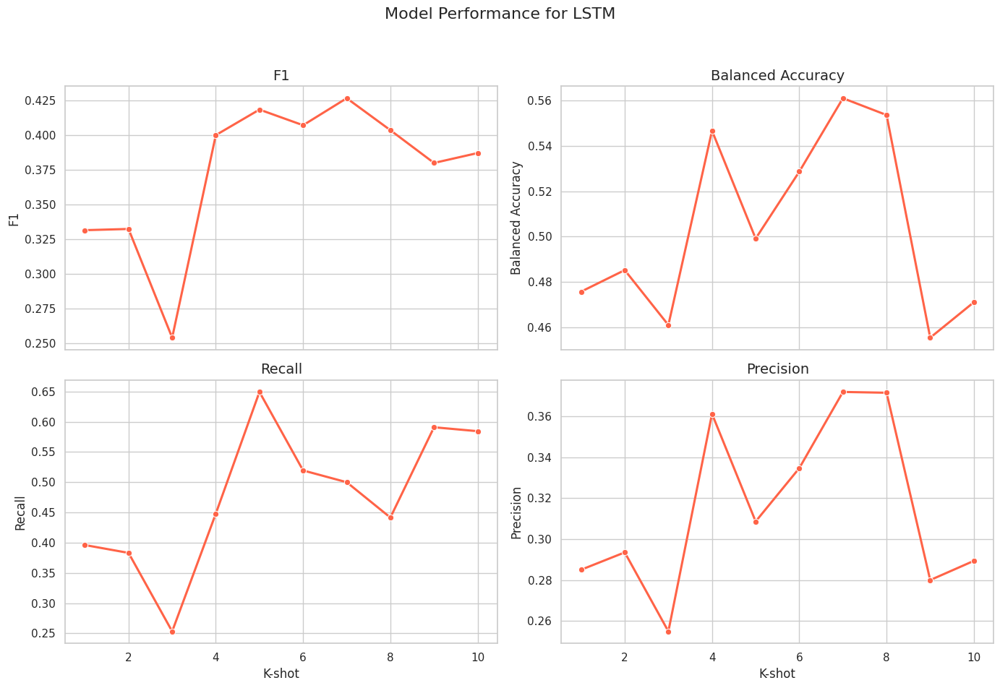

In [ ]:
# Plot results
plot_model_performance(df, "LSTM", "tomato")

Maximum values per metric:
Balanced Accuracy: 0.5610 (at K-shot = 7)
F1: 0.4266 (at K-shot = 7)
Recall: 0.6494 (at K-shot = 5)
Precision: 0.3720 (at K-shot = 7)


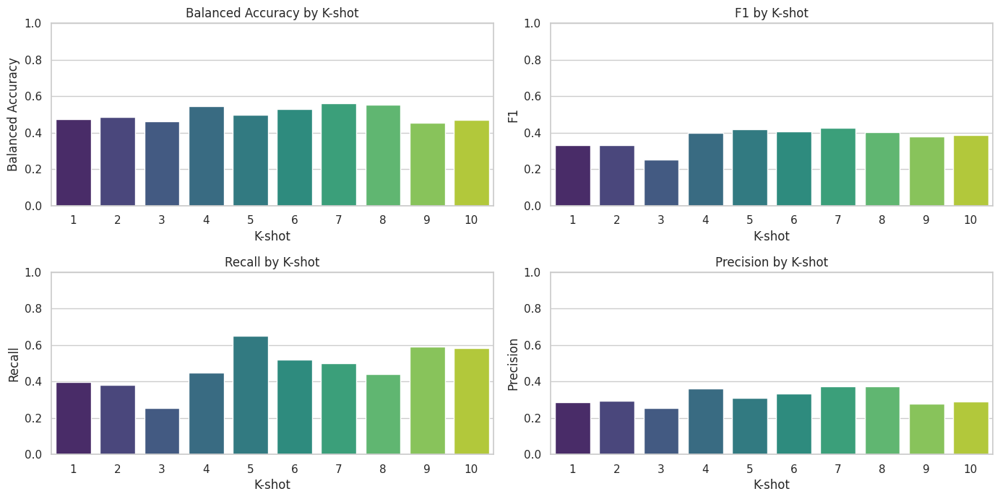

In [ ]:
metrics = ["Balanced Accuracy", "F1", "Recall", "Precision"]

# Print max values for each metric
print("Maximum values per metric:")
for metric in metrics:
    max_val = df[metric].max()
    max_k = df.loc[df[metric].idxmax(), "K-shot"]
    print(f"{metric}: {max_val:.4f} (at K-shot = {max_k})")

# Then plot the histograms
plt.figure(figsize=(14, 10))

for i, metric in enumerate(metrics, 1):
    plt.subplot(3, 2, i)
    sns.barplot(x="K-shot", y=metric, data=df, palette="viridis")
    plt.title(f"{metric} by K-shot")
    plt.ylim(0, 1)
    plt.xlabel("K-shot")
    plt.ylabel(metric)

plt.tight_layout()
plt.show()

## **6. Bidirectional GRU + Weight Class (embeddings learned from scratch)**

### **6.1 Optimization Phase**

#### **6.1.1 Optimizer selection**

In [ ]:
num_epochs = 16
learning_rate = 5e-5

class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)
results = []

optimizers = {
    'Adam': optim.Adam,
    'RMSprop': optim.RMSprop,
    'AdamW': optim.AdamW
}

all_train_losses, all_val_losses = {}, {}
all_train_accs, all_val_accs = {}, {}

# Loop through optimizers
for optimizer_name, optimizer_class in optimizers.items():
    print(f"\n🔹 Training with optimizer: {optimizer_name}")

    model = GRU_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=learning_rate)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total trainable parameters: {num_params}")

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []
    best_val_loss = float('inf')

    # Training loop
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # <-- fixed unpacking order

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        scheduler.step(f1)

        duration = time.time() - start_time

        print(
            f"Opt: {optimizer_name} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {duration/60:.2f} min"
        )

    # Store metrics
    all_train_losses[optimizer_name] = train_losses
    all_val_losses[optimizer_name] = val_losses
    all_train_accs[optimizer_name] = train_accs
    all_val_accs[optimizer_name] = val_accs

    label = f"Batch={BATCH_SIZE} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with optimizer: Adam
GRU_Model(
  (embedding): Embedding(40867, 450)
  (gru): GRU(450, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 21247151
Opt: Adam | Epoch 1/16 - TL: 0.9384, VL: 0.8967, TA: 62.89%, VA: 68.13%, F1: 54.97%, Time: 0.20 min
Opt: Adam | Epoch 2/16 - TL: 0.8188, VL: 0.8188, TA: 75.16%, VA: 72.57%, F1: 59.78%, Time: 0.20 min
Opt: Adam | Epoch 3/16 - TL: 0.7171, VL: 0.7456, TA: 78.89%, VA: 74.55%, F1: 62.05%, Time: 0.20 min
Opt: Adam | Epoch 4/16 - TL: 0.6147, VL: 0.6947, TA: 81.54%, VA: 74.74%, F1: 62.57%, Time: 0.20 min
Opt: Adam | Epoch 5/16 - TL: 0.5370, VL: 0.6937, TA: 85.14%, VA: 75.59%, F1: 63.56%, Time: 0.20 min
Opt: Adam | Epoch 6/16 - TL: 0.4584, VL: 0.6769, TA: 86.82%, VA: 76.64%, F1: 65.06%, Time: 0.20 min
Opt: Adam | Epoch 7/16 - TL: 0.4014, VL: 0.7027, TA: 88.26%, VA: 76.93%, F1: 

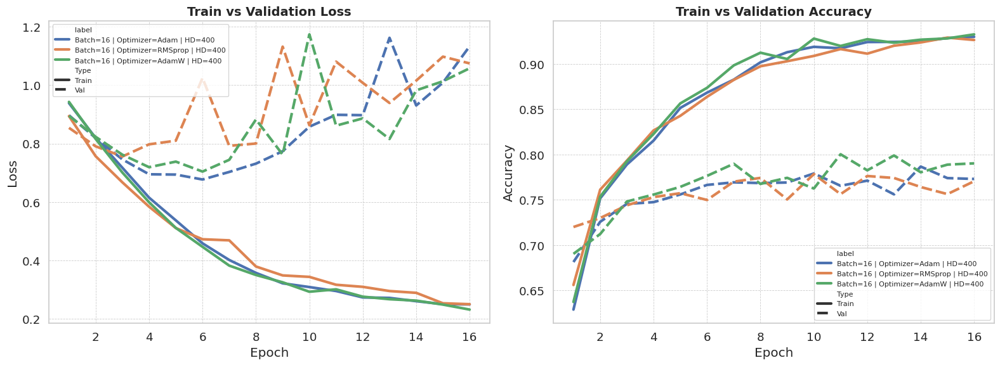

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **6.1.2 Learning rate value selection**

In [ ]:
# Learning rate sweep configuration
learning_rates = [1e-5, 5e-5, 1e-6]
optimizer_name = 'Adam'
optimizer_class = optim.Adam
results = []
num_epochs = 16

# Class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop through learning rates
for lr in learning_rates:
    print(f"\n🔹 Training with {optimizer_name} optimizer, learning rate = {lr}")

    # Instantiate GRU + Bahdanau Attention model
    model = GRU_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        scheduler.step(f1)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"LR: {lr:.1e} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results
    label = f"LR={lr:.1e} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with Adam optimizer, learning rate = 1e-05
GRU_Model(
  (embedding): Embedding(40867, 450)
  (gru): GRU(450, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
LR: 1.0e-05 | Epoch 1/16 - TL: 0.9764, VL: 0.9992, TA: 56.12%, VA: 57.47%, F1: 41.69%, Time: 0.20 min
LR: 1.0e-05 | Epoch 2/16 - TL: 0.9517, VL: 0.9758, TA: 61.68%, VA: 63.41%, F1: 48.94%, Time: 0.20 min
LR: 1.0e-05 | Epoch 3/16 - TL: 0.9186, VL: 0.9564, TA: 67.93%, VA: 65.54%, F1: 51.52%, Time: 0.21 min
LR: 1.0e-05 | Epoch 4/16 - TL: 0.8896, VL: 0.9373, TA: 69.61%, VA: 66.11%, F1: 52.35%, Time: 0.20 min
LR: 1.0e-05 | Epoch 5/16 - TL: 0.8671, VL: 0.9217, TA: 72.25%, VA: 65.76%, F1: 52.02%, Time: 0.20 min
LR: 1.0e-05 | Epoch 6/16 - TL: 0.8545, VL: 0.9065, TA: 73.82%, VA: 67.04%, F1: 53.56%, Time: 0.20 min
LR: 1.0e-05 | Epoch 7/16 - TL: 0.8259, VL: 0.8917, TA: 75.47%, VA: 67.26%, F1: 5

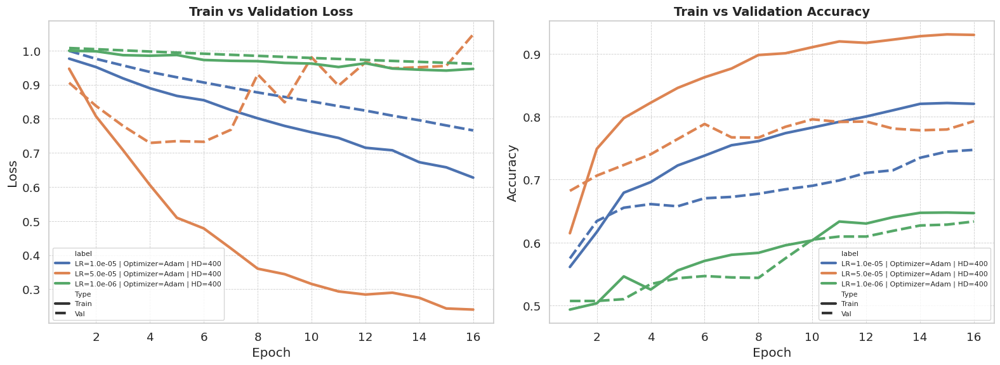

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **6.1.3 Batch size value selection**

In [ ]:
# Batch size sweep configuration
batch_sizes = [8, 16, 64]
learning_rate = 2e-5
num_epochs = 16
results = []

# Compute class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop over different batch sizes
for batch_size in batch_sizes:
    print(f"\n🔹 Training with batch size: {batch_size}")

    # Create DataLoaders with the current batch size
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    # Instantiate GRU + Bahdanau Attention model
    model = GRU_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"BS: {batch_size} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results for later plotting
    label = f"LR={learning_rate:.1e} | Batch={batch_size} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with batch size: 8
BS: 8 | Epoch 1/16 - TL: 0.9689, VL: 0.9425, TA: 56.75%, VA: 64.97%, F1: 50.90%, Time: 0.33 min
BS: 8 | Epoch 2/16 - TL: 0.8908, VL: 0.8890, TA: 69.69%, VA: 66.53%, F1: 52.73%, Time: 0.34 min
BS: 8 | Epoch 3/16 - TL: 0.8252, VL: 0.8467, TA: 74.33%, VA: 67.29%, F1: 53.58%, Time: 0.33 min
BS: 8 | Epoch 4/16 - TL: 0.7626, VL: 0.8091, TA: 77.51%, VA: 68.92%, F1: 55.62%, Time: 0.33 min
BS: 8 | Epoch 5/16 - TL: 0.7007, VL: 0.7740, TA: 78.70%, VA: 70.61%, F1: 57.78%, Time: 0.33 min
BS: 8 | Epoch 6/16 - TL: 0.6341, VL: 0.7630, TA: 79.76%, VA: 71.34%, F1: 58.61%, Time: 0.33 min
BS: 8 | Epoch 7/16 - TL: 0.5820, VL: 0.8346, TA: 81.89%, VA: 71.19%, F1: 58.43%, Time: 0.33 min
BS: 8 | Epoch 8/16 - TL: 0.5430, VL: 0.8042, TA: 83.71%, VA: 72.75%, F1: 60.30%, Time: 0.33 min
BS: 8 | Epoch 9/16 - TL: 0.4928, VL: 0.8001, TA: 85.40%, VA: 74.52%, F1: 62.46%, Time: 0.33 min
BS: 8 | Epoch 10/16 - TL: 0.4688, VL: 0.7617, TA: 86.86%, VA: 76.5

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **6.1.4 Dropout value selection**

In [ ]:
# Hyperparameter sweep configuration
hidden_dims = [286]
dropouts = [0.1, 0.4, 0.8]
learning_rate = 1e-5
batch_size = 16
num_epochs = 16
results = []

# Compute class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for hidden_dim in hidden_dims:
    num_layers = 1  # fixed value for this sweep
    for dropout in dropouts:
        print(f"\n🔹 Training with hidden_dim={hidden_dim}, num_layers={num_layers}, dropout={dropout}")

        # Data loaders
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

        # Instantiate GRU + Bahdanau Attention model with current parameters
        model = GRU_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        train_losses, val_losses = [], []
        train_accs, val_accs, val_f1s = [], [], []

        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
            val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

            train_losses.append(train_loss)
            val_losses.append(val_loss)
            train_accs.append(train_acc)
            val_accs.append(val_acc)
            val_f1s.append(f1)

            print(
                f"HD: {hidden_dim} | NL: {num_layers} | DP: {dropout} | Epoch {epoch+1}/{num_epochs} - "
                f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
                f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
                f"Time: {(time.time() - start_time)/60:.2f} min"
            )

        # Store results
        label = f"LR={learning_rate:.1e} | BS={batch_size} | HD={hidden_dim} | NL={num_layers} | DP={dropout}"
        for epoch in range(num_epochs):
            results.append({
                "epoch": epoch + 1,
                "label": label,
                "train_loss": train_losses[epoch],
                "val_loss": val_losses[epoch],
                "train_acc": train_accs[epoch],
                "val_acc": val_accs[epoch],
                "val_f1": val_f1s[epoch]
            })

Class weights: [0.69741587 1.76636225]

🔹 Training with hidden_dim=286, num_layers=1, dropout=0.1
HD: 286 | NL: 1 | DP: 0.1 | Epoch 1/16 - TL: 0.9830, VL: 0.9850, TA: 54.96%, VA: 63.67%, F1: 50.13%, Time: 0.20 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 2/16 - TL: 0.9444, VL: 0.9602, TA: 64.60%, VA: 66.48%, F1: 52.96%, Time: 0.20 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 3/16 - TL: 0.9203, VL: 0.9392, TA: 68.53%, VA: 69.02%, F1: 55.84%, Time: 0.20 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 4/16 - TL: 0.8843, VL: 0.9198, TA: 71.04%, VA: 70.15%, F1: 57.14%, Time: 0.20 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 5/16 - TL: 0.8695, VL: 0.9023, TA: 72.94%, VA: 69.80%, F1: 56.74%, Time: 0.20 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 6/16 - TL: 0.8425, VL: 0.8859, TA: 73.70%, VA: 71.71%, F1: 58.92%, Time: 0.20 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 7/16 - TL: 0.8220, VL: 0.8701, TA: 74.14%, VA: 71.00%, F1: 58.12%, Time: 0.20 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 8/16 - TL: 0.8005, VL: 0.8545, TA: 75.04%, VA: 70.58%, F

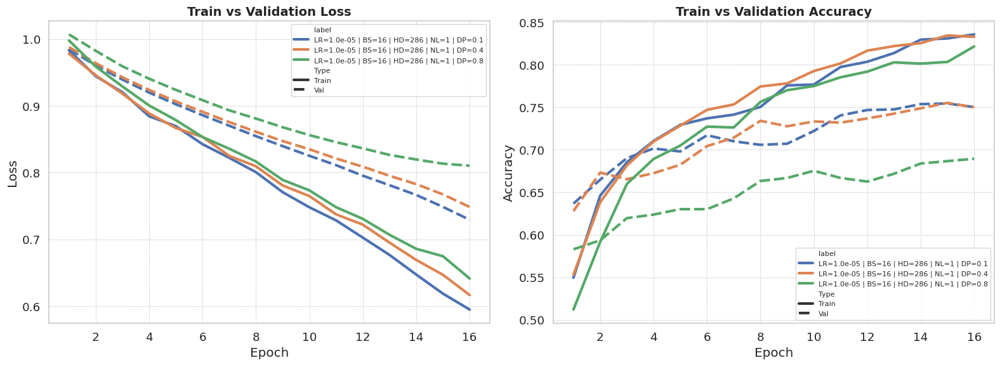

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

### **6.2 Test Phase**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [ ]:
# --- Hyperparameters ---
HIDDEN_DIM = 286
DROPOUT = 0.8
NUM_LAYERS = 1
learning_rate = 5e-5
num_epochs = 50
patience = 6
best_model_path = "best_model2.pth"

# --- Model Instantiation ---
model = GRU_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# --- Compute Class Weights ---
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Tracking Variables ---
train_losses, test_losses = [], []
train_accuracies, test_accuracies = [], []
test_f1s, test_balanced_accs, test_recalls, test_precisions = [], [], [], []

best_test_bal_acc = 0
patience_counter = 0
best_model_state = None

# --- Scheduler ---
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-6
)

# --- Training with Early Stopping ---
with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as epoch_pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        # Training step
        train_loss, train_acc = train_epoch(model, combined_loader, optimizer, loss_function, device)

        # Evaluation step
        test_loss, test_acc, test_f1, test_balanced_acc, test_recall, test_precision = test_epoch(
            model, test_loader, loss_function, device
        )

        # Logging
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        test_losses.append(test_loss)
        test_balanced_accs.append(test_balanced_acc)
        test_f1s.append(test_f1)

        # Scheduler step
        scheduler.step(test_balanced_acc)

        epoch_duration = time.time() - start_time

        # --- Early Stopping Logic ---
        if test_balanced_acc > best_test_bal_acc:
            best_test_bal_acc = test_balanced_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
            torch.save(best_model_state, best_model_path)
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"\nEarly stopping at epoch {epoch + 1}.")
                break

        epoch_pbar.set_postfix({
            "Training Loss": f"{train_loss:.4f}",
            "Test Loss": f"{test_loss:.4f}",
            "Train Balanced Acc": f"{train_acc:.2%}",
            "Test Balanced Acc": f"{test_balanced_acc:.2%}",
            "Test F1": f"{test_f1:.2%}",
            "Test Precision": f"{test_precision:.2%}",
            "Test Recall": f"{test_recall:.2%}",
            "Time(min)": f"{epoch_duration / 60:.2f}"
        })
        epoch_pbar.update(1)

# --- Load Best Model ---
model.load_state_dict(torch.load(best_model_path))

Class weights: [0.69741587 1.76636225]


Training Progress:  28%|██▊       | 14/50 [03:38<09:22, 15.63s/epoch, Training Loss=0.2634, Test Loss=1.2945, Train Balanced Acc=92.92%, Test Balanced Acc=73.06%, Test F1=62.78%, Test Precision=62.58%, Test Recall=62.99%, Time(min)=0.24]


Early stopping at epoch 15.


<All keys matched successfully>

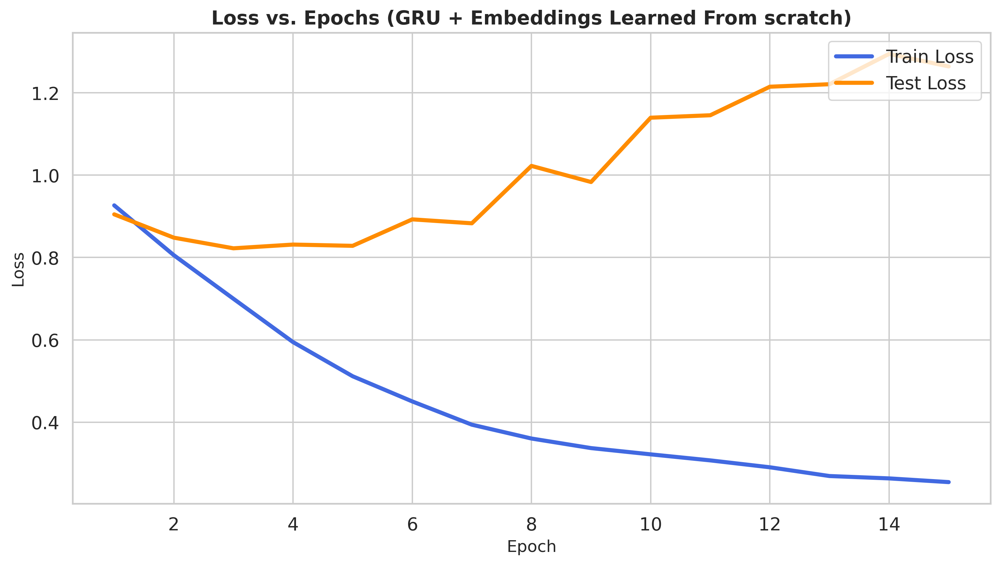

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=epochs, y=test_losses, label='Test Loss', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (GRU + Embeddings Learned From scratch)', fontsize=14, weight='bold')
plt.legend(loc='upper right', frameon=True)
plt.tight_layout()

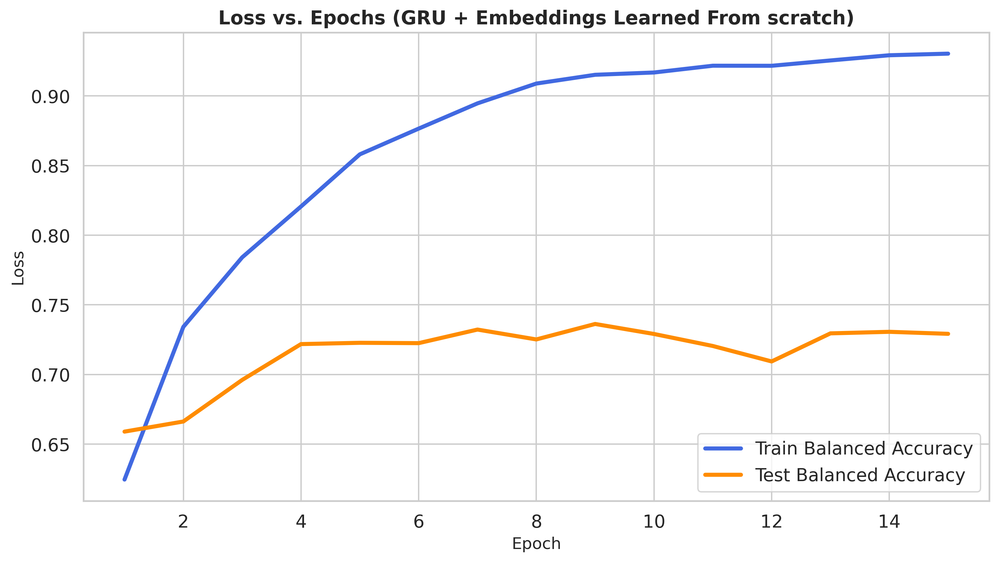

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 2. Balanced Accurcy Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_accuracies, label='Train Balanced Accuracy', color='royalblue')
sns.lineplot(x=epochs, y=test_balanced_accs, label='Test Balanced Accuracy', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (GRU + Embeddings Learned From scratch)', fontsize=14, weight='bold')
plt.legend(loc='lower right', frameon=True)
plt.tight_layout()

In [ ]:
model = GRU_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

model.load_state_dict(torch.load("/content/best_model2.pth"))
model.eval()

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Recalculate metrics on test set ---
final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_epoch(
    model, test_loader, loss_function, device
)

# --- Print results ---
print("\n Final Evaluation Metrics of Best Model:")
print(f"Test Loss           : {final_test_loss:.4f}")
print(f"Test Accuracy       : {final_test_acc:.2%}")
print(f"Test F1 Score       : {final_test_f1:.2%}")
print(f"Balanced Accuracy   : {final_test_bal_acc:.2%}")
print(f"Test Precision      : {final_test_precision:.2%}")
print(f"Test Recall         : {final_test_recall:.2%}")

Class weights: [0.69741587 1.76636225]

 Final Evaluation Metrics of Best Model:
Test Loss           : 0.9834
Test Accuracy       : 75.70%
Test F1 Score       : 63.44%
Balanced Accuracy   : 73.63%
Test Precision      : 59.32%
Test Recall         : 68.18%


In [ ]:
df_results, df_correct, df_wrong, all_labels, all_pred, all_probs = evaluate_and_analyze(model, test_loader, device)

In [ ]:
df_correct.head()

,index,true_label,predicted_label,probability,text
0,0,1,1,0.995607,PDGFRA H845_N848delinsP Gastrointestinal strom...
1,1,0,0,0.001081,BRCA2 G2748D Mutation screening of the breast ...
2,2,0,0,0.001218,PTEN F347L The tumor suppressor gene PTEN is f...
3,4,0,0,0.400259,PIK3R2 Amplification Structural rearrangements...
4,5,0,0,0.004069,TP53 R175H Tumor suppressor p53-dependent apop...


In [ ]:
df_wrong.head()

,index,true_label,predicted_label,probability,text
0,3,0,1,0.852890,HRAS G12A The three-dimensional structure of t...
1,7,1,0,0.161505,MAP2K1 F129L t Although targeting the Ras/Raf/...
2,8,1,0,0.290110,MAPK1 E322K Cervical cancer is responsible for...
3,13,0,1,0.557226,CHEK2 K373E We identified CHK2 K373E as a recu...
4,15,1,0,0.410102,CDK4 R24C Many human tumors harbor mutations t...


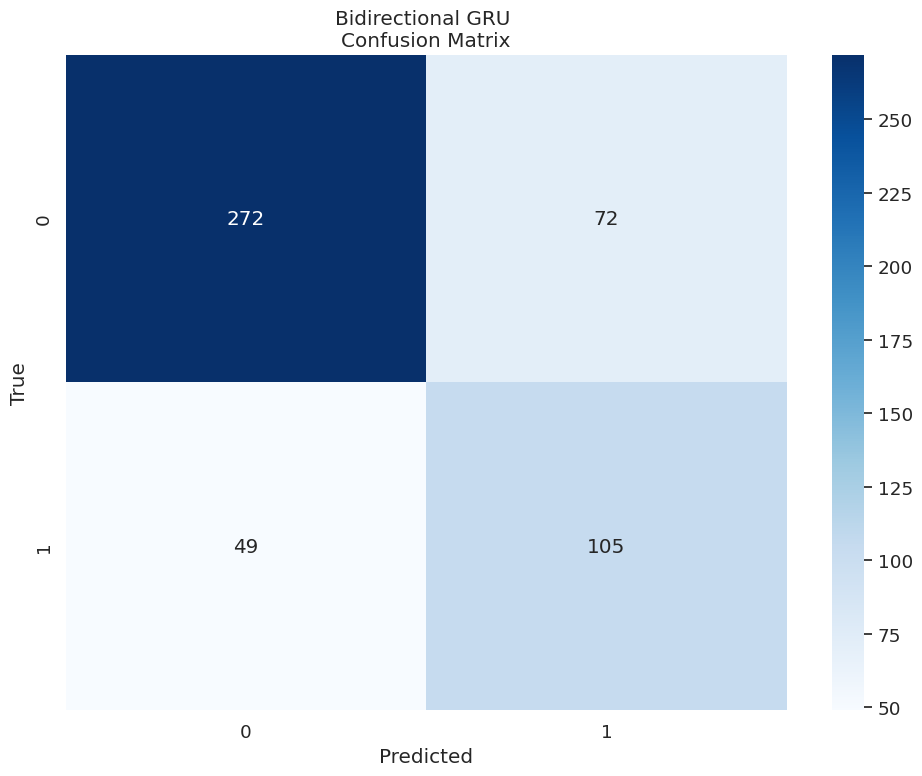

In [ ]:
NUM_CLASSES = 2

fig, axes = plt.subplots(1, 1, figsize=(10, 8))

plot_confusion_matrix(axes, all_labels, all_pred)
axes.set_title("Bidirectional GRU \nConfusion Matrix")

plt.tight_layout()
plt.show()

In [ ]:
from sklearn.metrics import roc_curve, auc

y_true = np.array(all_labels)
y_scores = np.array(all_probs)

fpr, tpr, _ = roc_curve(y_true , y_scores)
roc_auc = auc(fpr, tpr)

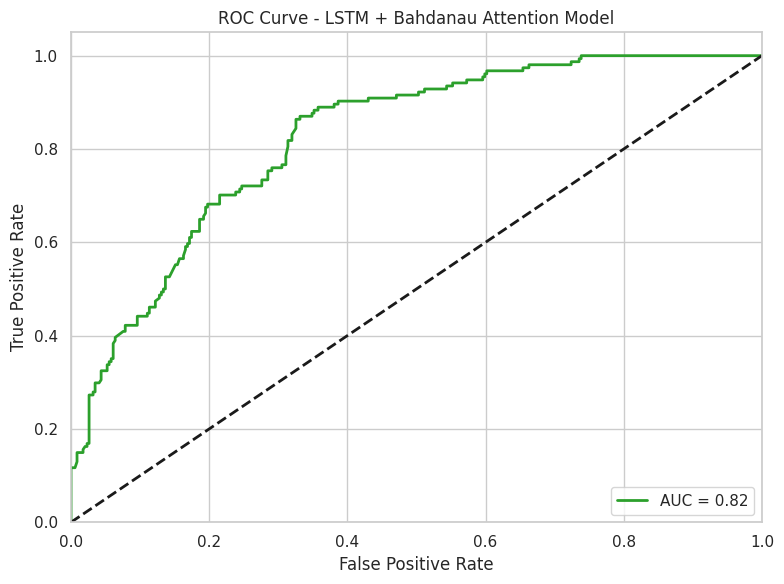

In [ ]:
sns.set(style="whitegrid")

# One plot only
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

ax.plot(fpr, tpr, lw=2,
        label=f'AUC = {roc_auc:.2f}', color='tab:green')
ax.plot([0, 1], [0, 1], 'k--', lw=2)
ax.set_xlim([0.0, 1.0])
ax.set_ylim([0.0, 1.05])
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_title('ROC Curve - GRU + Embeddings Learned From Scratch')
ax.legend(loc='lower right')
ax.grid(True)

plt.tight_layout()
plt.show()

### **6.3 Few Shot Learning**

In [ ]:
k_values = range(1, 11)  # Few-shot from k=1 to 10
NUM_CLASSES = 2
HIDDEN_DIM = 286
DROPOUT = 0.7

X_combined = np.concatenate((X_train, X_val), axis=0)
y_combined = np.concatenate((y_train, y_val), axis=0)
X_combined_tensor = torch.cat((X_train_tensor, X_val_tensor), dim=0)
y_combined_tensor = torch.cat((y_train_tensor, y_val_tensor), dim=0)

model_metrics = {
    "K-shot": [],
    "Model": [],
    "Test Accuracy": [],
    "F1": [],
    "Balanced Accuracy": [],
    "Recall": [],
    "Precision": []
}

patience = 7
num_epochs = 50
for k in k_values:
    print(f"\n--- K-Shot = {k} ---")

    X_few, y_few = get_few_shot_subset(X_combined_tensor, y_combined_tensor, k_shot=k)
    few_shot_dataset = TextDataset(X_few, y_few, raw_text_data=X_combined)
    few_shot_loader = DataLoader(few_shot_dataset, batch_size=batch_size, shuffle=True, collate_fn=custom_collate_fn)

    model = GRU_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

    print(f"{count_parameters(model)} model parameters")
    print()
    print(model)

    learning_rate = 2e-5
    optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)

    class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
    print(f"Class weights: {class_weights}")

    pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
    loss_function = torch.nn.BCEWithLogitsLoss()

    # Train with early stopping
    best_val_acc = 0
    patience_counter = 0
    for epoch in range(num_epochs):
        train_loss, train_acc = train_epoch(model, few_shot_loader, optimizer, loss_function, device)
        val_acc, val_f1, val_loss = evaluate_epoch(model, test_loader, loss_function, device)

        print(f"K={k} | Epoch {epoch+1}/{num_epochs} "
              f"- Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, "
              f"Test Loss: {val_loss:.4f}, Test Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                break

    # Load best model
    model.load_state_dict(best_model_state)

    # Evaluate on test set
    avg_loss, avg_accuracy, f1, balanced_acc, recall, precision = test_epoch(model, test_loader, loss_function, device)

    # Log metrics
    print(f"Test Accuracy: {avg_accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"Balanced Accuracy: {balanced_acc:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"Precision: {precision:.4f}")

    model_metrics["K-shot"].append(k)
    model_metrics["Model"].append("GRU")
    model_metrics["Test Accuracy"].append(avg_accuracy)
    model_metrics["F1"].append(f1)
    model_metrics["Balanced Accuracy"].append(balanced_acc)
    model_metrics["Recall"].append(recall)
    model_metrics["Precision"].append(precision)

# Convert results to DataFrame
df = pd.DataFrame(model_metrics)


--- K-Shot = 1 ---


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


21247151 model parameters

GRU_Model(
  (embedding): Embedding(40867, 450)
  (gru): GRU(450, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]
K=1 | Epoch 1/50 - Train Loss: 0.7403, Train Acc: 0.0000, Test Loss: 0.3592, Test Acc: 0.6898, Val F1: 0.4966
K=1 | Epoch 2/50 - Train Loss: 0.5229, Train Acc: 1.0000, Test Loss: 0.3636, Test Acc: 0.6903, Val F1: 0.4998
K=1 | Epoch 3/50 - Train Loss: 0.3679, Train Acc: 1.0000, Test Loss: 0.3631, Test Acc: 0.6907, Val F1: 0.5024
K=1 | Epoch 4/50 - Train Loss: 0.3173, Train Acc: 1.0000, Test Loss: 0.3622, Test Acc: 0.6911, Val F1: 0.5010
K=1 | Epoch 5/50 - Train Loss: 0.2725, Train Acc: 1.0000, Test Loss: 0.3552, Test Acc: 0.6917, Val F1: 0.4974
K=1 | Epoch 6/50 - Train Loss: 0.2359, Train Acc: 1.0000, Test Loss: 0.3488, Test Acc: 0.6922, Val F1: 0.4912
K=1 | Epoch 7/50 - Train Loss: 0.1723, Train Acc: 1.0000, Te

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


21247151 model parameters

GRU_Model(
  (embedding): Embedding(40867, 450)
  (gru): GRU(450, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]
K=2 | Epoch 1/50 - Train Loss: 0.7116, Train Acc: 0.5000, Test Loss: 0.3860, Test Acc: 0.6927, Val F1: 0.5058
K=2 | Epoch 2/50 - Train Loss: 0.5286, Train Acc: 1.0000, Test Loss: 0.3728, Test Acc: 0.6914, Val F1: 0.4946
K=2 | Epoch 3/50 - Train Loss: 0.4670, Train Acc: 1.0000, Test Loss: 0.3706, Test Acc: 0.6902, Val F1: 0.4943
K=2 | Epoch 4/50 - Train Loss: 0.4044, Train Acc: 1.0000, Test Loss: 0.3694, Test Acc: 0.6896, Val F1: 0.5020
K=2 | Epoch 5/50 - Train Loss: 0.3395, Train Acc: 1.0000, Test Loss: 0.3757, Test Acc: 0.6892, Val F1: 0.5081
K=2 | Epoch 6/50 - Train Loss: 0.2973, Train Acc: 1.0000, Test Loss: 0.3743, Test Acc: 0.6889, Val F1: 0.5092
K=2 | Epoch 7/50 - Train Loss: 0.2416, Train Acc: 1.0000, Te

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=3 | Epoch 1/50 - Train Loss: 0.7555, Train Acc: 0.3333, Test Loss: 0.3761, Test Acc: 0.7032, Val F1: 0.4755
K=3 | Epoch 2/50 - Train Loss: 0.6028, Train Acc: 0.8333, Test Loss: 0.3850, Test Acc: 0.7027, Val F1: 0.4901
K=3 | Epoch 3/50 - Train Loss: 0.5573, Train Acc: 1.0000, Test Loss: 0.3888, Test Acc: 0.7024, Val F1: 0.4933
K=3 | Epoch 4/50 - Train Loss: 0.4883, Train Acc: 1.0000, Test Loss: 0.4019, Test Acc: 0.7023, Val F1: 0.5111
K=3 | Epoch 5/50 - Train Loss: 0.4310, Train Acc: 1.0000, Test Loss: 0.4171, Test Acc: 0.7023, Val F1: 0.5241
K=3 | Epoch 6/50 - Train Loss: 0.3769, Train Acc: 1.0000, Test Loss: 0.4143, Test Acc: 0.7023, Val F1: 0.5223
K=3 | Epoch 7/50 - Train Loss: 0.3410, Train Acc: 1.0000, Test Loss: 0.4143, Test Acc: 0.7024, Val F1: 0.5223
K=3 | Epoch 8/50 - Train Loss: 0.3119, Train Acc: 1.0000, Test Loss: 0.4038, Test Acc: 0.7024, Val F1: 0.5140
Test Accuracy: 0.4538
F1 Score: 0.3761
Balanced Accuracy: 0.4755
Recall: 0.5325
Precision: 0.2908

--- K-Shot = 4 ---
21

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=4 | Epoch 1/50 - Train Loss: 0.7070, Train Acc: 0.5000, Test Loss: 0.3456, Test Acc: 0.6909, Val F1: 0.4975
K=4 | Epoch 2/50 - Train Loss: 0.5651, Train Acc: 1.0000, Test Loss: 0.3569, Test Acc: 0.6883, Val F1: 0.5069
K=4 | Epoch 3/50 - Train Loss: 0.5052, Train Acc: 1.0000, Test Loss: 0.3563, Test Acc: 0.6863, Val F1: 0.5094
K=4 | Epoch 4/50 - Train Loss: 0.4907, Train Acc: 1.0000, Test Loss: 0.3483, Test Acc: 0.6846, Val F1: 0.4978
K=4 | Epoch 5/50 - Train Loss: 0.4021, Train Acc: 1.0000, Test Loss: 0.3343, Test Acc: 0.6832, Val F1: 0.4840
K=4 | Epoch 6/50 - Train Loss: 0.3928, Train Acc: 1.0000, Test Loss: 0.3370, Test Acc: 0.6821, Val F1: 0.4844
K=4 | Epoch 7/50 - Train Loss: 0.3551, Train Acc: 1.0000, Test Loss: 0.3333, Test Acc: 0.6808, Val F1: 0.4826
K=4 | Epoch 8/50 - Train Loss: 0.3246, Train Acc: 1.0000, Test Loss: 0.3416, Test Acc: 0.6800, Val F1: 0.4876
Test Accuracy: 0.5361
F1 Score: 0.3456
Balanced Accuracy: 0.4975
Recall: 0.3961
Precision: 0.3065

--- K-Shot = 5 ---
21

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=5 | Epoch 1/50 - Train Loss: 0.6471, Train Acc: 0.8000, Test Loss: 0.3553, Test Acc: 0.6871, Val F1: 0.4802
K=5 | Epoch 2/50 - Train Loss: 0.5904, Train Acc: 1.0000, Test Loss: 0.3481, Test Acc: 0.6847, Val F1: 0.4792
K=5 | Epoch 3/50 - Train Loss: 0.5292, Train Acc: 1.0000, Test Loss: 0.3290, Test Acc: 0.6830, Val F1: 0.4633
K=5 | Epoch 4/50 - Train Loss: 0.4716, Train Acc: 1.0000, Test Loss: 0.3394, Test Acc: 0.6816, Val F1: 0.4727
K=5 | Epoch 5/50 - Train Loss: 0.4141, Train Acc: 1.0000, Test Loss: 0.3675, Test Acc: 0.6805, Val F1: 0.4991
K=5 | Epoch 6/50 - Train Loss: 0.3962, Train Acc: 1.0000, Test Loss: 0.3679, Test Acc: 0.6797, Val F1: 0.4965
K=5 | Epoch 7/50 - Train Loss: 0.3753, Train Acc: 1.0000, Test Loss: 0.3655, Test Acc: 0.6789, Val F1: 0.4962
K=5 | Epoch 8/50 - Train Loss: 0.3516, Train Acc: 1.0000, Test Loss: 0.3632, Test Acc: 0.6783, Val F1: 0.4958
Test Accuracy: 0.4900
F1 Score: 0.3553
Balanced Accuracy: 0.4802
Recall: 0.4545
Precision: 0.2917

--- K-Shot = 6 ---
21

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=6 | Epoch 1/50 - Train Loss: 0.7203, Train Acc: 0.5000, Test Loss: 0.3679, Test Acc: 0.6962, Val F1: 0.4742
K=6 | Epoch 2/50 - Train Loss: 0.6365, Train Acc: 0.6667, Test Loss: 0.3684, Test Acc: 0.6943, Val F1: 0.4782
K=6 | Epoch 3/50 - Train Loss: 0.5558, Train Acc: 1.0000, Test Loss: 0.3675, Test Acc: 0.6931, Val F1: 0.4767
K=6 | Epoch 4/50 - Train Loss: 0.5101, Train Acc: 1.0000, Test Loss: 0.3671, Test Acc: 0.6919, Val F1: 0.4793
K=6 | Epoch 5/50 - Train Loss: 0.4716, Train Acc: 1.0000, Test Loss: 0.3472, Test Acc: 0.6910, Val F1: 0.4631
K=6 | Epoch 6/50 - Train Loss: 0.4602, Train Acc: 1.0000, Test Loss: 0.3443, Test Acc: 0.6905, Val F1: 0.4693
K=6 | Epoch 7/50 - Train Loss: 0.4231, Train Acc: 1.0000, Test Loss: 0.3410, Test Acc: 0.6898, Val F1: 0.4675
K=6 | Epoch 8/50 - Train Loss: 0.3842, Train Acc: 1.0000, Test Loss: 0.3402, Test Acc: 0.6894, Val F1: 0.4701
Test Accuracy: 0.4618
F1 Score: 0.3679
Balanced Accuracy: 0.4742
Recall: 0.5065
Precision: 0.2889

--- K-Shot = 7 ---
21

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=7 | Epoch 1/50 - Train Loss: 0.7087, Train Acc: 0.5714, Test Loss: 0.3487, Test Acc: 0.6936, Val F1: 0.4620
K=7 | Epoch 2/50 - Train Loss: 0.6138, Train Acc: 0.7857, Test Loss: 0.3591, Test Acc: 0.6914, Val F1: 0.4794
K=7 | Epoch 3/50 - Train Loss: 0.5477, Train Acc: 0.8571, Test Loss: 0.3863, Test Acc: 0.6899, Val F1: 0.5007
K=7 | Epoch 4/50 - Train Loss: 0.5240, Train Acc: 0.9286, Test Loss: 0.3844, Test Acc: 0.6888, Val F1: 0.4978
K=7 | Epoch 5/50 - Train Loss: 0.4885, Train Acc: 0.9286, Test Loss: 0.3933, Test Acc: 0.6880, Val F1: 0.5032
K=7 | Epoch 6/50 - Train Loss: 0.4685, Train Acc: 0.9286, Test Loss: 0.3826, Test Acc: 0.6872, Val F1: 0.4949
K=7 | Epoch 7/50 - Train Loss: 0.4388, Train Acc: 0.9286, Test Loss: 0.3798, Test Acc: 0.6866, Val F1: 0.4905
K=7 | Epoch 8/50 - Train Loss: 0.4194, Train Acc: 0.9286, Test Loss: 0.3876, Test Acc: 0.6861, Val F1: 0.4970
Test Accuracy: 0.4598
F1 Score: 0.3487
Balanced Accuracy: 0.4620
Recall: 0.4675
Precision: 0.2780

--- K-Shot = 8 ---
21

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=8 | Epoch 1/50 - Train Loss: 0.6863, Train Acc: 0.5000, Test Loss: 0.3233, Test Acc: 0.6901, Val F1: 0.4706
K=8 | Epoch 2/50 - Train Loss: 0.6054, Train Acc: 0.7500, Test Loss: 0.3271, Test Acc: 0.6895, Val F1: 0.4684
K=8 | Epoch 3/50 - Train Loss: 0.5363, Train Acc: 1.0000, Test Loss: 0.3253, Test Acc: 0.6890, Val F1: 0.4655
K=8 | Epoch 4/50 - Train Loss: 0.5120, Train Acc: 1.0000, Test Loss: 0.3517, Test Acc: 0.6887, Val F1: 0.4850
K=8 | Epoch 5/50 - Train Loss: 0.4775, Train Acc: 1.0000, Test Loss: 0.3536, Test Acc: 0.6885, Val F1: 0.4879
K=8 | Epoch 6/50 - Train Loss: 0.4425, Train Acc: 1.0000, Test Loss: 0.3481, Test Acc: 0.6883, Val F1: 0.4792
K=8 | Epoch 7/50 - Train Loss: 0.4208, Train Acc: 1.0000, Test Loss: 0.3496, Test Acc: 0.6883, Val F1: 0.4780
K=8 | Epoch 8/50 - Train Loss: 0.4073, Train Acc: 1.0000, Test Loss: 0.3393, Test Acc: 0.6883, Val F1: 0.4686
Test Accuracy: 0.5040
F1 Score: 0.3233
Balanced Accuracy: 0.4706
Recall: 0.3831
Precision: 0.2796

--- K-Shot = 9 ---


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


21247151 model parameters

GRU_Model(
  (embedding): Embedding(40867, 450)
  (gru): GRU(450, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]
K=9 | Epoch 1/50 - Train Loss: 0.6689, Train Acc: 0.5556, Test Loss: 0.4381, Test Acc: 0.6908, Val F1: 0.5322
K=9 | Epoch 2/50 - Train Loss: 0.6568, Train Acc: 0.6667, Test Loss: 0.4254, Test Acc: 0.6898, Val F1: 0.5170
K=9 | Epoch 3/50 - Train Loss: 0.5865, Train Acc: 0.8889, Test Loss: 0.4338, Test Acc: 0.6892, Val F1: 0.5238
K=9 | Epoch 4/50 - Train Loss: 0.5856, Train Acc: 0.8333, Test Loss: 0.4425, Test Acc: 0.6881, Val F1: 0.5369
K=9 | Epoch 5/50 - Train Loss: 0.5161, Train Acc: 0.9444, Test Loss: 0.4521, Test Acc: 0.6884, Val F1: 0.5525
K=9 | Epoch 6/50 - Train Loss: 0.5205, Train Acc: 0.9444, Test Loss: 0.4662, Test Acc: 0.6886, Val F1: 0.5703
K=9 | Epoch 7/50 - Train Loss: 0.4454, Train Acc: 0.9444, Te

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=10 | Epoch 1/50 - Train Loss: 0.6835, Train Acc: 0.6000, Test Loss: 0.4196, Test Acc: 0.6814, Val F1: 0.5523
K=10 | Epoch 2/50 - Train Loss: 0.6105, Train Acc: 0.8500, Test Loss: 0.4119, Test Acc: 0.6797, Val F1: 0.5447
K=10 | Epoch 3/50 - Train Loss: 0.5616, Train Acc: 0.9500, Test Loss: 0.4088, Test Acc: 0.6787, Val F1: 0.5455
K=10 | Epoch 4/50 - Train Loss: 0.5257, Train Acc: 0.9500, Test Loss: 0.4111, Test Acc: 0.6774, Val F1: 0.5484
K=10 | Epoch 5/50 - Train Loss: 0.4878, Train Acc: 1.0000, Test Loss: 0.4067, Test Acc: 0.6770, Val F1: 0.5452
K=10 | Epoch 6/50 - Train Loss: 0.4697, Train Acc: 1.0000, Test Loss: 0.4034, Test Acc: 0.6768, Val F1: 0.5434
K=10 | Epoch 7/50 - Train Loss: 0.4083, Train Acc: 1.0000, Test Loss: 0.4136, Test Acc: 0.6766, Val F1: 0.5539
K=10 | Epoch 8/50 - Train Loss: 0.4381, Train Acc: 1.0000, Test Loss: 0.4056, Test Acc: 0.6766, Val F1: 0.5437
Test Accuracy: 0.5723
F1 Score: 0.4196
Balanced Accuracy: 0.5523
Recall: 0.5000
Precision: 0.3615


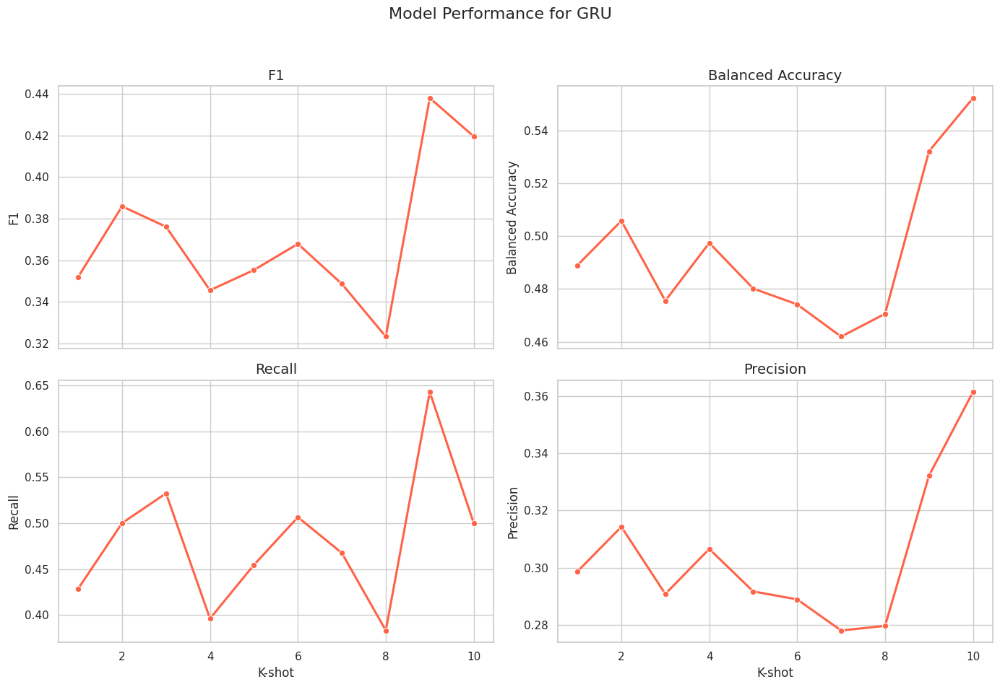

In [ ]:
# Plot results
plot_model_performance(df, "GRU", "tomato")

Maximum values per metric:
Balanced Accuracy: 0.5523 (at K-shot = 10)
F1: 0.4381 (at K-shot = 9)
Recall: 0.6429 (at K-shot = 9)
Precision: 0.3615 (at K-shot = 10)


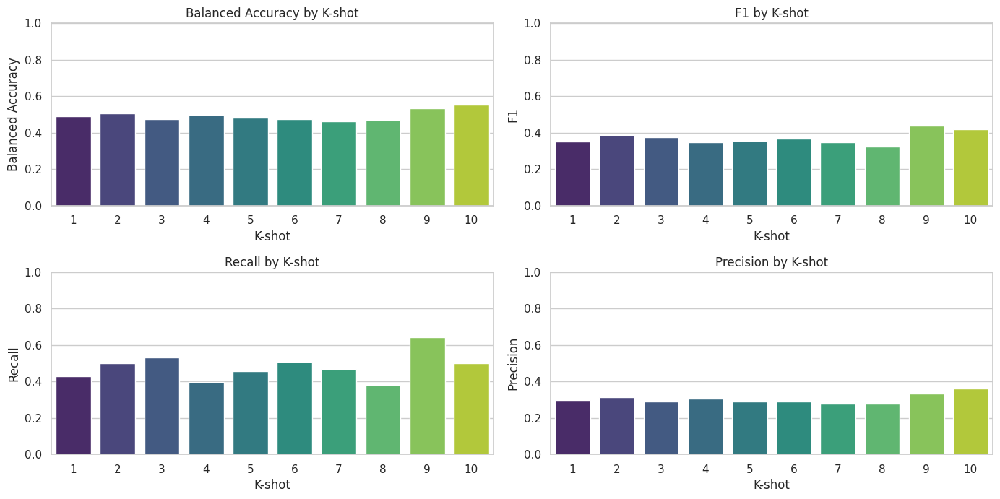

In [ ]:
metrics = ["Balanced Accuracy", "F1", "Recall", "Precision"]

# Print max values for each metric
print("Maximum values per metric:")
for metric in metrics:
    max_val = df[metric].max()
    max_k = df.loc[df[metric].idxmax(), "K-shot"]
    print(f"{metric}: {max_val:.4f} (at K-shot = {max_k})")

# Then plot the histograms
plt.figure(figsize=(14, 10))

for i, metric in enumerate(metrics, 1):
    plt.subplot(3, 2, i)
    sns.barplot(x="K-shot", y=metric, data=df, palette="viridis")
    plt.title(f"{metric} by K-shot")
    plt.ylim(0, 1)
    plt.xlabel("K-shot")
    plt.ylabel(metric)

plt.tight_layout()
plt.show()

## **7. Bidirectional LSTM + Weight Class using Fasttext (300d)**

### **7.1 Optimization Phase**

#### **7.1.1 Optimizer selection**

In [ ]:
num_epochs = 16
learning_rate = 5e-5

class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)
results = []

optimizers = {
    'Adam': optim.Adam,
    'RMSprop': optim.RMSprop,
    'AdamW': optim.AdamW
}

all_train_losses, all_val_losses = {}, {}
all_train_accs, all_val_accs = {}, {}

# Loop through optimizers
for optimizer_name, optimizer_class in optimizers.items():
    print(f"\n🔹 Training with optimizer: {optimizer_name}")

    model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=learning_rate)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total trainable parameters: {num_params}")

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []
    best_val_loss = float('inf')

    # Training loop
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # <-- fixed unpacking order

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        scheduler.step(f1)

        duration = time.time() - start_time

        print(
            f"Opt: {optimizer_name} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {duration/60:.2f} min"
        )

    # Store metrics
    all_train_losses[optimizer_name] = train_losses
    all_val_losses[optimizer_name] = val_losses
    all_train_accs[optimizer_name] = train_accs
    all_val_accs[optimizer_name] = val_accs

    label = f"Batch={BATCH_SIZE} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with optimizer: Adam
LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 15469101
Opt: Adam | Epoch 1/16 - TL: 0.9897, VL: 1.0091, TA: 51.85%, VA: 55.58%, F1: 46.40%, Time: 0.23 min
Opt: Adam | Epoch 2/16 - TL: 0.9812, VL: 0.9976, TA: 60.91%, VA: 64.46%, F1: 50.00%, Time: 0.23 min
Opt: Adam | Epoch 3/16 - TL: 1.0361, VL: 0.9647, TA: 62.87%, VA: 65.43%, F1: 52.66%, Time: 0.23 min
Opt: Adam | Epoch 4/16 - TL: 0.8670, VL: 0.9177, TA: 68.39%, VA: 70.58%, F1: 57.84%, Time: 0.23 min
Opt: Adam | Epoch 5/16 - TL: 0.7696, VL: 0.7374, TA: 74.36%, VA: 77.55%, F1: 64.65%, Time: 0.23 min
Opt: Adam | Epoch 6/16 - TL: 0.6635, VL: 0.8513, TA: 78.59%, VA: 79.97%, F1: 69.07%, Time: 0.23 min
Opt: Adam | Epoch 7/16 - TL: 0.5853, VL: 0.7180, TA: 82.69%, VA: 79.74%, F

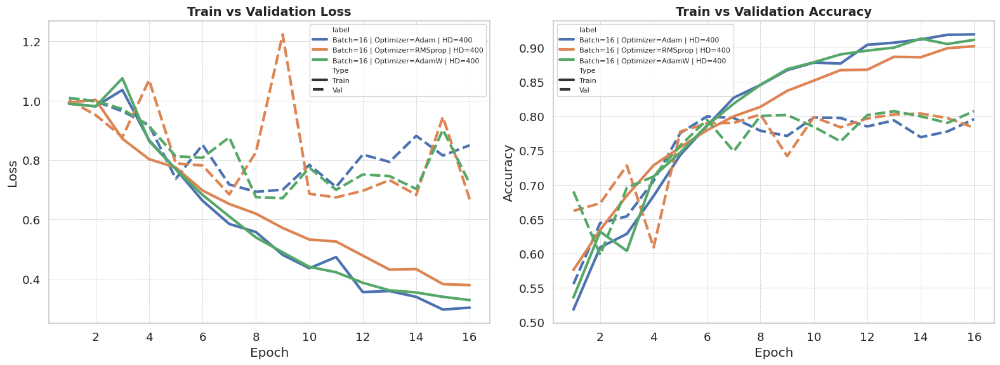

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **7.1.2 Learning rate value selection**

In [58]:
# Learning rate sweep configuration
learning_rates = [1e-5, 5e-5, 1e-6]
optimizer_name = 'Adam'
optimizer_class = optim.Adam
results = []
num_epochs = 16

# Class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop through learning rates
for lr in learning_rates:
    print(f"\n🔹 Training with {optimizer_name} optimizer, learning rate = {lr}")

    # Instantiate GRU + Bahdanau Attention model
    model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        scheduler.step(f1)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"LR: {lr:.1e} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results
    label = f"LR={lr:.1e} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with Adam optimizer, learning rate = 1e-05
LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
LR: 1.0e-05 | Epoch 1/16 - TL: 0.9914, VL: 1.0158, TA: 52.33%, VA: 58.06%, F1: 34.58%, Time: 0.20 min
LR: 1.0e-05 | Epoch 2/16 - TL: 0.9900, VL: 1.0141, TA: 57.27%, VA: 59.20%, F1: 37.27%, Time: 0.20 min
LR: 1.0e-05 | Epoch 3/16 - TL: 0.9889, VL: 1.0126, TA: 58.91%, VA: 60.27%, F1: 39.46%, Time: 0.20 min
LR: 1.0e-05 | Epoch 4/16 - TL: 0.9943, VL: 1.0110, TA: 58.51%, VA: 58.99%, F1: 36.70%, Time: 0.20 min
LR: 1.0e-05 | Epoch 5/16 - TL: 0.9859, VL: 1.0090, TA: 61.97%, VA: 63.29%, F1: 47.31%, Time: 0.20 min
LR: 1.0e-05 | Epoch 6/16 - TL: 0.9837, VL: 1.0071, TA: 65.86%, VA: 62.35%, F1: 45.21%, Time: 0.21 min
LR: 1.0e-05 | Epoch 7/16 - TL: 0.9831, VL: 1.0049, TA: 62.07%, VA: 63.00%, F1

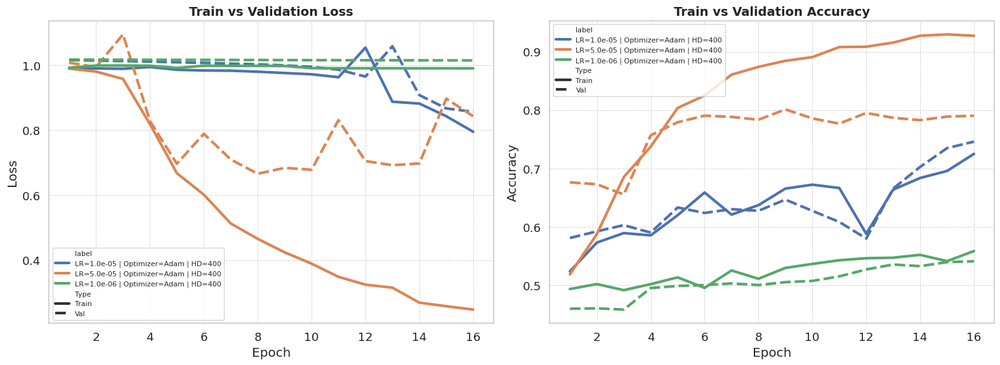

In [59]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **7.1.3 Batch size value selection**

In [60]:
# Batch size sweep configuration
batch_sizes = [8, 16, 64]
learning_rate = 2e-5
num_epochs = 16
results = []

# Compute class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop over different batch sizes
for batch_size in batch_sizes:
    print(f"\n🔹 Training with batch size: {batch_size}")

    # Create DataLoaders with the current batch size
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    # Instantiate GRU + Bahdanau Attention model
    model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"BS: {batch_size} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results for later plotting
    label = f"LR={learning_rate:.1e} | Batch={batch_size} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with batch size: 8
BS: 8 | Epoch 1/16 - TL: 0.9914, VL: 1.0001, TA: 51.73%, VA: 59.52%, F1: 47.86%, Time: 0.35 min
BS: 8 | Epoch 2/16 - TL: 0.9880, VL: 0.9955, TA: 59.86%, VA: 62.43%, F1: 45.45%, Time: 0.35 min
BS: 8 | Epoch 3/16 - TL: 0.9855, VL: 0.9889, TA: 63.29%, VA: 64.28%, F1: 48.53%, Time: 0.35 min
BS: 8 | Epoch 4/16 - TL: 0.9698, VL: 1.7015, TA: 66.28%, VA: 53.56%, F1: 16.97%, Time: 0.36 min
BS: 8 | Epoch 5/16 - TL: 0.9162, VL: 0.9808, TA: 66.56%, VA: 60.63%, F1: 41.18%, Time: 0.36 min
BS: 8 | Epoch 6/16 - TL: 0.8652, VL: 0.8382, TA: 68.62%, VA: 75.34%, F1: 62.63%, Time: 0.36 min
BS: 8 | Epoch 7/16 - TL: 0.7995, VL: 0.8328, TA: 73.74%, VA: 73.49%, F1: 61.74%, Time: 0.36 min
BS: 8 | Epoch 8/16 - TL: 0.7388, VL: 0.7664, TA: 76.74%, VA: 77.63%, F1: 66.27%, Time: 0.36 min
BS: 8 | Epoch 9/16 - TL: 0.7000, VL: 0.7146, TA: 77.80%, VA: 80.34%, F1: 68.73%, Time: 0.36 min
BS: 8 | Epoch 10/16 - TL: 0.6544, VL: 0.7516, TA: 79.89%, VA: 76.8

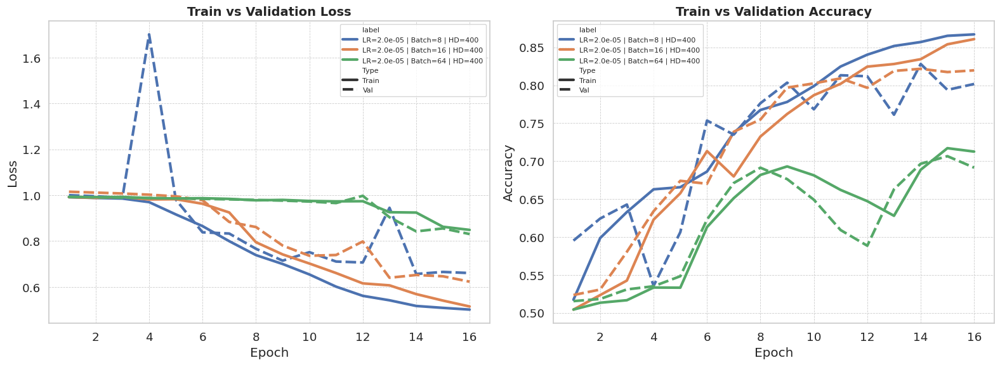

In [61]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **7.1.4 Dropout value selection**

In [62]:
# Hyperparameter sweep configuration
hidden_dims = [286]
dropouts = [0.1, 0.4, 0.8]
learning_rate = 1e-5
batch_size = 16
num_epochs = 16
results = []

# Compute class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for hidden_dim in hidden_dims:
    num_layers = 1  # fixed value for this sweep
    for dropout in dropouts:
        print(f"\n🔹 Training with hidden_dim={hidden_dim}, num_layers={num_layers}, dropout={dropout}")

        # Data loaders
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

        # Instantiate GRU + Bahdanau Attention model with current parameters
        model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        train_losses, val_losses = [], []
        train_accs, val_accs, val_f1s = [], [], []

        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
            val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

            train_losses.append(train_loss)
            val_losses.append(val_loss)
            train_accs.append(train_acc)
            val_accs.append(val_acc)
            val_f1s.append(f1)

            print(
                f"HD: {hidden_dim} | NL: {num_layers} | DP: {dropout} | Epoch {epoch+1}/{num_epochs} - "
                f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
                f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
                f"Time: {(time.time() - start_time)/60:.2f} min"
            )

        # Store results
        label = f"LR={learning_rate:.1e} | BS={batch_size} | HD={hidden_dim} | NL={num_layers} | DP={dropout}"
        for epoch in range(num_epochs):
            results.append({
                "epoch": epoch + 1,
                "label": label,
                "train_loss": train_losses[epoch],
                "val_loss": val_losses[epoch],
                "train_acc": train_accs[epoch],
                "val_acc": val_accs[epoch],
                "val_f1": val_f1s[epoch]
            })

Class weights: [0.69741587 1.76636225]

🔹 Training with hidden_dim=286, num_layers=1, dropout=0.1
HD: 286 | NL: 1 | DP: 0.1 | Epoch 1/16 - TL: 0.9984, VL: 1.0156, TA: 50.70%, VA: 53.27%, F1: 15.00%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 2/16 - TL: 0.9900, VL: 1.0138, TA: 51.80%, VA: 53.14%, F1: 16.67%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 3/16 - TL: 0.9885, VL: 1.0123, TA: 52.38%, VA: 53.29%, F1: 18.39%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 4/16 - TL: 0.9872, VL: 1.0105, TA: 55.07%, VA: 58.32%, F1: 32.46%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 5/16 - TL: 0.9855, VL: 1.0088, TA: 58.25%, VA: 61.09%, F1: 39.41%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 6/16 - TL: 0.9884, VL: 1.0066, TA: 59.15%, VA: 60.61%, F1: 39.05%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 7/16 - TL: 0.9817, VL: 1.0040, TA: 61.42%, VA: 61.35%, F1: 42.91%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 8/16 - TL: 0.9791, VL: 1.0015, TA: 65.08%, VA: 62.35%, F

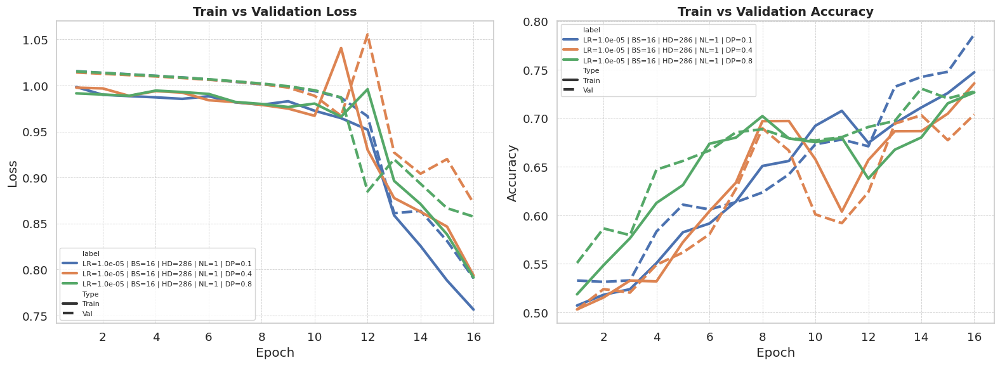

In [63]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

### **7.2 Test Phase**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

In [76]:
# --- Hyperparameters ---
HIDDEN_DIM = 286
DROPOUT = 0.8
NUM_LAYERS = 1
learning_rate = 5e-5
num_epochs = 50
patience = 6
best_model_path = "best_model2.pth"

# --- Model Instantiation ---
model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# --- Compute Class Weights ---
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Tracking Variables ---
train_losses, test_losses = [], []
train_accuracies, test_accuracies = [], []
test_f1s, test_balanced_accs, test_recalls, test_precisions = [], [], [], []

best_test_bal_acc = 0
patience_counter = 0
best_model_state = None

# --- Scheduler ---
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-6
)

# --- Training with Early Stopping ---
with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as epoch_pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        # Training step
        train_loss, train_acc = train_epoch(model, combined_loader, optimizer, loss_function, device)

        # Evaluation step
        test_loss, test_acc, test_f1, test_balanced_acc, test_recall, test_precision = test_epoch(
            model, test_loader, loss_function, device
        )

        # Logging
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        test_losses.append(test_loss)
        test_balanced_accs.append(test_balanced_acc)
        test_f1s.append(test_f1)

        # Scheduler step
        scheduler.step(test_balanced_acc)

        epoch_duration = time.time() - start_time

        # --- Early Stopping Logic ---
        if test_balanced_acc > best_test_bal_acc:
            best_test_bal_acc = test_balanced_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
            torch.save(best_model_state, best_model_path)
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"\nEarly stopping at epoch {epoch + 1}.")
                break

        epoch_pbar.set_postfix({
            "Training Loss": f"{train_loss:.4f}",
            "Test Loss": f"{test_loss:.4f}",
            "Train Balanced Acc": f"{train_acc:.2%}",
            "Test Balanced Acc": f"{test_balanced_acc:.2%}",
            "Test F1": f"{test_f1:.2%}",
            "Test Precision": f"{test_precision:.2%}",
            "Test Recall": f"{test_recall:.2%}",
            "Time(min)": f"{epoch_duration / 60:.2f}"
        })
        epoch_pbar.update(1)

# --- Load Best Model ---
model.load_state_dict(torch.load(best_model_path))

Class weights: [0.69741587 1.76636225]


Training Progress:  30%|███       | 15/50 [04:47<11:10, 19.17s/epoch, Training Loss=0.2744, Test Loss=0.9633, Train Balanced Acc=92.52%, Test Balanced Acc=76.34%, Test F1=67.08%, Test Precision=64.29%, Test Recall=70.13%, Time(min)=0.26]


Early stopping at epoch 16.


<All keys matched successfully>

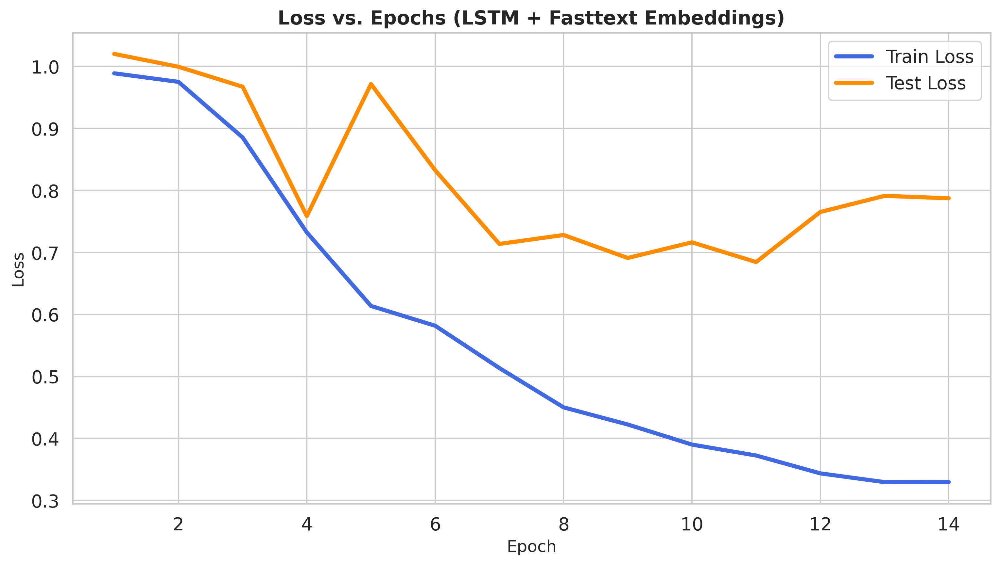

In [66]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=epochs, y=test_losses, label='Test Loss', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (LSTM + Fasttext Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='upper right', frameon=True)
plt.tight_layout()

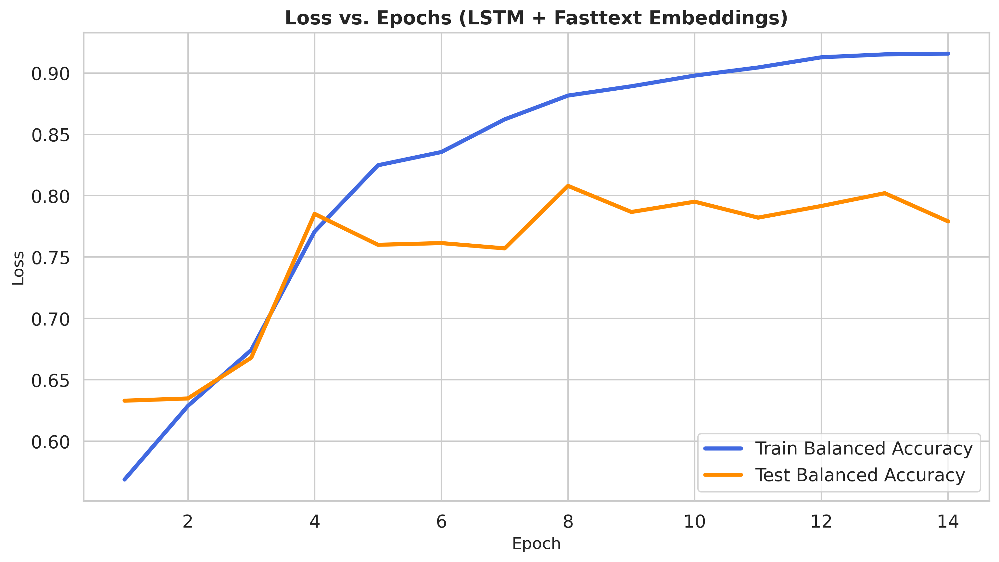

In [65]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 2. Balanced Accurcy Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_accuracies, label='Train Balanced Accuracy', color='royalblue')
sns.lineplot(x=epochs, y=test_balanced_accs, label='Test Balanced Accuracy', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (LSTM + Fasttext Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='lower right', frameon=True)
plt.tight_layout()

In [67]:
model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

model.load_state_dict(torch.load("/content/best_model2.pth"))
model.eval()

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Recalculate metrics on test set ---
final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_epoch(
    model, test_loader, loss_function, device
)

# --- Print results ---
print("\n Final Evaluation Metrics of Best Model:")
print(f"Test Loss           : {final_test_loss:.4f}")
print(f"Test Accuracy       : {final_test_acc:.2%}")
print(f"Test F1 Score       : {final_test_f1:.2%}")
print(f"Balanced Accuracy   : {final_test_bal_acc:.2%}")
print(f"Test Precision      : {final_test_precision:.2%}")
print(f"Test Recall         : {final_test_recall:.2%}")

Class weights: [0.69741587 1.76636225]

 Final Evaluation Metrics of Best Model:
Test Loss           : 0.7281
Test Accuracy       : 79.92%
Test F1 Score       : 71.91%
Balanced Accuracy   : 80.80%
Test Precision      : 63.37%
Test Recall         : 83.12%


In [68]:
df_results, df_correct, df_wrong, all_labels, all_pred, all_probs = evaluate_and_analyze(model, test_loader, device)

In [69]:
df_correct.head()

,index,true_label,predicted_label,probability,text
0,0,1,1,0.945944,PDGFRA H845_N848delinsP Gastrointestinal strom...
1,1,0,0,0.021916,BRCA2 G2748D Mutation screening of the breast ...
2,2,0,0,0.035485,PTEN F347L The tumor suppressor gene PTEN is f...
3,4,0,0,0.083028,PIK3R2 Amplification Structural rearrangements...
4,5,0,0,0.058353,TP53 R175H Tumor suppressor p53-dependent apop...


In [70]:
df_wrong.head()

,index,true_label,predicted_label,probability,text
0,3,0,1,0.903248,HRAS G12A The three-dimensional structure of t...
1,13,0,1,0.838881,CHEK2 K373E We identified CHK2 K373E as a recu...
2,15,1,0,0.110983,CDK4 R24C Many human tumors harbor mutations t...
3,1,0,1,0.735221,"BRAF T241P Noonan, LEOPARD and cardiofaciocuta..."
4,10,0,1,0.953550,KIT E839K c-KIT is a member of the type 3 subc...


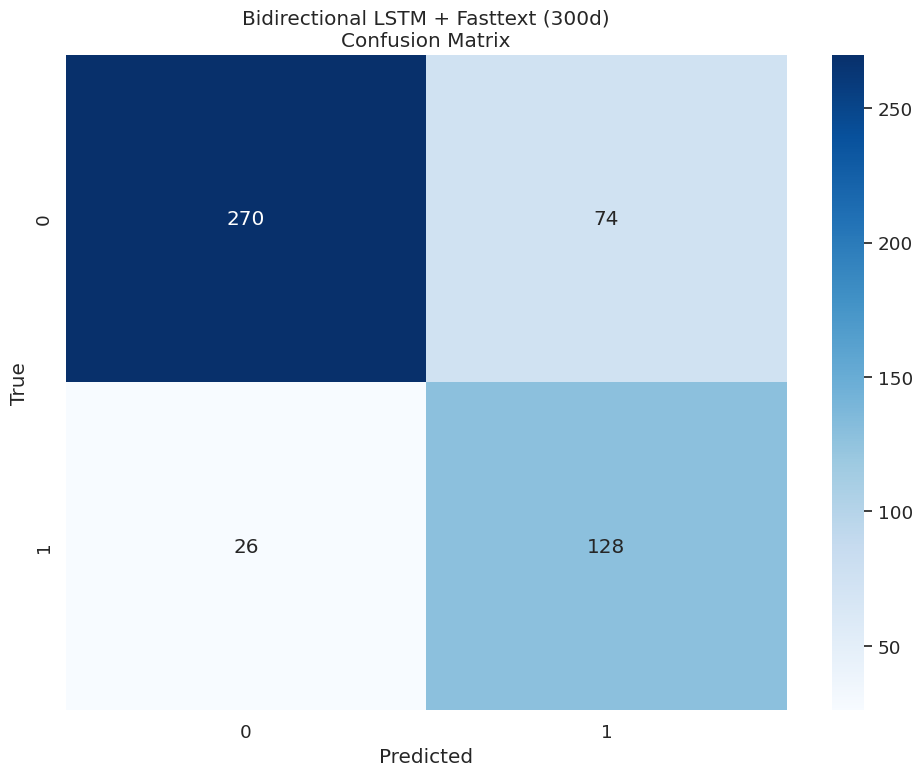

In [71]:
NUM_CLASSES = 2

fig, axes = plt.subplots(1, 1, figsize=(10, 8))

plot_confusion_matrix(axes, all_labels, all_pred)
axes.set_title("Bidirectional LSTM + Fasttext (300d)\nConfusion Matrix")

plt.tight_layout()
plt.show()

In [72]:
from sklearn.metrics import roc_curve, auc

y_true = np.array(all_labels)
y_scores = np.array(all_probs)

fpr, tpr, _ = roc_curve(y_true , y_scores)
roc_auc = auc(fpr, tpr)

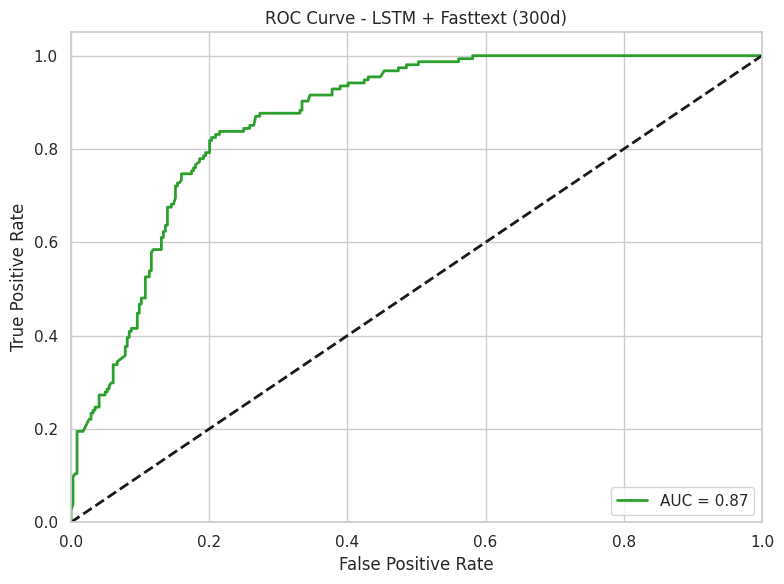

In [73]:
sns.set(style="whitegrid")

# One plot only
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

ax.plot(fpr, tpr, lw=2,
        label=f'AUC = {roc_auc:.2f}', color='tab:green')
ax.plot([0, 1], [0, 1], 'k--', lw=2)
ax.set_xlim([0.0, 1.0])
ax.set_ylim([0.0, 1.05])
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_title('ROC Curve - LSTM + Fasttext (300d)')
ax.legend(loc='lower right')
ax.grid(True)

plt.tight_layout()
plt.show()

### **7.3 Few Shot Learning**

In [77]:
k_values = range(1, 11)  # Few-shot from k=1 to 10
NUM_CLASSES = 2
HIDDEN_DIM = 286
DROPOUT = 0.7

X_combined = np.concatenate((X_train, X_val), axis=0)
y_combined = np.concatenate((y_train, y_val), axis=0)
X_combined_tensor = torch.cat((X_train_tensor, X_val_tensor), dim=0)
y_combined_tensor = torch.cat((y_train_tensor, y_val_tensor), dim=0)

model_metrics = {
    "K-shot": [],
    "Model": [],
    "Test Accuracy": [],
    "F1": [],
    "Balanced Accuracy": [],
    "Recall": [],
    "Precision": []
}

patience = 7
num_epochs = 50
for k in k_values:
    print(f"\n--- K-Shot = {k} ---")

    X_few, y_few = get_few_shot_subset(X_combined_tensor, y_combined_tensor, k_shot=k)
    few_shot_dataset = TextDataset(X_few, y_few, raw_text_data=X_combined)
    few_shot_loader = DataLoader(few_shot_dataset, batch_size=batch_size, shuffle=True, collate_fn=custom_collate_fn)

    model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

    print(f"{count_parameters(model)} model parameters")
    print()
    print(model)

    learning_rate = 2e-5
    optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)

    class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
    print(f"Class weights: {class_weights}")

    pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
    loss_function = torch.nn.BCEWithLogitsLoss()

    # Train with early stopping
    best_val_acc = 0
    patience_counter = 0
    for epoch in range(num_epochs):
        train_loss, train_acc = train_epoch(model, few_shot_loader, optimizer, loss_function, device)
        val_acc, val_f1, val_loss = evaluate_epoch(model, test_loader, loss_function, device)

        print(f"K={k} | Epoch {epoch+1}/{num_epochs} "
              f"- Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, "
              f"Test Loss: {val_loss:.4f}, Test Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                break

    # Load best model
    model.load_state_dict(best_model_state)

    # Evaluate on test set
    avg_loss, avg_accuracy, f1, balanced_acc, recall, precision = test_epoch(model, test_loader, loss_function, device)

    # Log metrics
    print(f"Test Accuracy: {avg_accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"Balanced Accuracy: {balanced_acc:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"Precision: {precision:.4f}")

    model_metrics["K-shot"].append(k)
    model_metrics["Model"].append("LSTM-Fasttext")
    model_metrics["Test Accuracy"].append(avg_accuracy)
    model_metrics["F1"].append(f1)
    model_metrics["Balanced Accuracy"].append(balanced_acc)
    model_metrics["Recall"].append(recall)
    model_metrics["Precision"].append(precision)

# Convert results to DataFrame
df = pd.DataFrame(model_metrics)


--- K-Shot = 1 ---


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


15469101 model parameters

LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]
K=1 | Epoch 1/50 - Train Loss: 0.6898, Train Acc: 0.5000, Test Loss: 0.0128, Test Acc: 0.6896, Val F1: 0.5018
K=1 | Epoch 2/50 - Train Loss: 0.6840, Train Acc: 1.0000, Test Loss: 0.1000, Test Acc: 0.6898, Val F1: 0.5045
K=1 | Epoch 3/50 - Train Loss: 0.6773, Train Acc: 1.0000, Test Loss: 0.1304, Test Acc: 0.6899, Val F1: 0.5128
K=1 | Epoch 4/50 - Train Loss: 0.6721, Train Acc: 1.0000, Test Loss: 0.1571, Test Acc: 0.6900, Val F1: 0.5167
K=1 | Epoch 5/50 - Train Loss: 0.6650, Train Acc: 1.0000, Test Loss: 0.1531, Test Acc: 0.6900, Val F1: 0.5095
K=1 | Epoch 6/50 - Train Loss: 0.6620, Train Acc: 1.0000, Test Loss: 0.1523, Test Acc: 0.6901, Val F1: 0.5080
K=1 | Epoch 7/50 - Train Loss: 0.6536, Train Acc: 1.0000,

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=2 | Epoch 1/50 - Train Loss: 0.6948, Train Acc: 0.5000, Test Loss: 0.0357, Test Acc: 0.6918, Val F1: 0.4938
K=2 | Epoch 2/50 - Train Loss: 0.6915, Train Acc: 0.5000, Test Loss: 0.0452, Test Acc: 0.6918, Val F1: 0.4854
K=2 | Epoch 3/50 - Train Loss: 0.6912, Train Acc: 0.5000, Test Loss: 0.0222, Test Acc: 0.6917, Val F1: 0.4716
K=2 | Epoch 4/50 - Train Loss: 0.6901, Train Acc: 0.5000, Test Loss: 0.0952, Test Acc: 0.6917, Val F1: 0.4914
K=2 | Epoch 5/50 - Train Loss: 0.6871, Train Acc: 0.7500, Test Loss: 0.1231, Test Acc: 0.6917, Val F1: 0.4968
K=2 | Epoch 6/50 - Train Loss: 0.6892, Train Acc: 0.5000, Test Loss: 0.1683, Test Acc: 0.6917, Val F1: 0.5101
K=2 | Epoch 7/50 - Train Loss: 0.6848, Train Acc: 1.0000, Test Loss: 0.2286, Test Acc: 0.6917, Val F1: 0.5314
K=2 | Epoch 8/50 - Train Loss: 0.6844, Train Acc: 1.0000, Test Loss: 0.2244, Test Acc: 0.6916, Val F1: 0.5340
K=2 | Epoch 9/50 - Train Loss: 0.6845, Train Acc: 1.0000, Test Loss: 0.2308, Test Acc: 0.6916, Val F1: 0.5343
Test Accur

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=3 | Epoch 1/50 - Train Loss: 0.6907, Train Acc: 0.5000, Test Loss: 0.4679, Test Acc: 0.6981, Val F1: 0.5031
K=3 | Epoch 2/50 - Train Loss: 0.6879, Train Acc: 0.6667, Test Loss: 0.4754, Test Acc: 0.6981, Val F1: 0.5117
K=3 | Epoch 3/50 - Train Loss: 0.6851, Train Acc: 0.6667, Test Loss: 0.4778, Test Acc: 0.6981, Val F1: 0.5150
K=3 | Epoch 4/50 - Train Loss: 0.6833, Train Acc: 0.6667, Test Loss: 0.4738, Test Acc: 0.6980, Val F1: 0.5099
K=3 | Epoch 5/50 - Train Loss: 0.6789, Train Acc: 0.6667, Test Loss: 0.4745, Test Acc: 0.6980, Val F1: 0.5114
K=3 | Epoch 6/50 - Train Loss: 0.6775, Train Acc: 0.8333, Test Loss: 0.4721, Test Acc: 0.6980, Val F1: 0.5081
K=3 | Epoch 7/50 - Train Loss: 0.6750, Train Acc: 0.6667, Test Loss: 0.4696, Test Acc: 0.6981, Val F1: 0.5049
K=3 | Epoch 8/50 - Train Loss: 0.6742, Train Acc: 0.8333, Test Loss: 0.4696, Test Acc: 0.6981, Val F1: 0.5049
K=3 | Epoch 9/50 - Train Loss: 0.6717, Train Acc: 0.6667, Test Loss: 0.4704, Test Acc: 0.6981, Val F1: 0.5063
K=3 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=4 | Epoch 1/50 - Train Loss: 0.6926, Train Acc: 0.5000, Test Loss: 0.3880, Test Acc: 0.6938, Val F1: 0.4530
K=4 | Epoch 2/50 - Train Loss: 0.6913, Train Acc: 0.6250, Test Loss: 0.4038, Test Acc: 0.6940, Val F1: 0.4590
K=4 | Epoch 3/50 - Train Loss: 0.6911, Train Acc: 0.5000, Test Loss: 0.4283, Test Acc: 0.6942, Val F1: 0.4776
K=4 | Epoch 4/50 - Train Loss: 0.6879, Train Acc: 0.8750, Test Loss: 0.4273, Test Acc: 0.6944, Val F1: 0.4736
K=4 | Epoch 5/50 - Train Loss: 0.6879, Train Acc: 0.8750, Test Loss: 0.4309, Test Acc: 0.6945, Val F1: 0.4783
K=4 | Epoch 6/50 - Train Loss: 0.6852, Train Acc: 1.0000, Test Loss: 0.4362, Test Acc: 0.6947, Val F1: 0.4822
K=4 | Epoch 7/50 - Train Loss: 0.6845, Train Acc: 1.0000, Test Loss: 0.4366, Test Acc: 0.6948, Val F1: 0.4811
K=4 | Epoch 8/50 - Train Loss: 0.6847, Train Acc: 1.0000, Test Loss: 0.4397, Test Acc: 0.6949, Val F1: 0.4869
K=4 | Epoch 9/50 - Train Loss: 0.6822, Train Acc: 1.0000, Test Loss: 0.4382, Test Acc: 0.6951, Val F1: 0.4840
K=4 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=5 | Epoch 1/50 - Train Loss: 0.6923, Train Acc: 0.5000, Test Loss: 0.4656, Test Acc: 0.6956, Val F1: 0.4939
K=5 | Epoch 2/50 - Train Loss: 0.6909, Train Acc: 0.6000, Test Loss: 0.4673, Test Acc: 0.6958, Val F1: 0.4957
K=5 | Epoch 3/50 - Train Loss: 0.6876, Train Acc: 0.8000, Test Loss: 0.4673, Test Acc: 0.6959, Val F1: 0.4957
K=5 | Epoch 4/50 - Train Loss: 0.6876, Train Acc: 0.7000, Test Loss: 0.4666, Test Acc: 0.6960, Val F1: 0.4943
K=5 | Epoch 5/50 - Train Loss: 0.6871, Train Acc: 0.9000, Test Loss: 0.4635, Test Acc: 0.6961, Val F1: 0.4896
K=5 | Epoch 6/50 - Train Loss: 0.6866, Train Acc: 0.7000, Test Loss: 0.4673, Test Acc: 0.6961, Val F1: 0.4957
K=5 | Epoch 7/50 - Train Loss: 0.6860, Train Acc: 0.7000, Test Loss: 0.4695, Test Acc: 0.6963, Val F1: 0.5001
K=5 | Epoch 8/50 - Train Loss: 0.6846, Train Acc: 0.9000, Test Loss: 0.4702, Test Acc: 0.6963, Val F1: 0.5015
K=5 | Epoch 9/50 - Train Loss: 0.6820, Train Acc: 0.8000, Test Loss: 0.4710, Test Acc: 0.6965, Val F1: 0.5030
K=5 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=6 | Epoch 1/50 - Train Loss: 0.6924, Train Acc: 0.5833, Test Loss: 0.4541, Test Acc: 0.6947, Val F1: 0.4840
K=6 | Epoch 2/50 - Train Loss: 0.6922, Train Acc: 0.5000, Test Loss: 0.4667, Test Acc: 0.6950, Val F1: 0.4991
K=6 | Epoch 3/50 - Train Loss: 0.6882, Train Acc: 0.5833, Test Loss: 0.4726, Test Acc: 0.6952, Val F1: 0.5048
K=6 | Epoch 4/50 - Train Loss: 0.6884, Train Acc: 0.6667, Test Loss: 0.4728, Test Acc: 0.6954, Val F1: 0.5037
K=6 | Epoch 5/50 - Train Loss: 0.6859, Train Acc: 0.8333, Test Loss: 0.4720, Test Acc: 0.6957, Val F1: 0.5022
K=6 | Epoch 6/50 - Train Loss: 0.6851, Train Acc: 0.7500, Test Loss: 0.4728, Test Acc: 0.6958, Val F1: 0.5037
K=6 | Epoch 7/50 - Train Loss: 0.6853, Train Acc: 0.5833, Test Loss: 0.4728, Test Acc: 0.6959, Val F1: 0.5037
K=6 | Epoch 8/50 - Train Loss: 0.6821, Train Acc: 0.8333, Test Loss: 0.4726, Test Acc: 0.6961, Val F1: 0.5048
K=6 | Epoch 9/50 - Train Loss: 0.6819, Train Acc: 0.6667, Test Loss: 0.4741, Test Acc: 0.6962, Val F1: 0.5077
K=6 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=7 | Epoch 1/50 - Train Loss: 0.6920, Train Acc: 0.4286, Test Loss: 0.4162, Test Acc: 0.6940, Val F1: 0.4657
K=7 | Epoch 2/50 - Train Loss: 0.6897, Train Acc: 0.4286, Test Loss: 0.3969, Test Acc: 0.6939, Val F1: 0.4510
K=7 | Epoch 3/50 - Train Loss: 0.6862, Train Acc: 0.4286, Test Loss: 0.3892, Test Acc: 0.6939, Val F1: 0.4442
K=7 | Epoch 4/50 - Train Loss: 0.6794, Train Acc: 0.7857, Test Loss: 0.3934, Test Acc: 0.6940, Val F1: 0.4658
K=7 | Epoch 5/50 - Train Loss: 0.6809, Train Acc: 0.7143, Test Loss: 0.3783, Test Acc: 0.6940, Val F1: 0.4642
K=7 | Epoch 6/50 - Train Loss: 0.6781, Train Acc: 0.7857, Test Loss: 0.3884, Test Acc: 0.6940, Val F1: 0.4816
K=7 | Epoch 7/50 - Train Loss: 0.6761, Train Acc: 0.8571, Test Loss: 0.3584, Test Acc: 0.6940, Val F1: 0.4714
K=7 | Epoch 8/50 - Train Loss: 0.6744, Train Acc: 0.8571, Test Loss: 0.3529, Test Acc: 0.6940, Val F1: 0.4904
K=7 | Epoch 9/50 - Train Loss: 0.6716, Train Acc: 0.8571, Test Loss: 0.3443, Test Acc: 0.6941, Val F1: 0.4880
K=7 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=8 | Epoch 1/50 - Train Loss: 0.6942, Train Acc: 0.5625, Test Loss: 0.2889, Test Acc: 0.6923, Val F1: 0.5147
K=8 | Epoch 2/50 - Train Loss: 0.6886, Train Acc: 0.8750, Test Loss: 0.2993, Test Acc: 0.6924, Val F1: 0.5183
K=8 | Epoch 3/50 - Train Loss: 0.6878, Train Acc: 0.6875, Test Loss: 0.2941, Test Acc: 0.6924, Val F1: 0.5165
K=8 | Epoch 4/50 - Train Loss: 0.6850, Train Acc: 0.8750, Test Loss: 0.3011, Test Acc: 0.6925, Val F1: 0.5157
K=8 | Epoch 5/50 - Train Loss: 0.6830, Train Acc: 0.8750, Test Loss: 0.3188, Test Acc: 0.6925, Val F1: 0.5295
K=8 | Epoch 6/50 - Train Loss: 0.6823, Train Acc: 0.9375, Test Loss: 0.3185, Test Acc: 0.6925, Val F1: 0.5335
K=8 | Epoch 7/50 - Train Loss: 0.6798, Train Acc: 0.8750, Test Loss: 0.3197, Test Acc: 0.6926, Val F1: 0.5350
K=8 | Epoch 8/50 - Train Loss: 0.6784, Train Acc: 0.8750, Test Loss: 0.3180, Test Acc: 0.6927, Val F1: 0.5240
K=8 | Epoch 9/50 - Train Loss: 0.6780, Train Acc: 0.8125, Test Loss: 0.3214, Test Acc: 0.6927, Val F1: 0.5284
K=8 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=9 | Epoch 1/50 - Train Loss: 0.6952, Train Acc: 0.5000, Test Loss: 0.4717, Test Acc: 0.6953, Val F1: 0.5104
K=9 | Epoch 2/50 - Train Loss: 0.6882, Train Acc: 0.6111, Test Loss: 0.4713, Test Acc: 0.6965, Val F1: 0.5067
K=9 | Epoch 3/50 - Train Loss: 0.6906, Train Acc: 0.6667, Test Loss: 0.4767, Test Acc: 0.6965, Val F1: 0.5169
K=9 | Epoch 4/50 - Train Loss: 0.6879, Train Acc: 0.7222, Test Loss: 0.4719, Test Acc: 0.6953, Val F1: 0.5152
K=9 | Epoch 5/50 - Train Loss: 0.6780, Train Acc: 0.7778, Test Loss: 0.4669, Test Acc: 0.6953, Val F1: 0.5087
K=9 | Epoch 6/50 - Train Loss: 0.6891, Train Acc: 0.7778, Test Loss: 0.4712, Test Acc: 0.6944, Val F1: 0.5196
K=9 | Epoch 7/50 - Train Loss: 0.6855, Train Acc: 0.7778, Test Loss: 0.4762, Test Acc: 0.6944, Val F1: 0.5272
K=9 | Epoch 8/50 - Train Loss: 0.6856, Train Acc: 0.8889, Test Loss: 0.4256, Test Acc: 0.6936, Val F1: 0.4832
K=9 | Epoch 9/50 - Train Loss: 0.6828, Train Acc: 0.8889, Test Loss: 0.4599, Test Acc: 0.6943, Val F1: 0.5100
K=9 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=10 | Epoch 1/50 - Train Loss: 0.6956, Train Acc: 0.5000, Test Loss: 0.0565, Test Acc: 0.6892, Val F1: 0.4901
K=10 | Epoch 2/50 - Train Loss: 0.6937, Train Acc: 0.5000, Test Loss: 0.0773, Test Acc: 0.6901, Val F1: 0.4937
K=10 | Epoch 3/50 - Train Loss: 0.6896, Train Acc: 0.6500, Test Loss: 0.1081, Test Acc: 0.6901, Val F1: 0.5019
K=10 | Epoch 4/50 - Train Loss: 0.6880, Train Acc: 0.6500, Test Loss: 0.1176, Test Acc: 0.6903, Val F1: 0.5037
K=10 | Epoch 5/50 - Train Loss: 0.6863, Train Acc: 0.6500, Test Loss: 0.1170, Test Acc: 0.6905, Val F1: 0.5023
K=10 | Epoch 6/50 - Train Loss: 0.6820, Train Acc: 0.6500, Test Loss: 0.1122, Test Acc: 0.6905, Val F1: 0.4907
K=10 | Epoch 7/50 - Train Loss: 0.6873, Train Acc: 0.6500, Test Loss: 0.1546, Test Acc: 0.6916, Val F1: 0.4982
K=10 | Epoch 8/50 - Train Loss: 0.6835, Train Acc: 0.6500, Test Loss: 0.1206, Test Acc: 0.6908, Val F1: 0.4910
K=10 | Epoch 9/50 - Train Loss: 0.6852, Train Acc: 0.7500, Test Loss: 0.1650, Test Acc: 0.6912, Val F1: 0.5043
K

In [79]:
# --- Plotting ---
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
palette = sns.color_palette("Set2")

def plot_model_performance(df, model_name, color, title_prefix="Model Performance"):
    model_df = df[df["Model"] == model_name]
    metrics_to_plot = ["F1", "Balanced Accuracy", "Recall", "Precision"]

    fig, axes = plt.subplots(2, 2, figsize=(14, 10), sharex=True)
    axes = axes.flatten()

    for i, metric in enumerate(metrics_to_plot):
        sns.lineplot(
            data=model_df,
            x="K-shot",
            y=metric,
            ax=axes[i],
            color=color,
            marker="o",
            linewidth=2.2,
            markersize=6,
        )
        axes[i].set_title(metric, fontsize=14)
        axes[i].set_xlabel("K-shot")
        axes[i].set_ylabel(metric)
        axes[i].grid(True)

    plt.suptitle(f"{title_prefix} for {model_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

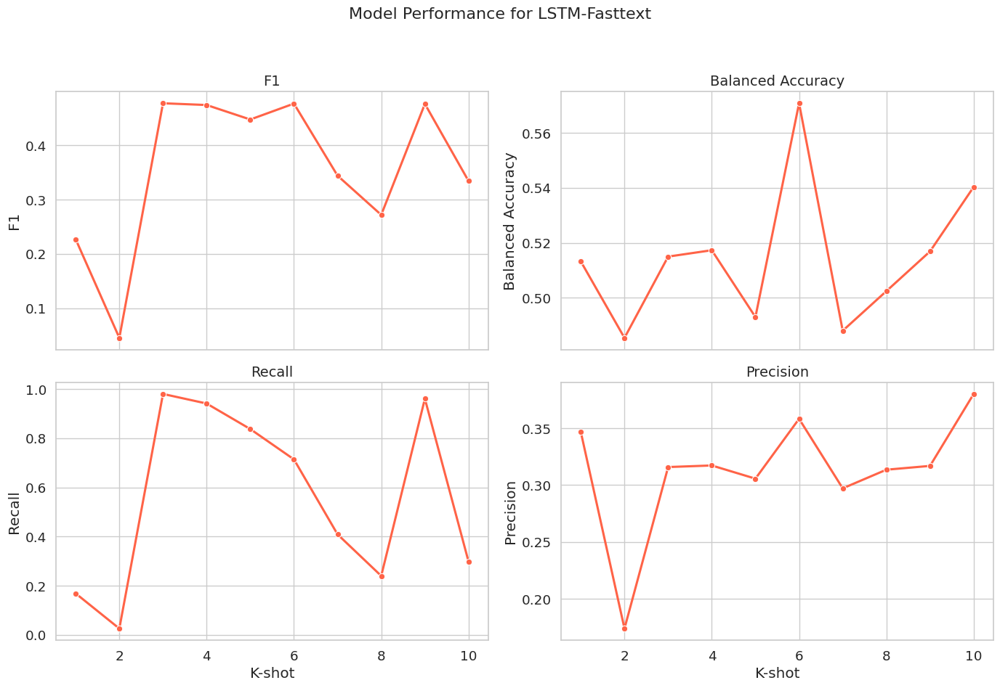

In [80]:
# Plot results
plot_model_performance(df, "LSTM-Fasttext", "tomato")

Maximum values per metric:
Balanced Accuracy: 0.5708 (at K-shot = 6)
F1: 0.4778 (at K-shot = 3)
Recall: 0.9805 (at K-shot = 3)
Precision: 0.3802 (at K-shot = 10)


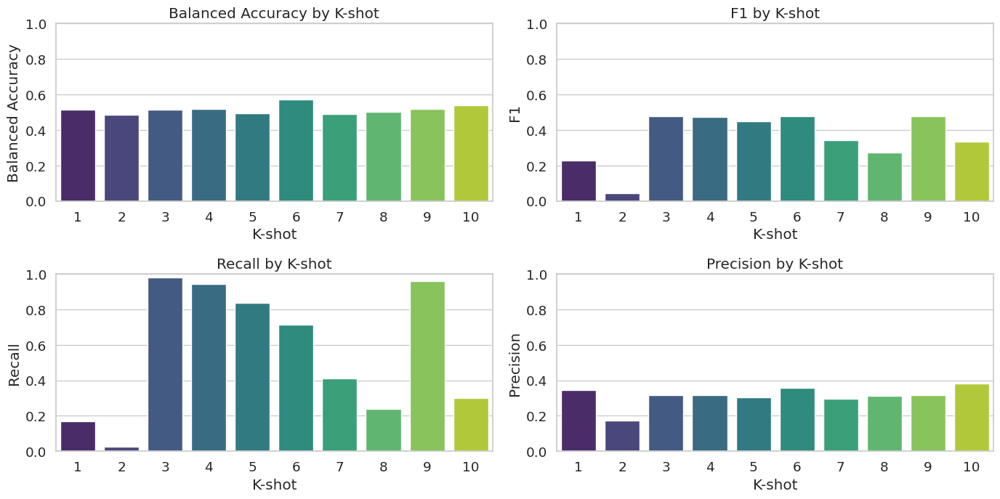

In [81]:
metrics = ["Balanced Accuracy", "F1", "Recall", "Precision"]

# Print max values for each metric
print("Maximum values per metric:")
for metric in metrics:
    max_val = df[metric].max()
    max_k = df.loc[df[metric].idxmax(), "K-shot"]
    print(f"{metric}: {max_val:.4f} (at K-shot = {max_k})")

# Then plot the histograms
plt.figure(figsize=(14, 10))

for i, metric in enumerate(metrics, 1):
    plt.subplot(3, 2, i)
    sns.barplot(x="K-shot", y=metric, data=df, palette="viridis")
    plt.title(f"{metric} by K-shot")
    plt.ylim(0, 1)
    plt.xlabel("K-shot")
    plt.ylabel(metric)

plt.tight_layout()
plt.show()

## **8. Bidirectional GRU + Weight Class using Fasttext (300d)**

### **8.1 Optimization Phase**

#### **8.1.1 Optimizer selection**

In [82]:
num_epochs = 16
learning_rate = 5e-5

class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)
results = []

optimizers = {
    'Adam': optim.Adam,
    'RMSprop': optim.RMSprop,
    'AdamW': optim.AdamW
}

all_train_losses, all_val_losses = {}, {}
all_train_accs, all_val_accs = {}, {}

# Loop through optimizers
for optimizer_name, optimizer_class in optimizers.items():
    print(f"\n🔹 Training with optimizer: {optimizer_name}")

    model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=learning_rate)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total trainable parameters: {num_params}")

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []
    best_val_loss = float('inf')

    # Training loop
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # <-- fixed unpacking order

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        scheduler.step(f1)

        duration = time.time() - start_time

        print(
            f"Opt: {optimizer_name} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {duration/60:.2f} min"
        )

    # Store metrics
    all_train_losses[optimizer_name] = train_losses
    all_val_losses[optimizer_name] = val_losses
    all_train_accs[optimizer_name] = train_accs
    all_val_accs[optimizer_name] = val_accs

    label = f"Batch={BATCH_SIZE} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with optimizer: Adam
GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 14667101
Opt: Adam | Epoch 1/16 - TL: 0.9875, VL: 1.0029, TA: 53.84%, VA: 63.69%, F1: 49.07%, Time: 0.16 min
Opt: Adam | Epoch 2/16 - TL: 0.9780, VL: 0.9826, TA: 64.40%, VA: 65.54%, F1: 51.52%, Time: 0.16 min
Opt: Adam | Epoch 3/16 - TL: 0.9329, VL: 0.8856, TA: 68.15%, VA: 69.35%, F1: 56.34%, Time: 0.17 min
Opt: Adam | Epoch 4/16 - TL: 0.7408, VL: 0.6924, TA: 76.82%, VA: 79.02%, F1: 66.49%, Time: 0.17 min
Opt: Adam | Epoch 5/16 - TL: 0.5899, VL: 0.6591, TA: 82.85%, VA: 77.68%, F1: 65.09%, Time: 0.17 min
Opt: Adam | Epoch 6/16 - TL: 0.5317, VL: 0.6218, TA: 85.39%, VA: 80.90%, F1: 69.52%, Time: 0.17 min
Opt: Adam | Epoch 7/16 - TL: 0.4705, VL: 0.6346, TA: 87.25%, VA: 82.24%, F1: 

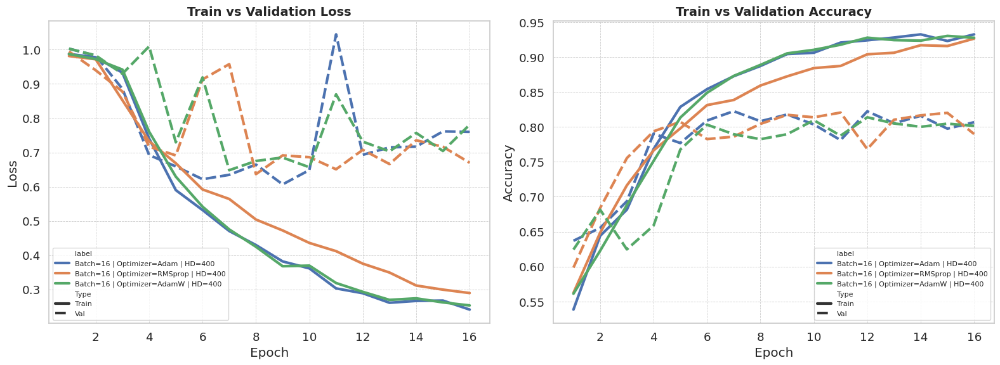

In [83]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **8.1.2 Learning rate value selection**

In [84]:
# Learning rate sweep configuration
learning_rates = [1e-5, 5e-5, 1e-6]
optimizer_name = 'Adam'
optimizer_class = optim.Adam
results = []
num_epochs = 16

# Class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop through learning rates
for lr in learning_rates:
    print(f"\n🔹 Training with {optimizer_name} optimizer, learning rate = {lr}")

    # Instantiate GRU + Bahdanau Attention model
    model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        scheduler.step(f1)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"LR: {lr:.1e} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results
    label = f"LR={lr:.1e} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with Adam optimizer, learning rate = 1e-05
GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
LR: 1.0e-05 | Epoch 1/16 - TL: 0.9920, VL: 1.0163, TA: 50.47%, VA: 52.70%, F1: 12.74%, Time: 0.17 min
LR: 1.0e-05 | Epoch 2/16 - TL: 0.9964, VL: 1.0132, TA: 52.71%, VA: 54.85%, F1: 22.60%, Time: 0.17 min
LR: 1.0e-05 | Epoch 3/16 - TL: 0.9863, VL: 1.0098, TA: 55.24%, VA: 58.97%, F1: 35.29%, Time: 0.17 min
LR: 1.0e-05 | Epoch 4/16 - TL: 0.9841, VL: 1.0072, TA: 57.49%, VA: 59.54%, F1: 36.71%, Time: 0.17 min
LR: 1.0e-05 | Epoch 5/16 - TL: 0.9885, VL: 1.0041, TA: 59.98%, VA: 61.56%, F1: 42.98%, Time: 0.17 min
LR: 1.0e-05 | Epoch 6/16 - TL: 0.9855, VL: 1.0008, TA: 64.15%, VA: 62.26%, F1: 46.71%, Time: 0.17 min
LR: 1.0e-05 | Epoch 7/16 - TL: 0.9745, VL: 0.9973, TA: 68.01%, VA: 63.70%, F1: 4

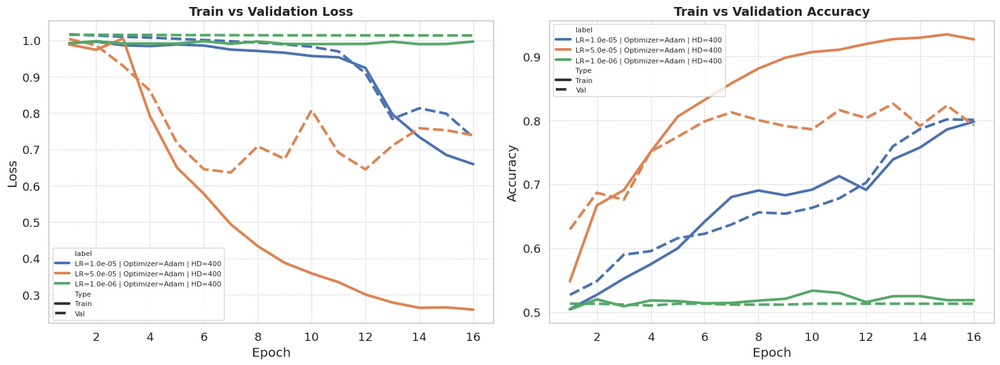

In [85]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **8.1.3 Batch size value selection**

In [86]:
# Batch size sweep configuration
batch_sizes = [8, 16, 64]
learning_rate = 2e-5
num_epochs = 16
results = []

# Compute class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop over different batch sizes
for batch_size in batch_sizes:
    print(f"\n🔹 Training with batch size: {batch_size}")

    # Create DataLoaders with the current batch size
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    # Instantiate GRU + Bahdanau Attention model
    model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"BS: {batch_size} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results for later plotting
    label = f"LR={learning_rate:.1e} | Batch={batch_size} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with batch size: 8
BS: 8 | Epoch 1/16 - TL: 0.9890, VL: 0.9952, TA: 54.31%, VA: 66.55%, F1: 53.07%, Time: 0.28 min
BS: 8 | Epoch 2/16 - TL: 0.9825, VL: 0.9874, TA: 60.10%, VA: 63.63%, F1: 47.10%, Time: 0.28 min
BS: 8 | Epoch 3/16 - TL: 0.9726, VL: 0.9768, TA: 67.11%, VA: 62.90%, F1: 45.27%, Time: 0.28 min
BS: 8 | Epoch 4/16 - TL: 0.9799, VL: 2.3007, TA: 66.29%, VA: 52.21%, F1: 11.46%, Time: 0.28 min
BS: 8 | Epoch 5/16 - TL: 0.8584, VL: 0.8045, TA: 70.65%, VA: 74.62%, F1: 62.09%, Time: 0.28 min
BS: 8 | Epoch 6/16 - TL: 0.7170, VL: 0.8186, TA: 76.31%, VA: 74.77%, F1: 63.51%, Time: 0.28 min
BS: 8 | Epoch 7/16 - TL: 0.6775, VL: 0.6614, TA: 79.33%, VA: 81.46%, F1: 70.32%, Time: 0.28 min
BS: 8 | Epoch 8/16 - TL: 0.6127, VL: 0.7658, TA: 80.92%, VA: 78.97%, F1: 68.10%, Time: 0.28 min
BS: 8 | Epoch 9/16 - TL: 0.5894, VL: 0.6770, TA: 82.68%, VA: 80.03%, F1: 69.30%, Time: 0.28 min
BS: 8 | Epoch 10/16 - TL: 0.5302, VL: 0.6446, TA: 85.07%, VA: 81.2

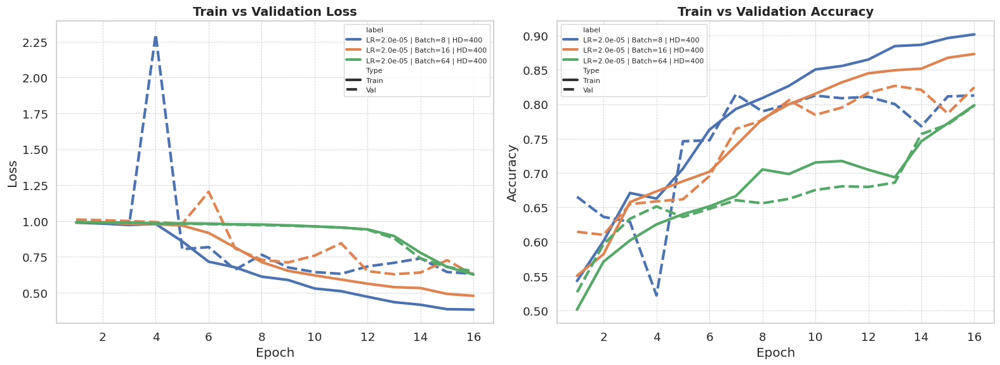

In [87]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **8.1.4 Dropout value selection**

In [88]:
# Hyperparameter sweep configuration
hidden_dims = [286]
dropouts = [0.1, 0.4, 0.8]
learning_rate = 1e-5
batch_size = 16
num_epochs = 16
results = []

# Compute class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for hidden_dim in hidden_dims:
    num_layers = 1  # fixed value for this sweep
    for dropout in dropouts:
        print(f"\n🔹 Training with hidden_dim={hidden_dim}, num_layers={num_layers}, dropout={dropout}")

        # Data loaders
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

        # Instantiate GRU + Bahdanau Attention model with current parameters
        model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        train_losses, val_losses = [], []
        train_accs, val_accs, val_f1s = [], [], []

        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
            val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

            train_losses.append(train_loss)
            val_losses.append(val_loss)
            train_accs.append(train_acc)
            val_accs.append(val_acc)
            val_f1s.append(f1)

            print(
                f"HD: {hidden_dim} | NL: {num_layers} | DP: {dropout} | Epoch {epoch+1}/{num_epochs} - "
                f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
                f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
                f"Time: {(time.time() - start_time)/60:.2f} min"
            )

        # Store results
        label = f"LR={learning_rate:.1e} | BS={batch_size} | HD={hidden_dim} | NL={num_layers} | DP={dropout}"
        for epoch in range(num_epochs):
            results.append({
                "epoch": epoch + 1,
                "label": label,
                "train_loss": train_losses[epoch],
                "val_loss": val_losses[epoch],
                "train_acc": train_accs[epoch],
                "val_acc": val_accs[epoch],
                "val_f1": val_f1s[epoch]
            })

Class weights: [0.69741587 1.76636225]

🔹 Training with hidden_dim=286, num_layers=1, dropout=0.1
HD: 286 | NL: 1 | DP: 0.1 | Epoch 1/16 - TL: 0.9921, VL: 1.0149, TA: 48.52%, VA: 50.45%, F1: 43.46%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 2/16 - TL: 0.9890, VL: 1.0123, TA: 54.92%, VA: 53.64%, F1: 44.44%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 3/16 - TL: 0.9941, VL: 1.0099, TA: 60.33%, VA: 58.01%, F1: 43.97%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 4/16 - TL: 0.9846, VL: 1.0073, TA: 63.42%, VA: 64.35%, F1: 51.54%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 5/16 - TL: 0.9822, VL: 1.0046, TA: 64.44%, VA: 64.81%, F1: 51.44%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 6/16 - TL: 0.9791, VL: 1.0019, TA: 64.71%, VA: 64.90%, F1: 50.76%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 7/16 - TL: 0.9757, VL: 0.9989, TA: 67.74%, VA: 63.19%, F1: 48.25%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 8/16 - TL: 0.9716, VL: 0.9956, TA: 65.74%, VA: 64.73%, F

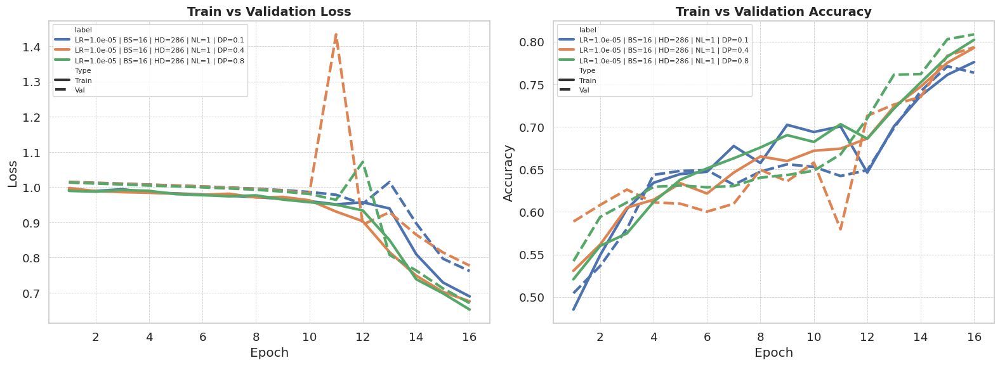

In [89]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

### **8.2 Test Phase**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

In [90]:
# --- Hyperparameters ---
HIDDEN_DIM = 286
DROPOUT = 0.8
NUM_LAYERS = 1
learning_rate = 5e-5
num_epochs = 50
patience = 6
best_model_path = "best_model2.pth"

# --- Model Instantiation ---
model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# --- Compute Class Weights ---
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Tracking Variables ---
train_losses, test_losses = [], []
train_accuracies, test_accuracies = [], []
test_f1s, test_balanced_accs, test_recalls, test_precisions = [], [], [], []

best_test_bal_acc = 0
patience_counter = 0
best_model_state = None

# --- Scheduler ---
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-6
)

# --- Training with Early Stopping ---
with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as epoch_pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        # Training step
        train_loss, train_acc = train_epoch(model, combined_loader, optimizer, loss_function, device)

        # Evaluation step
        test_loss, test_acc, test_f1, test_balanced_acc, test_recall, test_precision = test_epoch(
            model, test_loader, loss_function, device
        )

        # Logging
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        test_losses.append(test_loss)
        test_balanced_accs.append(test_balanced_acc)
        test_f1s.append(test_f1)

        # Scheduler step
        scheduler.step(test_balanced_acc)

        epoch_duration = time.time() - start_time

        # --- Early Stopping Logic ---
        if test_balanced_acc > best_test_bal_acc:
            best_test_bal_acc = test_balanced_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
            torch.save(best_model_state, best_model_path)
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"\nEarly stopping at epoch {epoch + 1}.")
                break

        epoch_pbar.set_postfix({
            "Training Loss": f"{train_loss:.4f}",
            "Test Loss": f"{test_loss:.4f}",
            "Train Balanced Acc": f"{train_acc:.2%}",
            "Test Balanced Acc": f"{test_balanced_acc:.2%}",
            "Test F1": f"{test_f1:.2%}",
            "Test Precision": f"{test_precision:.2%}",
            "Test Recall": f"{test_recall:.2%}",
            "Time(min)": f"{epoch_duration / 60:.2f}"
        })
        epoch_pbar.update(1)

# --- Load Best Model ---
model.load_state_dict(torch.load(best_model_path))

Class weights: [0.69741587 1.76636225]


Training Progress:  34%|███▍      | 17/50 [04:31<08:47, 15.98s/epoch, Training Loss=0.2641, Test Loss=0.8566, Train Balanced Acc=92.71%, Test Balanced Acc=80.56%, Test F1=71.84%, Test Precision=64.43%, Test Recall=81.17%, Time(min)=0.21]


Early stopping at epoch 18.


<All keys matched successfully>

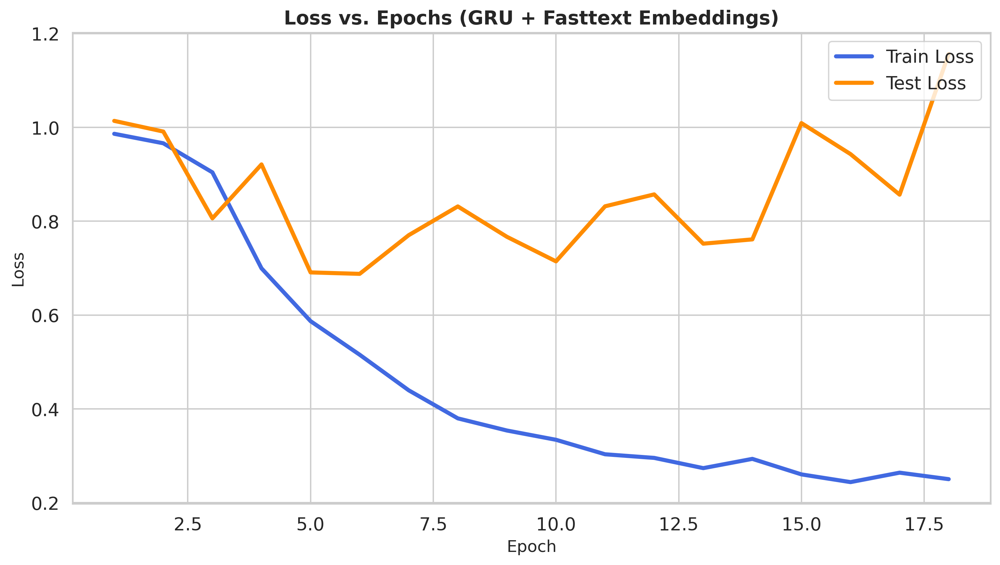

In [91]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=epochs, y=test_losses, label='Test Loss', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (GRU + Fasttext Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='upper right', frameon=True)
plt.tight_layout()

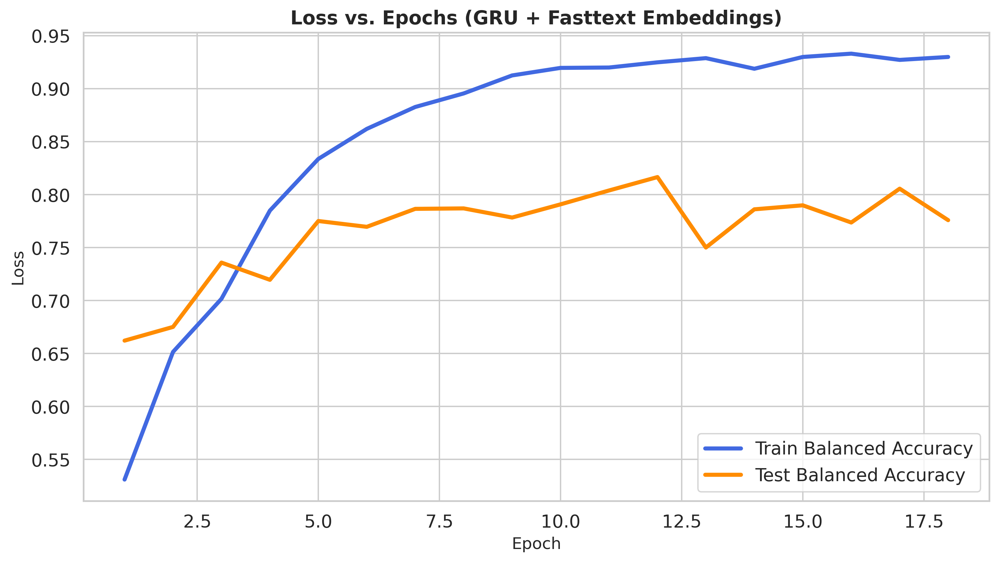

In [92]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 2. Balanced Accurcy Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_accuracies, label='Train Balanced Accuracy', color='royalblue')
sns.lineplot(x=epochs, y=test_balanced_accs, label='Test Balanced Accuracy', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (GRU + Fasttext Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='lower right', frameon=True)
plt.tight_layout()

In [155]:
model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

model.load_state_dict(torch.load("/content/best_model2.pth"))
model.eval()

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Recalculate metrics on test set ---
final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_epoch(
    model, test_loader, loss_function, device
)

# --- Print results ---
print("\n Final Evaluation Metrics of Best Model:")
print(f"Test Loss           : {final_test_loss:.4f}")
print(f"Test Accuracy       : {final_test_acc:.2%}")
print(f"Test F1 Score       : {final_test_f1:.2%}")
print(f"Balanced Accuracy   : {final_test_bal_acc:.2%}")
print(f"Test Precision      : {final_test_precision:.2%}")
print(f"Test Recall         : {final_test_recall:.2%}")

Class weights: [0.69741587 1.76636225]

 Final Evaluation Metrics of Best Model:
Test Loss           : 0.8572
Test Accuracy       : 82.33%
Test F1 Score       : 73.65%
Balanced Accuracy   : 81.65%
Test Precision      : 68.33%
Test Recall         : 79.87%


In [93]:
df_results, df_correct, df_wrong, all_labels, all_pred, all_probs = evaluate_and_analyze(model, test_loader, device)

In [94]:
df_correct.head()

,index,true_label,predicted_label,probability,text
0,0,1,1,0.993644,PDGFRA H845_N848delinsP Gastrointestinal strom...
1,1,0,0,0.001441,BRCA2 G2748D Mutation screening of the breast ...
2,2,0,0,0.003358,PTEN F347L The tumor suppressor gene PTEN is f...
3,4,0,0,0.033851,PIK3R2 Amplification Structural rearrangements...
4,5,0,0,0.007651,TP53 R175H Tumor suppressor p53-dependent apop...


In [95]:
df_wrong.head()

,index,true_label,predicted_label,probability,text
0,3,0,1,0.962775,HRAS G12A The three-dimensional structure of t...
1,15,1,0,0.073663,CDK4 R24C Many human tumors harbor mutations t...
2,2,1,0,0.022623,IL7R T244_I245insCPT Signaling mediated by IL-...
3,10,0,1,0.994034,KIT E839K c-KIT is a member of the type 3 subc...
4,2,0,1,0.992160,ROS1 Fusions Oncogenic gene fusions involving ...


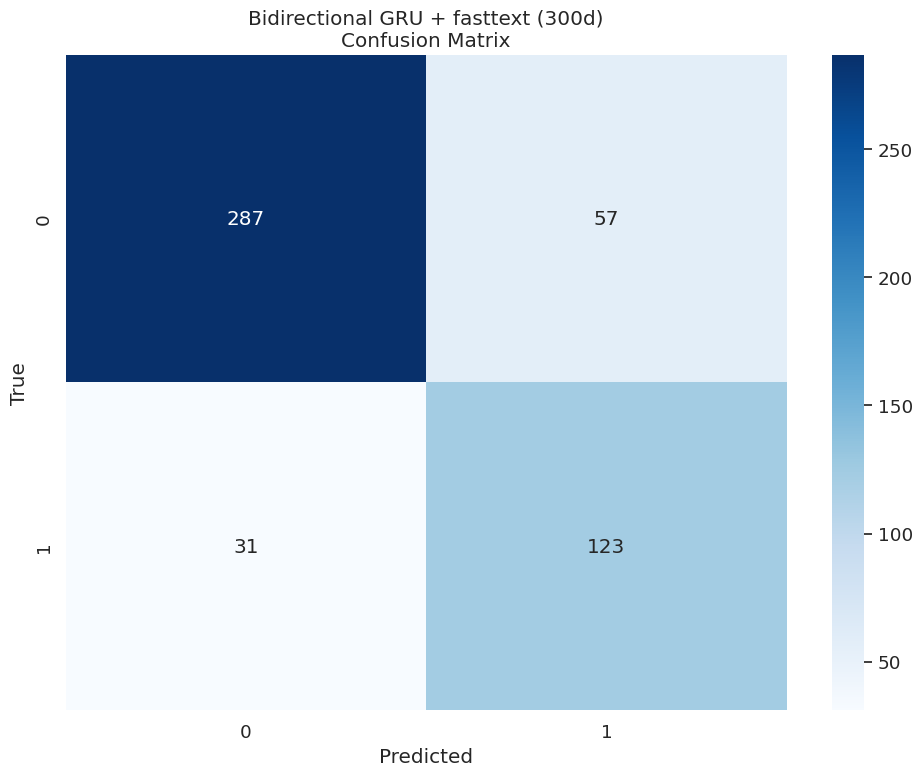

In [96]:
NUM_CLASSES = 2

fig, axes = plt.subplots(1, 1, figsize=(10, 8))

plot_confusion_matrix(axes, all_labels, all_pred)
axes.set_title("Bidirectional GRU + fasttext (300d)\nConfusion Matrix")

plt.tight_layout()
plt.show()

In [97]:
from sklearn.metrics import roc_curve, auc

y_true = np.array(all_labels)
y_scores = np.array(all_probs)

fpr, tpr, _ = roc_curve(y_true , y_scores)
roc_auc = auc(fpr, tpr)

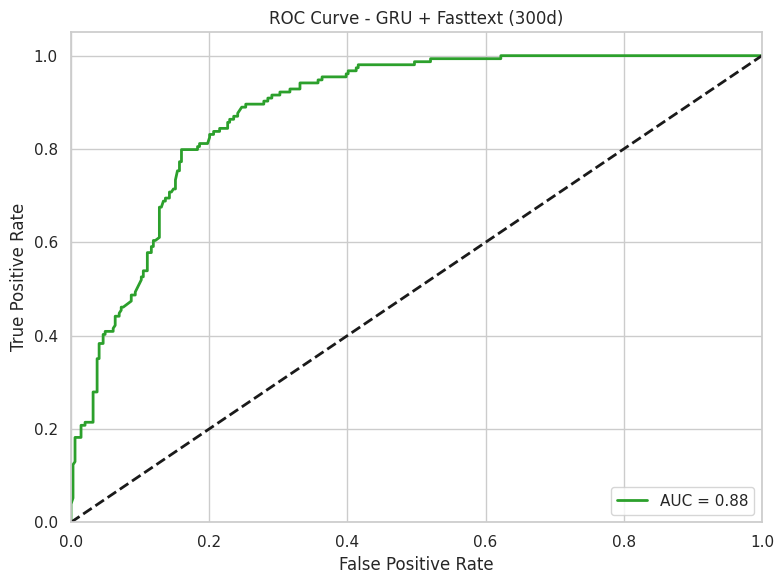

In [98]:
sns.set(style="whitegrid")

# One plot only
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

ax.plot(fpr, tpr, lw=2,
        label=f'AUC = {roc_auc:.2f}', color='tab:green')
ax.plot([0, 1], [0, 1], 'k--', lw=2)
ax.set_xlim([0.0, 1.0])
ax.set_ylim([0.0, 1.05])
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_title('ROC Curve - GRU + Fasttext (300d)')
ax.legend(loc='lower right')
ax.grid(True)

plt.tight_layout()
plt.show()

### **8.3 Few Shot Learning**

In [99]:
k_values = range(1, 11)  # Few-shot from k=1 to 10
NUM_CLASSES = 2
HIDDEN_DIM = 286
DROPOUT = 0.7

X_combined = np.concatenate((X_train, X_val), axis=0)
y_combined = np.concatenate((y_train, y_val), axis=0)
X_combined_tensor = torch.cat((X_train_tensor, X_val_tensor), dim=0)
y_combined_tensor = torch.cat((y_train_tensor, y_val_tensor), dim=0)

model_metrics = {
    "K-shot": [],
    "Model": [],
    "Test Accuracy": [],
    "F1": [],
    "Balanced Accuracy": [],
    "Recall": [],
    "Precision": []
}

patience = 7
num_epochs = 50
for k in k_values:
    print(f"\n--- K-Shot = {k} ---")

    X_few, y_few = get_few_shot_subset(X_combined_tensor, y_combined_tensor, k_shot=k)
    few_shot_dataset = TextDataset(X_few, y_few, raw_text_data=X_combined)
    few_shot_loader = DataLoader(few_shot_dataset, batch_size=batch_size, shuffle=True, collate_fn=custom_collate_fn)

    model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

    print(f"{count_parameters(model)} model parameters")
    print()
    print(model)

    learning_rate = 2e-5
    optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)

    class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
    print(f"Class weights: {class_weights}")

    pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
    loss_function = torch.nn.BCEWithLogitsLoss()

    # Train with early stopping
    best_val_acc = 0
    patience_counter = 0
    for epoch in range(num_epochs):
        train_loss, train_acc = train_epoch(model, few_shot_loader, optimizer, loss_function, device)
        val_acc, val_f1, val_loss = evaluate_epoch(model, test_loader, loss_function, device)

        print(f"K={k} | Epoch {epoch+1}/{num_epochs} "
              f"- Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, "
              f"Test Loss: {val_loss:.4f}, Test Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                break

    # Load best model
    model.load_state_dict(best_model_state)

    # Evaluate on test set
    avg_loss, avg_accuracy, f1, balanced_acc, recall, precision = test_epoch(model, test_loader, loss_function, device)

    # Log metrics
    print(f"Test Accuracy: {avg_accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"Balanced Accuracy: {balanced_acc:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"Precision: {precision:.4f}")

    model_metrics["K-shot"].append(k)
    model_metrics["Model"].append("GRU")
    model_metrics["Test Accuracy"].append(avg_accuracy)
    model_metrics["F1"].append(f1)
    model_metrics["Balanced Accuracy"].append(balanced_acc)
    model_metrics["Recall"].append(recall)
    model_metrics["Precision"].append(precision)

# Convert results to DataFrame
df = pd.DataFrame(model_metrics)


--- K-Shot = 1 ---
14667101 model parameters

GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=1 | Epoch 1/50 - Train Loss: 0.6858, Train Acc: 0.5000, Test Loss: 0.4715, Test Acc: 0.7013, Val F1: 0.4997
K=1 | Epoch 2/50 - Train Loss: 0.6851, Train Acc: 0.5000, Test Loss: 0.4715, Test Acc: 0.7010, Val F1: 0.4997
K=1 | Epoch 3/50 - Train Loss: 0.6857, Train Acc: 0.5000, Test Loss: 0.4682, Test Acc: 0.7007, Val F1: 0.4961
K=1 | Epoch 4/50 - Train Loss: 0.6793, Train Acc: 0.5000, Test Loss: 0.4682, Test Acc: 0.7004, Val F1: 0.4961
K=1 | Epoch 5/50 - Train Loss: 0.6778, Train Acc: 1.0000, Test Loss: 0.4671, Test Acc: 0.7000, Val F1: 0.4968
K=1 | Epoch 6/50 - Train Loss: 0.6725, Train Acc: 1.0000, Test Loss: 0.4671, Test Acc: 0.6999, Val F1: 0.4968
K=1 | Epoch 7/50 - Train Loss: 0.6701, Train Acc: 1.0000, Test Loss: 0.4598, Test Acc: 0.6996, Val F1: 0.4871
K=1 | Epoch 8/50 - Train Loss: 0.6610, Train Acc: 1.0000, Test Loss: 0.4551, Test Acc: 0.6995, Val F1: 0.4843
Test Accuracy: 0.3112
F1 Score: 0.4715
Balanced Accuracy: 0.4997
Recall: 0.9935
Precision: 0.3091

--- K-Shot = 2 ---
14

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=2 | Epoch 1/50 - Train Loss: 0.6914, Train Acc: 0.7500, Test Loss: 0.4570, Test Acc: 0.6944, Val F1: 0.5163
K=2 | Epoch 2/50 - Train Loss: 0.6744, Train Acc: 0.7500, Test Loss: 0.4523, Test Acc: 0.6941, Val F1: 0.5150
K=2 | Epoch 3/50 - Train Loss: 0.6693, Train Acc: 1.0000, Test Loss: 0.4526, Test Acc: 0.6937, Val F1: 0.5223
K=2 | Epoch 4/50 - Train Loss: 0.6583, Train Acc: 1.0000, Test Loss: 0.4462, Test Acc: 0.6934, Val F1: 0.5206
K=2 | Epoch 5/50 - Train Loss: 0.6608, Train Acc: 1.0000, Test Loss: 0.4471, Test Acc: 0.6932, Val F1: 0.5221
K=2 | Epoch 6/50 - Train Loss: 0.6497, Train Acc: 1.0000, Test Loss: 0.4376, Test Acc: 0.6930, Val F1: 0.5160
K=2 | Epoch 7/50 - Train Loss: 0.6422, Train Acc: 1.0000, Test Loss: 0.4422, Test Acc: 0.6930, Val F1: 0.5196
K=2 | Epoch 8/50 - Train Loss: 0.6380, Train Acc: 1.0000, Test Loss: 0.4412, Test Acc: 0.6928, Val F1: 0.5218
Test Accuracy: 0.4036
F1 Score: 0.4570
Balanced Accuracy: 0.5163
Recall: 0.8117
Precision: 0.3181

--- K-Shot = 3 ---
14

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=3 | Epoch 1/50 - Train Loss: 0.6920, Train Acc: 0.5000, Test Loss: 0.4664, Test Acc: 0.6966, Val F1: 0.4954
K=3 | Epoch 2/50 - Train Loss: 0.6919, Train Acc: 0.6667, Test Loss: 0.4734, Test Acc: 0.6966, Val F1: 0.5062
K=3 | Epoch 3/50 - Train Loss: 0.6837, Train Acc: 0.8333, Test Loss: 0.4763, Test Acc: 0.6966, Val F1: 0.5121
K=3 | Epoch 4/50 - Train Loss: 0.6838, Train Acc: 0.6667, Test Loss: 0.4754, Test Acc: 0.6966, Val F1: 0.5117
K=3 | Epoch 5/50 - Train Loss: 0.6811, Train Acc: 0.6667, Test Loss: 0.4762, Test Acc: 0.6966, Val F1: 0.5132
K=3 | Epoch 6/50 - Train Loss: 0.6782, Train Acc: 1.0000, Test Loss: 0.4734, Test Acc: 0.6966, Val F1: 0.5122
K=3 | Epoch 7/50 - Train Loss: 0.6825, Train Acc: 0.6667, Test Loss: 0.4708, Test Acc: 0.6966, Val F1: 0.5100
K=3 | Epoch 8/50 - Train Loss: 0.6773, Train Acc: 1.0000, Test Loss: 0.4673, Test Acc: 0.6966, Val F1: 0.5064
K=3 | Epoch 9/50 - Train Loss: 0.6794, Train Acc: 0.8333, Test Loss: 0.4715, Test Acc: 0.6967, Val F1: 0.5115
K=3 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=4 | Epoch 1/50 - Train Loss: 0.6943, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6811, Val F1: 0.5000
K=4 | Epoch 2/50 - Train Loss: 0.6862, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6811, Val F1: 0.5000
K=4 | Epoch 3/50 - Train Loss: 0.6824, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6812, Val F1: 0.5000
K=4 | Epoch 4/50 - Train Loss: 0.6817, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6813, Val F1: 0.5000
K=4 | Epoch 5/50 - Train Loss: 0.6798, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 0.6815, Val F1: 0.5000
K=4 | Epoch 6/50 - Train Loss: 0.6747, Train Acc: 0.6250, Test Loss: 0.0000, Test Acc: 0.6814, Val F1: 0.5000
K=4 | Epoch 7/50 - Train Loss: 0.6744, Train Acc: 0.6250, Test Loss: 0.0000, Test Acc: 0.6815, Val F1: 0.4971
K=4 | Epoch 8/50 - Train Loss: 0.6743, Train Acc: 0.6250, Test Loss: 0.0000, Test Acc: 0.6814, Val F1: 0.4971
K=4 | Epoch 9/50 - Train Loss: 0.6739, Train Acc: 0.6250, Test Loss: 0.0000, Test Acc: 0.6813, Val F1: 0.4971
K=4 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=5 | Epoch 1/50 - Train Loss: 0.6996, Train Acc: 0.2000, Test Loss: 0.1414, Test Acc: 0.6903, Val F1: 0.5018
K=5 | Epoch 2/50 - Train Loss: 0.6865, Train Acc: 0.7000, Test Loss: 0.1650, Test Acc: 0.6906, Val F1: 0.5043
K=5 | Epoch 3/50 - Train Loss: 0.6846, Train Acc: 0.7000, Test Loss: 0.2026, Test Acc: 0.6909, Val F1: 0.5020
K=5 | Epoch 4/50 - Train Loss: 0.6770, Train Acc: 0.7000, Test Loss: 0.2060, Test Acc: 0.6913, Val F1: 0.4980
K=5 | Epoch 5/50 - Train Loss: 0.6758, Train Acc: 0.6000, Test Loss: 0.2185, Test Acc: 0.6916, Val F1: 0.5001
K=5 | Epoch 6/50 - Train Loss: 0.6696, Train Acc: 0.7000, Test Loss: 0.2367, Test Acc: 0.6919, Val F1: 0.5040
K=5 | Epoch 7/50 - Train Loss: 0.6672, Train Acc: 0.8000, Test Loss: 0.2570, Test Acc: 0.6921, Val F1: 0.5123
K=5 | Epoch 8/50 - Train Loss: 0.6664, Train Acc: 0.7000, Test Loss: 0.2581, Test Acc: 0.6924, Val F1: 0.5138
K=5 | Epoch 9/50 - Train Loss: 0.6619, Train Acc: 0.8000, Test Loss: 0.2560, Test Acc: 0.6926, Val F1: 0.5109
K=5 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=6 | Epoch 1/50 - Train Loss: 0.6942, Train Acc: 0.4167, Test Loss: 0.4710, Test Acc: 0.6962, Val F1: 0.5030
K=6 | Epoch 2/50 - Train Loss: 0.6873, Train Acc: 0.6667, Test Loss: 0.4667, Test Acc: 0.6961, Val F1: 0.4991
K=6 | Epoch 3/50 - Train Loss: 0.6852, Train Acc: 0.7500, Test Loss: 0.4495, Test Acc: 0.6960, Val F1: 0.4800
K=6 | Epoch 4/50 - Train Loss: 0.6786, Train Acc: 0.8333, Test Loss: 0.4430, Test Acc: 0.6960, Val F1: 0.4780
K=6 | Epoch 5/50 - Train Loss: 0.6781, Train Acc: 0.7500, Test Loss: 0.4360, Test Acc: 0.6959, Val F1: 0.4760
K=6 | Epoch 6/50 - Train Loss: 0.6701, Train Acc: 0.8333, Test Loss: 0.4368, Test Acc: 0.6957, Val F1: 0.4873
K=6 | Epoch 7/50 - Train Loss: 0.6677, Train Acc: 0.9167, Test Loss: 0.4275, Test Acc: 0.6956, Val F1: 0.4824
K=6 | Epoch 8/50 - Train Loss: 0.6654, Train Acc: 0.7500, Test Loss: 0.4311, Test Acc: 0.6956, Val F1: 0.4970
Test Accuracy: 0.3233
F1 Score: 0.4710
Balanced Accuracy: 0.5030
Recall: 0.9740
Precision: 0.3106

--- K-Shot = 7 ---
14

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=7 | Epoch 1/50 - Train Loss: 0.6910, Train Acc: 0.7143, Test Loss: 0.4687, Test Acc: 0.6957, Val F1: 0.5045
K=7 | Epoch 2/50 - Train Loss: 0.6893, Train Acc: 0.5714, Test Loss: 0.4557, Test Acc: 0.6953, Val F1: 0.4905
K=7 | Epoch 3/50 - Train Loss: 0.6838, Train Acc: 0.5714, Test Loss: 0.4565, Test Acc: 0.6952, Val F1: 0.4920
K=7 | Epoch 4/50 - Train Loss: 0.6801, Train Acc: 0.6429, Test Loss: 0.4503, Test Acc: 0.6949, Val F1: 0.4852
K=7 | Epoch 5/50 - Train Loss: 0.6801, Train Acc: 0.6429, Test Loss: 0.4300, Test Acc: 0.6949, Val F1: 0.4643
K=7 | Epoch 6/50 - Train Loss: 0.6731, Train Acc: 0.7857, Test Loss: 0.4274, Test Acc: 0.6948, Val F1: 0.4611
K=7 | Epoch 7/50 - Train Loss: 0.6762, Train Acc: 0.7143, Test Loss: 0.4229, Test Acc: 0.6946, Val F1: 0.4586
K=7 | Epoch 8/50 - Train Loss: 0.6730, Train Acc: 0.7143, Test Loss: 0.4243, Test Acc: 0.6946, Val F1: 0.4615
Test Accuracy: 0.3353
F1 Score: 0.4687
Balanced Accuracy: 0.5045
Recall: 0.9481
Precision: 0.3113

--- K-Shot = 8 ---
14

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=8 | Epoch 1/50 - Train Loss: 0.6954, Train Acc: 0.6250, Test Loss: 0.4431, Test Acc: 0.6942, Val F1: 0.5137
K=8 | Epoch 2/50 - Train Loss: 0.6909, Train Acc: 0.6875, Test Loss: 0.4008, Test Acc: 0.6943, Val F1: 0.4814
K=8 | Epoch 3/50 - Train Loss: 0.6890, Train Acc: 0.6250, Test Loss: 0.3797, Test Acc: 0.6945, Val F1: 0.4696
K=8 | Epoch 4/50 - Train Loss: 0.6832, Train Acc: 0.9375, Test Loss: 0.3860, Test Acc: 0.6946, Val F1: 0.4890
K=8 | Epoch 5/50 - Train Loss: 0.6810, Train Acc: 0.8750, Test Loss: 0.3765, Test Acc: 0.6946, Val F1: 0.4913
K=8 | Epoch 6/50 - Train Loss: 0.6816, Train Acc: 0.7500, Test Loss: 0.3721, Test Acc: 0.6947, Val F1: 0.4998
K=8 | Epoch 7/50 - Train Loss: 0.6746, Train Acc: 0.8750, Test Loss: 0.3622, Test Acc: 0.6948, Val F1: 0.4944
K=8 | Epoch 8/50 - Train Loss: 0.6750, Train Acc: 0.9375, Test Loss: 0.3646, Test Acc: 0.6949, Val F1: 0.5013
K=8 | Epoch 9/50 - Train Loss: 0.6757, Train Acc: 0.9375, Test Loss: 0.3516, Test Acc: 0.6949, Val F1: 0.4956
K=8 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=9 | Epoch 1/50 - Train Loss: 0.6942, Train Acc: 0.4444, Test Loss: 0.0127, Test Acc: 0.6873, Val F1: 0.5003
K=9 | Epoch 2/50 - Train Loss: 0.6906, Train Acc: 0.5000, Test Loss: 0.0128, Test Acc: 0.6873, Val F1: 0.5018
K=9 | Epoch 3/50 - Train Loss: 0.7024, Train Acc: 0.5556, Test Loss: 0.0118, Test Acc: 0.6892, Val F1: 0.4829
K=9 | Epoch 4/50 - Train Loss: 0.6862, Train Acc: 0.6111, Test Loss: 0.0121, Test Acc: 0.6888, Val F1: 0.4887
K=9 | Epoch 5/50 - Train Loss: 0.6905, Train Acc: 0.6111, Test Loss: 0.0410, Test Acc: 0.6904, Val F1: 0.4592
K=9 | Epoch 6/50 - Train Loss: 0.6897, Train Acc: 0.7222, Test Loss: 0.2268, Test Acc: 0.6918, Val F1: 0.4560
K=9 | Epoch 7/50 - Train Loss: 0.6872, Train Acc: 0.7222, Test Loss: 0.3930, Test Acc: 0.6931, Val F1: 0.4812
K=9 | Epoch 8/50 - Train Loss: 0.6863, Train Acc: 0.9444, Test Loss: 0.3878, Test Acc: 0.6930, Val F1: 0.4750
K=9 | Epoch 9/50 - Train Loss: 0.6852, Train Acc: 0.8333, Test Loss: 0.2259, Test Acc: 0.6915, Val F1: 0.4461
K=9 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=10 | Epoch 1/50 - Train Loss: 0.6911, Train Acc: 0.4500, Test Loss: 0.0828, Test Acc: 0.6885, Val F1: 0.5111
K=10 | Epoch 2/50 - Train Loss: 0.6873, Train Acc: 0.5500, Test Loss: 0.0994, Test Acc: 0.6890, Val F1: 0.5031
K=10 | Epoch 3/50 - Train Loss: 0.6867, Train Acc: 0.7000, Test Loss: 0.1485, Test Acc: 0.6899, Val F1: 0.5007
K=10 | Epoch 4/50 - Train Loss: 0.6889, Train Acc: 0.6500, Test Loss: 0.2800, Test Acc: 0.6910, Val F1: 0.5250
K=10 | Epoch 5/50 - Train Loss: 0.6790, Train Acc: 0.7000, Test Loss: 0.2500, Test Acc: 0.6903, Val F1: 0.5229
K=10 | Epoch 6/50 - Train Loss: 0.6803, Train Acc: 0.8000, Test Loss: 0.2915, Test Acc: 0.6906, Val F1: 0.5340
K=10 | Epoch 7/50 - Train Loss: 0.6747, Train Acc: 0.7500, Test Loss: 0.2553, Test Acc: 0.6900, Val F1: 0.5233
K=10 | Epoch 8/50 - Train Loss: 0.6773, Train Acc: 0.8000, Test Loss: 0.2533, Test Acc: 0.6895, Val F1: 0.5273
K=10 | Epoch 9/50 - Train Loss: 0.6782, Train Acc: 0.8000, Test Loss: 0.2192, Test Acc: 0.6889, Val F1: 0.5183
K

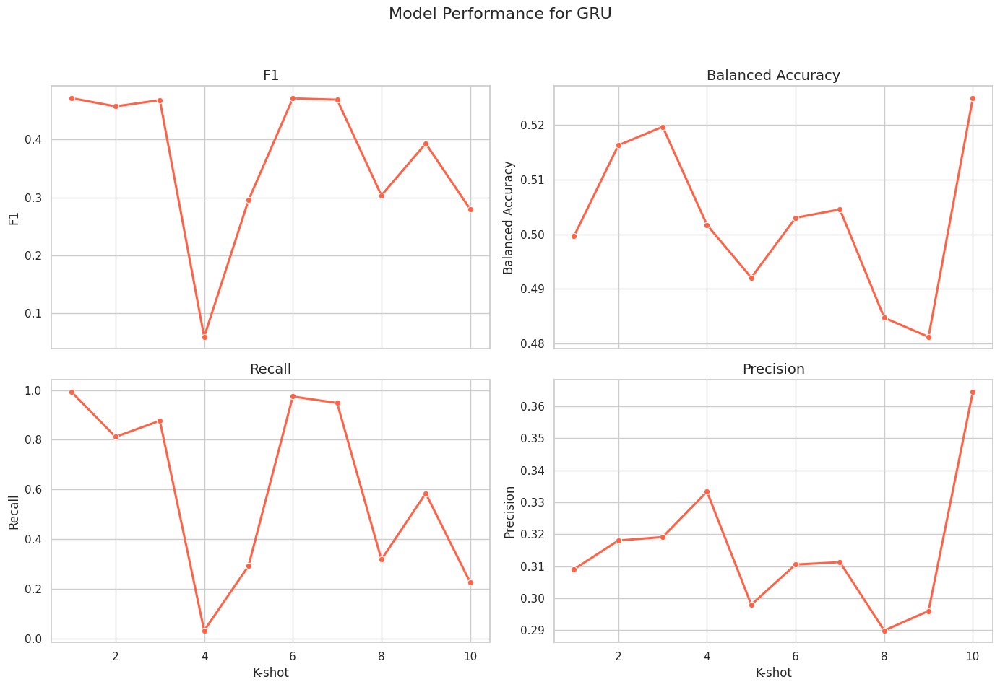

In [100]:
# Plot results
plot_model_performance(df, "GRU", "tomato")

Maximum values per metric:
Balanced Accuracy: 0.5250 (at K-shot = 10)
F1: 0.4715 (at K-shot = 1)
Recall: 0.9935 (at K-shot = 1)
Precision: 0.3646 (at K-shot = 10)


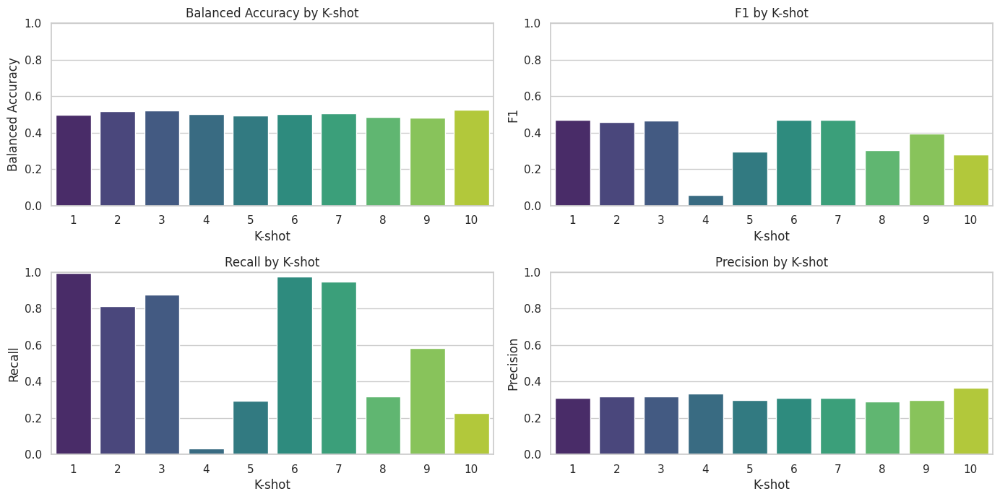

In [101]:
metrics = ["Balanced Accuracy", "F1", "Recall", "Precision"]

# Print max values for each metric
print("Maximum values per metric:")
for metric in metrics:
    max_val = df[metric].max()
    max_k = df.loc[df[metric].idxmax(), "K-shot"]
    print(f"{metric}: {max_val:.4f} (at K-shot = {max_k})")

# Then plot the histograms
plt.figure(figsize=(14, 10))

for i, metric in enumerate(metrics, 1):
    plt.subplot(3, 2, i)
    sns.barplot(x="K-shot", y=metric, data=df, palette="viridis")
    plt.title(f"{metric} by K-shot")
    plt.ylim(0, 1)
    plt.xlabel("K-shot")
    plt.ylabel(metric)

plt.tight_layout()
plt.show()

## **9. Bidirectional GRU + Glove + Bahdanau Attention + Weight Class**

In [102]:
def load_glove_embeddings(glove_path, word_to_index, embedding_dim):
    """
    Loads GloVe embeddings (.txt format) and returns an embedding matrix.

    Args:
        glove_path (str): Path to the GloVe .txt file (e.g., glove.6B.300d.txt).
        word_to_index (dict): Mapping from words to their index in the vocabulary.
        embedding_dim (int): Dimension of the embeddings (e.g., 300).

    Returns:
        torch.Tensor: Embedding matrix of shape (vocab_size, embedding_dim).
    """
    embedding_matrix = np.zeros((len(word_to_index), embedding_dim), dtype='float32')
    with open(glove_path, 'r', encoding="utf-8") as f:
        for line in f:
            values = line.strip().split()
            word = values[0]
            if word in word_to_index:
                vector = np.asarray(values[1:], dtype='float32')
                embedding_matrix[word_to_index[word]] = vector

    return torch.tensor(embedding_matrix, dtype=torch.float)

In [103]:
EMBEDDING_DIM = 300
embedding_matrix_glove = load_glove_embeddings('/content/drive/MyDrive/glove/glove.6B.300d.txt', word_to_index, EMBEDDING_DIM)

### **9.1 Optimization Phase**

#### **9.1.1 Optimizer selection**

In [104]:
# ======== Setup ========
num_epochs = 16
learning_rate = 1e-4  # Was 1e-5 — now increased
clip = 1.0  # gradient clipping max norm

# Compute class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

# Positive weight for BCEWithLogitsLoss
pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)  # FIXED

results = []

optimizers = {
    'Adam': optim.Adam,
    'RMSprop': optim.RMSprop,
    'AdamW': optim.AdamW
}

all_train_losses, all_val_losses = {}, {}
all_train_accs, all_val_accs = {}, {}

# ======== Loop through optimizers ========
for optimizer_name, optimizer_class in optimizers.items():
    print(f"\n🔹 Training with optimizer: {optimizer_name}")

    # Instantiate model
    model = GRU_BahdanauAttention(
        embedding_matrix=embedding_matrix_glove,
        hidden_dim=200,
        num_layers=1,
        dropout_prob=0.8
    ).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=learning_rate)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total trainable parameters: {num_params}")

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    # ======== Training loop ========
    for epoch in range(num_epochs):
        start_time = time.time()

        # Correct unpacking order
        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # FIXED

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        scheduler.step(f1)

        end_time = time.time()
        duration = end_time - start_time

        print(
            f"Opt: {optimizer_name} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "  # VL now correct
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {duration/60:.2f} min"
        )

    # Store metrics
    all_train_losses[optimizer_name] = train_losses
    all_val_losses[optimizer_name] = val_losses
    all_train_accs[optimizer_name] = train_accs
    all_val_accs[optimizer_name] = val_accs

    label = f"Batch={BATCH_SIZE} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with optimizer: Adam
GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 200, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=400, out_features=200, bias=True)
    (v): Linear(in_features=200, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.8, inplace=False)
  (fc): Linear(in_features=400, out_features=1, bias=True)
)
Total trainable parameters: 12943301
Opt: Adam | Epoch 1/16 - TL: 0.9746, VL: 0.9712, TA: 57.16%, VA: 65.51%, F1: 50.99%, Time: 0.08 min
Opt: Adam | Epoch 2/16 - TL: 0.8686, VL: 0.8881, TA: 69.57%, VA: 71.90%, F1: 59.33%, Time: 0.07 min
Opt: Adam | Epoch 3/16 - TL: 0.8024, VL: 0.8593, TA: 72.56%, VA: 72.24%, F1: 59.87%, Time: 0.08 min
Opt: Adam | Epoch 4/16 - TL: 0.7330, VL: 0.7788, TA: 75.40%, VA: 75.86%, F1: 64.22%, Time: 0.07 min
Opt: Adam | Epoch 5/16 - TL: 0.6422, VL: 0.7226, TA: 79.16%, VA: 76.37%, F1: 64.52%, Time: 0.07 min
Opt: 

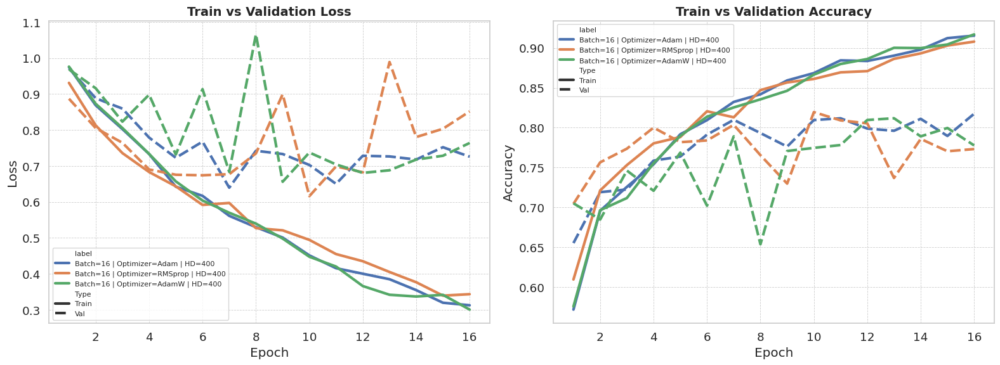

In [105]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **9.1.2 Learning rate value selection**

In [106]:
# Learning rate sweep configuration
learning_rates = [1e-4, 5e-5, 1e-5]
optimizer_name = 'Adam'
optimizer_class = optim.Adam
results = []
num_epochs = 16

# Class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)  # FIXED pos_weight

# Loop through learning rates
for lr in learning_rates:
    print(f"\n🔹 Training with {optimizer_name} optimizer, learning rate = {lr}")

    model = GRU_BahdanauAttention(
        embedding_matrix=embedding_matrix_glove,
        hidden_dim=400,
        num_layers=1,
        dropout_prob=0.5
    ).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # FIXED ORDER

        scheduler.step(f1)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"LR: {lr:.1e} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results
    label = f"LR={lr:.1e} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with Adam optimizer, learning rate = 0.0001
GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
LR: 1.0e-04 | Epoch 1/16 - TL: 0.9329, VL: 0.9036, TA: 65.25%, VA: 68.51%, F1: 55.19%, Time: 0.14 min
LR: 1.0e-04 | Epoch 2/16 - TL: 0.7669, VL: 1.3395, TA: 73.60%, VA: 65.60%, F1: 50.00%, Time: 0.14 min
LR: 1.0e-04 | Epoch 3/16 - TL: 0.7413, VL: 0.6976, TA: 74.23%, VA: 78.59%, F1: 66.31%, Time: 0.14 min
LR: 1.0e-04 | Epoch 4/16 - TL: 0.6318, VL: 1.2179, TA: 80.22%, VA: 60.59%, F1: 37.76%, Time: 0.14 min
LR: 1.0e-04 | Epoch 5/16 - TL: 0.5663, VL: 0.6462, TA: 82.31%, VA: 80.18%, F1: 69.25%, Time: 0.14 min
LR: 1.0e-

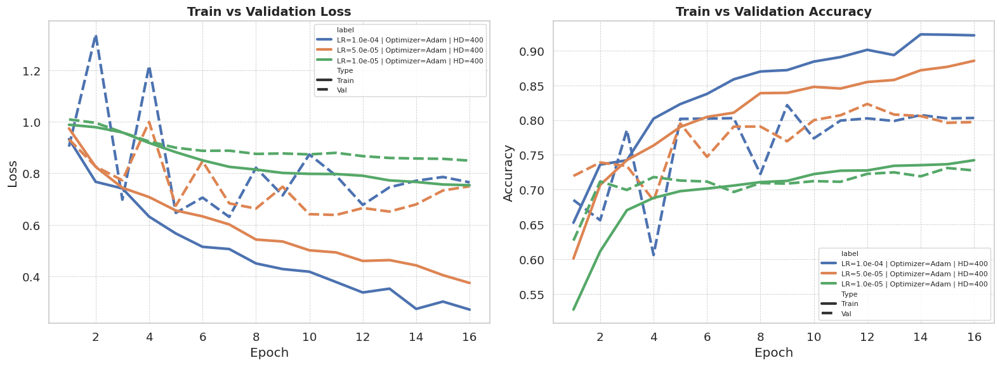

In [107]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting

sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **9.1.3 Batch size value selection**

In [108]:
# Batch size sweep configuration
batch_sizes = [8, 16, 64]
learning_rate = 2e-5
num_epochs = 16
results = []

# Compute class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop over different batch sizes
for batch_size in batch_sizes:
    print(f"\n🔹 Training with batch size: {batch_size}")

    # Create DataLoaders with the current batch size
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    # Instantiate GRU + Bahdanau Attention model
    model = GRU_BahdanauAttention(
        embedding_matrix=embedding_matrix_glove,
        hidden_dim=400,
        num_layers=1,
        dropout_prob=0.5
    ).to(device)

    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # <--- FIXED

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"BS: {batch_size} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results for later plotting
    label = f"LR={learning_rate:.1e} | Batch={batch_size} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with batch size: 8
BS: 8 | Epoch 1/16 - TL: 0.9787, VL: 0.9603, TA: 59.89%, VA: 69.77%, F1: 56.70%, Time: 0.21 min
BS: 8 | Epoch 2/16 - TL: 0.8863, VL: 0.8734, TA: 69.37%, VA: 67.81%, F1: 54.39%, Time: 0.21 min
BS: 8 | Epoch 3/16 - TL: 0.8191, VL: 0.8453, TA: 70.57%, VA: 70.20%, F1: 57.23%, Time: 0.21 min
BS: 8 | Epoch 4/16 - TL: 0.7889, VL: 0.7897, TA: 72.81%, VA: 74.55%, F1: 62.05%, Time: 0.21 min
BS: 8 | Epoch 5/16 - TL: 0.7711, VL: 1.0338, TA: 74.24%, VA: 69.79%, F1: 56.73%, Time: 0.21 min
BS: 8 | Epoch 6/16 - TL: 0.7585, VL: 0.7600, TA: 75.70%, VA: 74.69%, F1: 62.22%, Time: 0.21 min
BS: 8 | Epoch 7/16 - TL: 0.7245, VL: 0.7657, TA: 77.14%, VA: 75.08%, F1: 63.22%, Time: 0.21 min
BS: 8 | Epoch 8/16 - TL: 0.6854, VL: 0.9041, TA: 79.87%, VA: 69.58%, F1: 56.41%, Time: 0.21 min
BS: 8 | Epoch 9/16 - TL: 0.6830, VL: 0.7362, TA: 79.44%, VA: 76.29%, F1: 64.50%, Time: 0.21 min
BS: 8 | Epoch 10/16 - TL: 0.6917, VL: 0.8278, TA: 79.42%, VA: 73.7

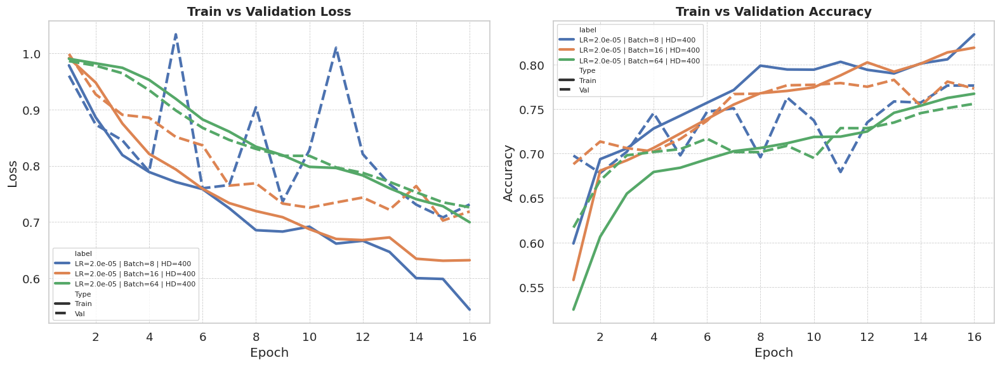

In [109]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **9.1.4 Dropout value selection**

In [110]:
# Hyperparameter sweep configuration
hidden_dims = [286]
dropouts = [0.1, 0.4, 0.8]
learning_rate = 1e-4
batch_size = 16
num_epochs = 16
results = []

# Compute class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for hidden_dim in hidden_dims:
    num_layers = 1  # fixed value for this sweep
    for dropout in dropouts:
        print(f"\n🔹 Training with hidden_dim={hidden_dim}, num_layers={num_layers}, dropout={dropout}")

        # Data loaders
        train_loader_hp = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        val_loader_hp = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

        # Instantiate GRU + Bahdanau Attention model with current parameters
        model = GRU_BahdanauAttention(
            embedding_matrix=embedding_matrix_glove,
            hidden_dim=hidden_dim,
            num_layers=num_layers,
            dropout_prob=dropout
        ).to(device)

        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        train_losses, val_losses = [], []
        train_accs, val_accs, val_f1s = [], [], []

        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
            val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # <--- FIXED

            train_losses.append(train_loss)
            val_losses.append(val_loss)
            train_accs.append(train_acc)
            val_accs.append(val_acc)
            val_f1s.append(f1)

            print(
                f"HD: {hidden_dim} | NL: {num_layers} | DP: {dropout} | Epoch {epoch+1}/{num_epochs} - "
                f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
                f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
                f"Time: {(time.time() - start_time)/60:.2f} min"
            )

        # Store results
        label = f"LR={learning_rate:.1e} | BS={batch_size} | HD={hidden_dim} | NL={num_layers} | DP={dropout}"
        for epoch in range(num_epochs):
            results.append({
                "epoch": epoch + 1,
                "label": label,
                "train_loss": train_losses[epoch],
                "val_loss": val_losses[epoch],
                "train_acc": train_accs[epoch],
                "val_acc": val_accs[epoch],
                "val_f1": val_f1s[epoch]
            })

Class weights: [0.69741587 1.76636225]

🔹 Training with hidden_dim=286, num_layers=1, dropout=0.1
HD: 286 | NL: 1 | DP: 0.1 | Epoch 1/16 - TL: 0.9767, VL: 0.9570, TA: 57.75%, VA: 67.33%, F1: 53.29%, Time: 0.06 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 2/16 - TL: 0.8913, VL: 0.8330, TA: 69.29%, VA: 70.52%, F1: 57.53%, Time: 0.06 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 3/16 - TL: 0.8045, VL: 0.7995, TA: 71.78%, VA: 70.55%, F1: 57.68%, Time: 0.06 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 4/16 - TL: 0.7568, VL: 0.7455, TA: 74.80%, VA: 74.03%, F1: 61.76%, Time: 0.06 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 5/16 - TL: 0.6762, VL: 0.7079, TA: 77.35%, VA: 75.99%, F1: 63.21%, Time: 0.06 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 6/16 - TL: 0.6217, VL: 0.6736, TA: 80.22%, VA: 78.80%, F1: 66.67%, Time: 0.06 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 7/16 - TL: 0.5921, VL: 0.6657, TA: 81.82%, VA: 80.97%, F1: 69.74%, Time: 0.06 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 8/16 - TL: 0.5362, VL: 0.6713, TA: 83.76%, VA: 80.18%, F

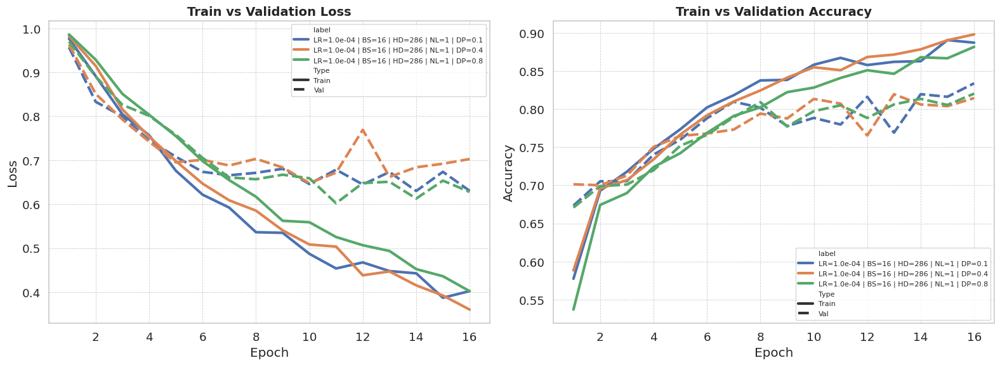

In [111]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

### **9.2 Test Phase**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

In [112]:
# --- Hyperparameters ---
HIDDEN_DIM = 286
DROPOUT = 0.8
NUM_LAYERS = 1
learning_rate = 1e-5
num_epochs = 50
patience = 4
best_model_path = "best_model2.pth"

# --- Model Instantiation ---
model = GRU_BahdanauAttention(
    embedding_matrix=embedding_matrix_glove,
    hidden_dim=HIDDEN_DIM,
    num_layers=NUM_LAYERS,
    dropout_prob=DROPOUT
).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# --- Compute Class Weights ---
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Tracking Variables ---
train_losses, test_losses = [], []
train_accuracies, test_accuracies = [], []
test_f1s, test_balanced_accs, test_recalls, test_precisions = [], [], [], []

best_test_bal_acc = 0
patience_counter = 0
best_model_state = None

# --- Scheduler ---
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-6
)

# --- Training with Early Stopping ---
with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as epoch_pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        # Training step
        train_loss, train_acc = train_epoch(model, combined_loader, optimizer, loss_function, device)

        # Evaluation step
        test_loss, test_acc, test_f1, test_balanced_acc, test_recall, test_precision = test_epoch(
            model, test_loader, loss_function, device
        )

        # Logging
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        test_losses.append(test_loss)
        test_balanced_accs.append(test_balanced_acc)
        test_f1s.append(test_f1)

        # Scheduler step
        scheduler.step(test_balanced_acc)

        epoch_duration = time.time() - start_time

        # --- Early Stopping Logic ---
        if test_balanced_acc > best_test_bal_acc:
            best_test_bal_acc = test_balanced_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
            torch.save(best_model_state, best_model_path)
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"\nEarly stopping at epoch {epoch + 1}.")
                break

        epoch_pbar.set_postfix({
            "Training Loss": f"{train_loss:.4f}",
            "Test Loss": f"{test_loss:.4f}",
            "Train Balanced Acc": f"{train_acc:.2%}",
            "Test Balanced Acc": f"{test_balanced_acc:.2%}",
            "Test F1": f"{test_f1:.2%}",
            "Test Precision": f"{test_precision:.2%}",
            "Test Recall": f"{test_recall:.2%}",
            "Time(min)": f"{epoch_duration / 60:.2f}"
        })
        epoch_pbar.update(1)

# --- Load Best Model ---
model.load_state_dict(torch.load(best_model_path))

Class weights: [0.69741587 1.76636225]


Training Progress:  18%|█▊        | 9/50 [01:40<07:38, 11.18s/epoch, Training Loss=0.8729, Test Loss=0.8724, Train Balanced Acc=70.12%, Test Balanced Acc=71.59%, Test F1=61.00%, Test Precision=49.59%, Test Recall=79.22%, Time(min)=0.11]


Early stopping at epoch 10.


<All keys matched successfully>

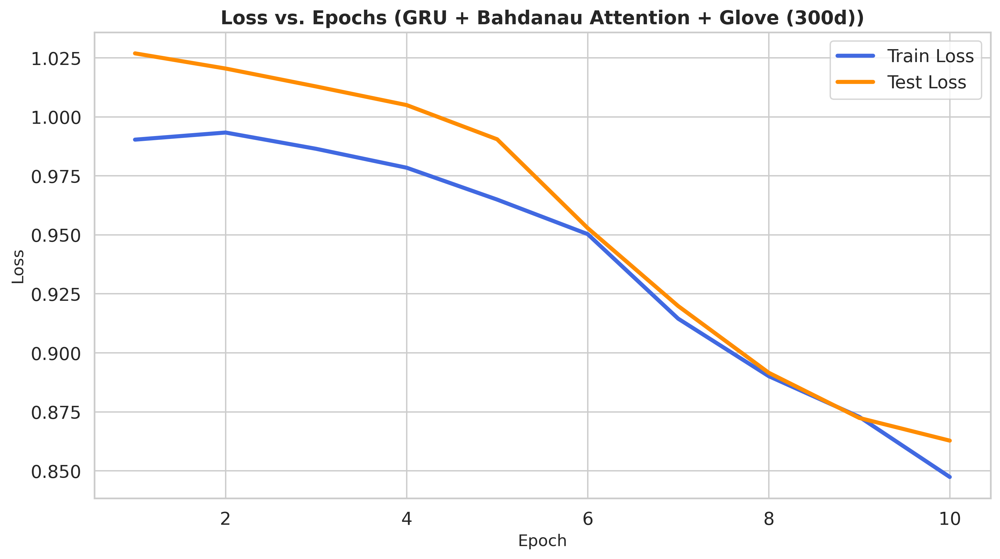

In [113]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=epochs, y=test_losses, label='Test Loss', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (GRU + Bahdanau Attention + Glove (300d))', fontsize=14, weight='bold')
plt.legend(loc='upper right', frameon=True)
plt.tight_layout()

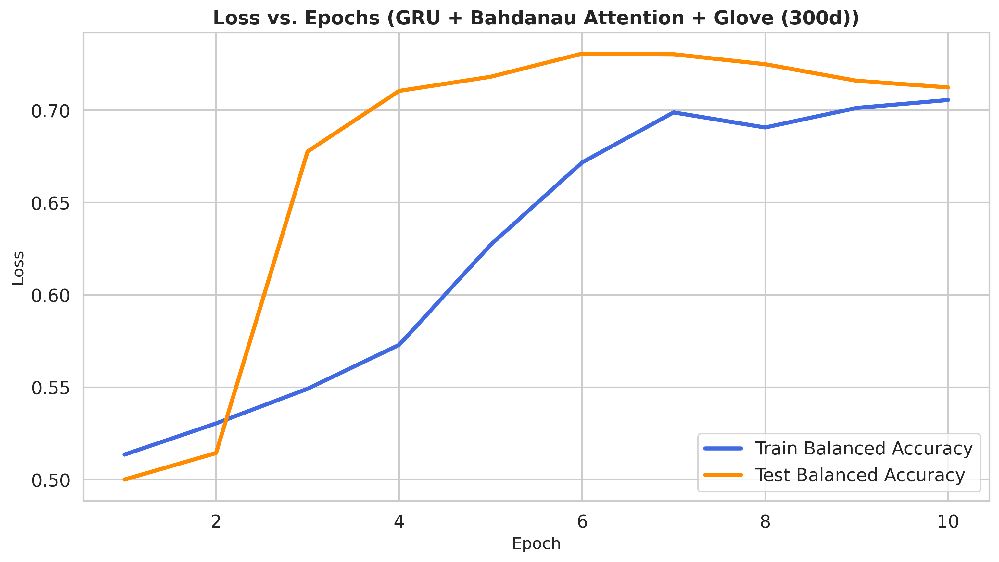

In [114]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 2. Balanced Accurcy Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_accuracies, label='Train Balanced Accuracy', color='royalblue')
sns.lineplot(x=epochs, y=test_balanced_accs, label='Test Balanced Accuracy', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (GRU + Bahdanau Attention + Glove (300d))', fontsize=14, weight='bold')
plt.legend(loc='lower right', frameon=True)
plt.tight_layout()

In [115]:
model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_glove,
                                  hidden_dim=HIDDEN_DIM,
                                  num_layers=NUM_LAYERS,
                                  dropout_prob=DROPOUT
                                ).to(device)

model.load_state_dict(torch.load("/content/best_model2.pth"))
model.eval()

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Recalculate metrics on test set ---
final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_epoch(
    model, test_loader, loss_function, device
)

# --- Print results ---
print("\n Final Evaluation Metrics of Best Model:")
print(f"Test Loss           : {final_test_loss:.4f}")
print(f"Test Accuracy       : {final_test_acc:.2%}")
print(f"Test F1 Score       : {final_test_f1:.2%}")
print(f"Balanced Accuracy   : {final_test_bal_acc:.2%}")
print(f"Test Precision      : {final_test_precision:.2%}")
print(f"Test Recall         : {final_test_recall:.2%}")

Class weights: [0.69741587 1.76636225]

 Final Evaluation Metrics of Best Model:
Test Loss           : 0.9529
Test Accuracy       : 68.47%
Test F1 Score       : 62.53%
Balanced Accuracy   : 73.06%
Test Precision      : 49.43%
Test Recall         : 85.06%


In [116]:
df_results, df_correct, df_wrong, all_labels, all_pred, all_probs = evaluate_and_analyze(model, test_loader, device)

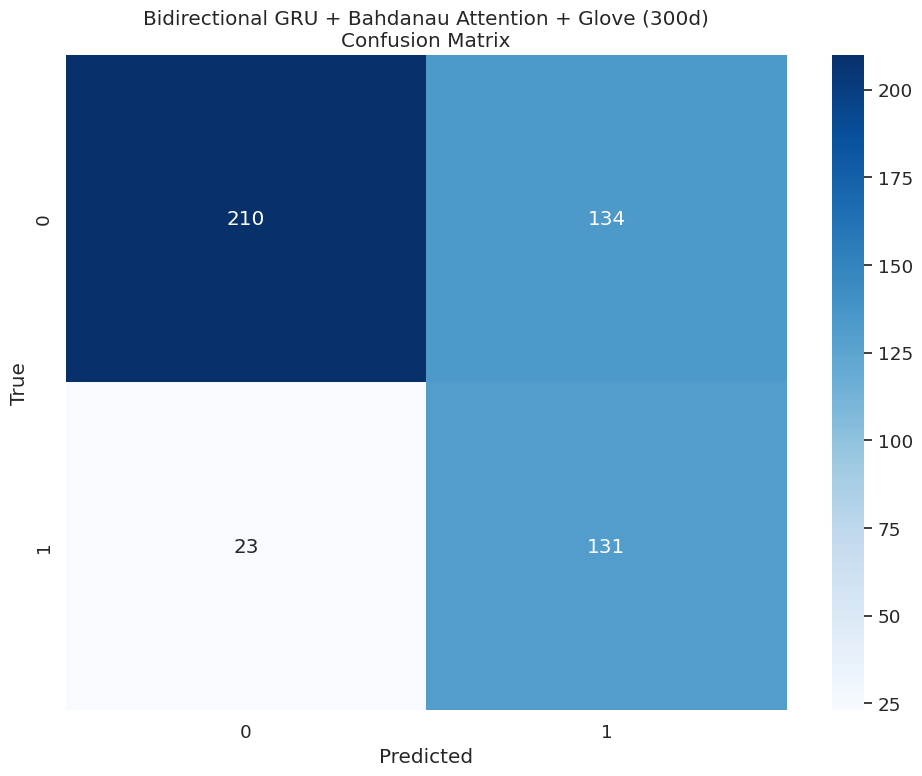

In [117]:
NUM_CLASSES = 2

fig, axes = plt.subplots(1, 1, figsize=(10, 8))

plot_confusion_matrix(axes, all_labels, all_pred)
axes.set_title("Bidirectional GRU + Bahdanau Attention + Glove (300d)\nConfusion Matrix")

plt.tight_layout()
plt.show()

In [118]:
from sklearn.metrics import roc_curve, auc

y_true = np.array(all_labels)
y_scores = np.array(all_probs)

fpr, tpr, _ = roc_curve(y_true , y_scores)
roc_auc = auc(fpr, tpr)

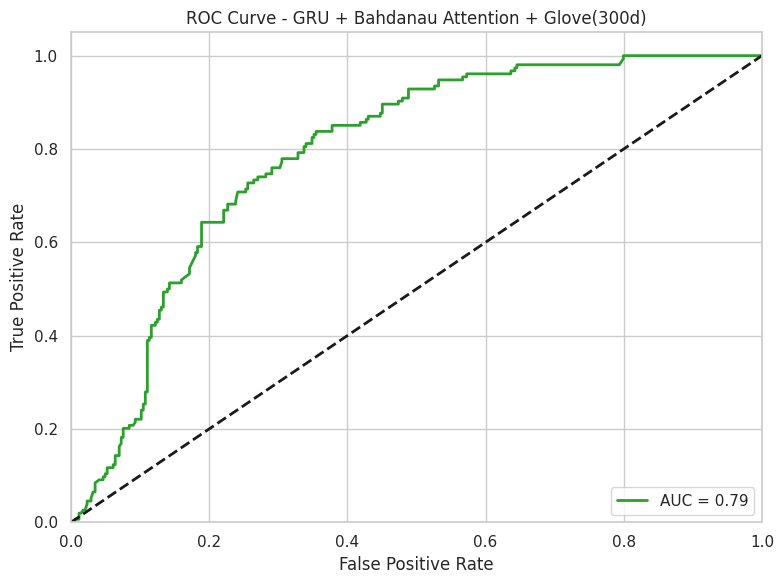

In [119]:
sns.set(style="whitegrid")

# One plot only
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

ax.plot(fpr, tpr, lw=2,
        label=f'AUC = {roc_auc:.2f}', color='tab:green')
ax.plot([0, 1], [0, 1], 'k--', lw=2)
ax.set_xlim([0.0, 1.0])
ax.set_ylim([0.0, 1.05])
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_title('ROC Curve - GRU + Bahdanau Attention + Glove(300d)')
ax.legend(loc='lower right')
ax.grid(True)

plt.tight_layout()
plt.show()

### **9.3 Few-Shot Learning**

In [120]:
k_values = range(1, 11)  # Few-shot from k=1 to 10
NUM_CLASSES = 2
HIDDEN_DIM = 286
DROPOUT = 0.7

X_combined = np.concatenate((X_train, X_val), axis=0)
y_combined = np.concatenate((y_train, y_val), axis=0)
X_combined_tensor = torch.cat((X_train_tensor, X_val_tensor), dim=0)
y_combined_tensor = torch.cat((y_train_tensor, y_val_tensor), dim=0)

model_metrics = {
    "K-shot": [],
    "Model": [],
    "Test Accuracy": [],
    "F1": [],
    "Balanced Accuracy": [],
    "Recall": [],
    "Precision": []
}

patience = 5
num_epochs = 50
for k in k_values:
    print(f"\n--- K-Shot = {k} ---")

    X_few, y_few = get_few_shot_subset(X_combined_tensor, y_combined_tensor, k_shot=k)
    few_shot_dataset = TextDataset(X_few, y_few, raw_text_data=X_combined)
    few_shot_loader = DataLoader(few_shot_dataset, batch_size=batch_size, shuffle=True, collate_fn=custom_collate_fn)

    model = GRU_BahdanauAttention(
                embedding_matrix=embedding_matrix_fasttext,
                hidden_dim=HIDDEN_DIM,
                num_layers=NUM_LAYERS,
                dropout_prob=DROPOUT
            ).to(device)
    print(f"{count_parameters(model)} model parameters")
    print()
    print(model)

    learning_rate = 2e-5
    optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)

    class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
    print(f"Class weights: {class_weights}")

    pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
    loss_function = torch.nn.BCEWithLogitsLoss(pos_weight)

    # Train with early stopping
    best_val_acc = 0
    patience_counter = 0
    for epoch in range(num_epochs):
        train_loss, train_acc = train_epoch(model, few_shot_loader, optimizer, loss_function, device)
        val_acc, val_f1, val_loss = evaluate_epoch(model, test_loader, loss_function, device)

        print(f"K={k} | Epoch {epoch+1}/{num_epochs} "
              f"- Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, "
              f"Test Loss: {val_loss:.4f}, Test Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                break

    # Load best model
    model.load_state_dict(best_model_state)

    # Evaluate on test set
    avg_loss, avg_accuracy, f1, balanced_acc, recall, precision = test_epoch(model, test_loader, loss_function, device)

    # Log metrics
    print(f"Test Accuracy: {avg_accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"Balanced Accuracy: {balanced_acc:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"Precision: {precision:.4f}")

    model_metrics["K-shot"].append(k)
    model_metrics["Model"].append("GRU-Bah-Glove")
    model_metrics["Test Accuracy"].append(avg_accuracy)
    model_metrics["F1"].append(f1)
    model_metrics["Balanced Accuracy"].append(balanced_acc)
    model_metrics["Recall"].append(recall)
    model_metrics["Precision"].append(precision)

# Convert results to DataFrame
df = pd.DataFrame(model_metrics)


--- K-Shot = 1 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_features=286, bias=True)
    (v): Linear(in_features=286, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.7, inplace=False)
  (fc): Linear(in_features=572, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=1 | Epoch 1/50 - Train Loss: 1.7520, Train Acc: 0.5000, Test Loss: 0.4738, Test Acc: 1.7620, Val F1: 0.5029
K=1 | Epoch 2/50 - Train Loss: 1.8233, Train Acc: 0.0000, Test Loss: 0.4731, Test Acc: 1.7626, Val F1: 0.5015
K=1 | Epoch 3/50 - Train Loss: 1.7101, Train Acc: 1.0000, Test Loss: 0.4731, Test Acc: 1.7615, Val F1: 0.5015
K=1 | Epoch 4/50 - Train Loss: 1.7831, Train Acc: 0.0000, Test Loss: 0.4731, Test Acc: 1.7611, Val F1: 0.5015
K=1 | Epoch 5/50 - Train Loss: 1.7299, Train Acc: 1.0000, Test Loss: 0.4731, Test Acc: 1.7613, Val F1: 0.5015
K=1 | Epoch 6/50 - Train Loss: 1.7376, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7615, Val F1: 0.5000
K=1 | Epoch 7/50 - Train Loss: 1.7065, Train Acc: 1.0000, Test Loss: 0.4724, Test Acc: 1.7612, Val F1: 0.5000
Test Accuracy: 0.3112
F1 Score: 0.4731
Balanced Accuracy: 0.5015
Recall: 1.0000
Precision: 0.3099

--- K-Shot = 2 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, ba

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=2 | Epoch 1/50 - Train Loss: 1.7889, Train Acc: 0.2500, Test Loss: 0.0809, Test Acc: 1.7484, Val F1: 0.5053
K=2 | Epoch 2/50 - Train Loss: 1.7441, Train Acc: 0.5000, Test Loss: 0.1333, Test Acc: 1.7487, Val F1: 0.5015
K=2 | Epoch 3/50 - Train Loss: 1.7804, Train Acc: 0.0000, Test Loss: 0.1683, Test Acc: 1.7489, Val F1: 0.5101
K=2 | Epoch 4/50 - Train Loss: 1.7346, Train Acc: 0.5000, Test Loss: 0.1751, Test Acc: 1.7487, Val F1: 0.4977
K=2 | Epoch 5/50 - Train Loss: 1.7644, Train Acc: 0.2500, Test Loss: 0.1835, Test Acc: 1.7488, Val F1: 0.5010
K=2 | Epoch 6/50 - Train Loss: 1.7687, Train Acc: 0.5000, Test Loss: 0.2318, Test Acc: 1.7498, Val F1: 0.5121
K=2 | Epoch 7/50 - Train Loss: 1.7481, Train Acc: 0.7500, Test Loss: 0.2308, Test Acc: 1.7500, Val F1: 0.5106
K=2 | Epoch 8/50 - Train Loss: 1.7698, Train Acc: 0.5000, Test Loss: 0.2510, Test Acc: 1.7501, Val F1: 0.5175
K=2 | Epoch 9/50 - Train Loss: 1.7182, Train Acc: 0.5000, Test Loss: 0.2439, Test Acc: 1.7506, Val F1: 0.5073
K=2 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=3 | Epoch 1/50 - Train Loss: 1.7555, Train Acc: 0.3333, Test Loss: 0.4724, Test Acc: 1.7648, Val F1: 0.5000
K=3 | Epoch 2/50 - Train Loss: 1.7679, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7655, Val F1: 0.5000
K=3 | Epoch 3/50 - Train Loss: 1.7414, Train Acc: 0.8333, Test Loss: 0.4724, Test Acc: 1.7657, Val F1: 0.5000
K=3 | Epoch 4/50 - Train Loss: 1.7801, Train Acc: 0.0000, Test Loss: 0.4724, Test Acc: 1.7655, Val F1: 0.5000
K=3 | Epoch 5/50 - Train Loss: 1.7438, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7657, Val F1: 0.5000
K=3 | Epoch 6/50 - Train Loss: 1.7054, Train Acc: 0.6667, Test Loss: 0.4724, Test Acc: 1.7663, Val F1: 0.5000
K=3 | Epoch 7/50 - Train Loss: 1.7641, Train Acc: 0.1667, Test Loss: 0.4724, Test Acc: 1.7662, Val F1: 0.5000
K=3 | Epoch 8/50 - Train Loss: 1.7513, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7666, Val F1: 0.5000
K=3 | Epoch 9/50 - Train Loss: 1.7361, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7669, Val F1: 0.5000
K=3 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=4 | Epoch 1/50 - Train Loss: 1.7527, Train Acc: 0.5000, Test Loss: 0.4376, Test Acc: 1.7568, Val F1: 0.4888
K=4 | Epoch 2/50 - Train Loss: 1.7298, Train Acc: 0.7500, Test Loss: 0.4231, Test Acc: 1.7561, Val F1: 0.4850
K=4 | Epoch 3/50 - Train Loss: 1.7570, Train Acc: 0.6250, Test Loss: 0.4126, Test Acc: 1.7561, Val F1: 0.4775
K=4 | Epoch 4/50 - Train Loss: 1.7300, Train Acc: 0.7500, Test Loss: 0.4366, Test Acc: 1.7564, Val F1: 0.5046
K=4 | Epoch 5/50 - Train Loss: 1.7477, Train Acc: 0.5000, Test Loss: 0.4336, Test Acc: 1.7564, Val F1: 0.5014
K=4 | Epoch 6/50 - Train Loss: 1.7934, Train Acc: 0.2500, Test Loss: 0.4508, Test Acc: 1.7566, Val F1: 0.5157
Test Accuracy: 0.3755
F1 Score: 0.4376
Balanced Accuracy: 0.4888
Recall: 0.7857
Precision: 0.3033

--- K-Shot = 5 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_fea

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=5 | Epoch 1/50 - Train Loss: 1.7462, Train Acc: 0.4000, Test Loss: 0.0000, Test Acc: 1.7283, Val F1: 0.5000
K=5 | Epoch 2/50 - Train Loss: 1.7500, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7296, Val F1: 0.5000
K=5 | Epoch 3/50 - Train Loss: 1.7757, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7307, Val F1: 0.5000
K=5 | Epoch 4/50 - Train Loss: 1.7368, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7316, Val F1: 0.5000
K=5 | Epoch 5/50 - Train Loss: 1.7389, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7323, Val F1: 0.5000
K=5 | Epoch 6/50 - Train Loss: 1.7580, Train Acc: 0.6000, Test Loss: 0.0000, Test Acc: 1.7325, Val F1: 0.5000
K=5 | Epoch 7/50 - Train Loss: 1.7695, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7330, Val F1: 0.5000
K=5 | Epoch 8/50 - Train Loss: 1.7705, Train Acc: 0.4000, Test Loss: 0.0000, Test Acc: 1.7337, Val F1: 0.5000
K=5 | Epoch 9/50 - Train Loss: 1.7492, Train Acc: 0.4000, Test Loss: 0.0000, Test Acc: 1.7341, Val F1: 0.5000
K=5 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=6 | Epoch 1/50 - Train Loss: 1.7368, Train Acc: 0.5833, Test Loss: 0.0000, Test Acc: 1.7467, Val F1: 0.5000
K=6 | Epoch 2/50 - Train Loss: 1.7615, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7479, Val F1: 0.5000
K=6 | Epoch 3/50 - Train Loss: 1.7476, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7480, Val F1: 0.5000
K=6 | Epoch 4/50 - Train Loss: 1.7453, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7487, Val F1: 0.5000
K=6 | Epoch 5/50 - Train Loss: 1.7381, Train Acc: 0.6667, Test Loss: 0.0375, Test Acc: 1.7494, Val F1: 0.5054
K=6 | Epoch 6/50 - Train Loss: 1.7688, Train Acc: 0.3333, Test Loss: 0.0914, Test Acc: 1.7497, Val F1: 0.5071
K=6 | Epoch 7/50 - Train Loss: 1.7444, Train Acc: 0.6667, Test Loss: 0.0909, Test Acc: 1.7498, Val F1: 0.5056
K=6 | Epoch 8/50 - Train Loss: 1.7697, Train Acc: 0.5000, Test Loss: 0.1164, Test Acc: 1.7502, Val F1: 0.5008
K=6 | Epoch 9/50 - Train Loss: 1.7240, Train Acc: 0.9167, Test Loss: 0.1231, Test Acc: 1.7503, Val F1: 0.4968
K=6 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=7 | Epoch 1/50 - Train Loss: 1.7594, Train Acc: 0.4286, Test Loss: 0.0000, Test Acc: 1.7486, Val F1: 0.5000
K=7 | Epoch 2/50 - Train Loss: 1.7592, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7490, Val F1: 0.5000
K=7 | Epoch 3/50 - Train Loss: 1.7794, Train Acc: 0.3571, Test Loss: 0.0000, Test Acc: 1.7486, Val F1: 0.5000
K=7 | Epoch 4/50 - Train Loss: 1.7550, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7484, Val F1: 0.5000
K=7 | Epoch 5/50 - Train Loss: 1.7311, Train Acc: 0.6429, Test Loss: 0.0000, Test Acc: 1.7480, Val F1: 0.5000
K=7 | Epoch 6/50 - Train Loss: 1.7745, Train Acc: 0.3571, Test Loss: 0.0000, Test Acc: 1.7483, Val F1: 0.5000
K=7 | Epoch 7/50 - Train Loss: 1.7333, Train Acc: 0.7143, Test Loss: 0.0127, Test Acc: 1.7480, Val F1: 0.5003
Test Accuracy: 0.6908
F1 Score: 0.0000
Balanced Accuracy: 0.5000
Recall: 0.0000
Precision: 0.0000

--- K-Shot = 8 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, ba

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=8 | Epoch 1/50 - Train Loss: 1.7458, Train Acc: 0.5625, Test Loss: 0.0000, Test Acc: 1.7501, Val F1: 0.5000
K=8 | Epoch 2/50 - Train Loss: 1.7388, Train Acc: 0.5625, Test Loss: 0.0000, Test Acc: 1.7502, Val F1: 0.5000
K=8 | Epoch 3/50 - Train Loss: 1.7445, Train Acc: 0.5625, Test Loss: 0.0000, Test Acc: 1.7501, Val F1: 0.5000
K=8 | Epoch 4/50 - Train Loss: 1.7502, Train Acc: 0.4375, Test Loss: 0.0000, Test Acc: 1.7506, Val F1: 0.4985
K=8 | Epoch 5/50 - Train Loss: 1.7518, Train Acc: 0.5625, Test Loss: 0.0000, Test Acc: 1.7508, Val F1: 0.4985
K=8 | Epoch 6/50 - Train Loss: 1.7521, Train Acc: 0.5625, Test Loss: 0.0000, Test Acc: 1.7508, Val F1: 0.4971
K=8 | Epoch 7/50 - Train Loss: 1.7435, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7511, Val F1: 0.4971
K=8 | Epoch 8/50 - Train Loss: 1.7488, Train Acc: 0.6250, Test Loss: 0.0000, Test Acc: 1.7511, Val F1: 0.4971
K=8 | Epoch 9/50 - Train Loss: 1.7531, Train Acc: 0.5625, Test Loss: 0.0000, Test Acc: 1.7510, Val F1: 0.4956
K=8 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=9 | Epoch 1/50 - Train Loss: 1.7664, Train Acc: 0.4444, Test Loss: 0.0000, Test Acc: 1.7358, Val F1: 0.5000
K=9 | Epoch 2/50 - Train Loss: 1.7906, Train Acc: 0.5556, Test Loss: 0.0000, Test Acc: 1.7390, Val F1: 0.5000
K=9 | Epoch 3/50 - Train Loss: 1.7365, Train Acc: 0.6111, Test Loss: 0.0000, Test Acc: 1.7387, Val F1: 0.5000
K=9 | Epoch 4/50 - Train Loss: 1.7066, Train Acc: 0.5556, Test Loss: 0.0000, Test Acc: 1.7364, Val F1: 0.5000
K=9 | Epoch 5/50 - Train Loss: 1.7276, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7343, Val F1: 0.5000
K=9 | Epoch 6/50 - Train Loss: 1.8017, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7357, Val F1: 0.5000
K=9 | Epoch 7/50 - Train Loss: 1.7248, Train Acc: 0.5556, Test Loss: 0.0000, Test Acc: 1.7339, Val F1: 0.5000
Test Accuracy: 0.6908
F1 Score: 0.0000
Balanced Accuracy: 0.5000
Recall: 0.0000
Precision: 0.0000

--- K-Shot = 10 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, b

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=10 | Epoch 1/50 - Train Loss: 1.7483, Train Acc: 0.5500, Test Loss: 0.4724, Test Acc: 1.7700, Val F1: 0.5000
K=10 | Epoch 2/50 - Train Loss: 1.7556, Train Acc: 0.4500, Test Loss: 0.4724, Test Acc: 1.7676, Val F1: 0.5000
K=10 | Epoch 3/50 - Train Loss: 1.7249, Train Acc: 0.7500, Test Loss: 0.4724, Test Acc: 1.7652, Val F1: 0.5000
K=10 | Epoch 4/50 - Train Loss: 1.7910, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7632, Val F1: 0.5000
K=10 | Epoch 5/50 - Train Loss: 1.7289, Train Acc: 0.5500, Test Loss: 0.4724, Test Acc: 1.7642, Val F1: 0.5000
K=10 | Epoch 6/50 - Train Loss: 1.7366, Train Acc: 0.5500, Test Loss: 0.4731, Test Acc: 1.7635, Val F1: 0.5015
Test Accuracy: 0.3092
F1 Score: 0.4724
Balanced Accuracy: 0.5000
Recall: 1.0000
Precision: 0.3092


In [ ]:
# --- Plotting ---
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
palette = sns.color_palette("Set2")

def plot_model_performance(df, model_name, color, title_prefix="Model Performance"):
    model_df = df[df["Model"] == model_name]
    metrics_to_plot = ["F1", "Balanced Accuracy", "Recall", "Precision"]

    fig, axes = plt.subplots(2, 2, figsize=(14, 10), sharex=True)
    axes = axes.flatten()

    for i, metric in enumerate(metrics_to_plot):
        sns.lineplot(
            data=model_df,
            x="K-shot",
            y=metric,
            ax=axes[i],
            color=color,
            marker="o",
            linewidth=2.2,
            markersize=6,
        )
        axes[i].set_title(metric, fontsize=14)
        axes[i].set_xlabel("K-shot")
        axes[i].set_ylabel(metric)
        axes[i].grid(True)

    plt.suptitle(f"{title_prefix} for {model_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

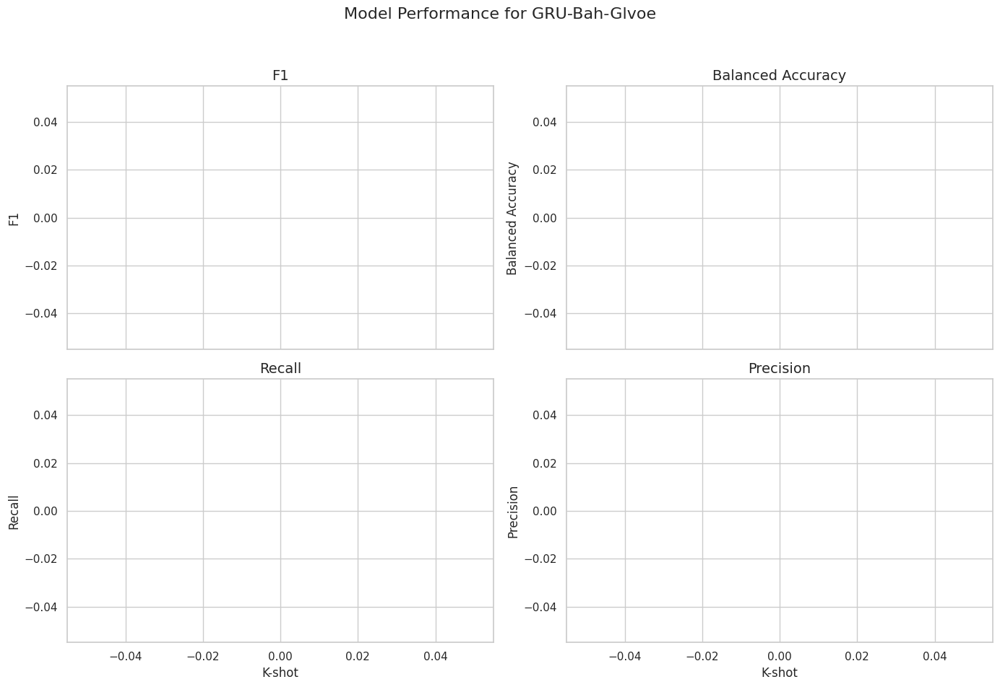

In [121]:
# Plot results
plot_model_performance(df, "GRU-Bah-Glvoe", "tomato")

Maximum values per metric:
Balanced Accuracy: 0.6238 (at K-shot = 6)
F1: 0.5090 (at K-shot = 6)
Recall: 1.0000 (at K-shot = 1)
Precision: 0.4213 (at K-shot = 6)


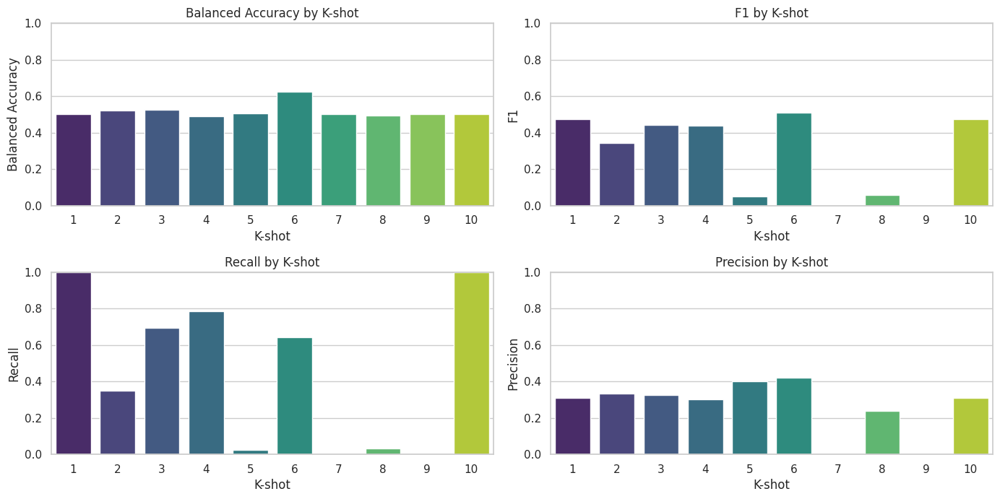

In [122]:
metrics = ["Balanced Accuracy", "F1", "Recall", "Precision"]

# Print max values for each metric
print("Maximum values per metric:")
for metric in metrics:
    max_val = df[metric].max()
    max_k = df.loc[df[metric].idxmax(), "K-shot"]
    print(f"{metric}: {max_val:.4f} (at K-shot = {max_k})")

# Then plot the histograms
plt.figure(figsize=(14, 10))

for i, metric in enumerate(metrics, 1):
    plt.subplot(3, 2, i)
    sns.barplot(x="K-shot", y=metric, data=df, palette="viridis")
    plt.title(f"{metric} by K-shot")
    plt.ylim(0, 1)
    plt.xlabel("K-shot")
    plt.ylabel(metric)

plt.tight_layout()
plt.show()

## **10. Bidirectional LSTM + Glove + Bahdanau Attention + Weight Class**

### **10.1 Optimization Phase**

#### **10.1.1 Optimizer selection**

In [123]:
# ======== Setup ========
num_epochs = 16
learning_rate = 1e-4  # Was 1e-5 — now increased
clip = 1.0  # gradient clipping max norm

# Compute class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

# Positive weight for BCEWithLogitsLoss
pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)  # FIXED

results = []

optimizers = {
    'Adam': optim.Adam,
    'RMSprop': optim.RMSprop,
    'AdamW': optim.AdamW
}

all_train_losses, all_val_losses = {}, {}
all_train_accs, all_val_accs = {}, {}

# ======== Loop through optimizers ========
for optimizer_name, optimizer_class in optimizers.items():
    print(f"\n🔹 Training with optimizer: {optimizer_name}")

    # Instantiate model
    model = LSTM_BahdanauAttention(
        embedding_matrix=embedding_matrix_glove,
        hidden_dim=200,
        num_layers=1,
        dropout_prob=0.8
    ).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=learning_rate)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total trainable parameters: {num_params}")

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    # ======== Training loop ========
    for epoch in range(num_epochs):
        start_time = time.time()

        # Correct unpacking order
        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # FIXED

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        scheduler.step(f1)

        end_time = time.time()
        duration = end_time - start_time

        print(
            f"Opt: {optimizer_name} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "  # VL now correct
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {duration/60:.2f} min"
        )

    # Store metrics
    all_train_losses[optimizer_name] = train_losses
    all_val_losses[optimizer_name] = val_losses
    all_train_accs[optimizer_name] = train_accs
    all_val_accs[optimizer_name] = val_accs

    label = f"Batch={BATCH_SIZE} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with optimizer: Adam
LSTM_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 200, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=400, out_features=200, bias=True)
    (v): Linear(in_features=200, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.8, inplace=False)
  (fc): Linear(in_features=400, out_features=1, bias=True)
)
Total trainable parameters: 13144101
Opt: Adam | Epoch 1/16 - TL: 0.9930, VL: 0.9842, TA: 53.36%, VA: 67.19%, F1: 54.62%, Time: 0.05 min
Opt: Adam | Epoch 2/16 - TL: 0.9779, VL: 0.9697, TA: 61.66%, VA: 68.25%, F1: 55.27%, Time: 0.05 min
Opt: Adam | Epoch 3/16 - TL: 0.9480, VL: 0.9023, TA: 67.35%, VA: 71.78%, F1: 58.63%, Time: 0.05 min
Opt: Adam | Epoch 4/16 - TL: 0.8291, VL: 0.7919, TA: 71.07%, VA: 72.00%, F1: 59.22%, Time: 0.05 min
Opt: Adam | Epoch 5/16 - TL: 0.7272, VL: 0.7301, TA: 75.85%, VA: 75.14%, F1: 62.34%, Time: 0.05 min
Op

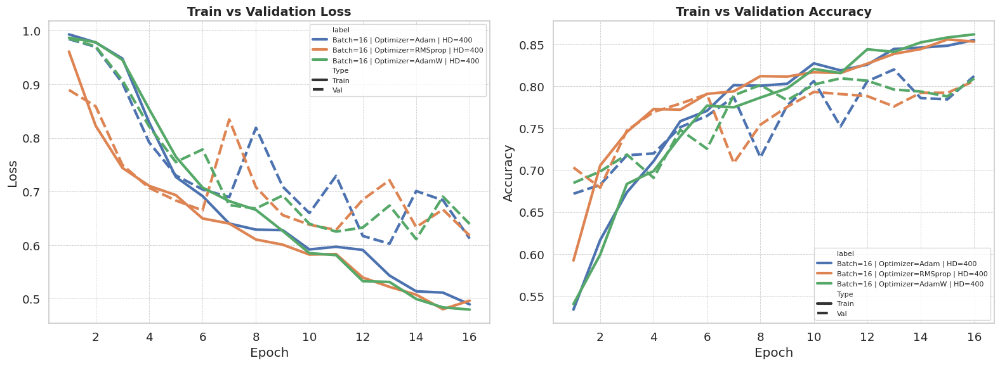

In [124]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **10.1.2 Learning rate value selection**

In [125]:
# Learning rate sweep configuration
learning_rates = [1e-4, 5e-5, 1e-5]
optimizer_name = 'Adam'
optimizer_class = optim.Adam
results = []
num_epochs = 16

# Class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)  # FIXED pos_weight

# Loop through learning rates
for lr in learning_rates:
    print(f"\n🔹 Training with {optimizer_name} optimizer, learning rate = {lr}")

    model = LSTM_BahdanauAttention(
        embedding_matrix=embedding_matrix_glove,
        hidden_dim=400,
        num_layers=1,
        dropout_prob=0.5
    ).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # FIXED ORDER

        scheduler.step(f1)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"LR: {lr:.1e} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results
    label = f"LR={lr:.1e} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with Adam optimizer, learning rate = 0.0001
LSTM_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
LR: 1.0e-04 | Epoch 1/16 - TL: 0.9831, VL: 0.9738, TA: 57.04%, VA: 66.78%, F1: 53.48%, Time: 0.12 min
LR: 1.0e-04 | Epoch 2/16 - TL: 0.9198, VL: 0.8525, TA: 68.31%, VA: 71.19%, F1: 58.15%, Time: 0.11 min
LR: 1.0e-04 | Epoch 3/16 - TL: 0.7987, VL: 0.9718, TA: 72.17%, VA: 68.04%, F1: 54.30%, Time: 0.11 min
LR: 1.0e-04 | Epoch 4/16 - TL: 0.7999, VL: 0.7379, TA: 72.43%, VA: 75.05%, F1: 62.50%, Time: 0.11 min
LR: 1.0e-04 | Epoch 5/16 - TL: 0.7015, VL: 0.7883, TA: 76.48%, VA: 70.46%, F1: 57.62%, Time: 0.11 min
LR: 1.

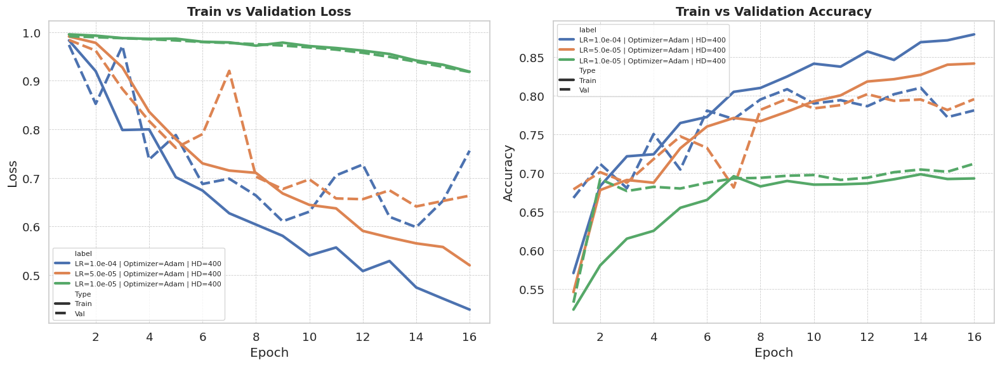

In [126]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **10.1.3 Batch size value selection**

In [127]:
# Batch size sweep configuration
batch_sizes = [8, 16, 64]
learning_rate = 2e-5
num_epochs = 16
results = []

# Compute class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop over different batch sizes
for batch_size in batch_sizes:
    print(f"\n🔹 Training with batch size: {batch_size}")

    # Create DataLoaders with the current batch size
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    # Instantiate GRU + Bahdanau Attention model
    model = LSTM_BahdanauAttention(
        embedding_matrix=embedding_matrix_glove,
        hidden_dim=400,
        num_layers=1,
        dropout_prob=0.5
    ).to(device)

    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # <--- FIXED

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"BS: {batch_size} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results for later plotting
    label = f"LR={learning_rate:.1e} | Batch={batch_size} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with batch size: 8
BS: 8 | Epoch 1/16 - TL: 0.9865, VL: 0.9862, TA: 58.58%, VA: 67.31%, F1: 54.66%, Time: 0.29 min
BS: 8 | Epoch 2/16 - TL: 0.9105, VL: 0.8635, TA: 69.60%, VA: 69.32%, F1: 56.22%, Time: 0.29 min
BS: 8 | Epoch 3/16 - TL: 0.8304, VL: 0.8599, TA: 70.04%, VA: 73.82%, F1: 61.54%, Time: 0.29 min
BS: 8 | Epoch 4/16 - TL: 0.8249, VL: 0.8609, TA: 71.67%, VA: 72.39%, F1: 60.00%, Time: 0.29 min
BS: 8 | Epoch 5/16 - TL: 0.7721, VL: 0.8134, TA: 73.45%, VA: 73.18%, F1: 60.77%, Time: 0.29 min
BS: 8 | Epoch 6/16 - TL: 0.7427, VL: 0.9365, TA: 75.86%, VA: 71.22%, F1: 58.74%, Time: 0.29 min
BS: 8 | Epoch 7/16 - TL: 0.7532, VL: 0.8776, TA: 73.39%, VA: 74.16%, F1: 62.15%, Time: 0.29 min
BS: 8 | Epoch 8/16 - TL: 0.7206, VL: 0.8064, TA: 76.88%, VA: 75.66%, F1: 63.72%, Time: 0.29 min
BS: 8 | Epoch 9/16 - TL: 0.6888, VL: 0.9433, TA: 77.56%, VA: 71.21%, F1: 58.78%, Time: 0.29 min
BS: 8 | Epoch 10/16 - TL: 0.6917, VL: 0.7537, TA: 76.98%, VA: 75.6

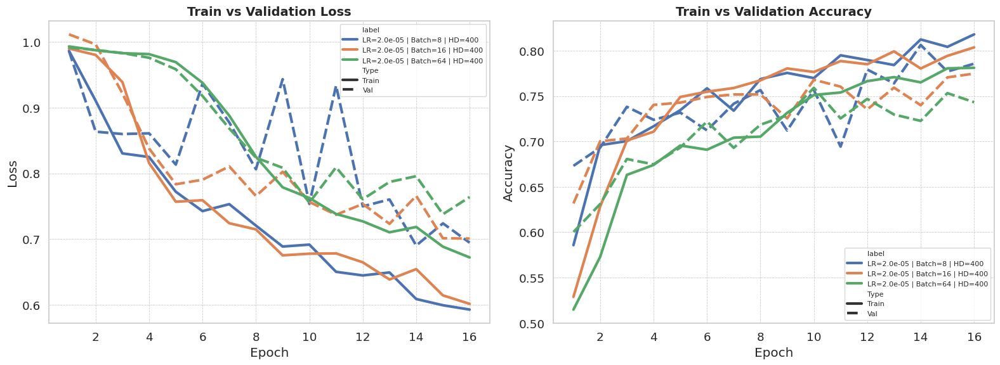

In [128]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **10.1.4 Dropout value selection**

In [129]:
# Hyperparameter sweep configuration
hidden_dims = [286]
dropouts = [0.1, 0.4, 0.8]
learning_rate = 1e-4
batch_size = 16
num_epochs = 16
results = []

# Compute class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for hidden_dim in hidden_dims:
    num_layers = 1  # fixed value for this sweep
    for dropout in dropouts:
        print(f"\n🔹 Training with hidden_dim={hidden_dim}, num_layers={num_layers}, dropout={dropout}")

        # Data loaders
        train_loader_hp = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        val_loader_hp = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

        # Instantiate GRU + Bahdanau Attention model with current parameters
        model = LSTM_BahdanauAttention(
            embedding_matrix=embedding_matrix_glove,
            hidden_dim=hidden_dim,
            num_layers=num_layers,
            dropout_prob=dropout
        ).to(device)

        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        train_losses, val_losses = [], []
        train_accs, val_accs, val_f1s = [], [], []

        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
            val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # <--- FIXED

            train_losses.append(train_loss)
            val_losses.append(val_loss)
            train_accs.append(train_acc)
            val_accs.append(val_acc)
            val_f1s.append(f1)

            print(
                f"HD: {hidden_dim} | NL: {num_layers} | DP: {dropout} | Epoch {epoch+1}/{num_epochs} - "
                f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
                f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
                f"Time: {(time.time() - start_time)/60:.2f} min"
            )

        # Store results
        label = f"LR={learning_rate:.1e} | BS={batch_size} | HD={hidden_dim} | NL={num_layers} | DP={dropout}"
        for epoch in range(num_epochs):
            results.append({
                "epoch": epoch + 1,
                "label": label,
                "train_loss": train_losses[epoch],
                "val_loss": val_losses[epoch],
                "train_acc": train_accs[epoch],
                "val_acc": val_accs[epoch],
                "val_f1": val_f1s[epoch]
            })

Class weights: [0.69741587 1.76636225]

🔹 Training with hidden_dim=286, num_layers=1, dropout=0.1
HD: 286 | NL: 1 | DP: 0.1 | Epoch 1/16 - TL: 0.9789, VL: 0.9600, TA: 63.07%, VA: 67.05%, F1: 54.17%, Time: 0.08 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 2/16 - TL: 0.9011, VL: 0.8442, TA: 68.91%, VA: 70.51%, F1: 57.54%, Time: 0.08 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 3/16 - TL: 0.7762, VL: 0.7524, TA: 73.03%, VA: 75.49%, F1: 62.80%, Time: 0.08 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 4/16 - TL: 0.7183, VL: 0.7099, TA: 76.48%, VA: 77.48%, F1: 64.63%, Time: 0.08 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 5/16 - TL: 0.6840, VL: 0.8283, TA: 77.05%, VA: 71.15%, F1: 58.66%, Time: 0.08 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 6/16 - TL: 0.6476, VL: 0.6741, TA: 79.14%, VA: 78.60%, F1: 65.97%, Time: 0.08 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 7/16 - TL: 0.6325, VL: 0.6842, TA: 81.13%, VA: 77.23%, F1: 65.17%, Time: 0.08 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 8/16 - TL: 0.6322, VL: 0.6681, TA: 80.53%, VA: 77.00%, F

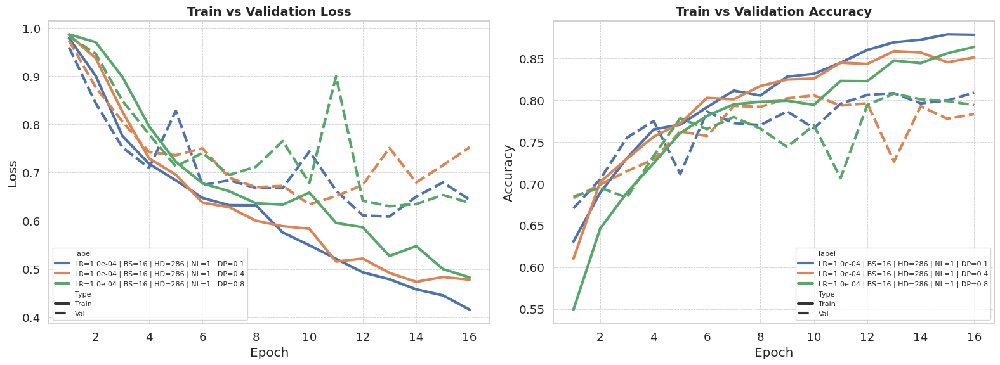

In [130]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

### **10.2 Test Phase**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

In [131]:
# --- Hyperparameters ---
HIDDEN_DIM = 286
DROPOUT = 0.8
NUM_LAYERS = 1
learning_rate = 1e-5
num_epochs = 50
patience = 4
best_model_path = "best_model2.pth"

# --- Model Instantiation ---
model = LSTM_BahdanauAttention(
    embedding_matrix=embedding_matrix_glove,
    hidden_dim=HIDDEN_DIM,
    num_layers=NUM_LAYERS,
    dropout_prob=DROPOUT
).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# --- Compute Class Weights ---
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Tracking Variables ---
train_losses, test_losses = [], []
train_accuracies, test_accuracies = [], []
test_f1s, test_balanced_accs, test_recalls, test_precisions = [], [], [], []

best_test_bal_acc = 0
patience_counter = 0
best_model_state = None

# --- Scheduler ---
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-6
)

# --- Training with Early Stopping ---
with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as epoch_pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        # Training step
        train_loss, train_acc = train_epoch(model, combined_loader, optimizer, loss_function, device)

        # Evaluation step
        test_loss, test_acc, test_f1, test_balanced_acc, test_recall, test_precision = test_epoch(
            model, test_loader, loss_function, device
        )

        # Logging
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        test_losses.append(test_loss)
        test_balanced_accs.append(test_balanced_acc)
        test_f1s.append(test_f1)

        # Scheduler step
        scheduler.step(test_balanced_acc)

        epoch_duration = time.time() - start_time

        # --- Early Stopping Logic ---
        if test_balanced_acc > best_test_bal_acc:
            best_test_bal_acc = test_balanced_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
            torch.save(best_model_state, best_model_path)
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"\nEarly stopping at epoch {epoch + 1}.")
                break

        epoch_pbar.set_postfix({
            "Training Loss": f"{train_loss:.4f}",
            "Test Loss": f"{test_loss:.4f}",
            "Train Balanced Acc": f"{train_acc:.2%}",
            "Test Balanced Acc": f"{test_balanced_acc:.2%}",
            "Test F1": f"{test_f1:.2%}",
            "Test Precision": f"{test_precision:.2%}",
            "Test Recall": f"{test_recall:.2%}",
            "Time(min)": f"{epoch_duration / 60:.2f}"
        })
        epoch_pbar.update(1)

# --- Load Best Model ---
model.load_state_dict(torch.load(best_model_path))

Class weights: [0.69741587 1.76636225]


Training Progress:  30%|███       | 15/50 [02:53<06:45, 11.59s/epoch, Training Loss=0.7699, Test Loss=0.7668, Train Balanced Acc=74.44%, Test Balanced Acc=76.38%, Test F1=66.49%, Test Precision=57.28%, Test Recall=79.22%, Time(min)=0.13]


Early stopping at epoch 16.


<All keys matched successfully>

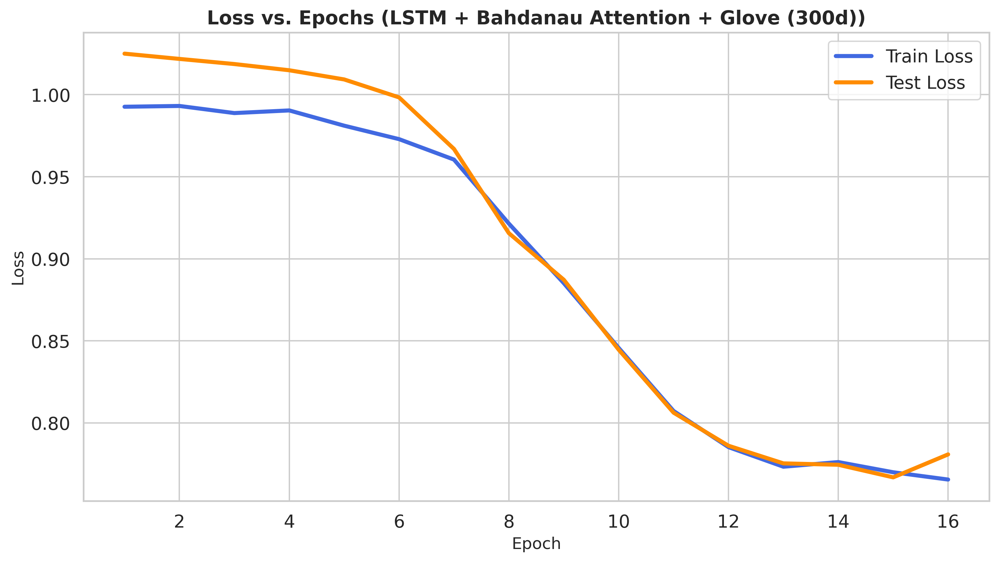

In [133]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=epochs, y=test_losses, label='Test Loss', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (LSTM + Bahdanau Attention + Glove (300d))', fontsize=14, weight='bold')
plt.legend(loc='upper right', frameon=True)
plt.tight_layout()

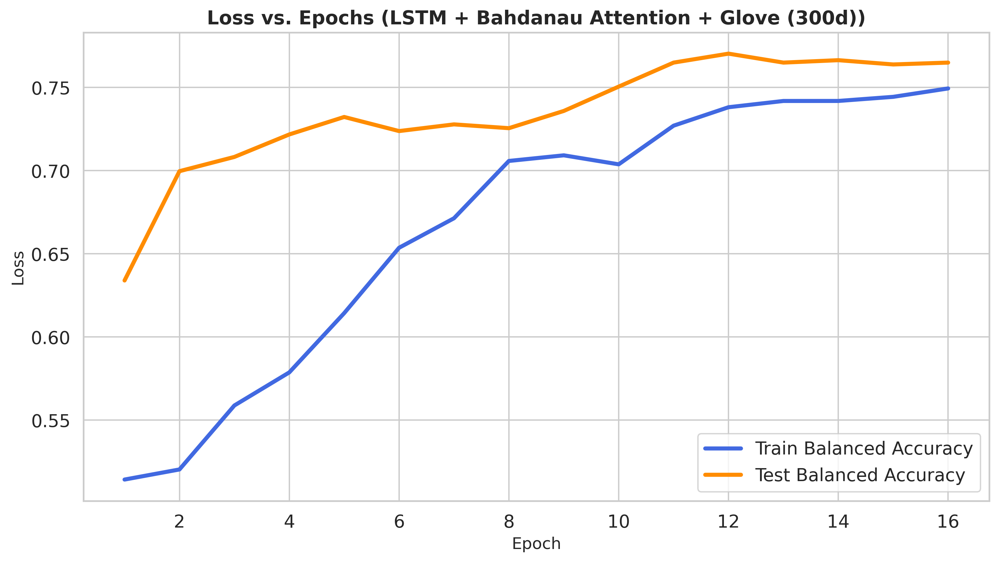

In [132]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 2. Balanced Accurcy Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_accuracies, label='Train Balanced Accuracy', color='royalblue')
sns.lineplot(x=epochs, y=test_balanced_accs, label='Test Balanced Accuracy', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (LSTM + Bahdanau Attention + Glove (300d))', fontsize=14, weight='bold')
plt.legend(loc='lower right', frameon=True)
plt.tight_layout()

In [134]:
model = LSTM_BahdanauAttention(embedding_matrix=embedding_matrix_glove,
                                  hidden_dim=HIDDEN_DIM,
                                  num_layers=NUM_LAYERS,
                                  dropout_prob=DROPOUT
                                ).to(device)

model.load_state_dict(torch.load("/content/best_model2.pth"))
model.eval()

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Recalculate metrics on test set ---
final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_epoch(
    model, test_loader, loss_function, device
)

# --- Print results ---
print("\n Final Evaluation Metrics of Best Model:")
print(f"Test Loss           : {final_test_loss:.4f}")
print(f"Test Accuracy       : {final_test_acc:.2%}")
print(f"Test F1 Score       : {final_test_f1:.2%}")
print(f"Balanced Accuracy   : {final_test_bal_acc:.2%}")
print(f"Test Precision      : {final_test_precision:.2%}")
print(f"Test Recall         : {final_test_recall:.2%}")

Class weights: [0.69741587 1.76636225]

 Final Evaluation Metrics of Best Model:
Test Loss           : 0.7861
Test Accuracy       : 75.70%
Test F1 Score       : 67.21%
Balanced Accuracy   : 77.03%
Test Precision      : 57.67%
Test Recall         : 80.52%


In [135]:
df_results, df_correct, df_wrong, all_labels, all_pred, all_probs = evaluate_and_analyze(model, test_loader, device)

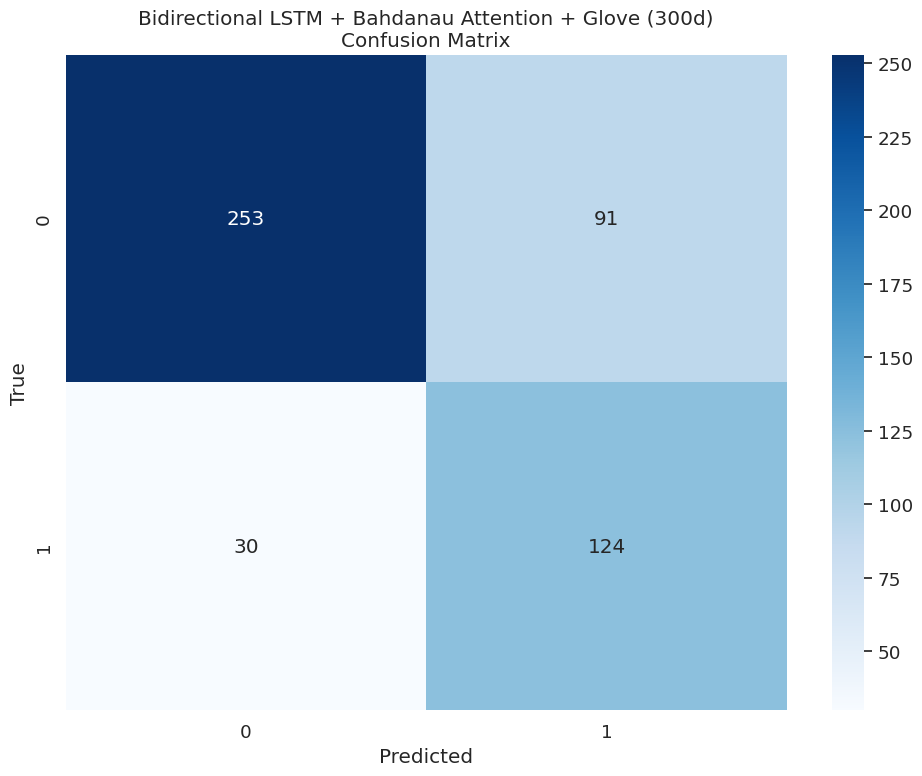

In [136]:
NUM_CLASSES = 2

fig, axes = plt.subplots(1, 1, figsize=(10, 8))

plot_confusion_matrix(axes, all_labels, all_pred)
axes.set_title("Bidirectional LSTM + Bahdanau Attention + Glove (300d)\nConfusion Matrix")

plt.tight_layout()
plt.show()

In [137]:
from sklearn.metrics import roc_curve, auc

y_true = np.array(all_labels)
y_scores = np.array(all_probs)

fpr, tpr, _ = roc_curve(y_true , y_scores)
roc_auc = auc(fpr, tpr)

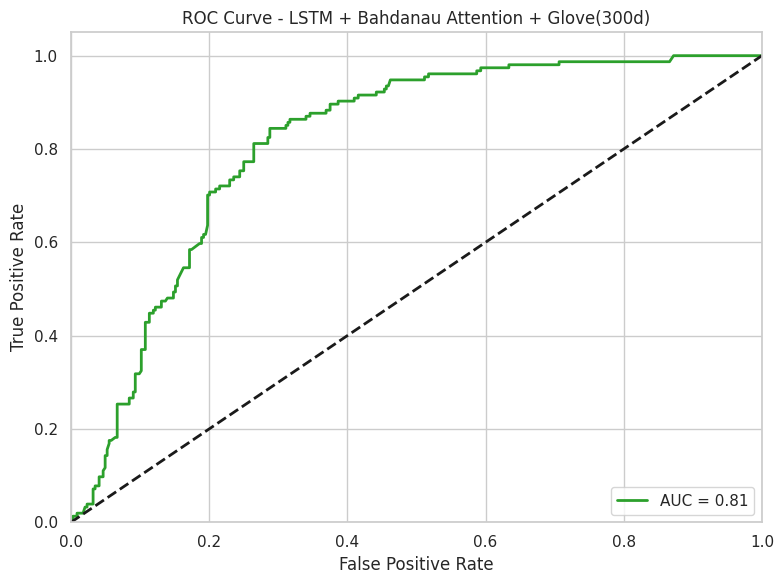

In [138]:
sns.set(style="whitegrid")

# One plot only
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

ax.plot(fpr, tpr, lw=2,
        label=f'AUC = {roc_auc:.2f}', color='tab:green')
ax.plot([0, 1], [0, 1], 'k--', lw=2)
ax.set_xlim([0.0, 1.0])
ax.set_ylim([0.0, 1.05])
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_title('ROC Curve - LSTM + Bahdanau Attention + Glove(300d)')
ax.legend(loc='lower right')
ax.grid(True)

plt.tight_layout()
plt.show()

### **10.3 Few-Shot Learning**

In [139]:
k_values = range(1, 11)  # Few-shot from k=1 to 10
NUM_CLASSES = 2
HIDDEN_DIM = 286
DROPOUT = 0.7

X_combined = np.concatenate((X_train, X_val), axis=0)
y_combined = np.concatenate((y_train, y_val), axis=0)
X_combined_tensor = torch.cat((X_train_tensor, X_val_tensor), dim=0)
y_combined_tensor = torch.cat((y_train_tensor, y_val_tensor), dim=0)

model_metrics = {
    "K-shot": [],
    "Model": [],
    "Test Accuracy": [],
    "F1": [],
    "Balanced Accuracy": [],
    "Recall": [],
    "Precision": []
}

patience = 5
num_epochs = 50
for k in k_values:
    print(f"\n--- K-Shot = {k} ---")

    X_few, y_few = get_few_shot_subset(X_combined_tensor, y_combined_tensor, k_shot=k)
    few_shot_dataset = TextDataset(X_few, y_few, raw_text_data=X_combined)
    few_shot_loader = DataLoader(few_shot_dataset, batch_size=batch_size, shuffle=True, collate_fn=custom_collate_fn)

    model = GRU_BahdanauAttention(
                embedding_matrix=embedding_matrix_fasttext,
                hidden_dim=HIDDEN_DIM,
                num_layers=NUM_LAYERS,
                dropout_prob=DROPOUT
            ).to(device)
    print(f"{count_parameters(model)} model parameters")
    print()
    print(model)

    learning_rate = 2e-5
    optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)

    class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
    print(f"Class weights: {class_weights}")

    pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
    loss_function = torch.nn.BCEWithLogitsLoss(pos_weight)

    # Train with early stopping
    best_val_acc = 0
    patience_counter = 0
    for epoch in range(num_epochs):
        train_loss, train_acc = train_epoch(model, few_shot_loader, optimizer, loss_function, device)
        val_acc, val_f1, val_loss = evaluate_epoch(model, test_loader, loss_function, device)

        print(f"K={k} | Epoch {epoch+1}/{num_epochs} "
              f"- Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, "
              f"Test Loss: {val_loss:.4f}, Test Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                break

    # Load best model
    model.load_state_dict(best_model_state)

    # Evaluate on test set
    avg_loss, avg_accuracy, f1, balanced_acc, recall, precision = test_epoch(model, test_loader, loss_function, device)

    # Log metrics
    print(f"Test Accuracy: {avg_accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"Balanced Accuracy: {balanced_acc:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"Precision: {precision:.4f}")

    model_metrics["K-shot"].append(k)
    model_metrics["Model"].append("LSTM-Bah-Glove")
    model_metrics["Test Accuracy"].append(avg_accuracy)
    model_metrics["F1"].append(f1)
    model_metrics["Balanced Accuracy"].append(balanced_acc)
    model_metrics["Recall"].append(recall)
    model_metrics["Precision"].append(precision)

# Convert results to DataFrame
df = pd.DataFrame(model_metrics)


--- K-Shot = 1 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_features=286, bias=True)
    (v): Linear(in_features=286, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.7, inplace=False)
  (fc): Linear(in_features=572, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=1 | Epoch 1/50 - Train Loss: 1.7105, Train Acc: 1.0000, Test Loss: 0.4724, Test Acc: 1.7719, Val F1: 0.5000
K=1 | Epoch 2/50 - Train Loss: 1.7842, Train Acc: 0.0000, Test Loss: 0.4724, Test Acc: 1.7721, Val F1: 0.5000
K=1 | Epoch 3/50 - Train Loss: 1.7211, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7722, Val F1: 0.5000
K=1 | Epoch 4/50 - Train Loss: 1.7299, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7722, Val F1: 0.5000
K=1 | Epoch 5/50 - Train Loss: 1.7311, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7719, Val F1: 0.5000
K=1 | Epoch 6/50 - Train Loss: 1.7137, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7715, Val F1: 0.5000
K=1 | Epoch 7/50 - Train Loss: 1.7915, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7714, Val F1: 0.5000
K=1 | Epoch 8/50 - Train Loss: 1.7744, Train Acc: 0.0000, Test Loss: 0.4724, Test Acc: 1.7720, Val F1: 0.5000
Test Accuracy: 0.3092
F1 Score: 0.4724
Balanced Accuracy: 0.5000
Recall: 1.0000
Precision: 0.3092

--- K-Shot = 2 ---
13

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=2 | Epoch 1/50 - Train Loss: 1.7907, Train Acc: 0.2500, Test Loss: 0.4724, Test Acc: 1.7781, Val F1: 0.5000
K=2 | Epoch 2/50 - Train Loss: 1.7607, Train Acc: 0.7500, Test Loss: 0.4724, Test Acc: 1.7787, Val F1: 0.5000
K=2 | Epoch 3/50 - Train Loss: 1.7350, Train Acc: 0.7500, Test Loss: 0.4724, Test Acc: 1.7784, Val F1: 0.5000
K=2 | Epoch 4/50 - Train Loss: 1.7351, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7786, Val F1: 0.5000
K=2 | Epoch 5/50 - Train Loss: 1.7366, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7784, Val F1: 0.5000
K=2 | Epoch 6/50 - Train Loss: 1.7491, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7786, Val F1: 0.5000
K=2 | Epoch 7/50 - Train Loss: 1.7297, Train Acc: 0.7500, Test Loss: 0.4724, Test Acc: 1.7787, Val F1: 0.5000
Test Accuracy: 0.3092
F1 Score: 0.4724
Balanced Accuracy: 0.5000
Recall: 1.0000
Precision: 0.3092

--- K-Shot = 3 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, ba

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=3 | Epoch 1/50 - Train Loss: 1.8044, Train Acc: 0.1667, Test Loss: 0.2363, Test Acc: 1.7556, Val F1: 0.4122
K=3 | Epoch 2/50 - Train Loss: 1.8066, Train Acc: 0.1667, Test Loss: 0.2707, Test Acc: 1.7557, Val F1: 0.4280
K=3 | Epoch 3/50 - Train Loss: 1.7282, Train Acc: 0.8333, Test Loss: 0.2720, Test Acc: 1.7556, Val F1: 0.4364
K=3 | Epoch 4/50 - Train Loss: 1.7530, Train Acc: 0.5000, Test Loss: 0.1716, Test Acc: 1.7549, Val F1: 0.4424
K=3 | Epoch 5/50 - Train Loss: 1.7662, Train Acc: 0.3333, Test Loss: 0.0437, Test Acc: 1.7546, Val F1: 0.4145
K=3 | Epoch 6/50 - Train Loss: 1.8047, Train Acc: 0.0000, Test Loss: 0.0356, Test Acc: 1.7544, Val F1: 0.4156
K=3 | Epoch 7/50 - Train Loss: 1.7561, Train Acc: 0.1667, Test Loss: 0.0376, Test Acc: 1.7541, Val F1: 0.4330
Test Accuracy: 0.4699
F1 Score: 0.2707
Balanced Accuracy: 0.4280
Recall: 0.3182
Precision: 0.2356

--- K-Shot = 4 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, ba

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=4 | Epoch 1/50 - Train Loss: 1.7217, Train Acc: 0.7500, Test Loss: 0.4618, Test Acc: 1.7588, Val F1: 0.4974
K=4 | Epoch 2/50 - Train Loss: 1.7334, Train Acc: 0.7500, Test Loss: 0.4618, Test Acc: 1.7588, Val F1: 0.5022
K=4 | Epoch 3/50 - Train Loss: 1.7522, Train Acc: 0.5000, Test Loss: 0.4636, Test Acc: 1.7596, Val F1: 0.5040
K=4 | Epoch 4/50 - Train Loss: 1.7513, Train Acc: 0.7500, Test Loss: 0.4626, Test Acc: 1.7595, Val F1: 0.5036
K=4 | Epoch 5/50 - Train Loss: 1.7327, Train Acc: 0.7500, Test Loss: 0.4425, Test Acc: 1.7590, Val F1: 0.4828
K=4 | Epoch 6/50 - Train Loss: 1.7394, Train Acc: 0.5000, Test Loss: 0.4444, Test Acc: 1.7589, Val F1: 0.4883
K=4 | Epoch 7/50 - Train Loss: 1.7436, Train Acc: 0.3750, Test Loss: 0.4444, Test Acc: 1.7588, Val F1: 0.4883
K=4 | Epoch 8/50 - Train Loss: 1.7502, Train Acc: 0.6250, Test Loss: 0.4460, Test Acc: 1.7584, Val F1: 0.4912
Test Accuracy: 0.3494
F1 Score: 0.4636
Balanced Accuracy: 0.5040
Recall: 0.9091
Precision: 0.3111

--- K-Shot = 5 ---
13

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=5 | Epoch 1/50 - Train Loss: 1.7533, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7453, Val F1: 0.5000
K=5 | Epoch 2/50 - Train Loss: 1.7441, Train Acc: 0.6000, Test Loss: 0.0000, Test Acc: 1.7451, Val F1: 0.5000
K=5 | Epoch 3/50 - Train Loss: 1.7406, Train Acc: 0.4000, Test Loss: 0.0000, Test Acc: 1.7448, Val F1: 0.5000
K=5 | Epoch 4/50 - Train Loss: 1.7484, Train Acc: 0.7000, Test Loss: 0.0000, Test Acc: 1.7449, Val F1: 0.5000
K=5 | Epoch 5/50 - Train Loss: 1.7421, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7450, Val F1: 0.5000
K=5 | Epoch 6/50 - Train Loss: 1.7424, Train Acc: 0.7000, Test Loss: 0.0000, Test Acc: 1.7443, Val F1: 0.5000
Test Accuracy: 0.6908
F1 Score: 0.0000
Balanced Accuracy: 0.5000
Recall: 0.0000
Precision: 0.0000

--- K-Shot = 6 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_fea

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=6 | Epoch 1/50 - Train Loss: 1.7256, Train Acc: 0.5833, Test Loss: 0.0000, Test Acc: 1.7366, Val F1: 0.5000
K=6 | Epoch 2/50 - Train Loss: 1.7390, Train Acc: 0.5833, Test Loss: 0.0000, Test Acc: 1.7360, Val F1: 0.5000
K=6 | Epoch 3/50 - Train Loss: 1.7317, Train Acc: 0.6667, Test Loss: 0.0000, Test Acc: 1.7364, Val F1: 0.5000
K=6 | Epoch 4/50 - Train Loss: 1.7417, Train Acc: 0.5833, Test Loss: 0.0000, Test Acc: 1.7362, Val F1: 0.5000
K=6 | Epoch 5/50 - Train Loss: 1.7423, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7366, Val F1: 0.5000
K=6 | Epoch 6/50 - Train Loss: 1.7627, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7367, Val F1: 0.5000
K=6 | Epoch 7/50 - Train Loss: 1.7439, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7369, Val F1: 0.5000
K=6 | Epoch 8/50 - Train Loss: 1.7437, Train Acc: 0.6667, Test Loss: 0.0000, Test Acc: 1.7372, Val F1: 0.5000
K=6 | Epoch 9/50 - Train Loss: 1.7567, Train Acc: 0.5833, Test Loss: 0.0000, Test Acc: 1.7377, Val F1: 0.5000
K=6 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=7 | Epoch 1/50 - Train Loss: 1.7685, Train Acc: 0.5714, Test Loss: 0.4724, Test Acc: 1.7772, Val F1: 0.5000
K=7 | Epoch 2/50 - Train Loss: 1.7521, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7760, Val F1: 0.5000
K=7 | Epoch 3/50 - Train Loss: 1.7487, Train Acc: 0.5714, Test Loss: 0.4724, Test Acc: 1.7751, Val F1: 0.5000
K=7 | Epoch 4/50 - Train Loss: 1.7634, Train Acc: 0.5000, Test Loss: 0.4724, Test Acc: 1.7743, Val F1: 0.5000
K=7 | Epoch 5/50 - Train Loss: 1.7692, Train Acc: 0.5000, Test Loss: 0.4731, Test Acc: 1.7730, Val F1: 0.5015
K=7 | Epoch 6/50 - Train Loss: 1.7653, Train Acc: 0.3571, Test Loss: 0.4731, Test Acc: 1.7722, Val F1: 0.5015
Test Accuracy: 0.3092
F1 Score: 0.4724
Balanced Accuracy: 0.5000
Recall: 1.0000
Precision: 0.3092

--- K-Shot = 8 ---
13433845 model parameters

GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_fea

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=8 | Epoch 1/50 - Train Loss: 1.7743, Train Acc: 0.4375, Test Loss: 0.0000, Test Acc: 1.7464, Val F1: 0.5000
K=8 | Epoch 2/50 - Train Loss: 1.7521, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7468, Val F1: 0.5000
K=8 | Epoch 3/50 - Train Loss: 1.7461, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7472, Val F1: 0.5000
K=8 | Epoch 4/50 - Train Loss: 1.7358, Train Acc: 0.7500, Test Loss: 0.0000, Test Acc: 1.7471, Val F1: 0.5000
K=8 | Epoch 5/50 - Train Loss: 1.7407, Train Acc: 0.6250, Test Loss: 0.0000, Test Acc: 1.7474, Val F1: 0.5000
K=8 | Epoch 6/50 - Train Loss: 1.7463, Train Acc: 0.5625, Test Loss: 0.0000, Test Acc: 1.7472, Val F1: 0.5000
K=8 | Epoch 7/50 - Train Loss: 1.7516, Train Acc: 0.5625, Test Loss: 0.0000, Test Acc: 1.7474, Val F1: 0.5000
K=8 | Epoch 8/50 - Train Loss: 1.7296, Train Acc: 0.7500, Test Loss: 0.0000, Test Acc: 1.7471, Val F1: 0.5000
K=8 | Epoch 9/50 - Train Loss: 1.7484, Train Acc: 0.5000, Test Loss: 0.0000, Test Acc: 1.7477, Val F1: 0.5000
K=8 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=9 | Epoch 1/50 - Train Loss: 1.7734, Train Acc: 0.5000, Test Loss: 0.3384, Test Acc: 1.7548, Val F1: 0.4632
K=9 | Epoch 2/50 - Train Loss: 1.7378, Train Acc: 0.7778, Test Loss: 0.4477, Test Acc: 1.7569, Val F1: 0.5014
K=9 | Epoch 3/50 - Train Loss: 1.7445, Train Acc: 0.5000, Test Loss: 0.4153, Test Acc: 1.7542, Val F1: 0.5124
K=9 | Epoch 4/50 - Train Loss: 1.7488, Train Acc: 0.3333, Test Loss: 0.4558, Test Acc: 1.7544, Val F1: 0.5292
K=9 | Epoch 5/50 - Train Loss: 1.7500, Train Acc: 0.6667, Test Loss: 0.4429, Test Acc: 1.7558, Val F1: 0.4927
K=9 | Epoch 6/50 - Train Loss: 1.7418, Train Acc: 0.4444, Test Loss: 0.4484, Test Acc: 1.7574, Val F1: 0.4992
K=9 | Epoch 7/50 - Train Loss: 1.7190, Train Acc: 0.7222, Test Loss: 0.4484, Test Acc: 1.7568, Val F1: 0.4992
K=9 | Epoch 8/50 - Train Loss: 1.7260, Train Acc: 0.8333, Test Loss: 0.4469, Test Acc: 1.7542, Val F1: 0.5037
K=9 | Epoch 9/50 - Train Loss: 1.7277, Train Acc: 0.7222, Test Loss: 0.4511, Test Acc: 1.7522, Val F1: 0.5268
K=9 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=10 | Epoch 1/50 - Train Loss: 1.7803, Train Acc: 0.2500, Test Loss: 0.4657, Test Acc: 1.7587, Val F1: 0.5094
K=10 | Epoch 2/50 - Train Loss: 1.7465, Train Acc: 0.6000, Test Loss: 0.4521, Test Acc: 1.7595, Val F1: 0.4954
K=10 | Epoch 3/50 - Train Loss: 1.7435, Train Acc: 0.4500, Test Loss: 0.4515, Test Acc: 1.7583, Val F1: 0.5013
K=10 | Epoch 4/50 - Train Loss: 1.7601, Train Acc: 0.4500, Test Loss: 0.4412, Test Acc: 1.7564, Val F1: 0.4935
K=10 | Epoch 5/50 - Train Loss: 1.7527, Train Acc: 0.5500, Test Loss: 0.4351, Test Acc: 1.7546, Val F1: 0.4980
K=10 | Epoch 6/50 - Train Loss: 1.7533, Train Acc: 0.5500, Test Loss: 0.4108, Test Acc: 1.7530, Val F1: 0.4886
K=10 | Epoch 7/50 - Train Loss: 1.7467, Train Acc: 0.6500, Test Loss: 0.3542, Test Acc: 1.7513, Val F1: 0.4959
Test Accuracy: 0.3574
F1 Score: 0.4521
Balanced Accuracy: 0.4954
Recall: 0.8571
Precision: 0.3070


In [140]:
# --- Plotting ---
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
palette = sns.color_palette("Set2")

def plot_model_performance(df, model_name, color, title_prefix="Model Performance"):
    model_df = df[df["Model"] == model_name]
    metrics_to_plot = ["F1", "Balanced Accuracy", "Recall", "Precision"]

    fig, axes = plt.subplots(2, 2, figsize=(14, 10), sharex=True)
    axes = axes.flatten()

    for i, metric in enumerate(metrics_to_plot):
        sns.lineplot(
            data=model_df,
            x="K-shot",
            y=metric,
            ax=axes[i],
            color=color,
            marker="o",
            linewidth=2.2,
            markersize=6,
        )
        axes[i].set_title(metric, fontsize=14)
        axes[i].set_xlabel("K-shot")
        axes[i].set_ylabel(metric)
        axes[i].grid(True)

    plt.suptitle(f"{title_prefix} for {model_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

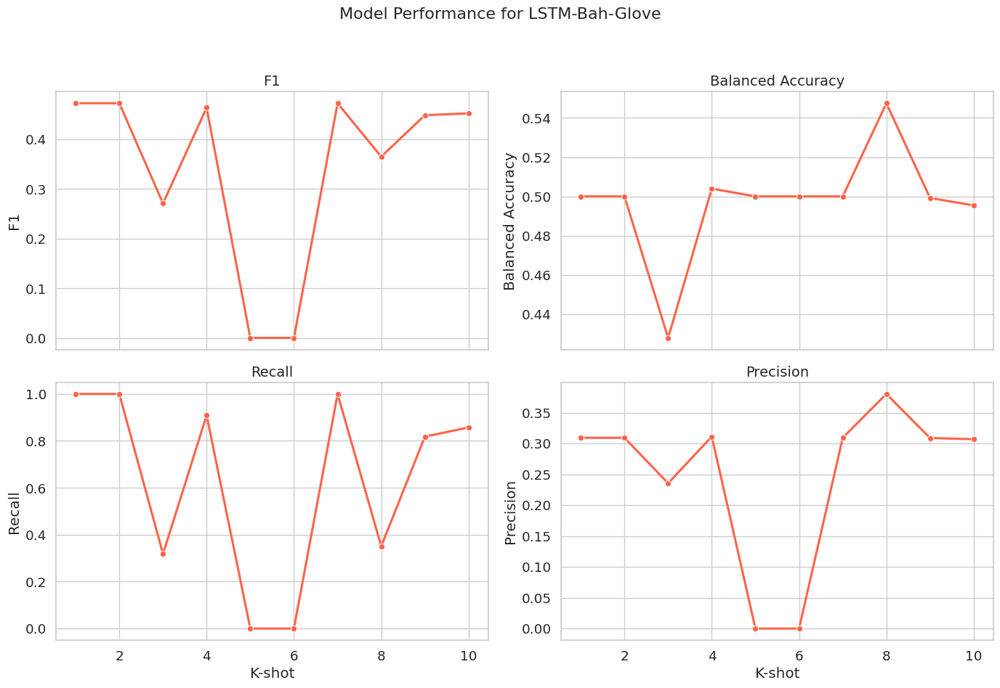

In [141]:
# Plot results
plot_model_performance(df, "LSTM-Bah-Glove", "tomato")

Maximum values per metric:
Balanced Accuracy: 0.5474 (at K-shot = 8)
F1: 0.4724 (at K-shot = 1)
Recall: 1.0000 (at K-shot = 1)
Precision: 0.3803 (at K-shot = 8)


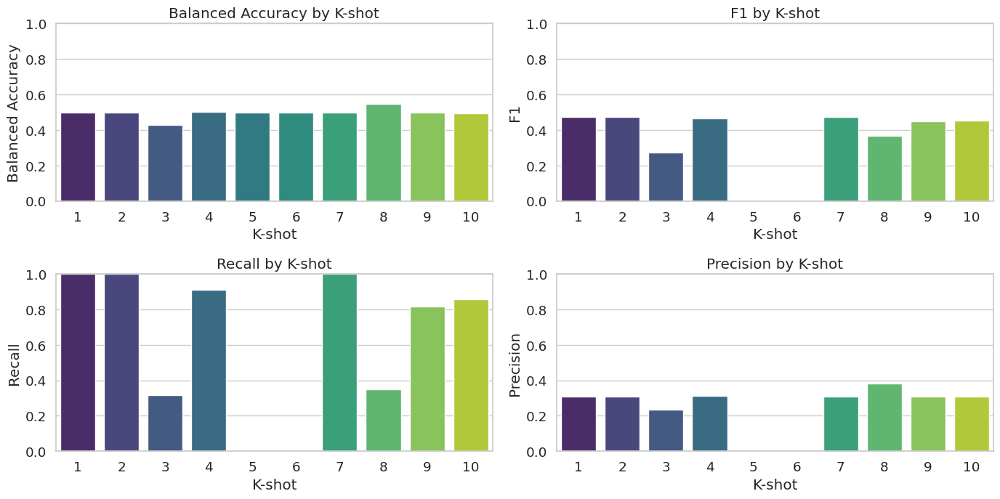

In [142]:
metrics = ["Balanced Accuracy", "F1", "Recall", "Precision"]

# Print max values for each metric
print("Maximum values per metric:")
for metric in metrics:
    max_val = df[metric].max()
    max_k = df.loc[df[metric].idxmax(), "K-shot"]
    print(f"{metric}: {max_val:.4f} (at K-shot = {max_k})")

# Then plot the histograms
plt.figure(figsize=(14, 10))

for i, metric in enumerate(metrics, 1):
    plt.subplot(3, 2, i)
    sns.barplot(x="K-shot", y=metric, data=df, palette="viridis")
    plt.title(f"{metric} by K-shot")
    plt.ylim(0, 1)
    plt.xlabel("K-shot")
    plt.ylabel(metric)

plt.tight_layout()
plt.show()

## **11. Bidirectional LSTM + Weight Class using Glove (300d)**

### **11.1 Optimization Phase**

#### **11.1.1 Optimizer selection**

In [143]:
num_epochs = 16
learning_rate = 5e-5

class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)
results = []

optimizers = {
    'Adam': optim.Adam,
    'RMSprop': optim.RMSprop,
    'AdamW': optim.AdamW
}

all_train_losses, all_val_losses = {}, {}
all_train_accs, all_val_accs = {}, {}

# Loop through optimizers
for optimizer_name, optimizer_class in optimizers.items():
    print(f"\n🔹 Training with optimizer: {optimizer_name}")

    model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=learning_rate)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total trainable parameters: {num_params}")

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []
    best_val_loss = float('inf')

    # Training loop
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # <-- fixed unpacking order

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        scheduler.step(f1)

        duration = time.time() - start_time

        print(
            f"Opt: {optimizer_name} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {duration/60:.2f} min"
        )

    # Store metrics
    all_train_losses[optimizer_name] = train_losses
    all_val_losses[optimizer_name] = val_losses
    all_train_accs[optimizer_name] = train_accs
    all_val_accs[optimizer_name] = val_accs

    label = f"Batch={BATCH_SIZE} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with optimizer: Adam
LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 15469101
Opt: Adam | Epoch 1/16 - TL: 0.9870, VL: 0.9848, TA: 54.91%, VA: 63.33%, F1: 50.00%, Time: 0.12 min
Opt: Adam | Epoch 2/16 - TL: 0.9766, VL: 0.9757, TA: 63.19%, VA: 65.48%, F1: 51.72%, Time: 0.13 min
Opt: Adam | Epoch 3/16 - TL: 0.9666, VL: 0.9637, TA: 66.36%, VA: 65.60%, F1: 51.53%, Time: 0.13 min
Opt: Adam | Epoch 4/16 - TL: 0.9461, VL: 0.9429, TA: 68.28%, VA: 64.91%, F1: 50.89%, Time: 0.13 min
Opt: Adam | Epoch 5/16 - TL: 0.8944, VL: 0.9149, TA: 67.24%, VA: 68.13%, F1: 54.93%, Time: 0.13 min
Opt: Adam | Epoch 6/16 - TL: 0.8889, VL: 0.7977, TA: 68.31%, VA: 71.85%, F1: 58.69%, Time: 0.13 min
Opt: Adam | Epoch 7/16 - TL: 0.8187, VL: 0.8656, TA: 71.29%, VA: 67.55%, F

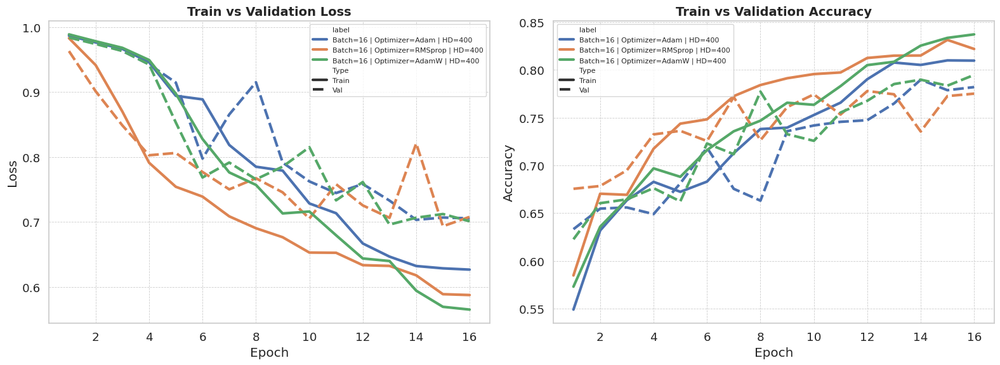

In [144]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **11.1.2 Learning rate value selection**

In [145]:
# Learning rate sweep configuration
learning_rates = [1e-5, 5e-5, 1e-6]
optimizer_name = 'Adam'
optimizer_class = optim.Adam
results = []
num_epochs = 16

# Class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop through learning rates
for lr in learning_rates:
    print(f"\n🔹 Training with {optimizer_name} optimizer, learning rate = {lr}")

    # Instantiate GRU + Bahdanau Attention model
    model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        scheduler.step(f1)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"LR: {lr:.1e} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results
    label = f"LR={lr:.1e} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with Adam optimizer, learning rate = 1e-05
LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
LR: 1.0e-05 | Epoch 1/16 - TL: 0.9966, VL: 0.9911, TA: 52.10%, VA: 58.61%, F1: 45.74%, Time: 0.13 min
LR: 1.0e-05 | Epoch 2/16 - TL: 0.9907, VL: 0.9892, TA: 55.81%, VA: 58.68%, F1: 45.70%, Time: 0.13 min
LR: 1.0e-05 | Epoch 3/16 - TL: 0.9878, VL: 0.9873, TA: 59.60%, VA: 61.28%, F1: 47.96%, Time: 0.13 min
LR: 1.0e-05 | Epoch 4/16 - TL: 0.9836, VL: 0.9854, TA: 61.30%, VA: 64.73%, F1: 51.21%, Time: 0.13 min
LR: 1.0e-05 | Epoch 5/16 - TL: 0.9846, VL: 0.9835, TA: 62.79%, VA: 65.98%, F1: 52.39%, Time: 0.13 min
LR: 1.0e-05 | Epoch 6/16 - TL: 0.9800, VL: 0.9815, TA: 63.48%, VA: 66.13%, F1: 52.63%, Time: 0.13 min
LR: 1.0e-05 | Epoch 7/16 - TL: 0.9818, VL: 0.9795, TA: 64.17%, VA: 66.40%, F1

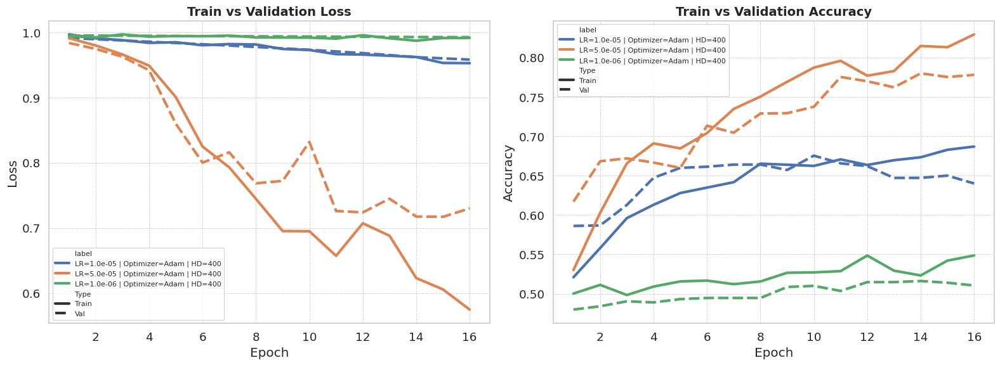

In [146]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **11.1.3 Batch size value selection**

In [147]:
# Batch size sweep configuration
batch_sizes = [8, 16, 64]
learning_rate = 2e-5
num_epochs = 16
results = []

# Compute class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop over different batch sizes
for batch_size in batch_sizes:
    print(f"\n🔹 Training with batch size: {batch_size}")

    # Create DataLoaders with the current batch size
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    # Instantiate GRU + Bahdanau Attention model
    model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"BS: {batch_size} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results for later plotting
    label = f"LR={learning_rate:.1e} | Batch={batch_size} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with batch size: 8
BS: 8 | Epoch 1/16 - TL: 0.9880, VL: 0.9952, TA: 55.33%, VA: 61.97%, F1: 46.15%, Time: 0.35 min
BS: 8 | Epoch 2/16 - TL: 0.9753, VL: 0.9830, TA: 61.42%, VA: 65.27%, F1: 51.45%, Time: 0.35 min
BS: 8 | Epoch 3/16 - TL: 0.9569, VL: 0.9662, TA: 66.06%, VA: 64.36%, F1: 49.13%, Time: 0.35 min
BS: 8 | Epoch 4/16 - TL: 0.9391, VL: 0.9242, TA: 65.96%, VA: 69.85%, F1: 56.80%, Time: 0.36 min
BS: 8 | Epoch 5/16 - TL: 0.8645, VL: 0.8739, TA: 68.89%, VA: 68.77%, F1: 55.37%, Time: 0.36 min
BS: 8 | Epoch 6/16 - TL: 0.8200, VL: 0.9310, TA: 72.04%, VA: 68.66%, F1: 55.02%, Time: 0.36 min
BS: 8 | Epoch 7/16 - TL: 0.7821, VL: 0.8496, TA: 73.74%, VA: 73.78%, F1: 62.16%, Time: 0.36 min
BS: 8 | Epoch 8/16 - TL: 0.7554, VL: 0.7802, TA: 74.75%, VA: 76.71%, F1: 65.24%, Time: 0.36 min
BS: 8 | Epoch 9/16 - TL: 0.7109, VL: 0.7275, TA: 76.65%, VA: 77.71%, F1: 66.08%, Time: 0.36 min
BS: 8 | Epoch 10/16 - TL: 0.7258, VL: 0.7627, TA: 76.56%, VA: 76.7

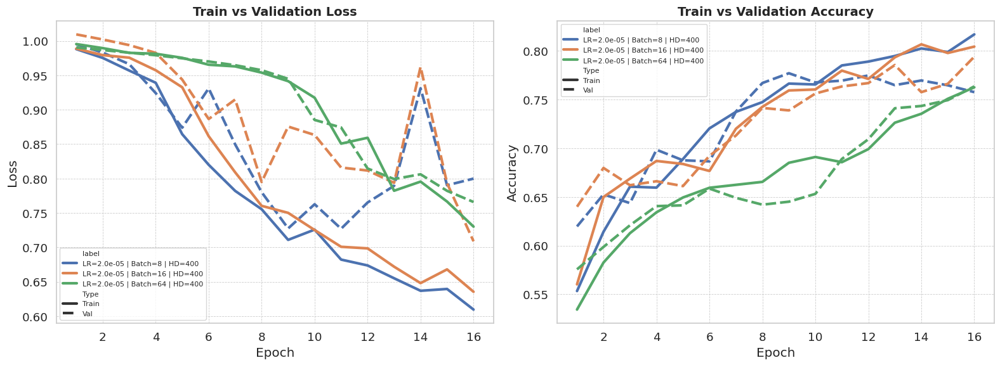

In [148]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **11.1.4 Dropout value selection**

In [149]:
# Hyperparameter sweep configuration
hidden_dims = [286]
dropouts = [0.1, 0.4, 0.8]
learning_rate = 1e-5
batch_size = 16
num_epochs = 16
results = []

# Compute class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for hidden_dim in hidden_dims:
    num_layers = 1  # fixed value for this sweep
    for dropout in dropouts:
        print(f"\n🔹 Training with hidden_dim={hidden_dim}, num_layers={num_layers}, dropout={dropout}")

        # Data loaders
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

        # Instantiate GRU + Bahdanau Attention model with current parameters
        model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        train_losses, val_losses = [], []
        train_accs, val_accs, val_f1s = [], [], []

        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
            val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

            train_losses.append(train_loss)
            val_losses.append(val_loss)
            train_accs.append(train_acc)
            val_accs.append(val_acc)
            val_f1s.append(f1)

            print(
                f"HD: {hidden_dim} | NL: {num_layers} | DP: {dropout} | Epoch {epoch+1}/{num_epochs} - "
                f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
                f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
                f"Time: {(time.time() - start_time)/60:.2f} min"
            )

        # Store results
        label = f"LR={learning_rate:.1e} | BS={batch_size} | HD={hidden_dim} | NL={num_layers} | DP={dropout}"
        for epoch in range(num_epochs):
            results.append({
                "epoch": epoch + 1,
                "label": label,
                "train_loss": train_losses[epoch],
                "val_loss": val_losses[epoch],
                "train_acc": train_accs[epoch],
                "val_acc": val_accs[epoch],
                "val_f1": val_f1s[epoch]
            })

Class weights: [0.69741587 1.76636225]

🔹 Training with hidden_dim=286, num_layers=1, dropout=0.1
HD: 286 | NL: 1 | DP: 0.1 | Epoch 1/16 - TL: 0.9967, VL: 1.0132, TA: 53.65%, VA: 55.88%, F1: 41.11%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 2/16 - TL: 0.9851, VL: 1.0096, TA: 57.95%, VA: 61.10%, F1: 46.72%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 3/16 - TL: 0.9812, VL: 1.0062, TA: 61.65%, VA: 63.50%, F1: 49.27%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 4/16 - TL: 0.9830, VL: 1.0021, TA: 64.57%, VA: 64.56%, F1: 50.58%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 5/16 - TL: 0.9707, VL: 0.9980, TA: 67.04%, VA: 64.70%, F1: 50.73%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 6/16 - TL: 0.9721, VL: 0.9933, TA: 66.91%, VA: 63.29%, F1: 49.29%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 7/16 - TL: 0.9588, VL: 0.9867, TA: 66.96%, VA: 63.81%, F1: 50.27%, Time: 0.21 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 8/16 - TL: 0.9493, VL: 0.9776, TA: 68.59%, VA: 65.73%, F

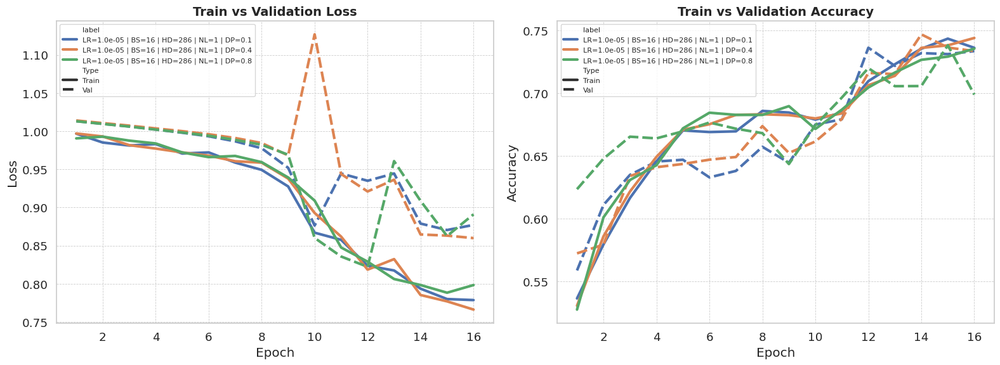

In [150]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

### **11.2 Test Phase**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

In [156]:
# --- Hyperparameters ---
HIDDEN_DIM = 286
DROPOUT = 0.8
NUM_LAYERS = 1
learning_rate = 5e-5
num_epochs = 50
patience = 6
best_model_path = "best_model2.pth"

# --- Model Instantiation ---
model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# --- Compute Class Weights ---
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Tracking Variables ---
train_losses, test_losses = [], []
train_accuracies, test_accuracies = [], []
test_f1s, test_balanced_accs, test_recalls, test_precisions = [], [], [], []

best_test_bal_acc = 0
patience_counter = 0
best_model_state = None

# --- Scheduler ---
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-6
)

# --- Training with Early Stopping ---
with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as epoch_pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        # Training step
        train_loss, train_acc = train_epoch(model, combined_loader, optimizer, loss_function, device)

        # Evaluation step
        test_loss, test_acc, test_f1, test_balanced_acc, test_recall, test_precision = test_epoch(
            model, test_loader, loss_function, device
        )

        # Logging
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        test_losses.append(test_loss)
        test_balanced_accs.append(test_balanced_acc)
        test_f1s.append(test_f1)

        # Scheduler step
        scheduler.step(test_balanced_acc)

        epoch_duration = time.time() - start_time

        # --- Early Stopping Logic ---
        if test_balanced_acc > best_test_bal_acc:
            best_test_bal_acc = test_balanced_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
            torch.save(best_model_state, best_model_path)
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"\nEarly stopping at epoch {epoch + 1}.")
                break

        epoch_pbar.set_postfix({
            "Training Loss": f"{train_loss:.4f}",
            "Test Loss": f"{test_loss:.4f}",
            "Train Balanced Acc": f"{train_acc:.2%}",
            "Test Balanced Acc": f"{test_balanced_acc:.2%}",
            "Test F1": f"{test_f1:.2%}",
            "Test Precision": f"{test_precision:.2%}",
            "Test Recall": f"{test_recall:.2%}",
            "Time(min)": f"{epoch_duration / 60:.2f}"
        })
        epoch_pbar.update(1)

# --- Load Best Model ---
model.load_state_dict(torch.load(best_model_path))

Class weights: [0.69741587 1.76636225]


Training Progress:  52%|█████▏    | 26/50 [08:21<07:43, 19.31s/epoch, Training Loss=0.4283, Test Loss=0.8265, Train Balanced Acc=88.52%, Test Balanced Acc=79.01%, Test F1=70.24%, Test Precision=64.84%, Test Recall=76.62%, Time(min)=0.26]


Early stopping at epoch 27.


<All keys matched successfully>

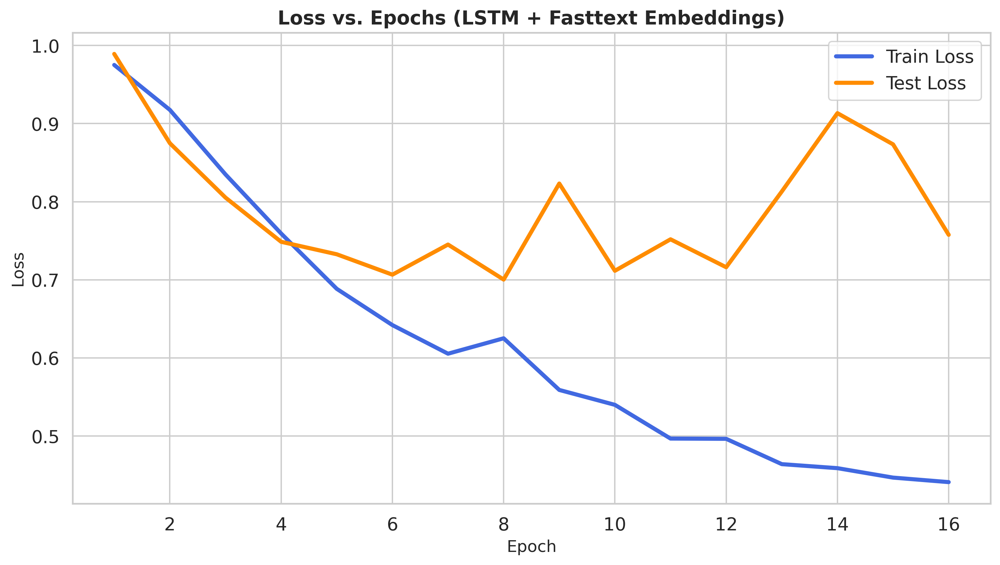

In [152]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=epochs, y=test_losses, label='Test Loss', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (LSTM + Fasttext Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='upper right', frameon=True)
plt.tight_layout()

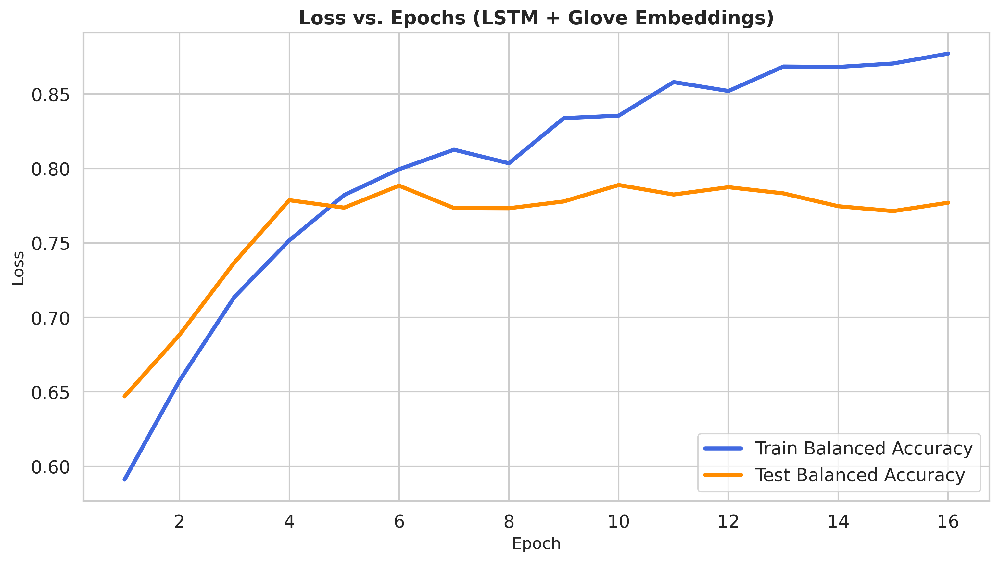

In [153]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 2. Balanced Accurcy Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_accuracies, label='Train Balanced Accuracy', color='royalblue')
sns.lineplot(x=epochs, y=test_balanced_accs, label='Test Balanced Accuracy', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (LSTM + Glove Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='lower right', frameon=True)
plt.tight_layout()

In [157]:
model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

model.load_state_dict(torch.load("/content/best_model2.pth"))
model.eval()

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Recalculate metrics on test set ---
final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_epoch(
    model, test_loader, loss_function, device
)

# --- Print results ---
print("\n Final Evaluation Metrics of Best Model:")
print(f"Test Loss           : {final_test_loss:.4f}")
print(f"Test Accuracy       : {final_test_acc:.2%}")
print(f"Test F1 Score       : {final_test_f1:.2%}")
print(f"Balanced Accuracy   : {final_test_bal_acc:.2%}")
print(f"Test Precision      : {final_test_precision:.2%}")
print(f"Test Recall         : {final_test_recall:.2%}")

Class weights: [0.69741587 1.76636225]

 Final Evaluation Metrics of Best Model:
Test Loss           : 0.7278
Test Accuracy       : 78.71%
Test F1 Score       : 70.72%
Balanced Accuracy   : 79.93%
Test Precision      : 61.54%
Test Recall         : 83.12%


In [158]:
df_results, df_correct, df_wrong, all_labels, all_pred, all_probs = evaluate_and_analyze(model, test_loader, device)

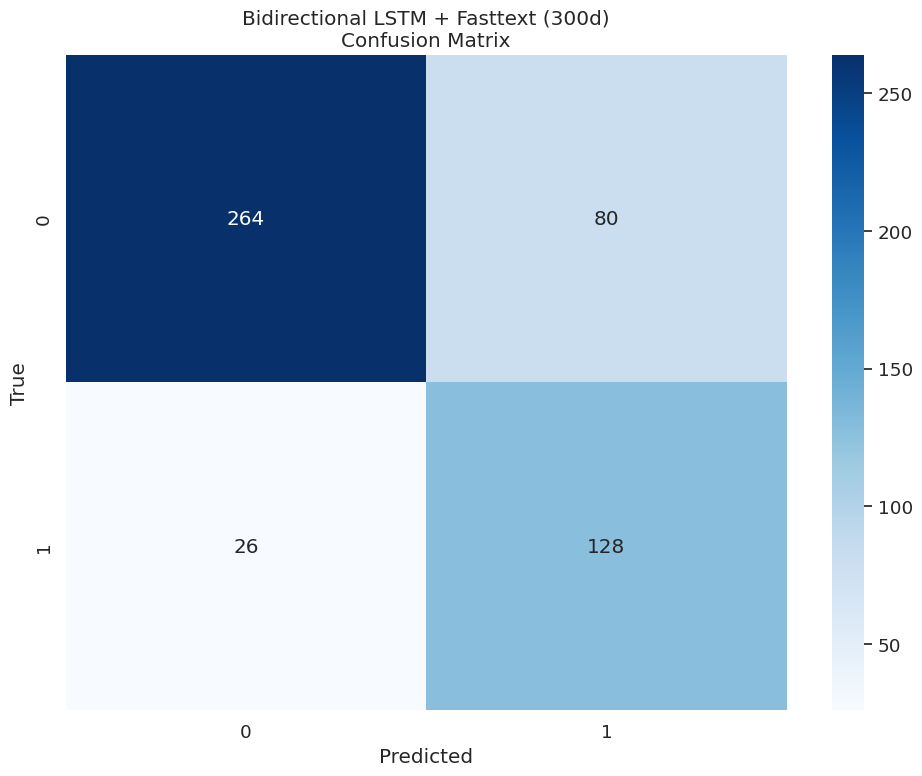

In [159]:
NUM_CLASSES = 2

fig, axes = plt.subplots(1, 1, figsize=(10, 8))

plot_confusion_matrix(axes, all_labels, all_pred)
axes.set_title("Bidirectional LSTM + Fasttext (300d)\nConfusion Matrix")

plt.tight_layout()
plt.show()

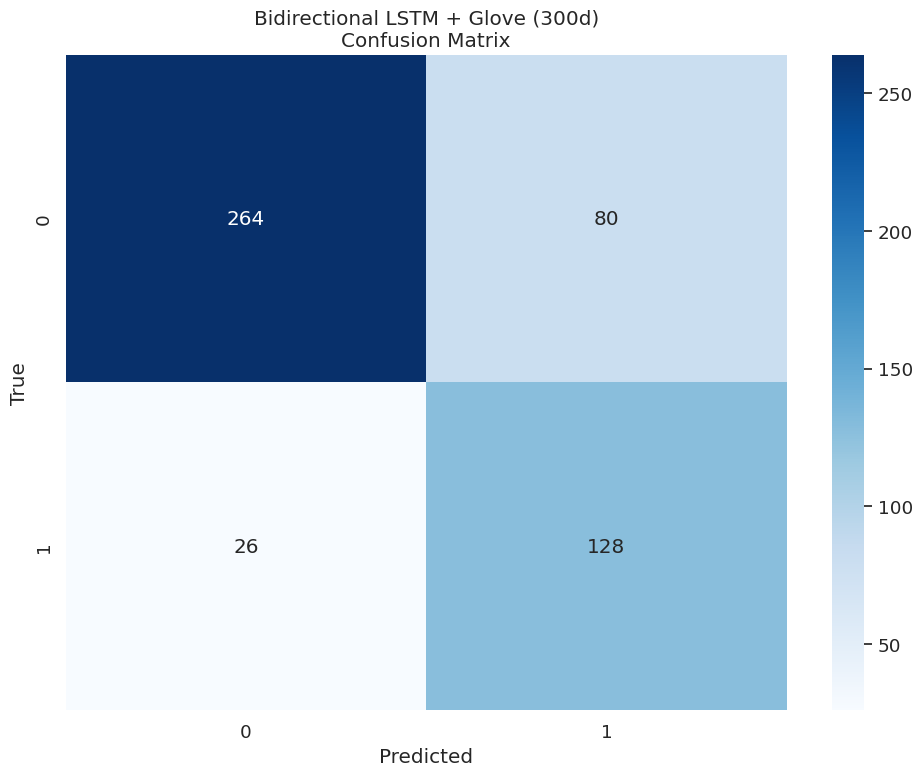

In [160]:
NUM_CLASSES = 2

fig, axes = plt.subplots(1, 1, figsize=(10, 8))

plot_confusion_matrix(axes, all_labels, all_pred)
axes.set_title("Bidirectional LSTM + Glove (300d)\nConfusion Matrix")

plt.tight_layout()
plt.show()

In [161]:
from sklearn.metrics import roc_curve, auc

y_true = np.array(all_labels)
y_scores = np.array(all_probs)

fpr, tpr, _ = roc_curve(y_true , y_scores)
roc_auc = auc(fpr, tpr)

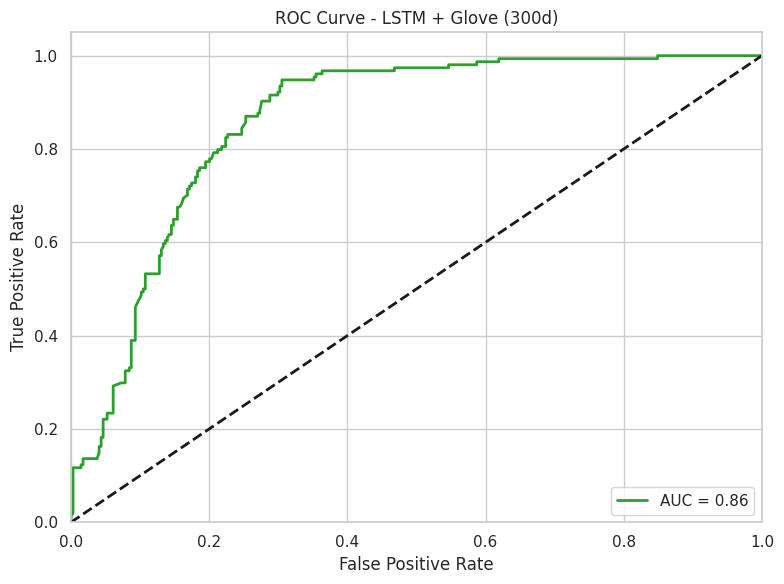

In [162]:
sns.set(style="whitegrid")

# One plot only
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

ax.plot(fpr, tpr, lw=2,
        label=f'AUC = {roc_auc:.2f}', color='tab:green')
ax.plot([0, 1], [0, 1], 'k--', lw=2)
ax.set_xlim([0.0, 1.0])
ax.set_ylim([0.0, 1.05])
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_title('ROC Curve - LSTM + Glove (300d)')
ax.legend(loc='lower right')
ax.grid(True)

plt.tight_layout()
plt.show()

### **11.3 Few-Shot Learning**

In [163]:
k_values = range(1, 11)  # Few-shot from k=1 to 10
NUM_CLASSES = 2
HIDDEN_DIM = 286
DROPOUT = 0.7

X_combined = np.concatenate((X_train, X_val), axis=0)
y_combined = np.concatenate((y_train, y_val), axis=0)
X_combined_tensor = torch.cat((X_train_tensor, X_val_tensor), dim=0)
y_combined_tensor = torch.cat((y_train_tensor, y_val_tensor), dim=0)

model_metrics = {
    "K-shot": [],
    "Model": [],
    "Test Accuracy": [],
    "F1": [],
    "Balanced Accuracy": [],
    "Recall": [],
    "Precision": []
}

patience = 7
num_epochs = 50
for k in k_values:
    print(f"\n--- K-Shot = {k} ---")

    X_few, y_few = get_few_shot_subset(X_combined_tensor, y_combined_tensor, k_shot=k)
    few_shot_dataset = TextDataset(X_few, y_few, raw_text_data=X_combined)
    few_shot_loader = DataLoader(few_shot_dataset, batch_size=batch_size, shuffle=True, collate_fn=custom_collate_fn)

    model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

    print(f"{count_parameters(model)} model parameters")
    print()
    print(model)

    learning_rate = 2e-5
    optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)

    class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
    print(f"Class weights: {class_weights}")

    pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
    loss_function = torch.nn.BCEWithLogitsLoss()

    # Train with early stopping
    best_val_acc = 0
    patience_counter = 0
    for epoch in range(num_epochs):
        train_loss, train_acc = train_epoch(model, few_shot_loader, optimizer, loss_function, device)
        val_acc, val_f1, val_loss = evaluate_epoch(model, test_loader, loss_function, device)

        print(f"K={k} | Epoch {epoch+1}/{num_epochs} "
              f"- Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, "
              f"Test Loss: {val_loss:.4f}, Test Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                break

    # Load best model
    model.load_state_dict(best_model_state)

    # Evaluate on test set
    avg_loss, avg_accuracy, f1, balanced_acc, recall, precision = test_epoch(model, test_loader, loss_function, device)

    # Log metrics
    print(f"Test Accuracy: {avg_accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"Balanced Accuracy: {balanced_acc:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"Precision: {precision:.4f}")

    model_metrics["K-shot"].append(k)
    model_metrics["Model"].append("LSTM-Glove")
    model_metrics["Test Accuracy"].append(avg_accuracy)
    model_metrics["F1"].append(f1)
    model_metrics["Balanced Accuracy"].append(balanced_acc)
    model_metrics["Recall"].append(recall)
    model_metrics["Precision"].append(precision)

# Convert results to DataFrame
df = pd.DataFrame(model_metrics)


--- K-Shot = 1 ---
15469101 model parameters

LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=1 | Epoch 1/50 - Train Loss: 0.7140, Train Acc: 0.0000, Test Loss: 0.4250, Test Acc: 0.6980, Val F1: 0.4692
K=1 | Epoch 2/50 - Train Loss: 0.6610, Train Acc: 1.0000, Test Loss: 0.4502, Test Acc: 0.6992, Val F1: 0.4936
K=1 | Epoch 3/50 - Train Loss: 0.6578, Train Acc: 1.0000, Test Loss: 0.4639, Test Acc: 0.7004, Val F1: 0.5076
K=1 | Epoch 4/50 - Train Loss: 0.6421, Train Acc: 1.0000, Test Loss: 0.4633, Test Acc: 0.7015, Val F1: 0.5051
K=1 | Epoch 5/50 - Train Loss: 0.6197, Train Acc: 1.0000, Test Loss: 0.4657, Test Acc: 0.7024, Val F1: 0.5094
K=1 | Epoch 6/50 - Train Loss: 0.6096, Train Acc: 1.0000, Test Loss: 0.4700, Test Acc: 0.7032, Val F1: 0.5145
K=1 | Epoch 7/50 - Train Loss: 0.5708, Train Acc: 1.0000, Test Loss: 0.4698, Test Acc: 0.7041, Val F1: 0.5156
K=1 | Epoch 8/50 - Train Loss: 0.5646, Train Acc: 1.0000, Test Loss: 0.4757, Test Acc: 0.7051, Val F1: 0.5235
K=1 | Epoch 9/50 - Train Loss: 0.5543, Train Acc: 1.0000, Test Loss: 0.4805, Test Acc: 0.7059, Val F1: 0.5323
K=1 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=2 | Epoch 1/50 - Train Loss: 0.7178, Train Acc: 0.0000, Test Loss: 0.4308, Test Acc: 0.6967, Val F1: 0.5007
K=2 | Epoch 2/50 - Train Loss: 0.6928, Train Acc: 0.5000, Test Loss: 0.4745, Test Acc: 0.6969, Val F1: 0.5384
K=2 | Epoch 3/50 - Train Loss: 0.6809, Train Acc: 0.5000, Test Loss: 0.4757, Test Acc: 0.6971, Val F1: 0.5376
K=2 | Epoch 4/50 - Train Loss: 0.6564, Train Acc: 1.0000, Test Loss: 0.4813, Test Acc: 0.6972, Val F1: 0.5430
K=2 | Epoch 5/50 - Train Loss: 0.6477, Train Acc: 1.0000, Test Loss: 0.4794, Test Acc: 0.6973, Val F1: 0.5412
K=2 | Epoch 6/50 - Train Loss: 0.6345, Train Acc: 1.0000, Test Loss: 0.4740, Test Acc: 0.6974, Val F1: 0.5347
K=2 | Epoch 7/50 - Train Loss: 0.6167, Train Acc: 1.0000, Test Loss: 0.4793, Test Acc: 0.6975, Val F1: 0.5423
K=2 | Epoch 8/50 - Train Loss: 0.6235, Train Acc: 1.0000, Test Loss: 0.4920, Test Acc: 0.6976, Val F1: 0.5571
K=2 | Epoch 9/50 - Train Loss: 0.6090, Train Acc: 1.0000, Test Loss: 0.4937, Test Acc: 0.6976, Val F1: 0.5600
K=2 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=3 | Epoch 1/50 - Train Loss: 0.6932, Train Acc: 0.3333, Test Loss: 0.3762, Test Acc: 0.6932, Val F1: 0.4847
K=3 | Epoch 2/50 - Train Loss: 0.6797, Train Acc: 0.8333, Test Loss: 0.3952, Test Acc: 0.6926, Val F1: 0.5061
K=3 | Epoch 3/50 - Train Loss: 0.6633, Train Acc: 1.0000, Test Loss: 0.3963, Test Acc: 0.6925, Val F1: 0.4972
K=3 | Epoch 4/50 - Train Loss: 0.6522, Train Acc: 1.0000, Test Loss: 0.3841, Test Acc: 0.6920, Val F1: 0.4886
K=3 | Epoch 5/50 - Train Loss: 0.6483, Train Acc: 1.0000, Test Loss: 0.3886, Test Acc: 0.6916, Val F1: 0.4959
K=3 | Epoch 6/50 - Train Loss: 0.6385, Train Acc: 1.0000, Test Loss: 0.3830, Test Acc: 0.6913, Val F1: 0.4897
K=3 | Epoch 7/50 - Train Loss: 0.6311, Train Acc: 1.0000, Test Loss: 0.3705, Test Acc: 0.6910, Val F1: 0.4785
K=3 | Epoch 8/50 - Train Loss: 0.6336, Train Acc: 1.0000, Test Loss: 0.3675, Test Acc: 0.6907, Val F1: 0.4767
Test Accuracy: 0.4739
F1 Score: 0.3762
Balanced Accuracy: 0.4847
Recall: 0.5130
Precision: 0.2970

--- K-Shot = 4 ---
15

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=4 | Epoch 1/50 - Train Loss: 0.6888, Train Acc: 0.7500, Test Loss: 0.4079, Test Acc: 0.6899, Val F1: 0.5492
K=4 | Epoch 2/50 - Train Loss: 0.6777, Train Acc: 0.8750, Test Loss: 0.4456, Test Acc: 0.6900, Val F1: 0.5707
K=4 | Epoch 3/50 - Train Loss: 0.6635, Train Acc: 1.0000, Test Loss: 0.4715, Test Acc: 0.6900, Val F1: 0.5846
K=4 | Epoch 4/50 - Train Loss: 0.6509, Train Acc: 1.0000, Test Loss: 0.4619, Test Acc: 0.6898, Val F1: 0.5741
K=4 | Epoch 5/50 - Train Loss: 0.6418, Train Acc: 1.0000, Test Loss: 0.4600, Test Acc: 0.6898, Val F1: 0.5701
K=4 | Epoch 6/50 - Train Loss: 0.6407, Train Acc: 1.0000, Test Loss: 0.4545, Test Acc: 0.6897, Val F1: 0.5628
K=4 | Epoch 7/50 - Train Loss: 0.6355, Train Acc: 1.0000, Test Loss: 0.4593, Test Acc: 0.6896, Val F1: 0.5675
K=4 | Epoch 8/50 - Train Loss: 0.6221, Train Acc: 1.0000, Test Loss: 0.4703, Test Acc: 0.6896, Val F1: 0.5772
K=4 | Epoch 9/50 - Train Loss: 0.6177, Train Acc: 1.0000, Test Loss: 0.4731, Test Acc: 0.6895, Val F1: 0.5779
K=4 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=5 | Epoch 1/50 - Train Loss: 0.6856, Train Acc: 0.9000, Test Loss: 0.3934, Test Acc: 0.6936, Val F1: 0.5006
K=5 | Epoch 2/50 - Train Loss: 0.6780, Train Acc: 0.8000, Test Loss: 0.3983, Test Acc: 0.6941, Val F1: 0.4847
K=5 | Epoch 3/50 - Train Loss: 0.6702, Train Acc: 0.8000, Test Loss: 0.4168, Test Acc: 0.6947, Val F1: 0.4988
K=5 | Epoch 4/50 - Train Loss: 0.6539, Train Acc: 1.0000, Test Loss: 0.4097, Test Acc: 0.6950, Val F1: 0.4820
K=5 | Epoch 5/50 - Train Loss: 0.6541, Train Acc: 1.0000, Test Loss: 0.4104, Test Acc: 0.6953, Val F1: 0.4783
K=5 | Epoch 6/50 - Train Loss: 0.6495, Train Acc: 1.0000, Test Loss: 0.4149, Test Acc: 0.6956, Val F1: 0.4793
K=5 | Epoch 7/50 - Train Loss: 0.6412, Train Acc: 1.0000, Test Loss: 0.4217, Test Acc: 0.6959, Val F1: 0.4847
K=5 | Epoch 8/50 - Train Loss: 0.6401, Train Acc: 1.0000, Test Loss: 0.4200, Test Acc: 0.6961, Val F1: 0.4818
K=5 | Epoch 9/50 - Train Loss: 0.6329, Train Acc: 1.0000, Test Loss: 0.4321, Test Acc: 0.6963, Val F1: 0.4948
K=5 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=6 | Epoch 1/50 - Train Loss: 0.6863, Train Acc: 0.6667, Test Loss: 0.4488, Test Acc: 0.6966, Val F1: 0.5213
K=6 | Epoch 2/50 - Train Loss: 0.6691, Train Acc: 0.9167, Test Loss: 0.4607, Test Acc: 0.6967, Val F1: 0.5306
K=6 | Epoch 3/50 - Train Loss: 0.6595, Train Acc: 1.0000, Test Loss: 0.4674, Test Acc: 0.6967, Val F1: 0.5385
K=6 | Epoch 4/50 - Train Loss: 0.6479, Train Acc: 1.0000, Test Loss: 0.4612, Test Acc: 0.6968, Val F1: 0.5284
K=6 | Epoch 5/50 - Train Loss: 0.6403, Train Acc: 1.0000, Test Loss: 0.4624, Test Acc: 0.6970, Val F1: 0.5287
K=6 | Epoch 6/50 - Train Loss: 0.6383, Train Acc: 1.0000, Test Loss: 0.4563, Test Acc: 0.6970, Val F1: 0.5233
K=6 | Epoch 7/50 - Train Loss: 0.6353, Train Acc: 1.0000, Test Loss: 0.4554, Test Acc: 0.6972, Val F1: 0.5219
K=6 | Epoch 8/50 - Train Loss: 0.6281, Train Acc: 1.0000, Test Loss: 0.4563, Test Acc: 0.6973, Val F1: 0.5233
K=6 | Epoch 9/50 - Train Loss: 0.6214, Train Acc: 1.0000, Test Loss: 0.4601, Test Acc: 0.6975, Val F1: 0.5280
K=6 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=7 | Epoch 1/50 - Train Loss: 0.6956, Train Acc: 0.4286, Test Loss: 0.3374, Test Acc: 0.6916, Val F1: 0.5085
K=7 | Epoch 2/50 - Train Loss: 0.6792, Train Acc: 0.8571, Test Loss: 0.3099, Test Acc: 0.6904, Val F1: 0.5179
K=7 | Epoch 3/50 - Train Loss: 0.6733, Train Acc: 1.0000, Test Loss: 0.2950, Test Acc: 0.6892, Val F1: 0.5125
K=7 | Epoch 4/50 - Train Loss: 0.6625, Train Acc: 1.0000, Test Loss: 0.3055, Test Acc: 0.6885, Val F1: 0.5215
K=7 | Epoch 5/50 - Train Loss: 0.6602, Train Acc: 1.0000, Test Loss: 0.2941, Test Acc: 0.6878, Val F1: 0.5165
K=7 | Epoch 6/50 - Train Loss: 0.6560, Train Acc: 1.0000, Test Loss: 0.2900, Test Acc: 0.6872, Val F1: 0.5162
K=7 | Epoch 7/50 - Train Loss: 0.6489, Train Acc: 1.0000, Test Loss: 0.2615, Test Acc: 0.6865, Val F1: 0.5057
K=7 | Epoch 8/50 - Train Loss: 0.6414, Train Acc: 1.0000, Test Loss: 0.2646, Test Acc: 0.6860, Val F1: 0.5101
Test Accuracy: 0.5663
F1 Score: 0.3374
Balanced Accuracy: 0.5085
Recall: 0.3571
Precision: 0.3198

--- K-Shot = 8 ---
15

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=8 | Epoch 1/50 - Train Loss: 0.6915, Train Acc: 0.5625, Test Loss: 0.2126, Test Acc: 0.6869, Val F1: 0.5264
K=8 | Epoch 2/50 - Train Loss: 0.6755, Train Acc: 0.6250, Test Loss: 0.2740, Test Acc: 0.6872, Val F1: 0.5465
K=8 | Epoch 3/50 - Train Loss: 0.6716, Train Acc: 0.7500, Test Loss: 0.3071, Test Acc: 0.6875, Val F1: 0.5475
K=8 | Epoch 4/50 - Train Loss: 0.6670, Train Acc: 0.8750, Test Loss: 0.3101, Test Acc: 0.6877, Val F1: 0.5368
K=8 | Epoch 5/50 - Train Loss: 0.6545, Train Acc: 0.8125, Test Loss: 0.2979, Test Acc: 0.6880, Val F1: 0.5114
K=8 | Epoch 6/50 - Train Loss: 0.6491, Train Acc: 0.9375, Test Loss: 0.3151, Test Acc: 0.6881, Val F1: 0.5021
K=8 | Epoch 7/50 - Train Loss: 0.6475, Train Acc: 0.8750, Test Loss: 0.3404, Test Acc: 0.6884, Val F1: 0.5089
K=8 | Epoch 8/50 - Train Loss: 0.6426, Train Acc: 0.9375, Test Loss: 0.3481, Test Acc: 0.6886, Val F1: 0.5084
K=8 | Epoch 9/50 - Train Loss: 0.6332, Train Acc: 0.9375, Test Loss: 0.3616, Test Acc: 0.6888, Val F1: 0.5101
K=8 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=9 | Epoch 1/50 - Train Loss: 0.6911, Train Acc: 0.4444, Test Loss: 0.2403, Test Acc: 0.6879, Val F1: 0.4945
K=9 | Epoch 2/50 - Train Loss: 0.6735, Train Acc: 0.8333, Test Loss: 0.2374, Test Acc: 0.6864, Val F1: 0.5277
K=9 | Epoch 3/50 - Train Loss: 0.6653, Train Acc: 0.7778, Test Loss: 0.2468, Test Acc: 0.6874, Val F1: 0.5186
K=9 | Epoch 4/50 - Train Loss: 0.6811, Train Acc: 0.8333, Test Loss: 0.3158, Test Acc: 0.6901, Val F1: 0.4941
K=9 | Epoch 5/50 - Train Loss: 0.6719, Train Acc: 1.0000, Test Loss: 0.3023, Test Acc: 0.6900, Val F1: 0.4927
K=9 | Epoch 6/50 - Train Loss: 0.6629, Train Acc: 0.9444, Test Loss: 0.2968, Test Acc: 0.6899, Val F1: 0.4895
K=9 | Epoch 7/50 - Train Loss: 0.6585, Train Acc: 0.9444, Test Loss: 0.2838, Test Acc: 0.6900, Val F1: 0.4910
K=9 | Epoch 8/50 - Train Loss: 0.6470, Train Acc: 0.9444, Test Loss: 0.2454, Test Acc: 0.6884, Val F1: 0.4880
K=9 | Epoch 9/50 - Train Loss: 0.6350, Train Acc: 0.9444, Test Loss: 0.2302, Test Acc: 0.6876, Val F1: 0.4939
K=9 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=10 | Epoch 1/50 - Train Loss: 0.6970, Train Acc: 0.5000, Test Loss: 0.0115, Test Acc: 0.6840, Val F1: 0.4756
K=10 | Epoch 2/50 - Train Loss: 0.6833, Train Acc: 0.5500, Test Loss: 0.0343, Test Acc: 0.6826, Val F1: 0.4836
K=10 | Epoch 3/50 - Train Loss: 0.6677, Train Acc: 0.5000, Test Loss: 0.0568, Test Acc: 0.6820, Val F1: 0.4915
K=10 | Epoch 4/50 - Train Loss: 0.6786, Train Acc: 0.5500, Test Loss: 0.0642, Test Acc: 0.6831, Val F1: 0.4802
K=10 | Epoch 5/50 - Train Loss: 0.6640, Train Acc: 0.7000, Test Loss: 0.0714, Test Acc: 0.6835, Val F1: 0.4719
K=10 | Epoch 6/50 - Train Loss: 0.6503, Train Acc: 0.7000, Test Loss: 0.0714, Test Acc: 0.6829, Val F1: 0.4719
K=10 | Epoch 7/50 - Train Loss: 0.6646, Train Acc: 0.6500, Test Loss: 0.1068, Test Acc: 0.6833, Val F1: 0.4761
K=10 | Epoch 8/50 - Train Loss: 0.6658, Train Acc: 0.8000, Test Loss: 0.1296, Test Acc: 0.6849, Val F1: 0.4757
K=10 | Epoch 9/50 - Train Loss: 0.6464, Train Acc: 0.8000, Test Loss: 0.1448, Test Acc: 0.6852, Val F1: 0.4778
K

In [164]:
# --- Plotting ---
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
palette = sns.color_palette("Set2")

def plot_model_performance(df, model_name, color, title_prefix="Model Performance"):
    model_df = df[df["Model"] == model_name]
    metrics_to_plot = ["F1", "Balanced Accuracy", "Recall", "Precision"]

    fig, axes = plt.subplots(2, 2, figsize=(14, 10), sharex=True)
    axes = axes.flatten()

    for i, metric in enumerate(metrics_to_plot):
        sns.lineplot(
            data=model_df,
            x="K-shot",
            y=metric,
            ax=axes[i],
            color=color,
            marker="o",
            linewidth=2.2,
            markersize=6,
        )
        axes[i].set_title(metric, fontsize=14)
        axes[i].set_xlabel("K-shot")
        axes[i].set_ylabel(metric)
        axes[i].grid(True)

    plt.suptitle(f"{title_prefix} for {model_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

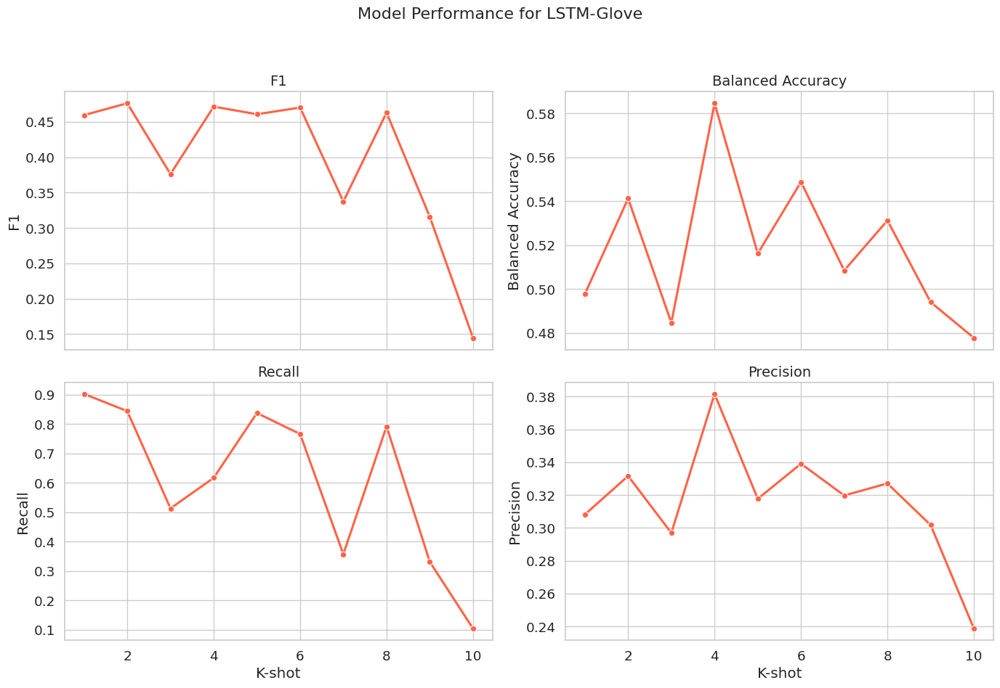

In [165]:
# Plot results
plot_model_performance(df, "LSTM-Glove", "tomato")

Maximum values per metric:
Balanced Accuracy: 0.5846 (at K-shot = 4)
F1: 0.4762 (at K-shot = 2)
Recall: 0.9026 (at K-shot = 1)
Precision: 0.3815 (at K-shot = 4)


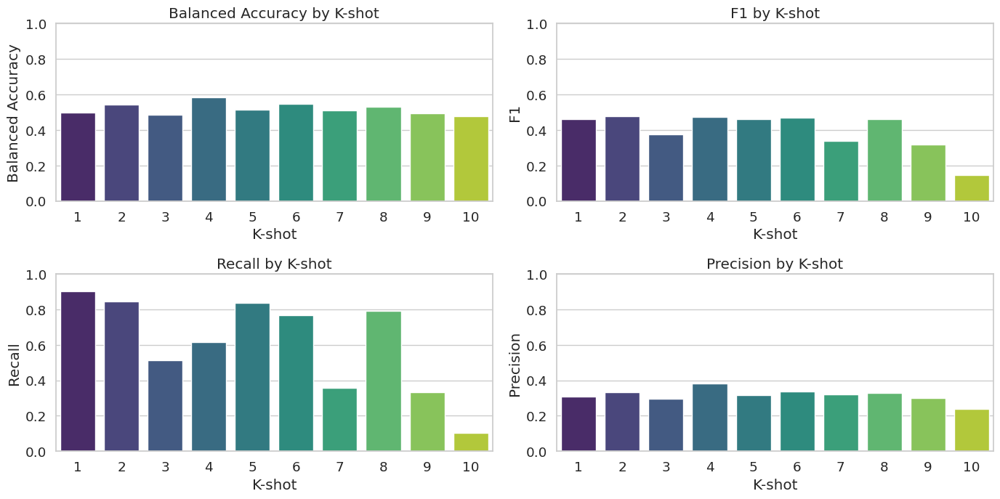

In [166]:
metrics = ["Balanced Accuracy", "F1", "Recall", "Precision"]

# Print max values for each metric
print("Maximum values per metric:")
for metric in metrics:
    max_val = df[metric].max()
    max_k = df.loc[df[metric].idxmax(), "K-shot"]
    print(f"{metric}: {max_val:.4f} (at K-shot = {max_k})")

# Then plot the histograms
plt.figure(figsize=(14, 10))

for i, metric in enumerate(metrics, 1):
    plt.subplot(3, 2, i)
    sns.barplot(x="K-shot", y=metric, data=df, palette="viridis")
    plt.title(f"{metric} by K-shot")
    plt.ylim(0, 1)
    plt.xlabel("K-shot")
    plt.ylabel(metric)

plt.tight_layout()
plt.show()

## **12. Bidirectional GRU + Weight Class using Glove (300d)**

### **12.1 Optmization Phase**

#### **12.1.1 Optimizer selection**

In [167]:
num_epochs = 16
learning_rate = 5e-5

class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)
results = []

optimizers = {
    'Adam': optim.Adam,
    'RMSprop': optim.RMSprop,
    'AdamW': optim.AdamW
}

all_train_losses, all_val_losses = {}, {}
all_train_accs, all_val_accs = {}, {}

# Loop through optimizers
for optimizer_name, optimizer_class in optimizers.items():
    print(f"\n🔹 Training with optimizer: {optimizer_name}")

    model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=learning_rate)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total trainable parameters: {num_params}")

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []
    best_val_loss = float('inf')

    # Training loop
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)  # <-- fixed unpacking order

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        scheduler.step(f1)

        duration = time.time() - start_time

        print(
            f"Opt: {optimizer_name} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {duration/60:.2f} min"
        )

    # Store metrics
    all_train_losses[optimizer_name] = train_losses
    all_val_losses[optimizer_name] = val_losses
    all_train_accs[optimizer_name] = train_accs
    all_val_accs[optimizer_name] = val_accs

    label = f"Batch={BATCH_SIZE} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with optimizer: Adam
GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 14667101
Opt: Adam | Epoch 1/16 - TL: 0.9793, VL: 0.9892, TA: 55.19%, VA: 65.31%, F1: 51.09%, Time: 0.17 min
Opt: Adam | Epoch 2/16 - TL: 0.9373, VL: 0.9452, TA: 65.68%, VA: 66.39%, F1: 52.66%, Time: 0.17 min
Opt: Adam | Epoch 3/16 - TL: 0.9103, VL: 1.0103, TA: 69.07%, VA: 71.61%, F1: 58.59%, Time: 0.17 min
Opt: Adam | Epoch 4/16 - TL: 0.7698, VL: 0.8064, TA: 72.83%, VA: 74.27%, F1: 61.62%, Time: 0.17 min
Opt: Adam | Epoch 5/16 - TL: 0.7360, VL: 1.0675, TA: 74.94%, VA: 62.03%, F1: 42.53%, Time: 0.17 min
Opt: Adam | Epoch 6/16 - TL: 0.7206, VL: 0.7586, TA: 76.58%, VA: 73.75%, F1: 60.58%, Time: 0.17 min
Opt: Adam | Epoch 7/16 - TL: 0.6443, VL: 0.7460, TA: 79.04%, VA: 77.29%, F1: 

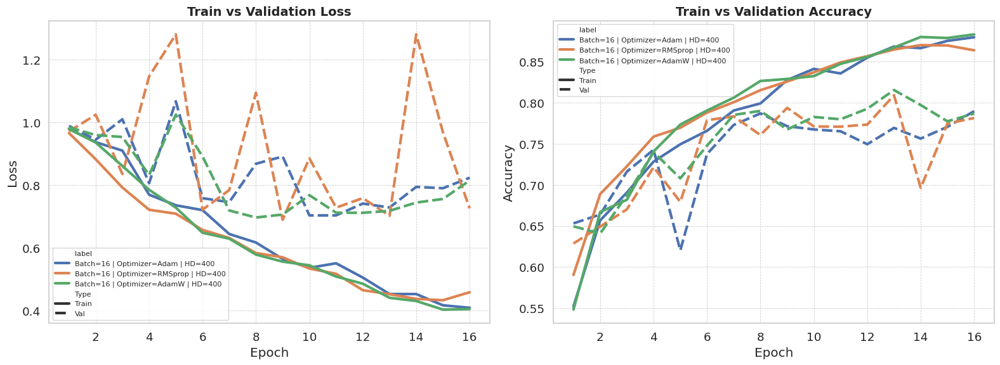

In [168]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **12.1.2 Learning rate value selection**

In [169]:
# Learning rate sweep configuration
learning_rates = [1e-5, 5e-5, 1e-6]
optimizer_name = 'Adam'
optimizer_class = optim.Adam
results = []
num_epochs = 16

# Class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop through learning rates
for lr in learning_rates:
    print(f"\n🔹 Training with {optimizer_name} optimizer, learning rate = {lr}")

    # Instantiate GRU + Bahdanau Attention model
    model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

    print(model)

    optimizer = optimizer_class(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3
    )

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        scheduler.step(f1)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"LR: {lr:.1e} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results
    label = f"LR={lr:.1e} | Optimizer={optimizer_name} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with Adam optimizer, learning rate = 1e-05
GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
LR: 1.0e-05 | Epoch 1/16 - TL: 0.9913, VL: 1.0128, TA: 50.45%, VA: 53.21%, F1: 28.57%, Time: 0.17 min
LR: 1.0e-05 | Epoch 2/16 - TL: 0.9834, VL: 1.0073, TA: 54.28%, VA: 60.00%, F1: 40.17%, Time: 0.17 min
LR: 1.0e-05 | Epoch 3/16 - TL: 0.9760, VL: 1.0006, TA: 59.22%, VA: 62.72%, F1: 46.10%, Time: 0.17 min
LR: 1.0e-05 | Epoch 4/16 - TL: 0.9695, VL: 0.9947, TA: 61.83%, VA: 61.81%, F1: 45.16%, Time: 0.17 min
LR: 1.0e-05 | Epoch 5/16 - TL: 0.9687, VL: 0.9894, TA: 64.66%, VA: 63.23%, F1: 47.35%, Time: 0.17 min
LR: 1.0e-05 | Epoch 6/16 - TL: 0.9534, VL: 0.9822, TA: 64.03%, VA: 65.01%, F1: 50.33%, Time: 0.17 min
LR: 1.0e-05 | Epoch 7/16 - TL: 0.9437, VL: 0.9753, TA: 65.46%, VA: 65.52%, F1: 5

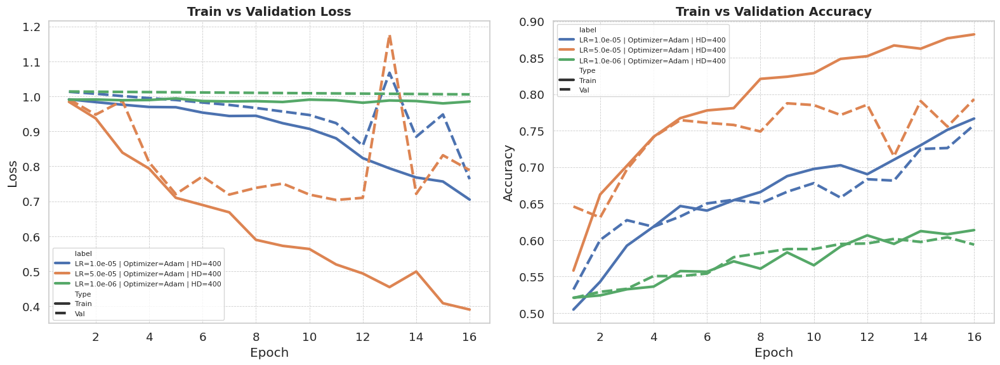

In [170]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **12.1.3 Batch size value selection**

In [171]:
# Batch size sweep configuration
batch_sizes = [8, 16, 64]
learning_rate = 2e-5
num_epochs = 16
results = []

# Compute class weights for binary classification
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# Loop over different batch sizes
for batch_size in batch_sizes:
    print(f"\n🔹 Training with batch size: {batch_size}")

    # Create DataLoaders with the current batch size
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    # Instantiate GRU + Bahdanau Attention model
    model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    train_losses, val_losses = [], []
    train_accs, val_accs, val_f1s = [], [], []

    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        val_f1s.append(f1)

        print(
            f"BS: {batch_size} | Epoch {epoch+1}/{num_epochs} - "
            f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
            f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
            f"Time: {(time.time() - start_time)/60:.2f} min"
        )

    # Store results for later plotting
    label = f"LR={learning_rate:.1e} | Batch={batch_size} | HD=400 | DP=0.5"
    for epoch in range(num_epochs):
        results.append({
            "epoch": epoch + 1,
            "label": label,
            "train_loss": train_losses[epoch],
            "val_loss": val_losses[epoch],
            "train_acc": train_accs[epoch],
            "val_acc": val_accs[epoch],
            "val_f1": val_f1s[epoch]
        })

Class weights: [0.69741587 1.76636225]

🔹 Training with batch size: 8
BS: 8 | Epoch 1/16 - TL: 0.9847, VL: 0.9904, TA: 54.50%, VA: 57.47%, F1: 29.51%, Time: 0.28 min
BS: 8 | Epoch 2/16 - TL: 0.9651, VL: 0.9745, TA: 58.22%, VA: 60.39%, F1: 37.81%, Time: 0.28 min
BS: 8 | Epoch 3/16 - TL: 0.9426, VL: 0.9482, TA: 60.63%, VA: 64.78%, F1: 49.65%, Time: 0.28 min
BS: 8 | Epoch 4/16 - TL: 0.8978, VL: 0.8642, TA: 66.86%, VA: 68.28%, F1: 54.83%, Time: 0.28 min
BS: 8 | Epoch 5/16 - TL: 0.8517, VL: 0.9604, TA: 70.07%, VA: 70.76%, F1: 57.94%, Time: 0.28 min
BS: 8 | Epoch 6/16 - TL: 0.7797, VL: 0.8320, TA: 72.78%, VA: 76.36%, F1: 64.67%, Time: 0.28 min
BS: 8 | Epoch 7/16 - TL: 0.7448, VL: 0.7943, TA: 76.43%, VA: 77.71%, F1: 66.08%, Time: 0.28 min
BS: 8 | Epoch 8/16 - TL: 0.7061, VL: 0.8318, TA: 76.93%, VA: 76.43%, F1: 64.69%, Time: 0.28 min
BS: 8 | Epoch 9/16 - TL: 0.6889, VL: 0.7583, TA: 78.12%, VA: 78.55%, F1: 67.48%, Time: 0.28 min
BS: 8 | Epoch 10/16 - TL: 0.6660, VL: 0.7749, TA: 78.65%, VA: 76.9

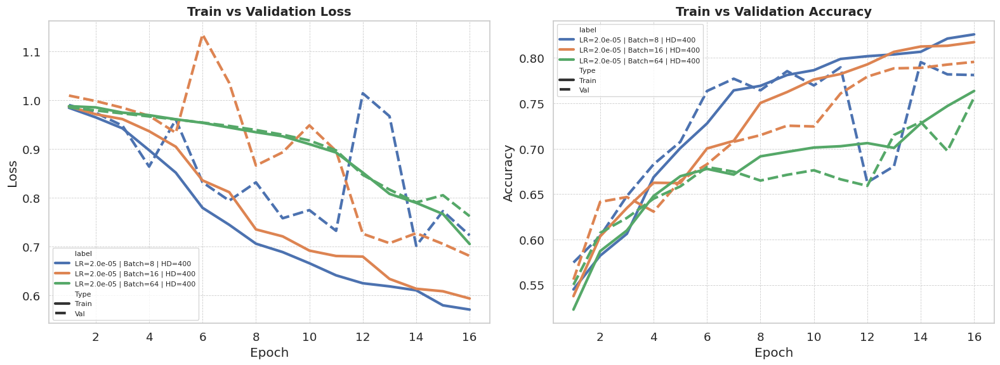

In [172]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

#### **12.1.4 Dropout value selection**

In [173]:
# Hyperparameter sweep configuration
hidden_dims = [286]
dropouts = [0.1, 0.4, 0.8]
learning_rate = 1e-5
batch_size = 16
num_epochs = 16
results = []

# Compute class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

for hidden_dim in hidden_dims:
    num_layers = 1  # fixed value for this sweep
    for dropout in dropouts:
        print(f"\n🔹 Training with hidden_dim={hidden_dim}, num_layers={num_layers}, dropout={dropout}")

        # Data loaders
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

        # Instantiate GRU + Bahdanau Attention model with current parameters
        model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        train_losses, val_losses = [], []
        train_accs, val_accs, val_f1s = [], [], []

        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_epoch(model, train_loader, optimizer, criterion, device)
            val_loss, val_acc, f1 = evaluate_epoch(model, val_loader, criterion, device)

            train_losses.append(train_loss)
            val_losses.append(val_loss)
            train_accs.append(train_acc)
            val_accs.append(val_acc)
            val_f1s.append(f1)

            print(
                f"HD: {hidden_dim} | NL: {num_layers} | DP: {dropout} | Epoch {epoch+1}/{num_epochs} - "
                f"TL: {train_loss:.4f}, VL: {val_loss:.4f}, "
                f"TA: {train_acc:.2%}, VA: {val_acc:.2%}, F1: {f1:.2%}, "
                f"Time: {(time.time() - start_time)/60:.2f} min"
            )

        # Store results
        label = f"LR={learning_rate:.1e} | BS={batch_size} | HD={hidden_dim} | NL={num_layers} | DP={dropout}"
        for epoch in range(num_epochs):
            results.append({
                "epoch": epoch + 1,
                "label": label,
                "train_loss": train_losses[epoch],
                "val_loss": val_losses[epoch],
                "train_acc": train_accs[epoch],
                "val_acc": val_accs[epoch],
                "val_f1": val_f1s[epoch]
            })

Class weights: [0.69741587 1.76636225]

🔹 Training with hidden_dim=286, num_layers=1, dropout=0.1
HD: 286 | NL: 1 | DP: 0.1 | Epoch 1/16 - TL: 0.9910, VL: 1.0127, TA: 52.03%, VA: 57.29%, F1: 33.33%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 2/16 - TL: 0.9824, VL: 1.0061, TA: 55.78%, VA: 59.72%, F1: 40.32%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 3/16 - TL: 0.9744, VL: 1.0001, TA: 59.07%, VA: 60.87%, F1: 42.91%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 4/16 - TL: 0.9687, VL: 0.9945, TA: 60.54%, VA: 64.35%, F1: 48.73%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 5/16 - TL: 0.9606, VL: 0.9875, TA: 63.52%, VA: 66.56%, F1: 52.35%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 6/16 - TL: 0.9511, VL: 0.9811, TA: 65.72%, VA: 67.56%, F1: 53.77%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 7/16 - TL: 0.9445, VL: 0.9747, TA: 65.45%, VA: 67.28%, F1: 53.42%, Time: 0.17 min
HD: 286 | NL: 1 | DP: 0.1 | Epoch 8/16 - TL: 0.9332, VL: 0.9659, TA: 66.73%, VA: 66.67%, F

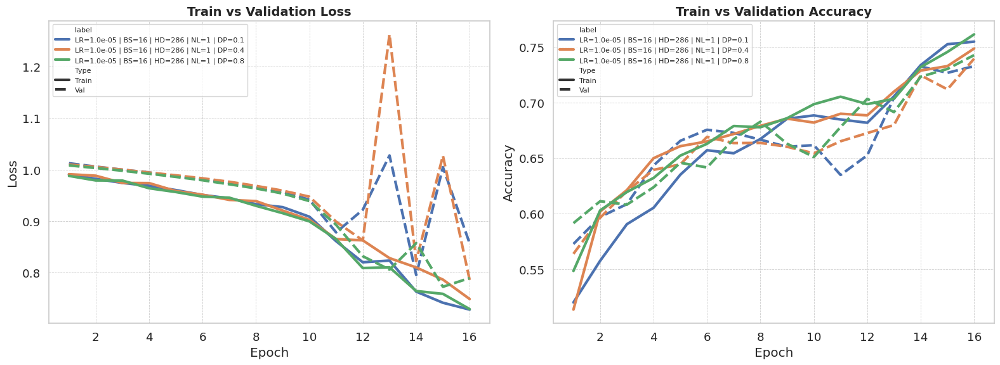

In [174]:
df_results = pd.DataFrame(results)

# Clean up labels for plotting
df_results['label'] = (
    df_results['label']
    .str.replace(r'\s*\|\s*HD=450', '', regex=True)
    .str.replace(r'\s*\|\s*DP=0\.5', '', regex=True)
)

# Prepare data for loss plot
df_loss = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_loss', 'val_loss'],
    var_name='Type', value_name='Loss'
)
df_loss['Type'] = df_loss['Type'].map({'train_loss': 'Train', 'val_loss': 'Val'})

# Prepare data for accuracy plot
df_acc = pd.melt(
    df_results, id_vars=['epoch', 'label'],
    value_vars=['train_acc', 'val_acc'],
    var_name='Type', value_name='Accuracy'
)
df_acc['Type'] = df_acc['Type'].map({'train_acc': 'Train', 'val_acc': 'Val'})

# Plotting
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Loss plot
sns.lineplot(data=df_loss, x='epoch', y='Loss', hue='label', style='Type', ax=axes[0])
axes[0].set_title('Train vs Validation Loss', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(title=None, fontsize=8)
axes[0].grid(True, linestyle='--', linewidth=0.6)

# Accuracy plot
sns.lineplot(data=df_acc, x='epoch', y='Accuracy', hue='label', style='Type', ax=axes[1])
axes[1].set_title('Train vs Validation Accuracy', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(title=None, fontsize=8)
axes[1].grid(True, linestyle='--', linewidth=0.6)

plt.tight_layout()
plt.savefig("combined_metrics_highres.png", dpi=300, bbox_inches='tight')
plt.show()

### **12.2 Test Phase**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

In [175]:
# --- Hyperparameters ---
HIDDEN_DIM = 286
DROPOUT = 0.8
NUM_LAYERS = 1
learning_rate = 5e-5
num_epochs = 50
patience = 6
best_model_path = "best_model2.pth"

# --- Model Instantiation ---
model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# --- Compute Class Weights ---
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.array([0, 1]),
    y=y_train_tensor.cpu().numpy()
)
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(
    class_weights[1] / class_weights[0],
    dtype=torch.float
).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Tracking Variables ---
train_losses, test_losses = [], []
train_accuracies, test_accuracies = [], []
test_f1s, test_balanced_accs, test_recalls, test_precisions = [], [], [], []

best_test_bal_acc = 0
patience_counter = 0
best_model_state = None

# --- Scheduler ---
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-6
)

# --- Training with Early Stopping ---
with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as epoch_pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        # Training step
        train_loss, train_acc = train_epoch(model, combined_loader, optimizer, loss_function, device)

        # Evaluation step
        test_loss, test_acc, test_f1, test_balanced_acc, test_recall, test_precision = test_epoch(
            model, test_loader, loss_function, device
        )

        # Logging
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        test_losses.append(test_loss)
        test_balanced_accs.append(test_balanced_acc)
        test_f1s.append(test_f1)

        # Scheduler step
        scheduler.step(test_balanced_acc)

        epoch_duration = time.time() - start_time

        # --- Early Stopping Logic ---
        if test_balanced_acc > best_test_bal_acc:
            best_test_bal_acc = test_balanced_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
            torch.save(best_model_state, best_model_path)
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"\nEarly stopping at epoch {epoch + 1}.")
                break

        epoch_pbar.set_postfix({
            "Training Loss": f"{train_loss:.4f}",
            "Test Loss": f"{test_loss:.4f}",
            "Train Balanced Acc": f"{train_acc:.2%}",
            "Test Balanced Acc": f"{test_balanced_acc:.2%}",
            "Test F1": f"{test_f1:.2%}",
            "Test Precision": f"{test_precision:.2%}",
            "Test Recall": f"{test_recall:.2%}",
            "Time(min)": f"{epoch_duration / 60:.2f}"
        })
        epoch_pbar.update(1)

# --- Load Best Model ---
model.load_state_dict(torch.load(best_model_path))

Class weights: [0.69741587 1.76636225]


Training Progress:  28%|██▊       | 14/50 [03:36<09:17, 15.49s/epoch, Training Loss=0.4793, Test Loss=0.7207, Train Balanced Acc=85.95%, Test Balanced Acc=76.54%, Test F1=66.33%, Test Precision=54.36%, Test Recall=85.06%, Time(min)=0.21]


Early stopping at epoch 15.


<All keys matched successfully>

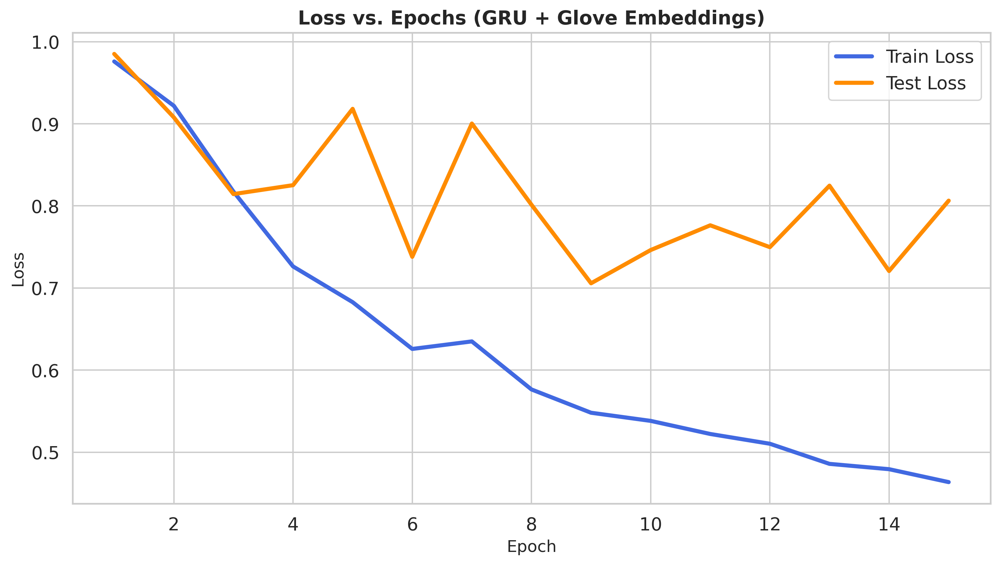

In [176]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=epochs, y=test_losses, label='Test Loss', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (GRU + Glove Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='upper right', frameon=True)
plt.tight_layout()

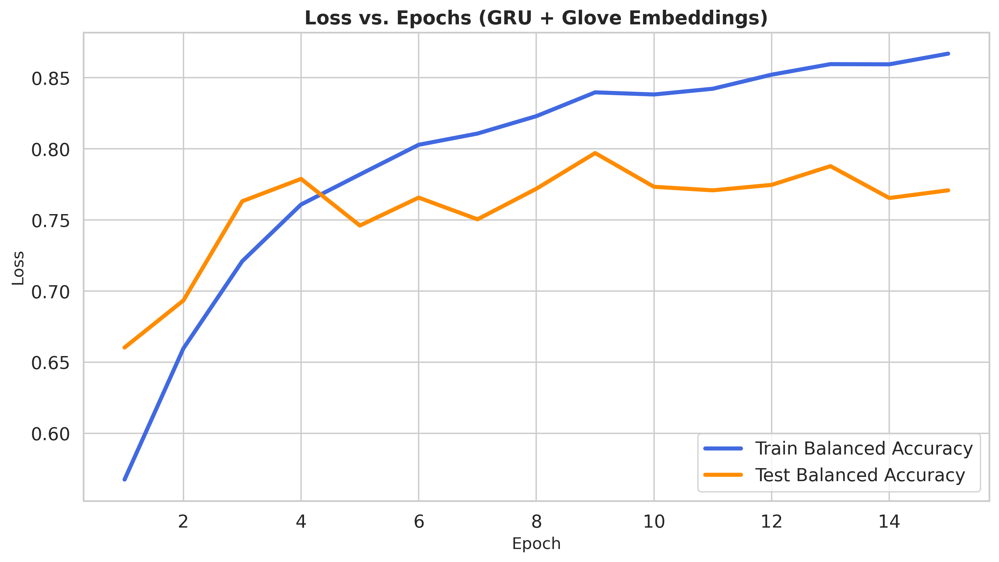

In [177]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

plt.figure(figsize=(20, 6), dpi=300)

# === 2. Balanced Accurcy Curve ===
plt.subplot(1, 2, 1)

epochs = list(range(1, len(train_losses) + 1))

sns.lineplot(x=epochs, y=train_accuracies, label='Train Balanced Accuracy', color='royalblue')
sns.lineplot(x=epochs, y=test_balanced_accs, label='Test Balanced Accuracy', color='darkorange')

plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss vs. Epochs (GRU + Glove Embeddings)', fontsize=14, weight='bold')
plt.legend(loc='lower right', frameon=True)
plt.tight_layout()

In [178]:
model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

model.load_state_dict(torch.load("/content/best_model2.pth"))
model.eval()

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
loss_function = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Recalculate metrics on test set ---
final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_epoch(
    model, test_loader, loss_function, device
)

# --- Print results ---
print("\n Final Evaluation Metrics of Best Model:")
print(f"Test Loss           : {final_test_loss:.4f}")
print(f"Test Accuracy       : {final_test_acc:.2%}")
print(f"Test F1 Score       : {final_test_f1:.2%}")
print(f"Balanced Accuracy   : {final_test_bal_acc:.2%}")
print(f"Test Precision      : {final_test_precision:.2%}")
print(f"Test Recall         : {final_test_recall:.2%}")

Class weights: [0.69741587 1.76636225]

 Final Evaluation Metrics of Best Model:
Test Loss           : 0.7057
Test Accuracy       : 77.91%
Test F1 Score       : 70.27%
Balanced Accuracy   : 79.71%
Test Precision      : 60.19%
Test Recall         : 84.42%


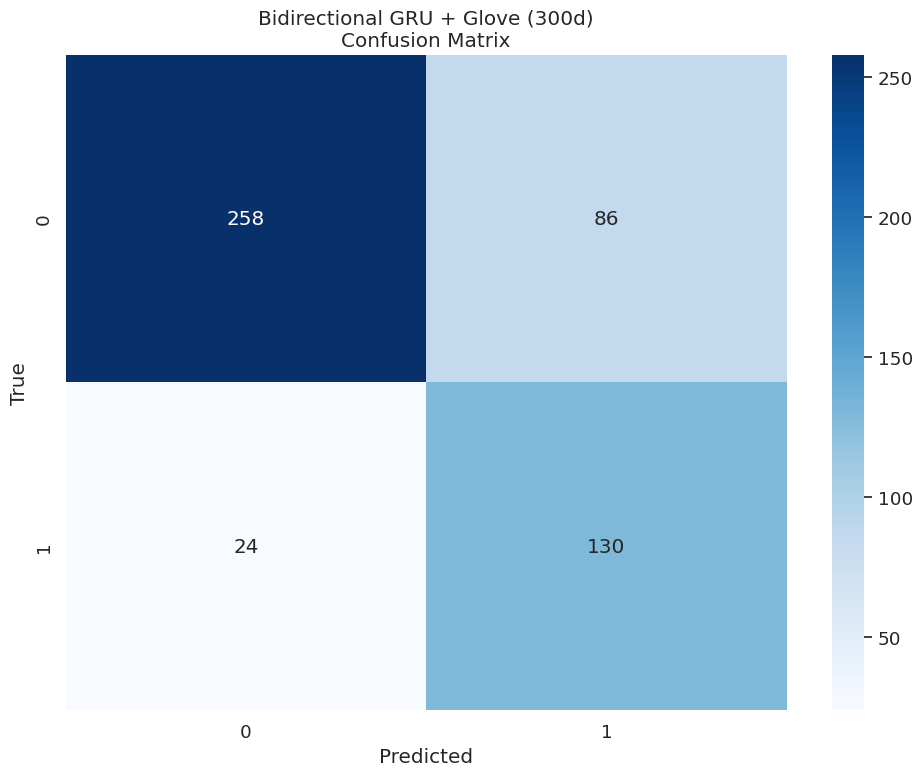

In [179]:
df_results, df_correct, df_wrong, all_labels, all_pred, all_probs = evaluate_and_analyze(model, test_loader, device)

NUM_CLASSES = 2

fig, axes = plt.subplots(1, 1, figsize=(10, 8))

plot_confusion_matrix(axes, all_labels, all_pred)
axes.set_title("Bidirectional GRU + Glove (300d)\nConfusion Matrix")

plt.tight_layout()
plt.show()

In [180]:
from sklearn.metrics import roc_curve, auc

y_true = np.array(all_labels)
y_scores = np.array(all_probs)

fpr, tpr, _ = roc_curve(y_true , y_scores)
roc_auc = auc(fpr, tpr)

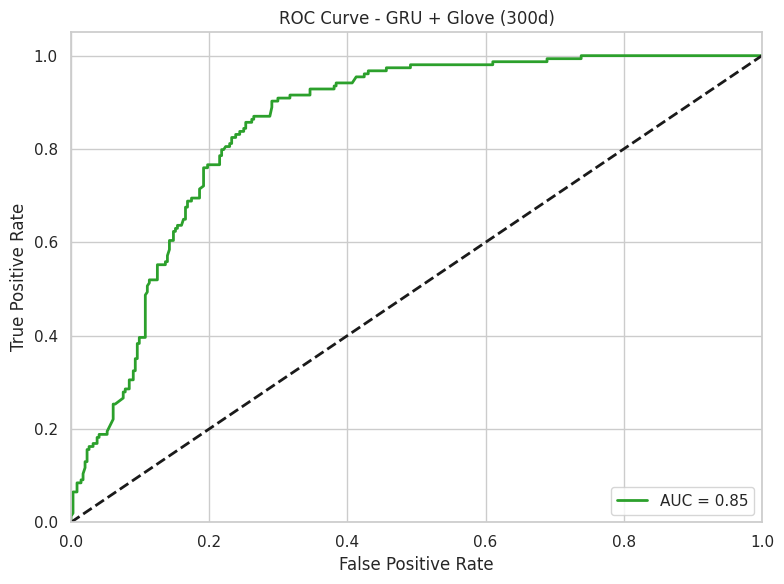

In [181]:
sns.set(style="whitegrid")
# One plot only
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

ax.plot(fpr, tpr, lw=2,
        label=f'AUC = {roc_auc:.2f}', color='tab:green')
ax.plot([0, 1], [0, 1], 'k--', lw=2)
ax.set_xlim([0.0, 1.0])
ax.set_ylim([0.0, 1.05])
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_title('ROC Curve - GRU + Glove (300d)')
ax.legend(loc='lower right')
ax.grid(True)

plt.tight_layout()
plt.show()

### **12.3 Few-Shot Learning**

In [182]:
k_values = range(1, 11)  # Few-shot from k=1 to 10
NUM_CLASSES = 2
HIDDEN_DIM = 286
DROPOUT = 0.7

X_combined = np.concatenate((X_train, X_val), axis=0)
y_combined = np.concatenate((y_train, y_val), axis=0)
X_combined_tensor = torch.cat((X_train_tensor, X_val_tensor), dim=0)
y_combined_tensor = torch.cat((y_train_tensor, y_val_tensor), dim=0)

model_metrics = {
    "K-shot": [],
    "Model": [],
    "Test Accuracy": [],
    "F1": [],
    "Balanced Accuracy": [],
    "Recall": [],
    "Precision": []
}

patience = 7
num_epochs = 50
for k in k_values:
    print(f"\n--- K-Shot = {k} ---")

    X_few, y_few = get_few_shot_subset(X_combined_tensor, y_combined_tensor, k_shot=k)
    few_shot_dataset = TextDataset(X_few, y_few, raw_text_data=X_combined)
    few_shot_loader = DataLoader(few_shot_dataset, batch_size=batch_size, shuffle=True, collate_fn=custom_collate_fn)

    model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

    print(f"{count_parameters(model)} model parameters")
    print()
    print(model)

    learning_rate = 2e-5
    optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)

    class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
    print(f"Class weights: {class_weights}")

    pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
    loss_function = torch.nn.BCEWithLogitsLoss()

    # Train with early stopping
    best_val_acc = 0
    patience_counter = 0
    for epoch in range(num_epochs):
        train_loss, train_acc = train_epoch(model, few_shot_loader, optimizer, loss_function, device)
        val_acc, val_f1, val_loss = evaluate_epoch(model, test_loader, loss_function, device)

        print(f"K={k} | Epoch {epoch+1}/{num_epochs} "
              f"- Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, "
              f"Test Loss: {val_loss:.4f}, Test Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = copy.deepcopy(model.state_dict())
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                break

    # Load best model
    model.load_state_dict(best_model_state)

    # Evaluate on test set
    avg_loss, avg_accuracy, f1, balanced_acc, recall, precision = test_epoch(model, test_loader, loss_function, device)

    # Log metrics
    print(f"Test Accuracy: {avg_accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"Balanced Accuracy: {balanced_acc:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"Precision: {precision:.4f}")

    model_metrics["K-shot"].append(k)
    model_metrics["Model"].append("GRU-Glove")
    model_metrics["Test Accuracy"].append(avg_accuracy)
    model_metrics["F1"].append(f1)
    model_metrics["Balanced Accuracy"].append(balanced_acc)
    model_metrics["Recall"].append(recall)
    model_metrics["Precision"].append(precision)

# Convert results to DataFrame
df = pd.DataFrame(model_metrics)


--- K-Shot = 1 ---
14667101 model parameters

GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Class weights: [0.69741587 1.76636225]


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=1 | Epoch 1/50 - Train Loss: 0.6961, Train Acc: 0.5000, Test Loss: 0.4485, Test Acc: 0.7019, Val F1: 0.5066
K=1 | Epoch 2/50 - Train Loss: 0.6518, Train Acc: 1.0000, Test Loss: 0.4416, Test Acc: 0.7015, Val F1: 0.4997
K=1 | Epoch 3/50 - Train Loss: 0.6324, Train Acc: 1.0000, Test Loss: 0.4388, Test Acc: 0.7015, Val F1: 0.5064
K=1 | Epoch 4/50 - Train Loss: 0.5845, Train Acc: 1.0000, Test Loss: 0.4311, Test Acc: 0.7015, Val F1: 0.5033
K=1 | Epoch 5/50 - Train Loss: 0.5703, Train Acc: 1.0000, Test Loss: 0.4414, Test Acc: 0.7017, Val F1: 0.5145
K=1 | Epoch 6/50 - Train Loss: 0.5491, Train Acc: 1.0000, Test Loss: 0.4480, Test Acc: 0.7020, Val F1: 0.5235
K=1 | Epoch 7/50 - Train Loss: 0.5185, Train Acc: 1.0000, Test Loss: 0.4467, Test Acc: 0.7021, Val F1: 0.5232
K=1 | Epoch 8/50 - Train Loss: 0.5120, Train Acc: 1.0000, Test Loss: 0.4547, Test Acc: 0.7023, Val F1: 0.5326
K=1 | Epoch 9/50 - Train Loss: 0.4971, Train Acc: 1.0000, Test Loss: 0.4498, Test Acc: 0.7026, Val F1: 0.5264
K=1 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=2 | Epoch 1/50 - Train Loss: 0.7193, Train Acc: 0.2500, Test Loss: 0.4148, Test Acc: 0.6892, Val F1: 0.5553
K=2 | Epoch 2/50 - Train Loss: 0.6732, Train Acc: 0.7500, Test Loss: 0.4521, Test Acc: 0.6897, Val F1: 0.5768
K=2 | Epoch 3/50 - Train Loss: 0.6376, Train Acc: 1.0000, Test Loss: 0.4742, Test Acc: 0.6895, Val F1: 0.5923
K=2 | Epoch 4/50 - Train Loss: 0.6159, Train Acc: 1.0000, Test Loss: 0.4745, Test Acc: 0.6893, Val F1: 0.5912
K=2 | Epoch 5/50 - Train Loss: 0.5953, Train Acc: 1.0000, Test Loss: 0.4576, Test Acc: 0.6891, Val F1: 0.5768
K=2 | Epoch 6/50 - Train Loss: 0.5787, Train Acc: 1.0000, Test Loss: 0.4399, Test Acc: 0.6890, Val F1: 0.5597
K=2 | Epoch 7/50 - Train Loss: 0.5662, Train Acc: 1.0000, Test Loss: 0.4490, Test Acc: 0.6888, Val F1: 0.5677
K=2 | Epoch 8/50 - Train Loss: 0.5556, Train Acc: 1.0000, Test Loss: 0.4513, Test Acc: 0.6885, Val F1: 0.5706
K=2 | Epoch 9/50 - Train Loss: 0.5188, Train Acc: 1.0000, Test Loss: 0.4450, Test Acc: 0.6882, Val F1: 0.5644
Test Accur

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=3 | Epoch 1/50 - Train Loss: 0.7283, Train Acc: 0.1667, Test Loss: 0.1644, Test Acc: 0.6922, Val F1: 0.4122
K=3 | Epoch 2/50 - Train Loss: 0.6789, Train Acc: 0.5000, Test Loss: 0.2098, Test Acc: 0.6939, Val F1: 0.4309
K=3 | Epoch 3/50 - Train Loss: 0.6753, Train Acc: 0.6667, Test Loss: 0.2327, Test Acc: 0.6953, Val F1: 0.4355
K=3 | Epoch 4/50 - Train Loss: 0.6468, Train Acc: 1.0000, Test Loss: 0.2395, Test Acc: 0.6967, Val F1: 0.4264
K=3 | Epoch 5/50 - Train Loss: 0.6403, Train Acc: 0.8333, Test Loss: 0.2645, Test Acc: 0.6981, Val F1: 0.4218
K=3 | Epoch 6/50 - Train Loss: 0.6342, Train Acc: 1.0000, Test Loss: 0.2751, Test Acc: 0.6992, Val F1: 0.4188
K=3 | Epoch 7/50 - Train Loss: 0.6078, Train Acc: 1.0000, Test Loss: 0.2850, Test Acc: 0.7002, Val F1: 0.4158
K=3 | Epoch 8/50 - Train Loss: 0.6011, Train Acc: 1.0000, Test Loss: 0.2948, Test Acc: 0.7014, Val F1: 0.4143
K=3 | Epoch 9/50 - Train Loss: 0.6020, Train Acc: 1.0000, Test Loss: 0.2995, Test Acc: 0.7024, Val F1: 0.4135
K=3 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=4 | Epoch 1/50 - Train Loss: 0.7053, Train Acc: 0.5000, Test Loss: 0.4587, Test Acc: 0.7074, Val F1: 0.5012
K=4 | Epoch 2/50 - Train Loss: 0.6613, Train Acc: 0.8750, Test Loss: 0.4626, Test Acc: 0.7103, Val F1: 0.5036
K=4 | Epoch 3/50 - Train Loss: 0.6456, Train Acc: 1.0000, Test Loss: 0.4649, Test Acc: 0.7130, Val F1: 0.5080
K=4 | Epoch 4/50 - Train Loss: 0.6259, Train Acc: 0.8750, Test Loss: 0.4615, Test Acc: 0.7150, Val F1: 0.5033
K=4 | Epoch 5/50 - Train Loss: 0.6073, Train Acc: 1.0000, Test Loss: 0.4567, Test Acc: 0.7168, Val F1: 0.4957
K=4 | Epoch 6/50 - Train Loss: 0.5884, Train Acc: 1.0000, Test Loss: 0.4592, Test Acc: 0.7184, Val F1: 0.4989
K=4 | Epoch 7/50 - Train Loss: 0.5703, Train Acc: 1.0000, Test Loss: 0.4530, Test Acc: 0.7200, Val F1: 0.4921
K=4 | Epoch 8/50 - Train Loss: 0.5761, Train Acc: 1.0000, Test Loss: 0.4501, Test Acc: 0.7214, Val F1: 0.4900
K=4 | Epoch 9/50 - Train Loss: 0.5757, Train Acc: 1.0000, Test Loss: 0.4508, Test Acc: 0.7228, Val F1: 0.4914
K=4 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=5 | Epoch 1/50 - Train Loss: 0.6872, Train Acc: 0.6000, Test Loss: 0.4264, Test Acc: 0.6993, Val F1: 0.4909
K=5 | Epoch 2/50 - Train Loss: 0.6594, Train Acc: 0.8000, Test Loss: 0.4303, Test Acc: 0.6994, Val F1: 0.5018
K=5 | Epoch 3/50 - Train Loss: 0.6516, Train Acc: 0.8000, Test Loss: 0.4298, Test Acc: 0.6996, Val F1: 0.5092
K=5 | Epoch 4/50 - Train Loss: 0.6279, Train Acc: 1.0000, Test Loss: 0.4426, Test Acc: 0.7001, Val F1: 0.5295
K=5 | Epoch 5/50 - Train Loss: 0.6201, Train Acc: 1.0000, Test Loss: 0.4383, Test Acc: 0.7006, Val F1: 0.5248
K=5 | Epoch 6/50 - Train Loss: 0.6127, Train Acc: 1.0000, Test Loss: 0.4374, Test Acc: 0.7010, Val F1: 0.5234
K=5 | Epoch 7/50 - Train Loss: 0.6072, Train Acc: 1.0000, Test Loss: 0.4264, Test Acc: 0.7015, Val F1: 0.5122
K=5 | Epoch 8/50 - Train Loss: 0.5942, Train Acc: 1.0000, Test Loss: 0.4233, Test Acc: 0.7020, Val F1: 0.5115
K=5 | Epoch 9/50 - Train Loss: 0.5814, Train Acc: 1.0000, Test Loss: 0.4190, Test Acc: 0.7023, Val F1: 0.5068
K=5 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=6 | Epoch 1/50 - Train Loss: 0.6921, Train Acc: 0.4167, Test Loss: 0.3850, Test Acc: 0.6964, Val F1: 0.4901
K=6 | Epoch 2/50 - Train Loss: 0.6643, Train Acc: 0.7500, Test Loss: 0.3852, Test Acc: 0.6969, Val F1: 0.4875
K=6 | Epoch 3/50 - Train Loss: 0.6443, Train Acc: 0.9167, Test Loss: 0.3927, Test Acc: 0.6970, Val F1: 0.4914
K=6 | Epoch 4/50 - Train Loss: 0.6258, Train Acc: 0.9167, Test Loss: 0.3918, Test Acc: 0.6972, Val F1: 0.4900
K=6 | Epoch 5/50 - Train Loss: 0.6194, Train Acc: 0.9167, Test Loss: 0.3929, Test Acc: 0.6973, Val F1: 0.4863
K=6 | Epoch 6/50 - Train Loss: 0.6026, Train Acc: 0.9167, Test Loss: 0.3910, Test Acc: 0.6971, Val F1: 0.4860
K=6 | Epoch 7/50 - Train Loss: 0.5954, Train Acc: 0.9167, Test Loss: 0.3937, Test Acc: 0.6974, Val F1: 0.4877
K=6 | Epoch 8/50 - Train Loss: 0.5942, Train Acc: 0.9167, Test Loss: 0.3946, Test Acc: 0.6975, Val F1: 0.4892
K=6 | Epoch 9/50 - Train Loss: 0.5834, Train Acc: 0.9167, Test Loss: 0.3928, Test Acc: 0.6976, Val F1: 0.4889
K=6 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=7 | Epoch 1/50 - Train Loss: 0.6903, Train Acc: 0.7143, Test Loss: 0.3675, Test Acc: 0.6936, Val F1: 0.4991
K=7 | Epoch 2/50 - Train Loss: 0.6718, Train Acc: 0.7143, Test Loss: 0.3351, Test Acc: 0.6945, Val F1: 0.4734
K=7 | Epoch 3/50 - Train Loss: 0.6505, Train Acc: 0.9286, Test Loss: 0.3316, Test Acc: 0.6950, Val F1: 0.4636
K=7 | Epoch 4/50 - Train Loss: 0.6367, Train Acc: 0.9286, Test Loss: 0.3056, Test Acc: 0.6952, Val F1: 0.4496
K=7 | Epoch 5/50 - Train Loss: 0.6316, Train Acc: 1.0000, Test Loss: 0.2973, Test Acc: 0.6956, Val F1: 0.4446
K=7 | Epoch 6/50 - Train Loss: 0.6154, Train Acc: 1.0000, Test Loss: 0.3019, Test Acc: 0.6964, Val F1: 0.4478
K=7 | Epoch 7/50 - Train Loss: 0.6070, Train Acc: 1.0000, Test Loss: 0.3017, Test Acc: 0.6967, Val F1: 0.4573
K=7 | Epoch 8/50 - Train Loss: 0.6034, Train Acc: 1.0000, Test Loss: 0.2969, Test Acc: 0.6971, Val F1: 0.4541
K=7 | Epoch 9/50 - Train Loss: 0.5830, Train Acc: 1.0000, Test Loss: 0.2969, Test Acc: 0.6973, Val F1: 0.4541
K=7 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=8 | Epoch 1/50 - Train Loss: 0.6985, Train Acc: 0.3750, Test Loss: 0.3588, Test Acc: 0.6915, Val F1: 0.4926
K=8 | Epoch 2/50 - Train Loss: 0.6768, Train Acc: 0.6250, Test Loss: 0.3660, Test Acc: 0.6925, Val F1: 0.4936
K=8 | Epoch 3/50 - Train Loss: 0.6615, Train Acc: 0.8750, Test Loss: 0.3852, Test Acc: 0.6931, Val F1: 0.5018
K=8 | Epoch 4/50 - Train Loss: 0.6566, Train Acc: 0.8750, Test Loss: 0.3628, Test Acc: 0.6938, Val F1: 0.4720
K=8 | Epoch 5/50 - Train Loss: 0.6263, Train Acc: 0.9375, Test Loss: 0.3662, Test Acc: 0.6943, Val F1: 0.4713
K=8 | Epoch 6/50 - Train Loss: 0.6351, Train Acc: 0.8750, Test Loss: 0.3687, Test Acc: 0.6949, Val F1: 0.4690
K=8 | Epoch 7/50 - Train Loss: 0.6306, Train Acc: 0.8750, Test Loss: 0.3753, Test Acc: 0.6954, Val F1: 0.4741
K=8 | Epoch 8/50 - Train Loss: 0.6225, Train Acc: 0.8750, Test Loss: 0.3744, Test Acc: 0.6960, Val F1: 0.4726
K=8 | Epoch 9/50 - Train Loss: 0.6175, Train Acc: 0.9375, Test Loss: 0.3747, Test Acc: 0.6965, Val F1: 0.4701
K=8 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=9 | Epoch 1/50 - Train Loss: 0.6806, Train Acc: 0.6111, Test Loss: 0.4574, Test Acc: 0.7056, Val F1: 0.4971
K=9 | Epoch 2/50 - Train Loss: 0.6688, Train Acc: 0.7778, Test Loss: 0.4586, Test Acc: 0.7043, Val F1: 0.5059
K=9 | Epoch 3/50 - Train Loss: 0.6457, Train Acc: 0.8333, Test Loss: 0.4553, Test Acc: 0.7035, Val F1: 0.5049
K=9 | Epoch 4/50 - Train Loss: 0.6153, Train Acc: 0.8333, Test Loss: 0.4517, Test Acc: 0.7067, Val F1: 0.4965
K=9 | Epoch 5/50 - Train Loss: 0.6441, Train Acc: 0.8333, Test Loss: 0.4577, Test Acc: 0.7037, Val F1: 0.5093
K=9 | Epoch 6/50 - Train Loss: 0.6533, Train Acc: 0.8889, Test Loss: 0.4677, Test Acc: 0.7006, Val F1: 0.5374
K=9 | Epoch 7/50 - Train Loss: 0.6298, Train Acc: 0.8889, Test Loss: 0.4760, Test Acc: 0.7034, Val F1: 0.5424
K=9 | Epoch 8/50 - Train Loss: 0.5954, Train Acc: 0.8889, Test Loss: 0.4807, Test Acc: 0.7039, Val F1: 0.5474
K=9 | Epoch 9/50 - Train Loss: 0.5983, Train Acc: 0.9444, Test Loss: 0.4769, Test Acc: 0.7064, Val F1: 0.5368
K=9 | Epoc

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


K=10 | Epoch 1/50 - Train Loss: 0.6770, Train Acc: 0.5000, Test Loss: 0.3466, Test Acc: 0.6913, Val F1: 0.4989
K=10 | Epoch 2/50 - Train Loss: 0.6550, Train Acc: 0.8000, Test Loss: 0.3786, Test Acc: 0.6930, Val F1: 0.4916
K=10 | Epoch 3/50 - Train Loss: 0.6542, Train Acc: 0.9000, Test Loss: 0.3582, Test Acc: 0.6927, Val F1: 0.4780
K=10 | Epoch 4/50 - Train Loss: 0.6186, Train Acc: 0.9000, Test Loss: 0.2753, Test Acc: 0.6912, Val F1: 0.4367
K=10 | Epoch 5/50 - Train Loss: 0.6238, Train Acc: 0.9000, Test Loss: 0.3722, Test Acc: 0.6938, Val F1: 0.4906
K=10 | Epoch 6/50 - Train Loss: 0.6089, Train Acc: 0.9500, Test Loss: 0.3515, Test Acc: 0.6940, Val F1: 0.4703
K=10 | Epoch 7/50 - Train Loss: 0.6010, Train Acc: 0.8500, Test Loss: 0.3500, Test Acc: 0.6939, Val F1: 0.4715
K=10 | Epoch 8/50 - Train Loss: 0.5933, Train Acc: 0.9500, Test Loss: 0.3289, Test Acc: 0.6924, Val F1: 0.4673
K=10 | Epoch 9/50 - Train Loss: 0.6116, Train Acc: 0.8500, Test Loss: 0.3614, Test Acc: 0.6950, Val F1: 0.4797
K

In [ ]:
# --- Plotting ---
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})
palette = sns.color_palette("Set2")

def plot_model_performance(df, model_name, color, title_prefix="Model Performance"):
    model_df = df[df["Model"] == model_name]
    metrics_to_plot = ["F1", "Balanced Accuracy", "Recall", "Precision"]

    fig, axes = plt.subplots(2, 2, figsize=(14, 10), sharex=True)
    axes = axes.flatten()

    for i, metric in enumerate(metrics_to_plot):
        sns.lineplot(
            data=model_df,
            x="K-shot",
            y=metric,
            ax=axes[i],
            color=color,
            marker="o",
            linewidth=2.2,
            markersize=6,
        )
        axes[i].set_title(metric, fontsize=14)
        axes[i].set_xlabel("K-shot")
        axes[i].set_ylabel(metric)
        axes[i].grid(True)

    plt.suptitle(f"{title_prefix} for {model_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

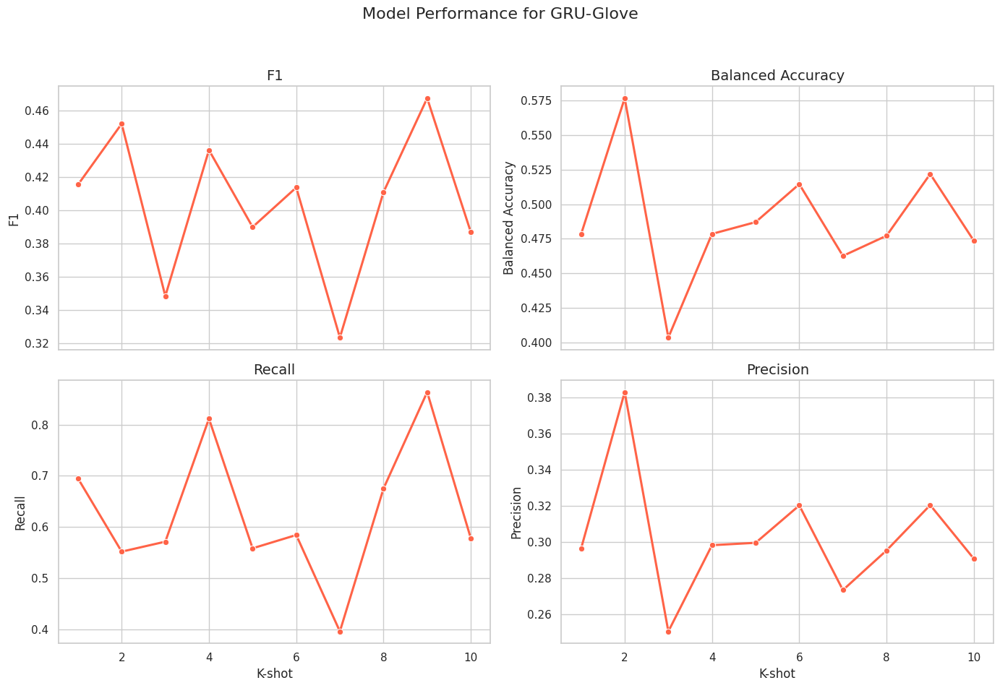

In [183]:
# Plot results
plot_model_performance(df, "GRU-Glove", "tomato")

Maximum values per metric:
Balanced Accuracy: 0.5768 (at K-shot = 2)
F1: 0.4675 (at K-shot = 9)
Recall: 0.8636 (at K-shot = 9)
Precision: 0.3829 (at K-shot = 2)


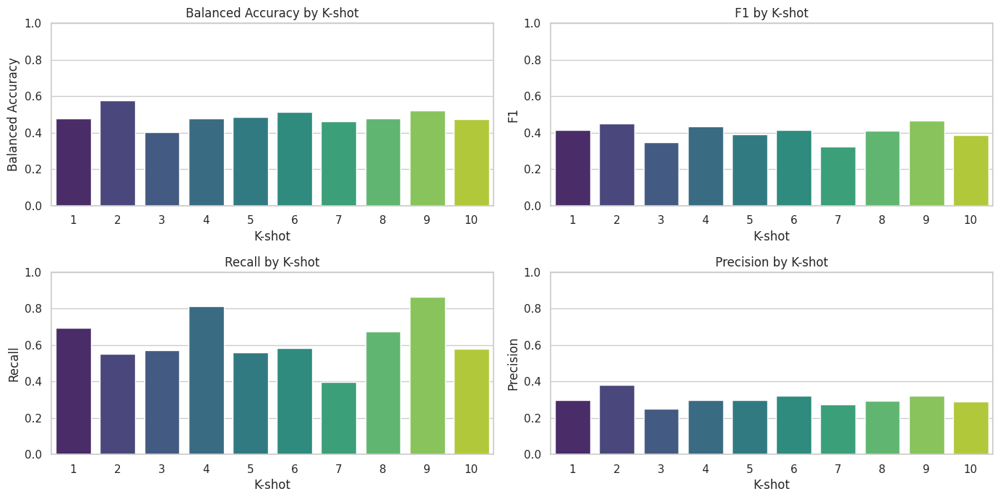

In [184]:
metrics = ["Balanced Accuracy", "F1", "Recall", "Precision"]

# Print max values for each metric
print("Maximum values per metric:")
for metric in metrics:
    max_val = df[metric].max()
    max_k = df.loc[df[metric].idxmax(), "K-shot"]
    print(f"{metric}: {max_val:.4f} (at K-shot = {max_k})")

# Then plot the histograms
plt.figure(figsize=(14, 10))

for i, metric in enumerate(metrics, 1):
    plt.subplot(3, 2, i)
    sns.barplot(x="K-shot", y=metric, data=df, palette="viridis")
    plt.title(f"{metric} by K-shot")
    plt.ylim(0, 1)
    plt.xlabel("K-shot")
    plt.ylabel(metric)

plt.tight_layout()
plt.show()